In [1]:
import cupy as cp
import numpy as np
import pandas as pd
import os
import seaborn as sns
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import classification_report, accuracy_score, confusion_matrix
import cv2
from sklearn.model_selection import train_test_split
%matplotlib inline
import matplotlib.pyplot as plt
from sklearn.metrics import confusion_matrix


## Read images

[48. 49. 45. ... 47. 46. 46.]


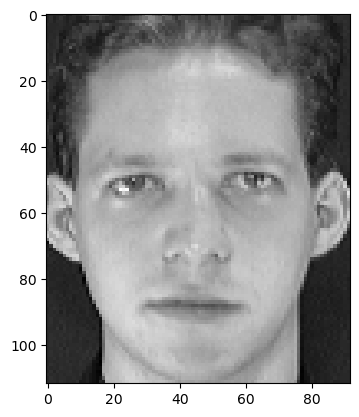

In [2]:
import cv2
img = cv2.imread('/kaggle/input/att-database-of-faces/s1/1.pgm', cv2.IMREAD_UNCHANGED)
print(np.array(img, dtype='float64').flatten())
plt.imshow(img,cmap='gray')
plt.show()

In [3]:
images = np.ones((1, 10304))
labels=np.array([])
for i in range(1,41):
  photos=[i for i in range(1, 10+1)]
  for photo in photos:
    img = cv2.imread('/kaggle/input/att-database-of-faces/s'+str(i)+"/"+str(photo)+".pgm",0) # zero for gray scale
    img = np.reshape(img, (1, 10304))
    images = np.append(images, img, axis=0)
    labels = np.append(labels, i)
labels=np.array(labels)
images=images[1:,]

In [4]:
images

array([[ 48.,  49.,  45., ...,  47.,  46.,  46.],
       [ 60.,  60.,  62., ...,  32.,  34.,  34.],
       [ 39.,  44.,  53., ...,  29.,  26.,  29.],
       ...,
       [125., 119., 124., ...,  36.,  39.,  40.],
       [119., 120., 120., ...,  89.,  94.,  85.],
       [125., 124., 124., ...,  36.,  35.,  34.]])

In [5]:
images[0]

array([48., 49., 45., ..., 47., 46., 46.])

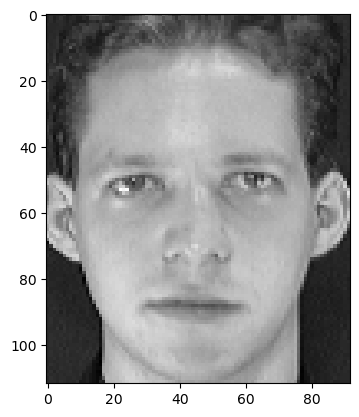

In [6]:
plt.imshow(images[0].reshape((112, 92)), cmap='gray')
plt.show()

##Train Test Split

In [7]:
X_train=images[1::2] # Odd
X_test=images[0::2]  # Even
y_train=labels[1::2] # Odd
y_test=labels[0::2]  # Even

In [8]:
print(X_train.shape)
print(X_test.shape)

(200, 10304)
(200, 10304)


In [9]:
images.shape

(400, 10304)

## PCA

In [10]:
#Calculating mean
def calculate_mean(data):
    return np.mean(data,axis=0,keepdims=True)

#Centralize data
def centeralize(data):
    return data - calculate_mean(data)

#Covariance Matrix
def calculate_covariance_matrix(data):
    z = centeralize(data)
    return (np.matmul(np.transpose(z), z)) / len(data)

#Calculating Eigen values & Eigen vectors
def calculate_eigen_vectors(data):
    cov = calculate_covariance_matrix(data)
    eig_values, eig_vectors = cp.linalg.eigh(cov)  
    #Sorting eigenvalues and eigenvectors respectivily
    idx = eig_values.argsort()[::-1]   
    eig_values = eig_values[idx]
    eig_vectors = eig_vectors[:,idx]
    return eig_values, eig_vectors

#Choosing dimensionality
def dimensionality(alpha, eig_values):
    sum = np.sum(eig_values)
    r = 0
    i = 0
    for value in eig_values: 
        r = r + eig_values[i]
        i = i + 1
        if (r / float(sum) >= alpha):
            break
    return i

def reduce_matrix(r, matrix):
  U = matrix[:,:r]
  return U

def PCA(alpha,X_train,X_test):
    eig_values, eig_vectors = calculate_eigen_vectors(X_train)
    print("Eigenvectors shape = "+str(eig_vectors.shape))
    r = dimensionality(alpha, eig_values)
    print("r = ", r)
    U = reduce_matrix(r, eig_vectors)
    print("U shape = "+str(U.shape))
    projected_training = np.dot(X_train, U)
    projected_testing = np.dot(X_test, U)
    print("projected_training shape = "+str(projected_training.shape))
    print("projected_testing shape = "+str(projected_testing.shape))
    return projected_training, projected_testing

In [11]:
def classify_and_show_failure(X_train, y_train, X_test,org_test, y_test, n_neighbors):
#     from google.colab.patches import cv2_imshow
    model = KNeighborsClassifier(n_neighbors=n_neighbors)
    model.fit(X_train, y_train)
    test_pred = model.predict(X_test)
    for i in range(len(y_train)):
      if int(test_pred[i])!=int(y_test[i]):
        print("Failure Case")
        print(i)
        if int(test_pred[i])==2:
          print("Predicted non face but actual is face")
          plt.figure()
          plt.imshow(org_test[i].get().reshape((112, 92)), cmap='gray')
          plt.axis('off')
          plt.show()
        else:
          print("Predicted face but actual is non face")
          plt.figure()
          plt.imshow(org_test[i].get().reshape((112, 92)), cmap='gray')
          plt.axis('off')
          plt.show()
    acc=accuracy_score(y_test,test_pred)
    print("acc = "+str(acc))
    return acc

In [12]:
def test_pca(X_train,X_test,y_train,y_test,show_failure):
  accuracy=[]
  alphas_dict_proj={} # each key represents a value of alpha , the value of each key is a list containing two matrices , first is proj train , second is proj test
  alphas_dict_acc={}
  alphas_dict_acc["0.8"]=[]
  alphas_dict_acc["0.85"]=[]
  alphas_dict_acc["0.9"]=[]
  alphas_dict_acc["0.95"]=[]
  model = KNeighborsClassifier(n_neighbors=1)
  alphas=[0.8,0.85,0.9,0.95]
  for alpha in alphas:
    matrices=[]
    projected_training, projected_testing = PCA(alpha,X_train,X_test)
    matrices.append(projected_training.get())
    matrices.append(projected_testing.get())
    alphas_dict_proj[str(alpha)]=matrices
    model.fit(projected_training.get(), y_train.get())
    test_pred = model.predict(projected_testing.get())
    acc=accuracy_score(y_test.get(), test_pred)
    print("ACCURACY FOR ALPHA:"+ str(alpha)+' AND K = 1 IS :- '+str(acc))
    alphas_dict_acc[str(alpha)].append(acc)
    accuracy.append(acc)
    cm=confusion_matrix(y_test.get(),test_pred)
    print("CONFUSION MATRIX:")
    print(cm)
    print("=============")
    if show_failure == 1:
      accu=classify_and_show_failure(projected_training.get(), y_train.get(), projected_testing.get(),X_test, y_test.get(), 1)
  import matplotlib.pyplot as plt
  plt.figure(figsize=(15,5))
  plt.plot(alphas, accuracy,'--bo', label='line with marker')
  plt.xlabel("Alpha")
  plt.ylabel("Accuracy")
  plt.title("Accuracy using K = 1")
  plt.show()
  avg_accuracies=[]
  avg_accuracies.append(sum(accuracy)/len(accuracy))
  Ks=[3,5,7]
  plt.figure(figsize=(10,10))
  for k in Ks:
    kAccuracy=[]
    model = KNeighborsClassifier(n_neighbors=k)
    alphas=[0.8,0.85,0.9,0.95]
    for alpha in alphas:
      projected_training=alphas_dict_proj[str(alpha)][0]
      projected_testing=alphas_dict_proj[str(alpha)][1]
      model.fit(projected_training, y_train.get())
      test_pred = model.predict(projected_testing)
      acc=accuracy_score(y_test.get(), test_pred)
      print("ACCURACY FOR ALPHA:"+ str(alpha)+' AND K = ' + str(k)+' IS :- '+str(acc))
      alphas_dict_acc[str(alpha)].append(acc)
      kAccuracy.append(accuracy_score(y_test.get(), test_pred))
      cm=confusion_matrix(y_test.get(),test_pred)
      print("CONFUSION MATRIX:")
      print(cm)
      print("=============")
      if show_failure == 1:
        accu=classify_and_show_failure(projected_training, y_train.get(), projected_testing,X_test, y_test.get(), k)
    print("Done for k = "+str(k)+"\n======================\n")
    plt.plot(alphas, kAccuracy,'--bo', label='line with marker')
    plt.title("Accuracy using K = "+ str(k))
    plt.xlabel("Alpha")
    plt.ylabel("Accuracy")
    plt.show()
    avg_accuracies.append(sum(kAccuracy)/len(kAccuracy))
  index=1
  plt.figure(figsize=(10,10))
  for alpha in alphas:
    plt.subplot(2, 2, index)
    index+=1
    plt.plot([1,3,5,7], alphas_dict_acc[str(alpha)],'--bo', label='line with marker')
    plt.xlabel("K Value")
    plt.ylabel("Accuracy")
    plt.title("Different accuracies for alpha = "+str(alpha))
  plt.show()
  plt.figure(figsize=(10,10))
  plt.plot([1,3,5,7], avg_accuracies,'--bo', label='line with marker')
  plt.xlabel("K Value")
  plt.ylabel("Avg Accuracy")
  plt.title("Average accuracy for different values of K")
  plt.show()


Eigenvectors shape = (10304, 10304)
r =  37
U shape = (10304, 37)
projected_training shape = (200, 37)
projected_testing shape = (200, 37)
ACCURACY FOR ALPHA:0.8 AND K = 1 IS :- 0.93
CONFUSION MATRIX:
[[3 1 0 ... 0 0 0]
 [0 5 0 ... 0 0 0]
 [0 0 5 ... 0 0 0]
 ...
 [0 0 0 ... 5 0 0]
 [0 0 0 ... 0 5 0]
 [0 0 0 ... 0 0 2]]
Eigenvectors shape = (10304, 10304)
r =  53
U shape = (10304, 53)
projected_training shape = (200, 53)
projected_testing shape = (200, 53)
ACCURACY FOR ALPHA:0.85 AND K = 1 IS :- 0.94
CONFUSION MATRIX:
[[3 0 0 ... 0 0 0]
 [0 5 0 ... 0 0 0]
 [0 0 5 ... 0 0 0]
 ...
 [0 0 0 ... 5 0 0]
 [0 0 0 ... 0 5 0]
 [0 0 0 ... 0 0 2]]
Eigenvectors shape = (10304, 10304)
r =  77
U shape = (10304, 77)
projected_training shape = (200, 77)
projected_testing shape = (200, 77)
ACCURACY FOR ALPHA:0.9 AND K = 1 IS :- 0.945
CONFUSION MATRIX:
[[3 1 0 ... 0 0 0]
 [0 5 0 ... 0 0 0]
 [0 0 5 ... 0 0 0]
 ...
 [0 0 0 ... 5 0 0]
 [0 0 0 ... 0 5 0]
 [0 0 0 ... 0 0 2]]
Eigenvectors shape = (10304, 10304)

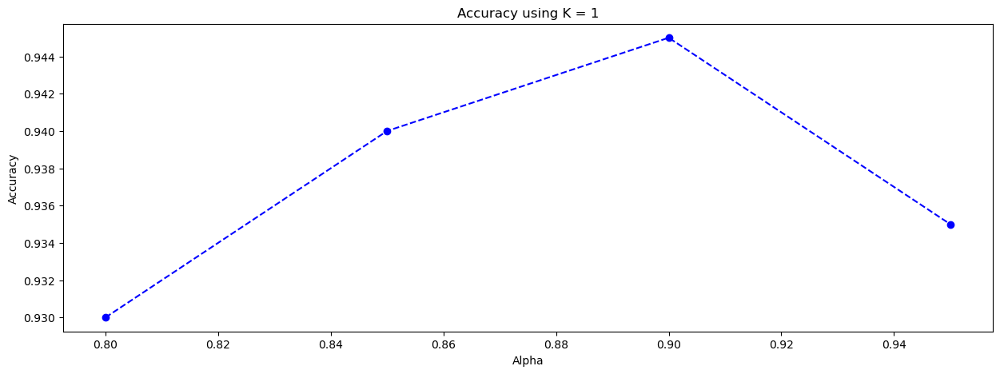

ACCURACY FOR ALPHA:0.8 AND K = 3 IS :- 0.855
CONFUSION MATRIX:
[[3 1 0 ... 0 0 0]
 [0 5 0 ... 0 0 0]
 [0 0 4 ... 0 0 0]
 ...
 [0 0 0 ... 4 0 0]
 [0 0 0 ... 0 5 0]
 [0 0 0 ... 0 0 2]]
ACCURACY FOR ALPHA:0.85 AND K = 3 IS :- 0.855
CONFUSION MATRIX:
[[3 1 0 ... 0 0 0]
 [0 5 0 ... 0 0 0]
 [0 0 4 ... 0 0 0]
 ...
 [0 0 0 ... 4 0 0]
 [0 0 0 ... 0 5 0]
 [0 0 0 ... 0 0 2]]
ACCURACY FOR ALPHA:0.9 AND K = 3 IS :- 0.85
CONFUSION MATRIX:
[[3 1 0 ... 0 0 0]
 [0 5 0 ... 0 0 0]
 [0 0 4 ... 0 0 0]
 ...
 [0 0 0 ... 4 0 0]
 [0 0 0 ... 0 5 0]
 [0 0 0 ... 0 0 2]]
ACCURACY FOR ALPHA:0.95 AND K = 3 IS :- 0.845
CONFUSION MATRIX:
[[3 1 0 ... 0 0 0]
 [0 5 0 ... 0 0 0]
 [0 0 4 ... 0 0 0]
 ...
 [0 0 0 ... 4 0 0]
 [0 0 0 ... 0 5 0]
 [0 0 0 ... 0 0 2]]
Done for k = 3



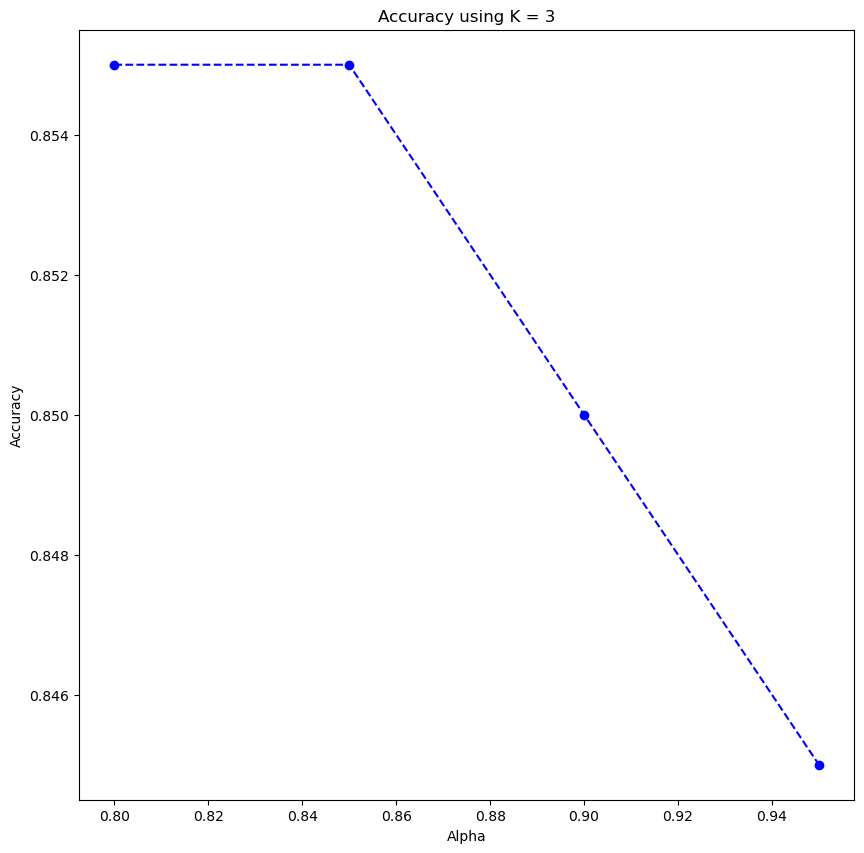

ACCURACY FOR ALPHA:0.8 AND K = 5 IS :- 0.805
CONFUSION MATRIX:
[[3 1 0 ... 0 0 0]
 [0 5 0 ... 0 0 0]
 [0 0 4 ... 0 0 0]
 ...
 [0 0 0 ... 4 0 0]
 [0 0 0 ... 0 4 0]
 [0 0 0 ... 0 0 1]]
ACCURACY FOR ALPHA:0.85 AND K = 5 IS :- 0.83
CONFUSION MATRIX:
[[3 1 0 ... 0 0 0]
 [0 5 0 ... 0 0 0]
 [0 0 4 ... 0 0 0]
 ...
 [0 0 0 ... 5 0 0]
 [0 0 0 ... 0 4 0]
 [0 0 0 ... 0 0 1]]
ACCURACY FOR ALPHA:0.9 AND K = 5 IS :- 0.815
CONFUSION MATRIX:
[[3 1 0 ... 0 0 0]
 [0 5 0 ... 0 0 0]
 [0 0 4 ... 0 0 0]
 ...
 [0 0 0 ... 4 0 0]
 [0 0 0 ... 0 4 0]
 [0 0 0 ... 0 0 1]]
ACCURACY FOR ALPHA:0.95 AND K = 5 IS :- 0.815
CONFUSION MATRIX:
[[3 1 0 ... 0 0 0]
 [0 5 0 ... 0 0 0]
 [0 0 4 ... 0 0 0]
 ...
 [0 0 0 ... 4 0 0]
 [0 0 0 ... 0 4 0]
 [0 0 0 ... 0 0 1]]
Done for k = 5



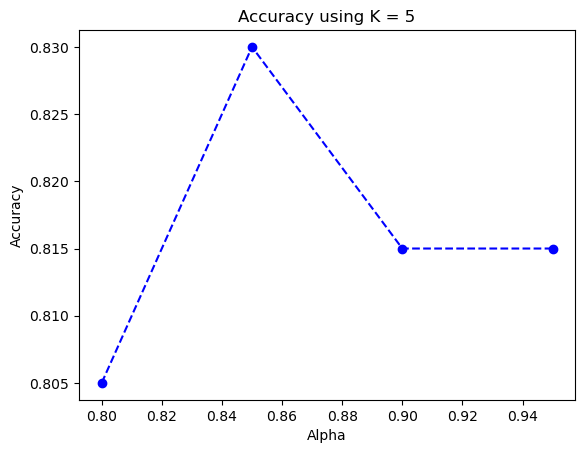

ACCURACY FOR ALPHA:0.8 AND K = 7 IS :- 0.78
CONFUSION MATRIX:
[[3 2 0 ... 0 0 0]
 [0 5 0 ... 0 0 0]
 [0 0 5 ... 0 0 0]
 ...
 [0 0 0 ... 5 0 0]
 [0 0 0 ... 0 3 0]
 [0 0 0 ... 0 0 0]]
ACCURACY FOR ALPHA:0.85 AND K = 7 IS :- 0.775
CONFUSION MATRIX:
[[3 1 0 ... 0 0 0]
 [0 5 0 ... 0 0 0]
 [0 0 5 ... 0 0 0]
 ...
 [0 0 0 ... 5 0 0]
 [0 0 0 ... 0 4 0]
 [0 0 0 ... 0 0 0]]
ACCURACY FOR ALPHA:0.9 AND K = 7 IS :- 0.755
CONFUSION MATRIX:
[[3 1 0 ... 0 0 0]
 [0 5 0 ... 0 0 0]
 [0 0 5 ... 0 0 0]
 ...
 [0 0 0 ... 5 0 0]
 [0 0 0 ... 0 4 0]
 [0 0 0 ... 0 0 1]]
ACCURACY FOR ALPHA:0.95 AND K = 7 IS :- 0.74
CONFUSION MATRIX:
[[3 1 0 ... 0 0 0]
 [0 5 0 ... 0 0 0]
 [0 0 4 ... 0 0 0]
 ...
 [0 0 0 ... 5 0 0]
 [0 0 0 ... 0 4 0]
 [0 0 0 ... 0 0 1]]
Done for k = 7



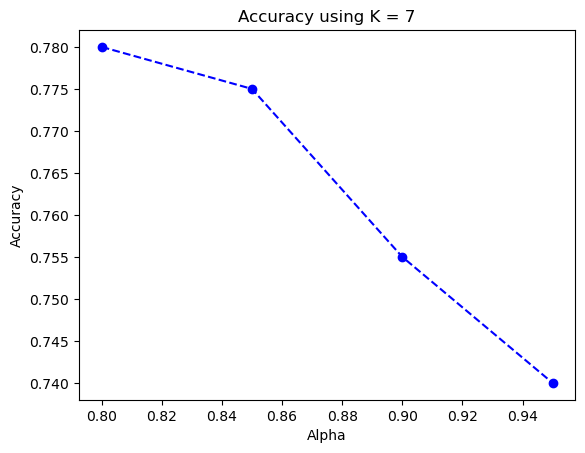

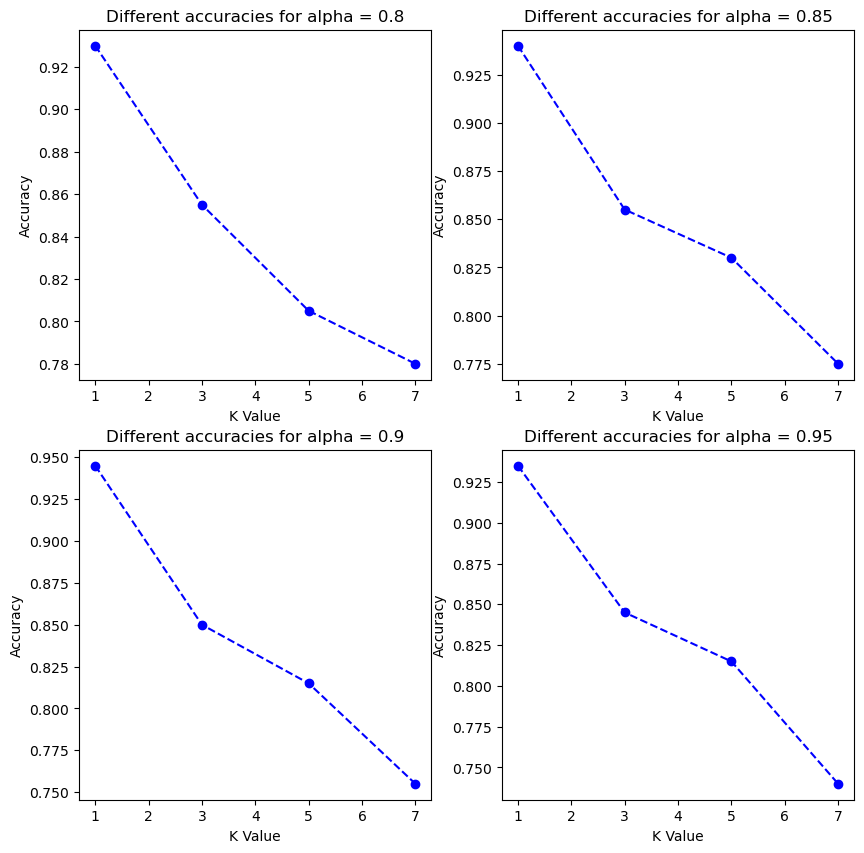

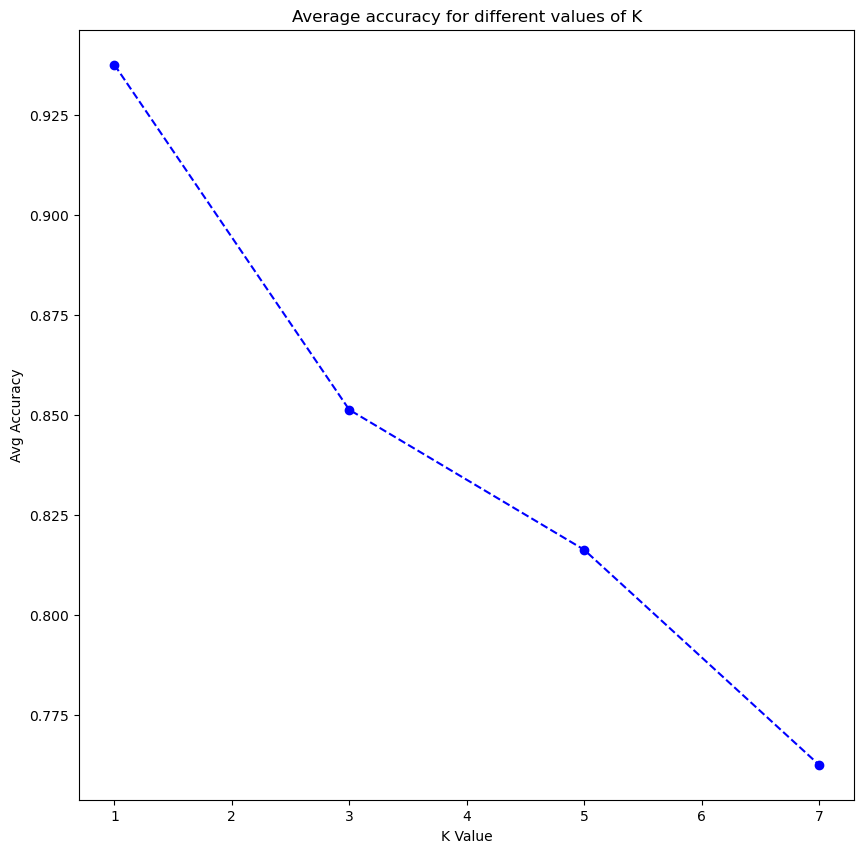

In [13]:
test_pca(cp.asarray(X_train),cp.asarray(X_test),cp.asarray(y_train),cp.asarray(y_test),0)

##LDA

In [14]:
def project(data,proj_matrix):
  return np.dot(proj_matrix,data.T).T

In [15]:
def binary_lda(train_data,test_data,X_train,X_test,eigenvectors):
    classes_means=np.zeros((2,10304))
    classes_matrix=[]
    for i in range(2):
        class_matrix=train_data[train_data['target']==(i+1)]
        class_matrix=class_matrix.drop(['target'], axis=1)
        class_matrix2=np.asarray(class_matrix).astype('float64')
        classes_matrix.append(class_matrix2)
        class_mean=np.mean(class_matrix2,axis=0,keepdims=True)
        classes_means[i]=class_mean
    Z=[]
    for i in range(2):
        centered=cp.asarray(classes_matrix[i])-cp.asarray(classes_means[i])
        Z.append(centered)
    all_classes_mean = np.mean(train_data, axis=0)
    all_classes_mean = all_classes_mean[:-1]
    all_classes_mean=np.asarray(all_classes_mean).astype('float64')
    Sb=cp.zeros((10304,10304))
    all_classes_mean=all_classes_mean.reshape(10304,1)
    for i in range(2):
        class_mean=classes_means[i].reshape(10304,1)
        print("Number of samples in class "+str(i)+" equal "+str(len(classes_matrix[i])))
        Sb+=len(classes_matrix[i])*np.dot((cp.asarray(class_mean)-cp.asarray(all_classes_mean)),(cp.asarray(class_mean)-cp.asarray(all_classes_mean)).T)
    S=np.ones((10304,10304))
    for i in range(2):
        S+=np.dot(cp.asnumpy(Z[i].T),cp.asnumpy(Z[i]))
    eig_values,eig_vectors=cp.linalg.eigh(cp.dot(cp.asarray(np.linalg.inv(S)),Sb))
    eig_values = eig_values[::-1]
    eig_vectors = eig_vectors[:,::-1]
    selected=eig_vectors[:,:eigenvectors]
    train_proj,test_proj=project(X_train,selected.T),project(X_test,selected.T)
    return train_proj,test_proj

In [16]:
def get_classes_means(X_train,train_size):
  classes_means=np.zeros((40,10304))
  classes_matrix=[] # to be used in another steps
  for i in range(40):
    class_matrix=X_train[i*train_size:(i+1)*train_size,:]
    classes_matrix.append(class_matrix)
    class_mean=np.mean(class_matrix,axis=0,keepdims=True)
    classes_means[i]=class_mean.get()
  return classes_means,classes_matrix
def between_class_scatter(X_train,classes_means,train_size):
  all_classes_mean=np.mean(X_train,axis=0,keepdims=True)
  Sb=cp.zeros((10304,10304))
  all_classes_mean=all_classes_mean.reshape(10304,1)
  for i in range(40):
    class_mean=classes_means[i].reshape(10304,1)
    Sb+=train_size*np.dot((cp.asarray(class_mean)-cp.asarray(all_classes_mean)),(cp.asarray(class_mean)-cp.asarray(all_classes_mean)).T)
  return Sb
def center_class_matrix(classes_matrix,classes_means):
  Z=[]
  for i in range(40):
    centered=cp.asarray(classes_matrix[i])-cp.asarray(classes_means[i])
    Z.append(centered)
  return Z
def class_scatter_matrix(Z):
  S=np.ones((10304,10304))
  for i in range(40):
    S+=np.dot(cp.asnumpy(Z[i].T),cp.asnumpy(Z[i]))
  return S
def LDA(X_train,X_test,eigenvectors,train_size):
  classes_means,classes_matrix=get_classes_means(X_train,train_size)
  Sb=between_class_scatter(X_train,classes_means,train_size)
  Z=center_class_matrix(classes_matrix,classes_means)
  S=class_scatter_matrix(Z)
  eig_values,eig_vectors=cp.linalg.eigh(cp.dot(cp.asarray(np.linalg.inv(S)),Sb))
  eig_values = eig_values[::-1]
  eig_vectors = eig_vectors[:,::-1]
  selected=eig_vectors[:,:eigenvectors]
  train_proj,test_proj=project(X_train,selected.T),project(X_test,selected.T)
  return train_proj,test_proj
     

In [17]:
def test_lda(X_train,X_test,y_train,y_test,eigenvectors,train_size,show_failure,binary):
  if binary==0:
    train_proj,test_proj=LDA(X_train,X_test,eigenvectors,train_size)
  else:
    feature_names = [str(i) for i in range(10304)]
    train_data = pd.DataFrame(data=cp.concatenate((X_train, y_train.reshape(-1, 1)), axis=1), columns=feature_names + ['target'])
    test_data = pd.DataFrame(data=cp.concatenate((X_test, y_test.reshape(-1, 1)), axis=1), columns=feature_names + ['target'])
    train_proj,test_proj=binary_lda(train_data,test_data,X_train,X_test,eigenvectors)
  Ks=[1,3,5,7]
  lda_accuracies=[]
  for k in Ks:
    model=KNeighborsClassifier(n_neighbors=k)
    model.fit(train_proj.get(), y_train.get())
    test_pred = model.predict(test_proj.get())
    acc=accuracy_score(y_test.get(), test_pred)
    print("Accuracy using k = "+str(k)+" = "+str(acc))
    lda_accuracies.append(acc)
    cm=confusion_matrix(y_test.get(),test_pred)
    print("CONFUSION MATRIX:")
    print(cm)
    print("=============")
    if show_failure == 1:
      accu=classify_and_show_failure(train_proj.get(), y_train.get(), test_proj.get(),X_test, y_test.get(), k)
  plt.figure(figsize=(10,5))
  plt.plot(Ks, lda_accuracies,'--bo', label='line with marker')
  plt.title("Tunung K parameter using LDA")
  plt.xlabel("K")
  plt.ylabel("Accuracy")
  plt.show()

Accuracy using k = 1 = 0.945
CONFUSION MATRIX:
[[4 0 0 ... 0 0 0]
 [0 5 0 ... 0 0 0]
 [0 0 5 ... 0 0 0]
 ...
 [0 0 0 ... 4 0 0]
 [0 0 0 ... 0 5 0]
 [0 0 0 ... 0 0 3]]
Accuracy using k = 3 = 0.86
CONFUSION MATRIX:
[[4 0 0 ... 0 0 0]
 [0 5 0 ... 0 0 0]
 [0 0 4 ... 0 0 0]
 ...
 [0 0 0 ... 5 0 0]
 [0 0 0 ... 0 4 0]
 [0 0 0 ... 0 0 2]]
Accuracy using k = 5 = 0.825
CONFUSION MATRIX:
[[4 0 0 ... 0 0 0]
 [0 5 0 ... 0 0 0]
 [0 0 4 ... 0 0 0]
 ...
 [0 0 0 ... 5 0 0]
 [0 0 0 ... 0 4 0]
 [0 0 0 ... 0 0 2]]
Accuracy using k = 7 = 0.78
CONFUSION MATRIX:
[[4 0 0 ... 0 0 0]
 [0 5 0 ... 0 0 0]
 [0 0 4 ... 0 0 0]
 ...
 [0 0 0 ... 5 0 0]
 [0 0 0 ... 0 3 0]
 [0 0 0 ... 0 0 1]]


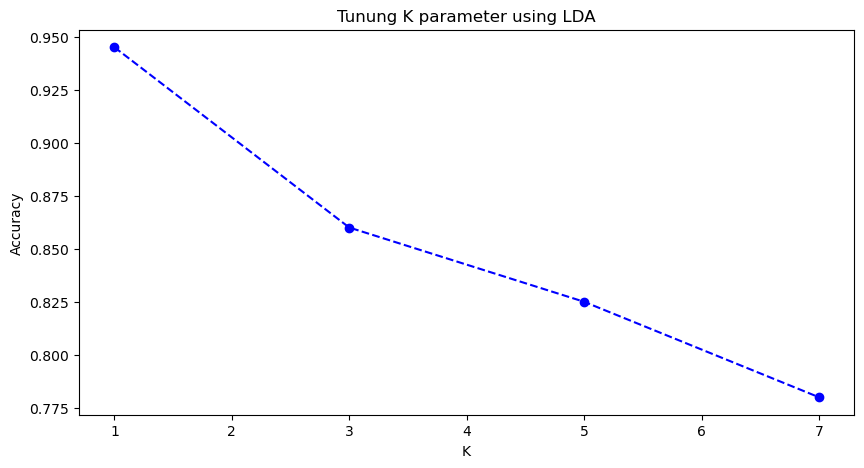

In [18]:
test_lda(cp.asarray(X_train),cp.asarray(X_test),cp.asarray(y_train),cp.asarray(y_test),39,5,0,0)

##Generate Non-face Data

In [19]:
# from IPython.display import clear_output
# Modify the first path to be the path of the data in your drive
# !unzip /content/drive/MyDrive/PatternRecognition/Assignment1Data/animals.zip -d /content/sample_data/animals
# clear_output(wait=False)

##Read Images

[ 46.  22.  21. ... 142. 128. 118.]


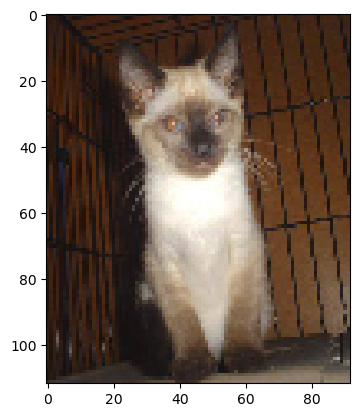

In [20]:
# from google.colab.patches import cv2_imshow
import cv2
img2 = plt.imread('/kaggle/input/animals/animals/647.jpg',0)
img2=cv2.resize(img2,(92,112))
print(np.array(img2, dtype='float64').flatten())
plt.imshow(img2,cmap='gray',vmin=0, vmax=255)
# failure = plt.imread('/content/sample_data/animalss/animals/647.jpg',0) # zero for gray scale
# plt.imshow(failure,cmap='gray')

In [21]:
images1 = np.ones((1, 10304))
labels1=np.array([])
photos=[i for i in range(1, 800+1)]
for photo in photos:
    img1 = cv2.imread('/kaggle/input/animals/animals/'+str(photo)+".jpg",0) # zero for gray scale
    img1 = np.resize(img1,(92,112))
    img1 = np.reshape(img1, (1, 10304))
    images1 = np.append(images1, img1, axis=0)
    labels1 = np.append(labels1, 2)
labels1=np.array(labels1)
images1=images1[1:,]

In [22]:
print(np.array(images1[3], dtype='float64').flatten())

[131. 132. 135. ... 215. 209. 205.]


In [23]:
print(images1.shape)
print(labels1.shape)

(800, 10304)
(800,)


##Adjusting first dataset's label

In [24]:
labels2= np.array([])
for i in range(1,401):
  labels2 = np.append(labels2,1)
labels2.shape

(400,)

##Adding both datasets

In [25]:
images

array([[ 48.,  49.,  45., ...,  47.,  46.,  46.],
       [ 60.,  60.,  62., ...,  32.,  34.,  34.],
       [ 39.,  44.,  53., ...,  29.,  26.,  29.],
       ...,
       [125., 119., 124., ...,  36.,  39.,  40.],
       [119., 120., 120., ...,  89.,  94.,  85.],
       [125., 124., 124., ...,  36.,  35.,  34.]])

In [26]:
total_images= np.concatenate((images, images1))
total_labels= np.concatenate((labels2, labels1)) # Selmy 3amelha sa7

In [27]:
print(total_images.shape)
total_labels.shape

(1200, 10304)


(1200,)

##Train-Test Split

In [28]:
X_train1=total_images[1::2] # Odd
X_test1=total_images[0::2]  # Even
y_train1=total_labels[1::2] # Odd
y_test1=total_labels[0::2]  # Even

##Checking dimensions

In [29]:
print(X_train1.shape)
print(X_test1.shape)
print(X_train1[1])
print(y_train1[1])

(600, 10304)
(600, 10304)
[63. 53. 35. ... 41. 10. 24.]
1.0


## LDA Face vs non face 400 and (100,200,300,400,600,800)

RUNNING PCA AND LDA WITH NONFACES = 100
-------------------------------------
-------------------------------------
================PCA================
Eigenvectors shape = (10304, 10304)
r =  35
U shape = (10304, 35)
projected_training shape = (250, 35)
projected_testing shape = (250, 35)
ACCURACY FOR ALPHA:0.8 AND K = 1 IS :- 0.9
CONFUSION MATRIX:
[[200   0]
 [ 25  25]]
Eigenvectors shape = (10304, 10304)
r =  51
U shape = (10304, 51)
projected_training shape = (250, 51)
projected_testing shape = (250, 51)
ACCURACY FOR ALPHA:0.85 AND K = 1 IS :- 0.9
CONFUSION MATRIX:
[[200   0]
 [ 25  25]]
Eigenvectors shape = (10304, 10304)
r =  77
U shape = (10304, 77)
projected_training shape = (250, 77)
projected_testing shape = (250, 77)
ACCURACY FOR ALPHA:0.9 AND K = 1 IS :- 0.888
CONFUSION MATRIX:
[[200   0]
 [ 28  22]]
Eigenvectors shape = (10304, 10304)
r =  125
U shape = (10304, 125)
projected_training shape = (250, 125)
projected_testing shape = (250, 125)
ACCURACY FOR ALPHA:0.95 AND K = 1

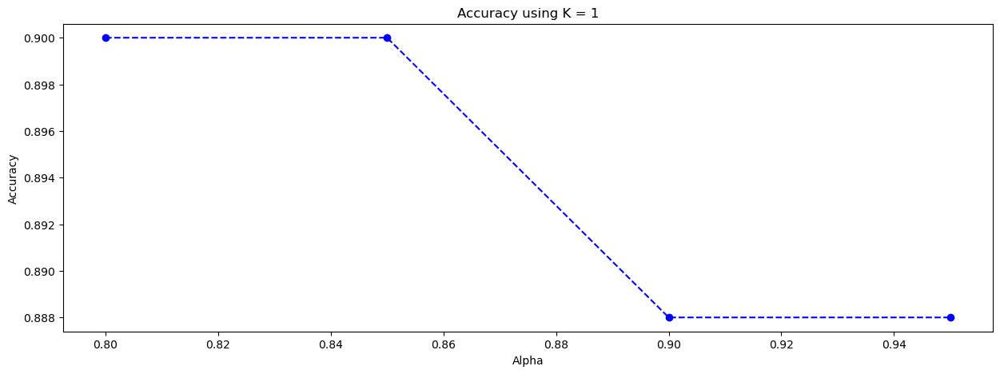

ACCURACY FOR ALPHA:0.8 AND K = 3 IS :- 0.888
CONFUSION MATRIX:
[[200   0]
 [ 28  22]]
ACCURACY FOR ALPHA:0.85 AND K = 3 IS :- 0.884
CONFUSION MATRIX:
[[200   0]
 [ 29  21]]
ACCURACY FOR ALPHA:0.9 AND K = 3 IS :- 0.868
CONFUSION MATRIX:
[[200   0]
 [ 33  17]]
ACCURACY FOR ALPHA:0.95 AND K = 3 IS :- 0.86
CONFUSION MATRIX:
[[200   0]
 [ 35  15]]
Done for k = 3



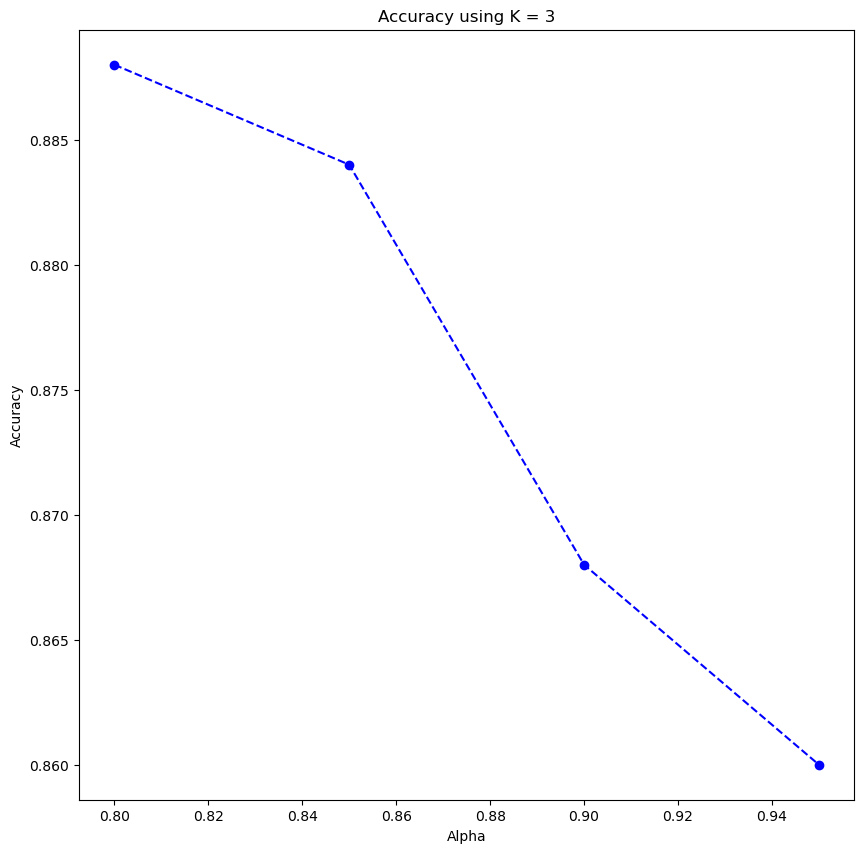

ACCURACY FOR ALPHA:0.8 AND K = 5 IS :- 0.88
CONFUSION MATRIX:
[[200   0]
 [ 30  20]]
ACCURACY FOR ALPHA:0.85 AND K = 5 IS :- 0.876
CONFUSION MATRIX:
[[200   0]
 [ 31  19]]
ACCURACY FOR ALPHA:0.9 AND K = 5 IS :- 0.856
CONFUSION MATRIX:
[[200   0]
 [ 36  14]]
ACCURACY FOR ALPHA:0.95 AND K = 5 IS :- 0.852
CONFUSION MATRIX:
[[200   0]
 [ 37  13]]
Done for k = 5



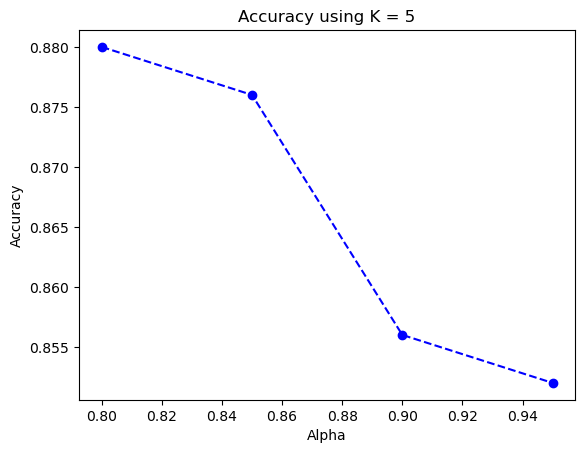

ACCURACY FOR ALPHA:0.8 AND K = 7 IS :- 0.872
CONFUSION MATRIX:
[[200   0]
 [ 32  18]]
ACCURACY FOR ALPHA:0.85 AND K = 7 IS :- 0.86
CONFUSION MATRIX:
[[200   0]
 [ 35  15]]
ACCURACY FOR ALPHA:0.9 AND K = 7 IS :- 0.852
CONFUSION MATRIX:
[[200   0]
 [ 37  13]]
ACCURACY FOR ALPHA:0.95 AND K = 7 IS :- 0.844
CONFUSION MATRIX:
[[200   0]
 [ 39  11]]
Done for k = 7



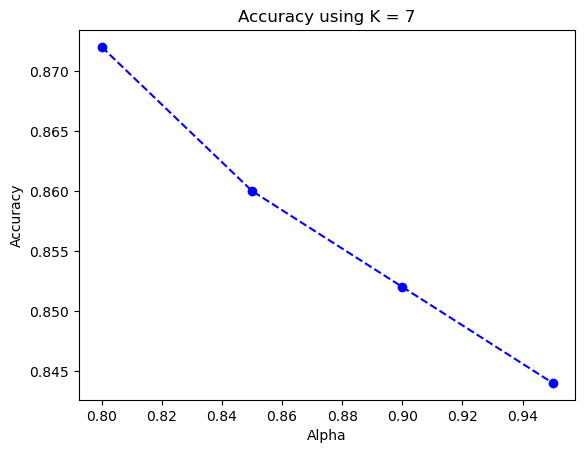

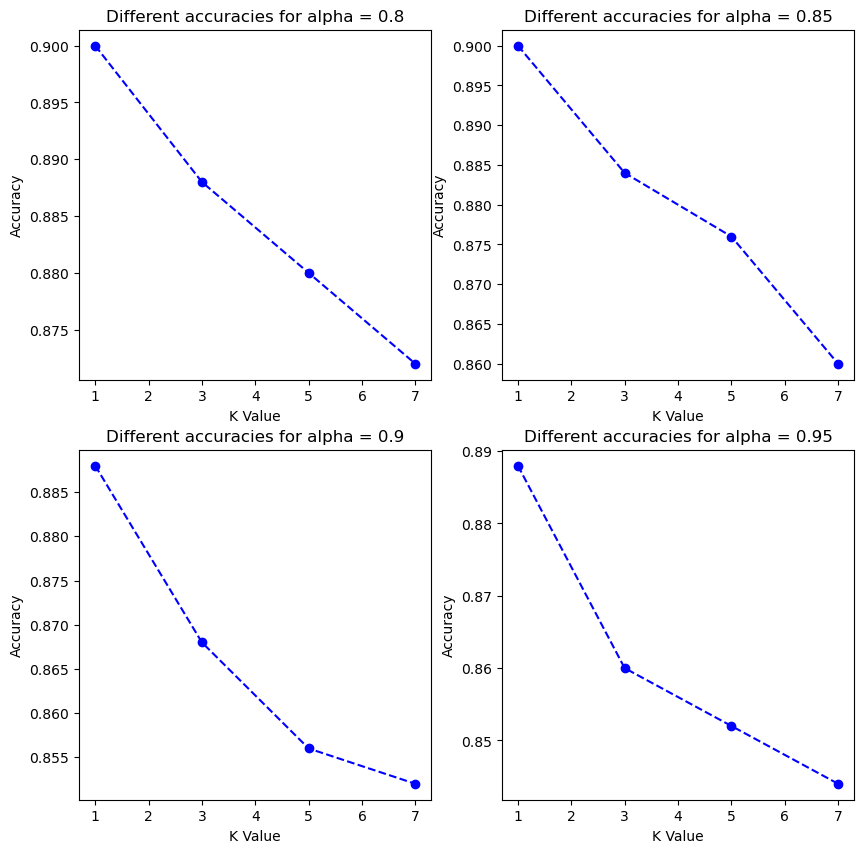

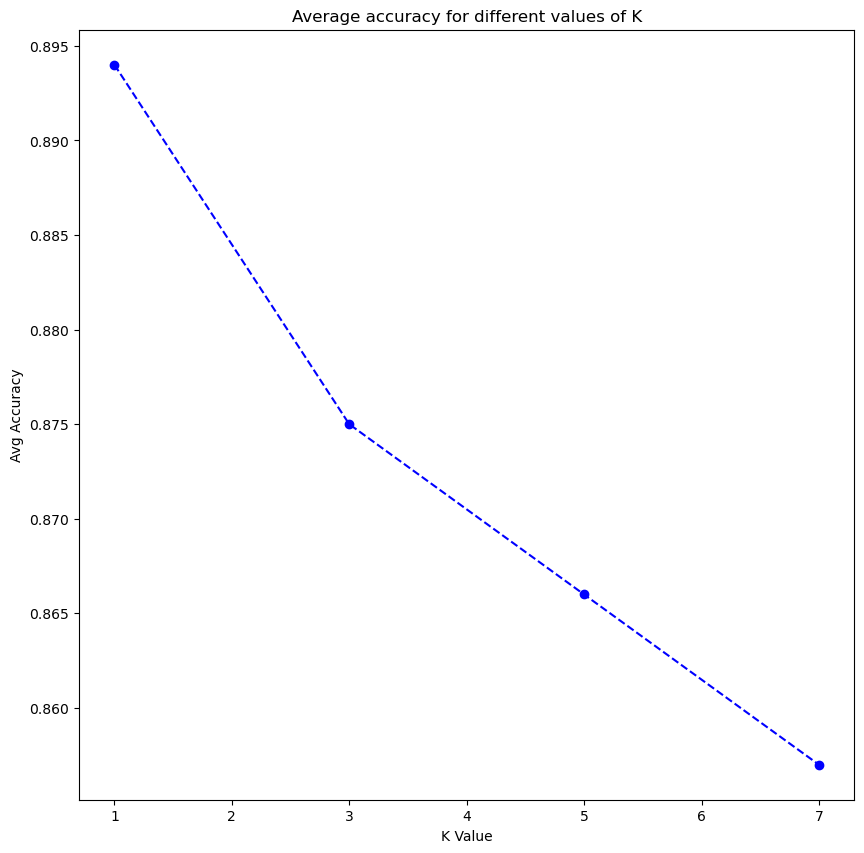

================LDA================
Number of samples in class 0 equal 200
Number of samples in class 1 equal 50
Accuracy using k = 1 = 0.884
CONFUSION MATRIX:
[[188  12]
 [ 17  33]]
Accuracy using k = 3 = 0.916
CONFUSION MATRIX:
[[198   2]
 [ 19  31]]
Accuracy using k = 5 = 0.916
CONFUSION MATRIX:
[[198   2]
 [ 19  31]]
Accuracy using k = 7 = 0.908
CONFUSION MATRIX:
[[200   0]
 [ 23  27]]


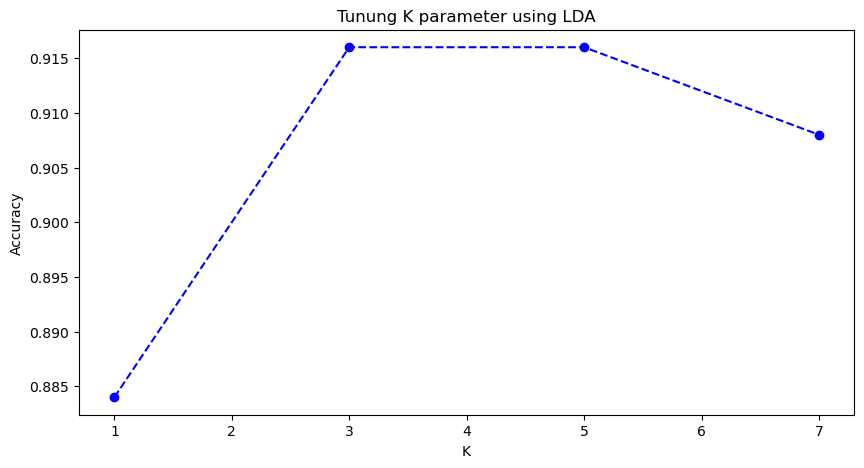

RUNNING PCA AND LDA WITH NONFACES = 200
-------------------------------------
-------------------------------------
================PCA================
Eigenvectors shape = (10304, 10304)
r =  35
U shape = (10304, 35)
projected_training shape = (300, 35)
projected_testing shape = (300, 35)
ACCURACY FOR ALPHA:0.8 AND K = 1 IS :- 0.9
CONFUSION MATRIX:
[[200   0]
 [ 30  70]]
Eigenvectors shape = (10304, 10304)
r =  53
U shape = (10304, 53)
projected_training shape = (300, 53)
projected_testing shape = (300, 53)
ACCURACY FOR ALPHA:0.85 AND K = 1 IS :- 0.8833333333333333
CONFUSION MATRIX:
[[200   0]
 [ 35  65]]
Eigenvectors shape = (10304, 10304)
r =  83
U shape = (10304, 83)
projected_training shape = (300, 83)
projected_testing shape = (300, 83)
ACCURACY FOR ALPHA:0.9 AND K = 1 IS :- 0.87
CONFUSION MATRIX:
[[200   0]
 [ 39  61]]
Eigenvectors shape = (10304, 10304)
r =  140
U shape = (10304, 140)
projected_training shape = (300, 140)
projected_testing shape = (300, 140)
ACCURACY FOR ALPHA:

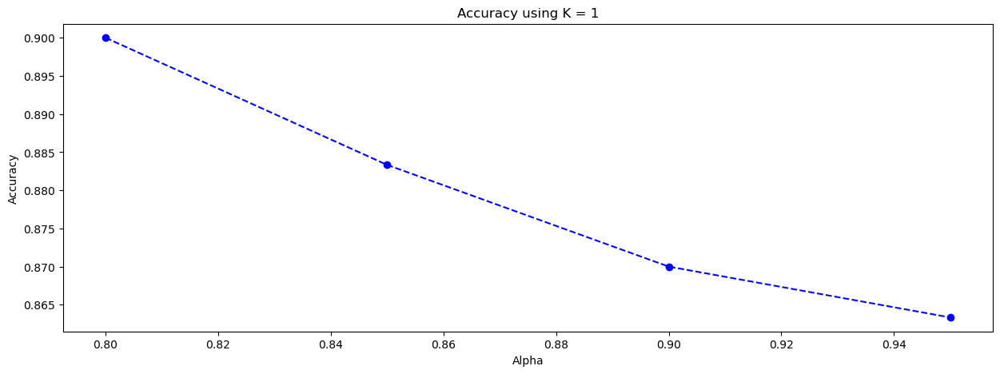

ACCURACY FOR ALPHA:0.8 AND K = 3 IS :- 0.87
CONFUSION MATRIX:
[[200   0]
 [ 39  61]]
ACCURACY FOR ALPHA:0.85 AND K = 3 IS :- 0.8566666666666667
CONFUSION MATRIX:
[[200   0]
 [ 43  57]]
ACCURACY FOR ALPHA:0.9 AND K = 3 IS :- 0.84
CONFUSION MATRIX:
[[200   0]
 [ 48  52]]
ACCURACY FOR ALPHA:0.95 AND K = 3 IS :- 0.8266666666666667
CONFUSION MATRIX:
[[200   0]
 [ 52  48]]
Done for k = 3



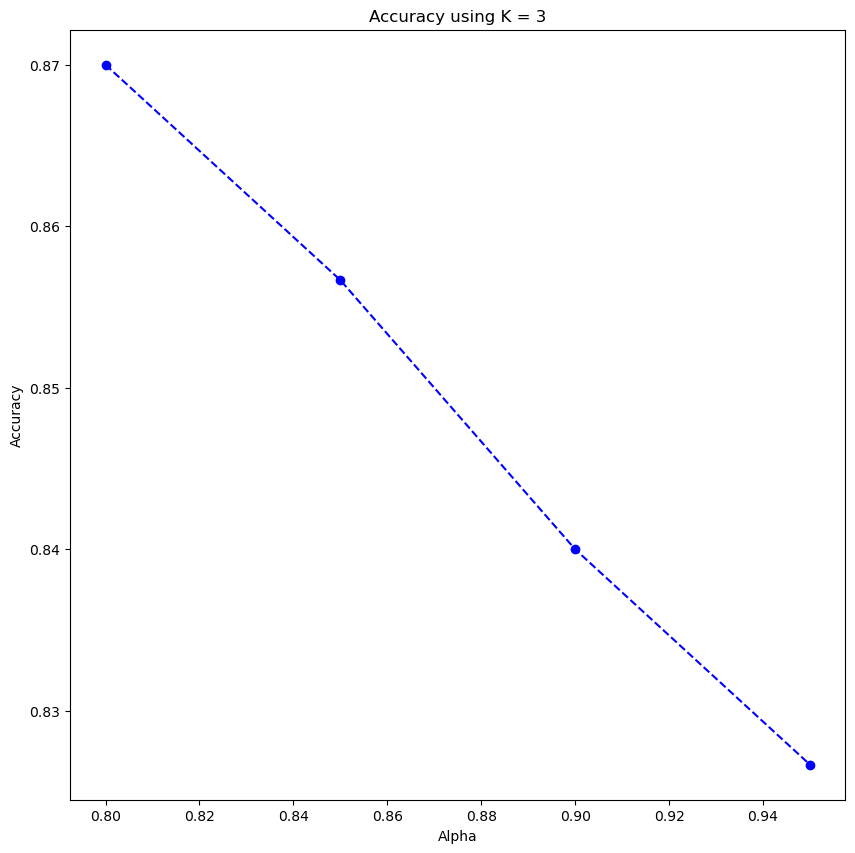

ACCURACY FOR ALPHA:0.8 AND K = 5 IS :- 0.8666666666666667
CONFUSION MATRIX:
[[200   0]
 [ 40  60]]
ACCURACY FOR ALPHA:0.85 AND K = 5 IS :- 0.8433333333333334
CONFUSION MATRIX:
[[200   0]
 [ 47  53]]
ACCURACY FOR ALPHA:0.9 AND K = 5 IS :- 0.84
CONFUSION MATRIX:
[[200   0]
 [ 48  52]]
ACCURACY FOR ALPHA:0.95 AND K = 5 IS :- 0.8166666666666667
CONFUSION MATRIX:
[[200   0]
 [ 55  45]]
Done for k = 5



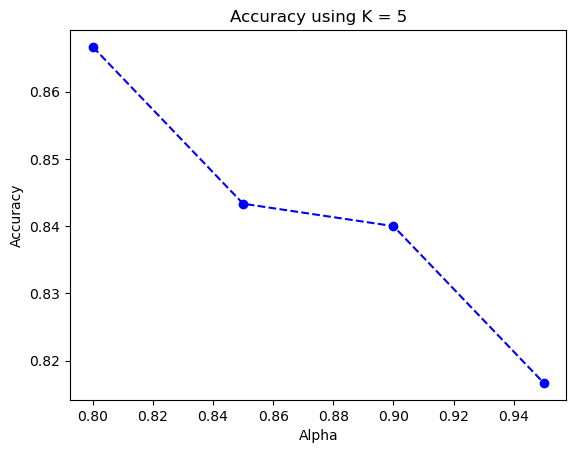

ACCURACY FOR ALPHA:0.8 AND K = 7 IS :- 0.8466666666666667
CONFUSION MATRIX:
[[200   0]
 [ 46  54]]
ACCURACY FOR ALPHA:0.85 AND K = 7 IS :- 0.8433333333333334
CONFUSION MATRIX:
[[200   0]
 [ 47  53]]
ACCURACY FOR ALPHA:0.9 AND K = 7 IS :- 0.83
CONFUSION MATRIX:
[[200   0]
 [ 51  49]]
ACCURACY FOR ALPHA:0.95 AND K = 7 IS :- 0.8066666666666666
CONFUSION MATRIX:
[[200   0]
 [ 58  42]]
Done for k = 7



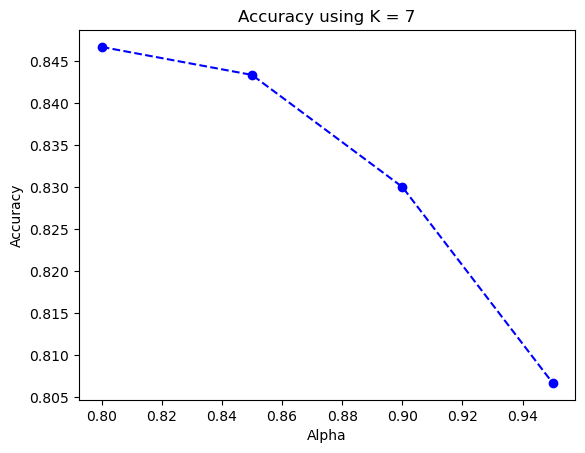

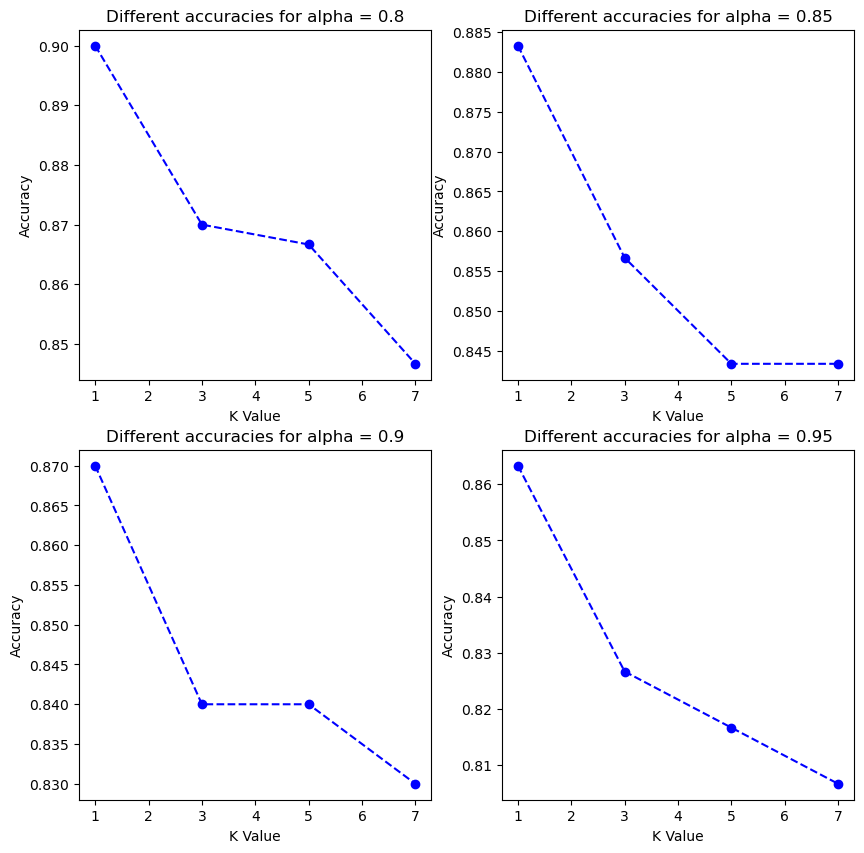

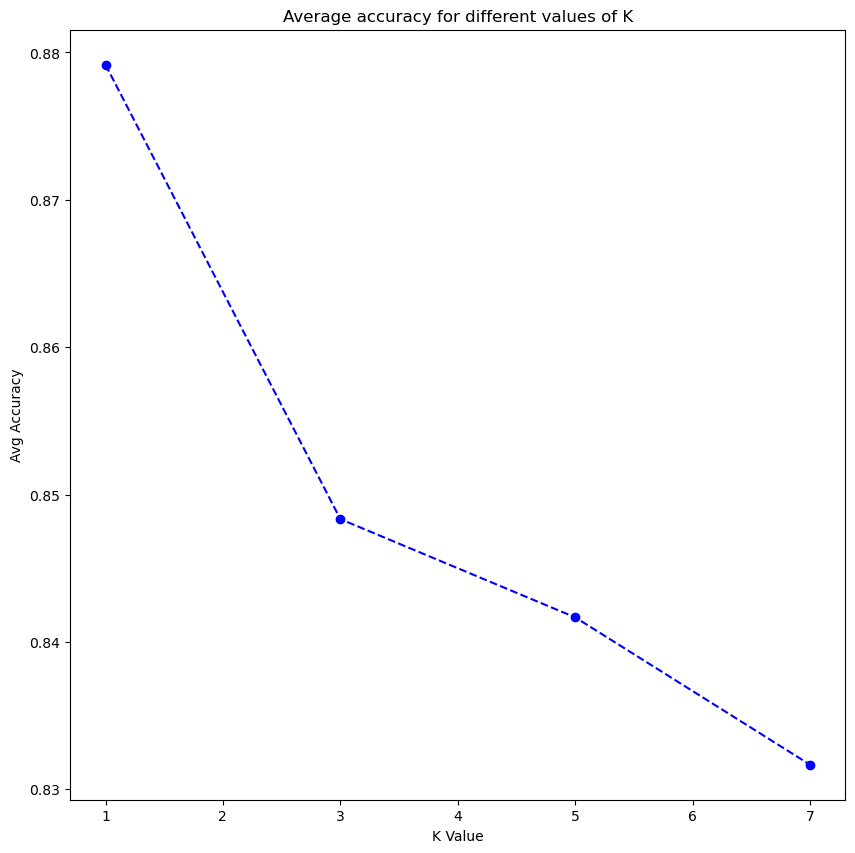

================LDA================
Number of samples in class 0 equal 200
Number of samples in class 1 equal 100
Accuracy using k = 1 = 0.8333333333333334
CONFUSION MATRIX:
[[181  19]
 [ 31  69]]
Accuracy using k = 3 = 0.8833333333333333
CONFUSION MATRIX:
[[196   4]
 [ 31  69]]
Accuracy using k = 5 = 0.8833333333333333
CONFUSION MATRIX:
[[195   5]
 [ 30  70]]
Accuracy using k = 7 = 0.87
CONFUSION MATRIX:
[[196   4]
 [ 35  65]]


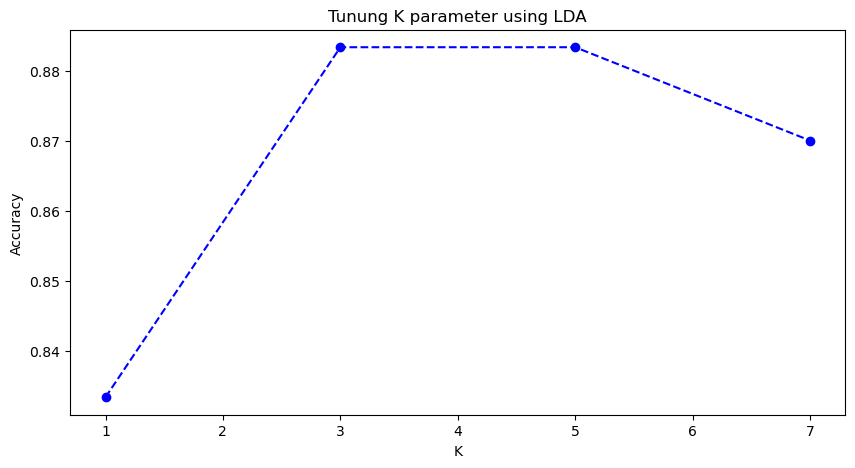

RUNNING PCA AND LDA WITH NONFACES = 300
-------------------------------------
-------------------------------------
================PCA================
Eigenvectors shape = (10304, 10304)
r =  38
U shape = (10304, 38)
projected_training shape = (350, 38)
projected_testing shape = (350, 38)
ACCURACY FOR ALPHA:0.8 AND K = 1 IS :- 0.9085714285714286
CONFUSION MATRIX:
[[200   0]
 [ 32 118]]
Eigenvectors shape = (10304, 10304)
r =  59
U shape = (10304, 59)
projected_training shape = (350, 59)
projected_testing shape = (350, 59)
ACCURACY FOR ALPHA:0.85 AND K = 1 IS :- 0.9
CONFUSION MATRIX:
[[200   0]
 [ 35 115]]
Eigenvectors shape = (10304, 10304)
r =  93
U shape = (10304, 93)
projected_training shape = (350, 93)
projected_testing shape = (350, 93)
ACCURACY FOR ALPHA:0.9 AND K = 1 IS :- 0.8742857142857143
CONFUSION MATRIX:
[[199   1]
 [ 43 107]]
Eigenvectors shape = (10304, 10304)
r =  158
U shape = (10304, 158)
projected_training shape = (350, 158)
projected_testing shape = (350, 158)
ACCUR

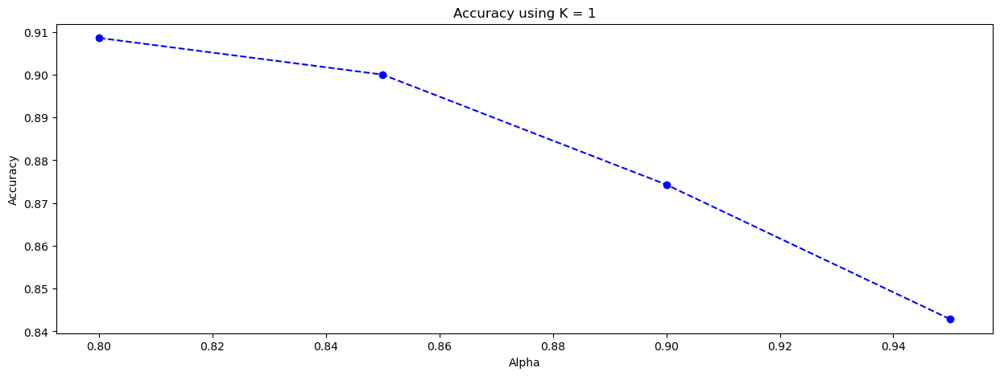

ACCURACY FOR ALPHA:0.8 AND K = 3 IS :- 0.8685714285714285
CONFUSION MATRIX:
[[200   0]
 [ 46 104]]
ACCURACY FOR ALPHA:0.85 AND K = 3 IS :- 0.8571428571428571
CONFUSION MATRIX:
[[200   0]
 [ 50 100]]
ACCURACY FOR ALPHA:0.9 AND K = 3 IS :- 0.8485714285714285
CONFUSION MATRIX:
[[200   0]
 [ 53  97]]
ACCURACY FOR ALPHA:0.95 AND K = 3 IS :- 0.8
CONFUSION MATRIX:
[[200   0]
 [ 70  80]]
Done for k = 3



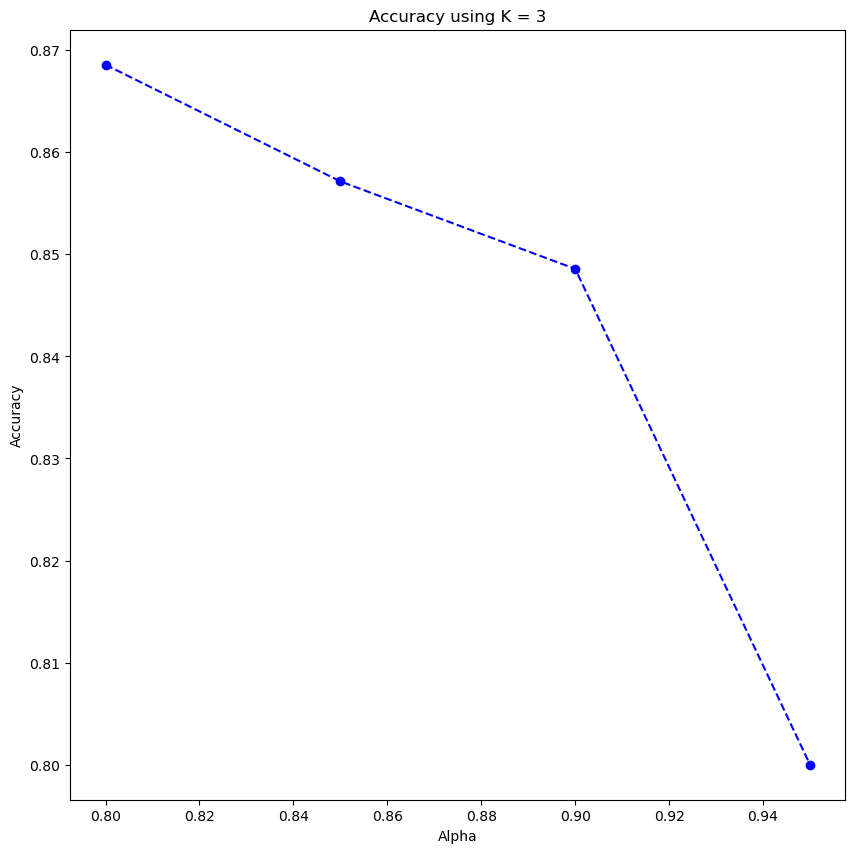

ACCURACY FOR ALPHA:0.8 AND K = 5 IS :- 0.8485714285714285
CONFUSION MATRIX:
[[200   0]
 [ 53  97]]
ACCURACY FOR ALPHA:0.85 AND K = 5 IS :- 0.84
CONFUSION MATRIX:
[[200   0]
 [ 56  94]]
ACCURACY FOR ALPHA:0.9 AND K = 5 IS :- 0.8285714285714286
CONFUSION MATRIX:
[[200   0]
 [ 60  90]]
ACCURACY FOR ALPHA:0.95 AND K = 5 IS :- 0.8
CONFUSION MATRIX:
[[200   0]
 [ 70  80]]
Done for k = 5



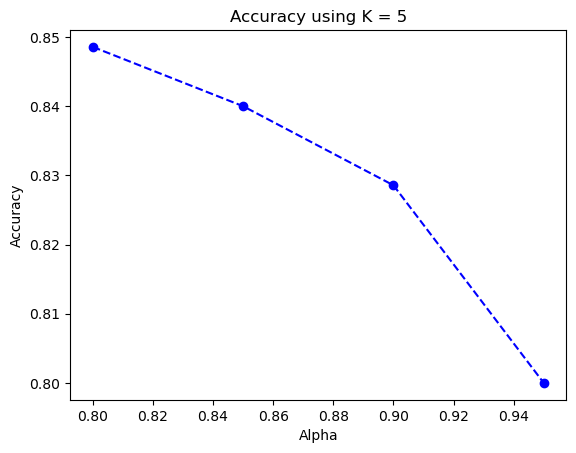

ACCURACY FOR ALPHA:0.8 AND K = 7 IS :- 0.8342857142857143
CONFUSION MATRIX:
[[200   0]
 [ 58  92]]
ACCURACY FOR ALPHA:0.85 AND K = 7 IS :- 0.82
CONFUSION MATRIX:
[[200   0]
 [ 63  87]]
ACCURACY FOR ALPHA:0.9 AND K = 7 IS :- 0.8028571428571428
CONFUSION MATRIX:
[[200   0]
 [ 69  81]]
ACCURACY FOR ALPHA:0.95 AND K = 7 IS :- 0.7914285714285715
CONFUSION MATRIX:
[[200   0]
 [ 73  77]]
Done for k = 7



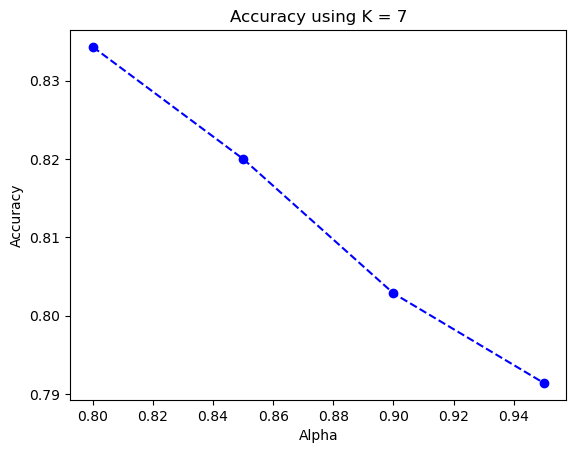

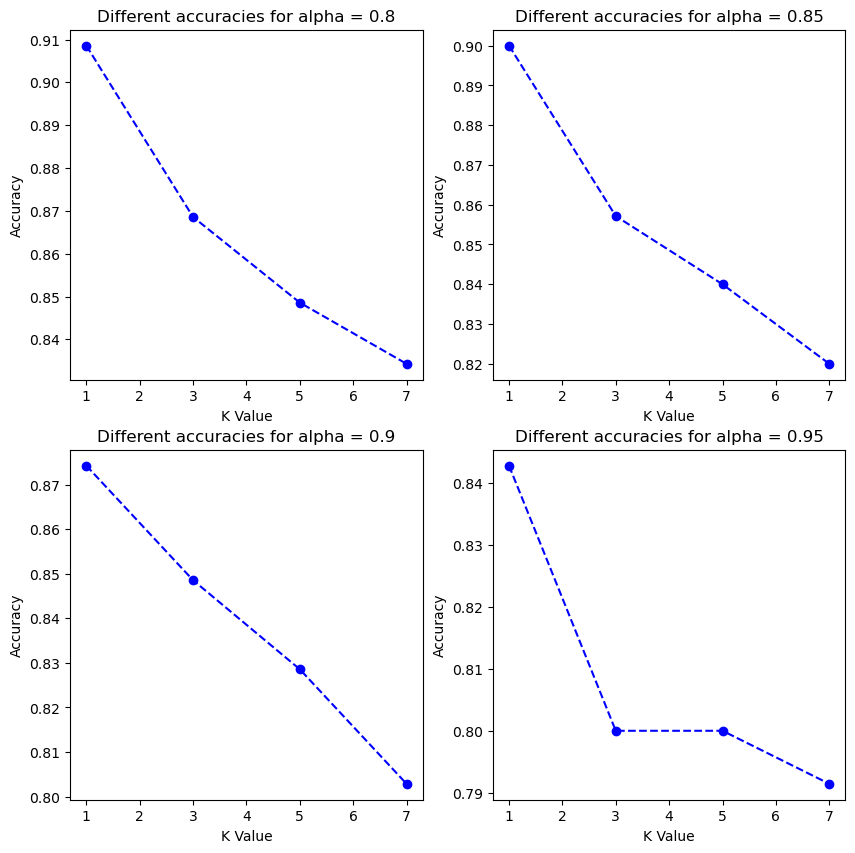

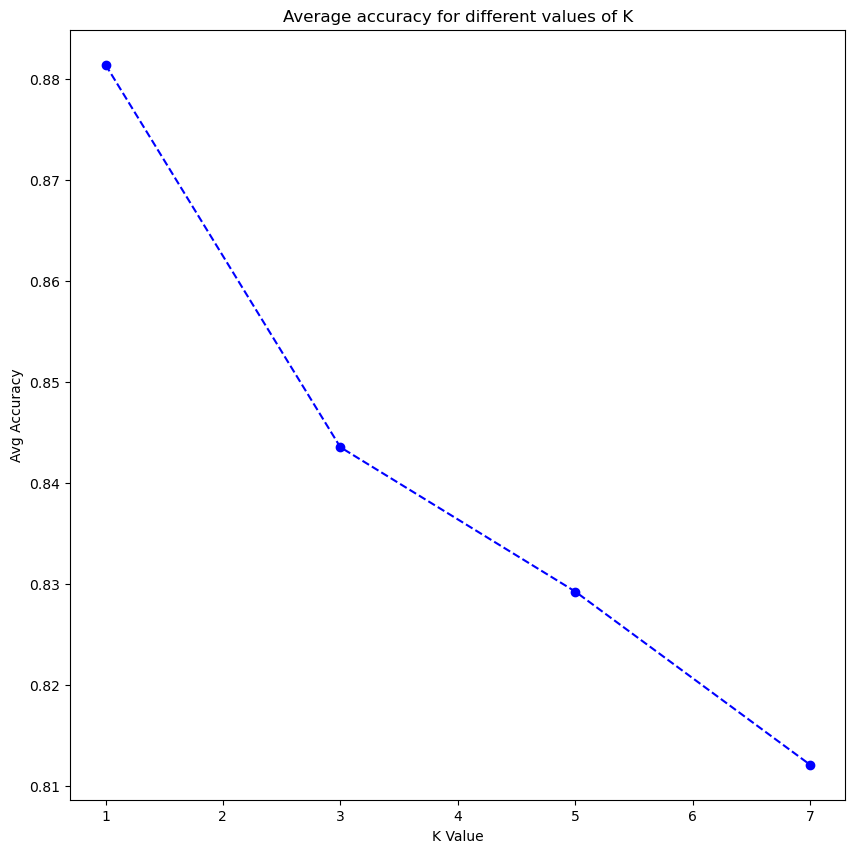

================LDA================
Number of samples in class 0 equal 200
Number of samples in class 1 equal 150
Accuracy using k = 1 = 0.8228571428571428
CONFUSION MATRIX:
[[180  20]
 [ 42 108]]
Accuracy using k = 3 = 0.8428571428571429
CONFUSION MATRIX:
[[188  12]
 [ 43 107]]
Accuracy using k = 5 = 0.8457142857142858
CONFUSION MATRIX:
[[190  10]
 [ 44 106]]
Accuracy using k = 7 = 0.8485714285714285
CONFUSION MATRIX:
[[195   5]
 [ 48 102]]


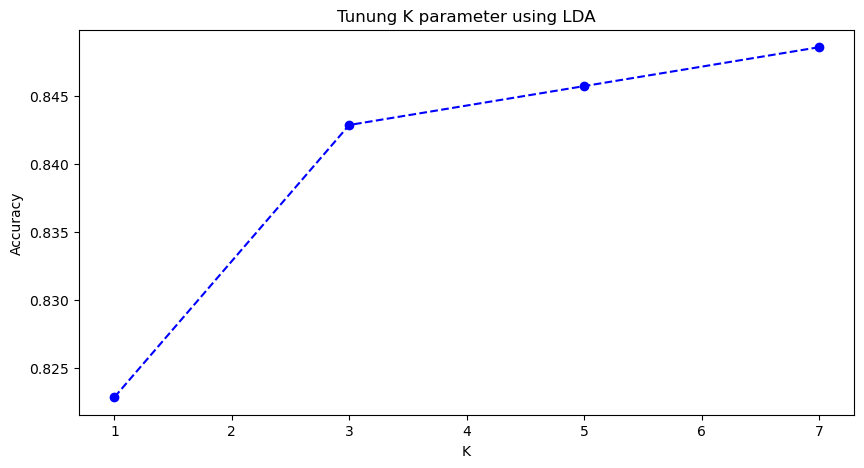

RUNNING PCA AND LDA WITH NONFACES = 400
-------------------------------------
-------------------------------------
================PCA================
Eigenvectors shape = (10304, 10304)
r =  42
U shape = (10304, 42)
projected_training shape = (400, 42)
projected_testing shape = (400, 42)
ACCURACY FOR ALPHA:0.8 AND K = 1 IS :- 0.93
CONFUSION MATRIX:
[[200   0]
 [ 28 172]]
Failure Case
219
Predicted face but actual is non face


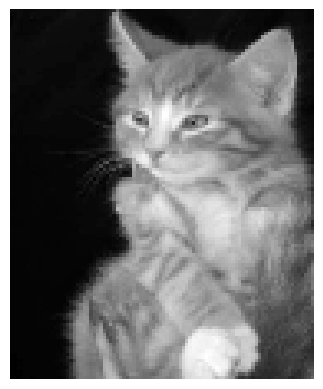

Failure Case
220
Predicted face but actual is non face


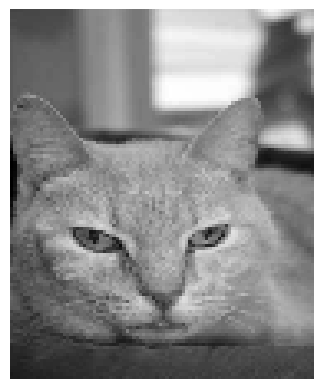

Failure Case
222
Predicted face but actual is non face


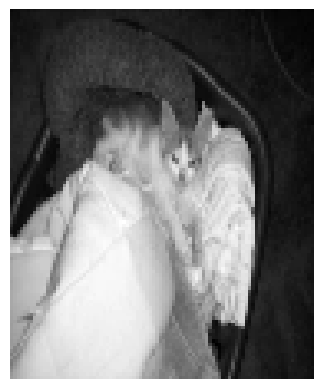

Failure Case
224
Predicted face but actual is non face


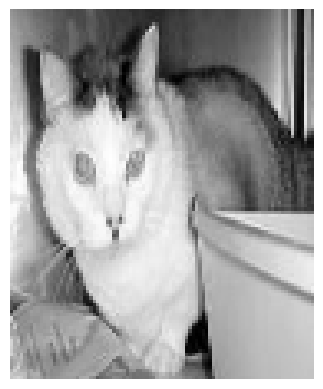

Failure Case
225
Predicted face but actual is non face


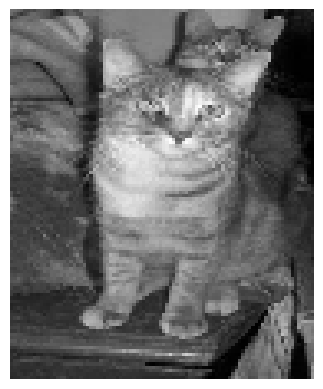

Failure Case
228
Predicted face but actual is non face


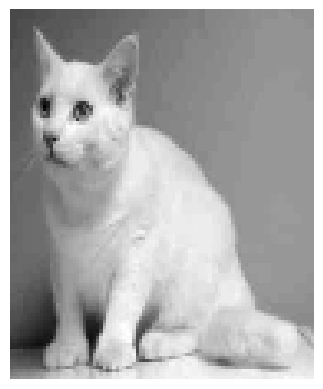

Failure Case
234
Predicted face but actual is non face


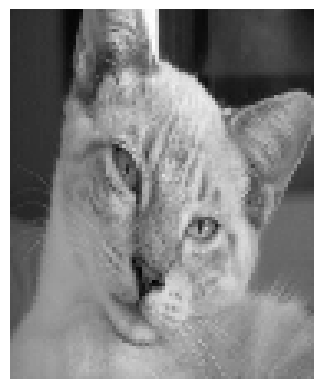

Failure Case
241
Predicted face but actual is non face


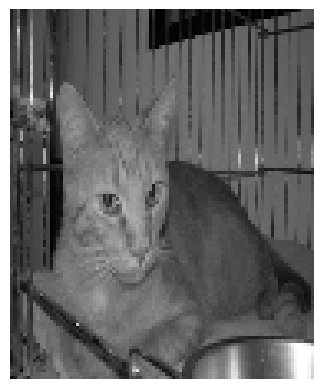

Failure Case
246
Predicted face but actual is non face


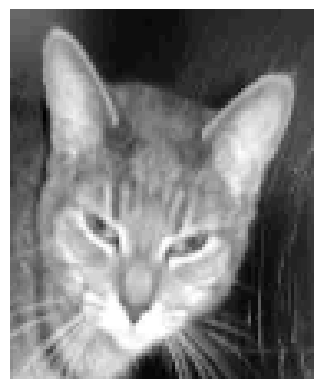

Failure Case
247
Predicted face but actual is non face


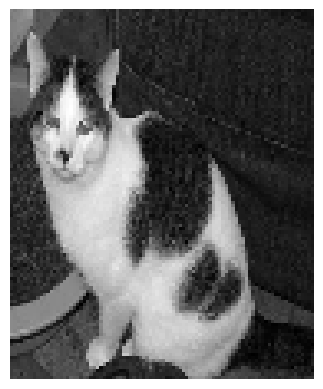

Failure Case
255
Predicted face but actual is non face


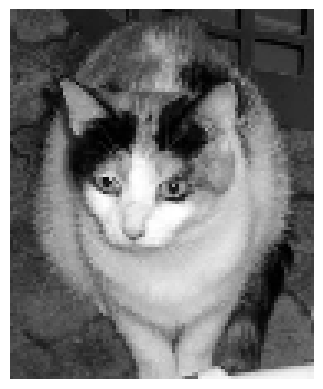

Failure Case
260
Predicted face but actual is non face


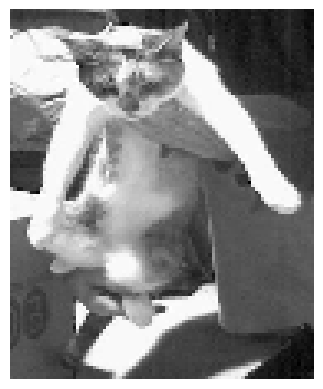

Failure Case
270
Predicted face but actual is non face


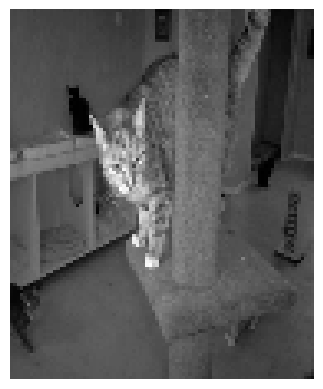

Failure Case
291
Predicted face but actual is non face


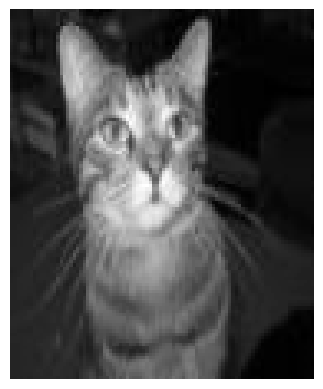

Failure Case
299
Predicted face but actual is non face


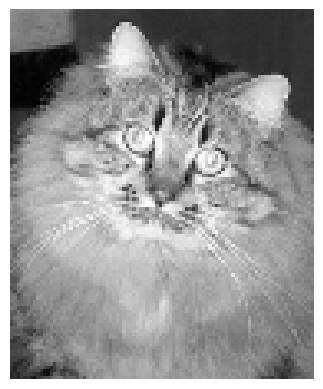

Failure Case
302
Predicted face but actual is non face


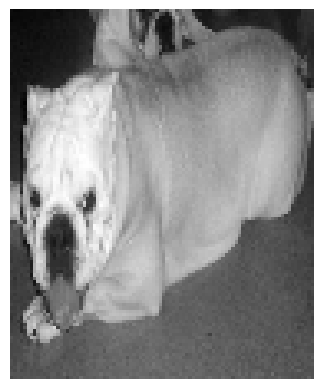

Failure Case
310
Predicted face but actual is non face


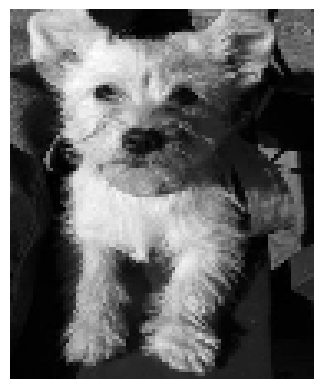

Failure Case
319
Predicted face but actual is non face


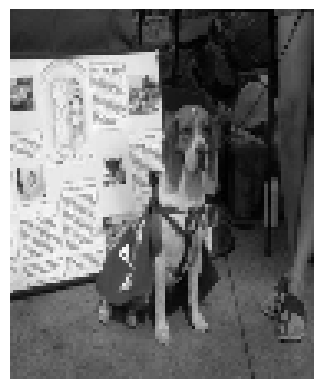

Failure Case
322
Predicted face but actual is non face


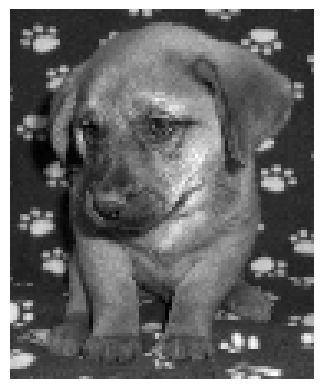

Failure Case
328
Predicted face but actual is non face


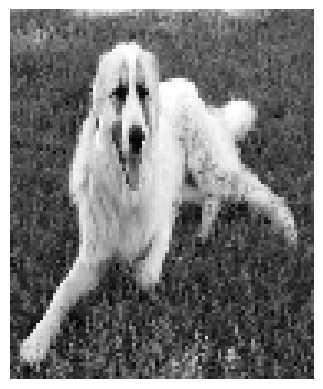

Failure Case
332
Predicted face but actual is non face


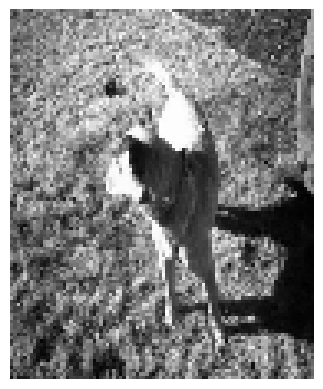

Failure Case
339
Predicted face but actual is non face


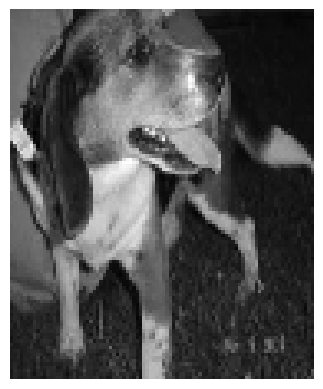

Failure Case
348
Predicted face but actual is non face


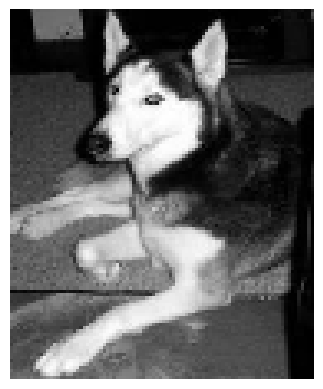

Failure Case
356
Predicted face but actual is non face


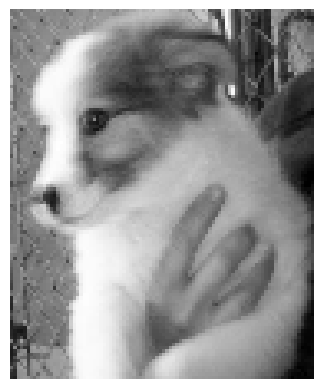

Failure Case
368
Predicted face but actual is non face


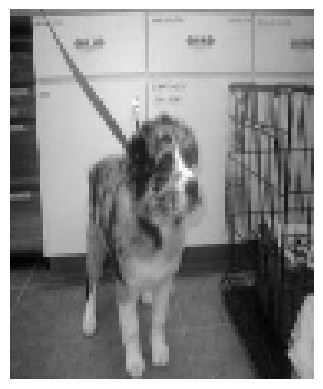

Failure Case
369
Predicted face but actual is non face


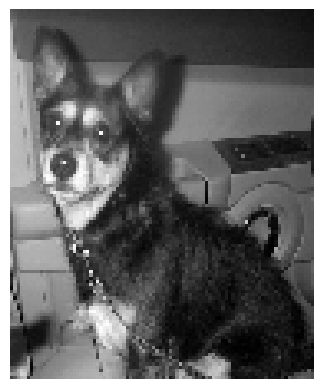

Failure Case
379
Predicted face but actual is non face


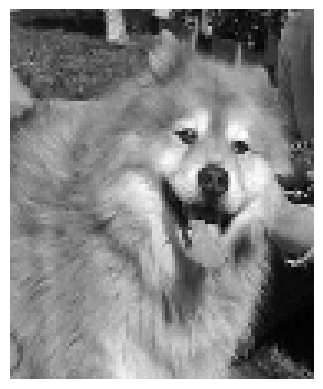

Failure Case
385
Predicted face but actual is non face


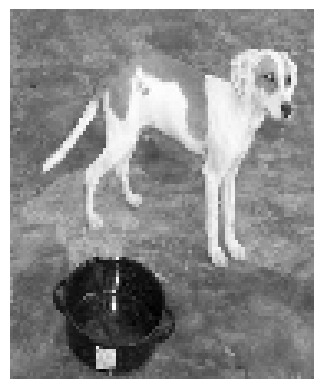

acc = 0.93
Eigenvectors shape = (10304, 10304)
r =  65
U shape = (10304, 65)
projected_training shape = (400, 65)
projected_testing shape = (400, 65)
ACCURACY FOR ALPHA:0.85 AND K = 1 IS :- 0.9125
CONFUSION MATRIX:
[[200   0]
 [ 35 165]]
Failure Case
212
Predicted face but actual is non face


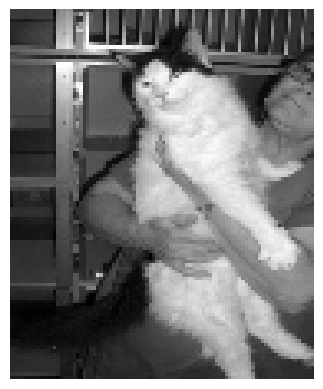

Failure Case
219
Predicted face but actual is non face


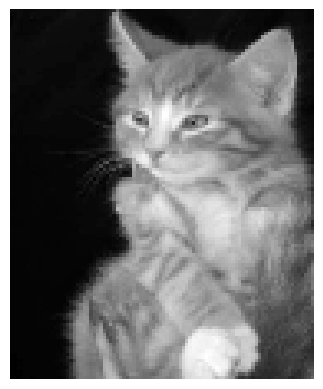

Failure Case
220
Predicted face but actual is non face


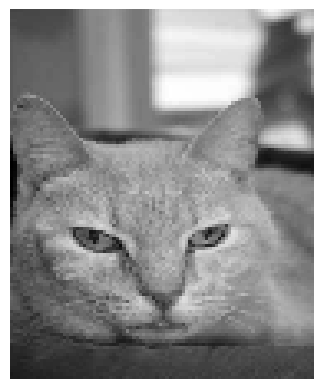

Failure Case
222
Predicted face but actual is non face


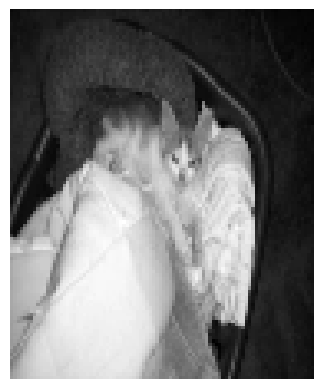

Failure Case
224
Predicted face but actual is non face


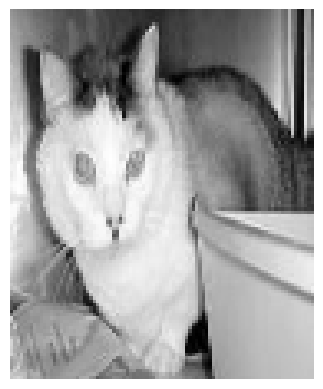

Failure Case
225
Predicted face but actual is non face


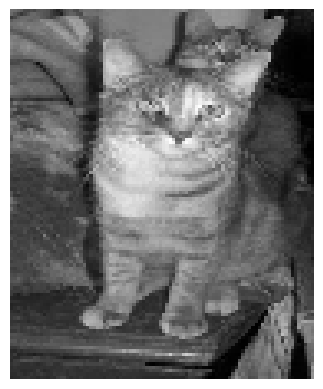

Failure Case
244
Predicted face but actual is non face


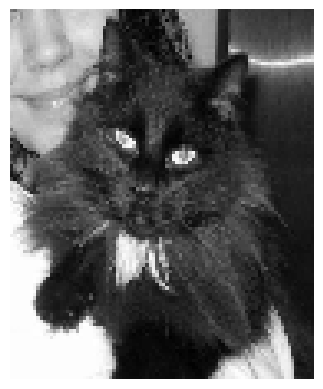

Failure Case
246
Predicted face but actual is non face


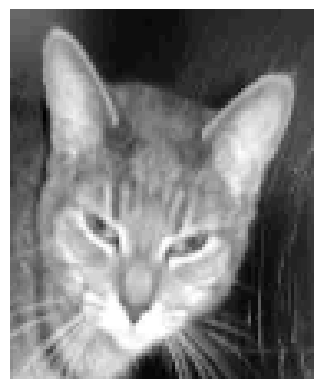

Failure Case
247
Predicted face but actual is non face


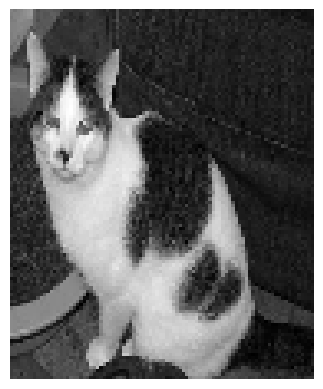

Failure Case
248
Predicted face but actual is non face


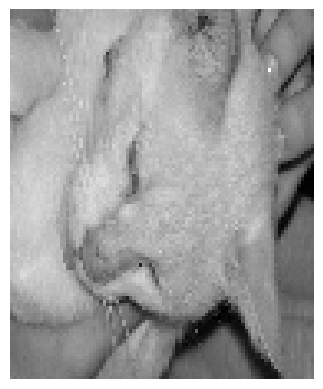

Failure Case
255
Predicted face but actual is non face


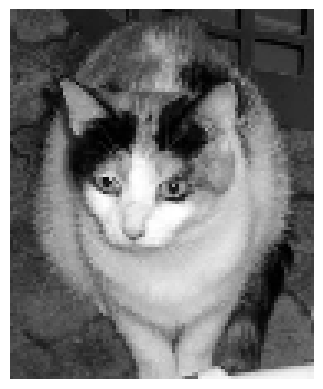

Failure Case
257
Predicted face but actual is non face


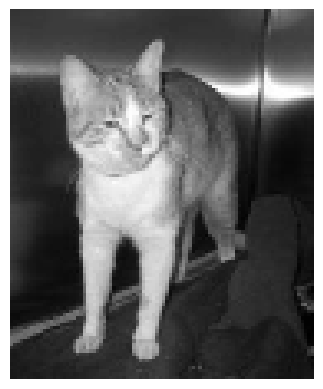

Failure Case
259
Predicted face but actual is non face


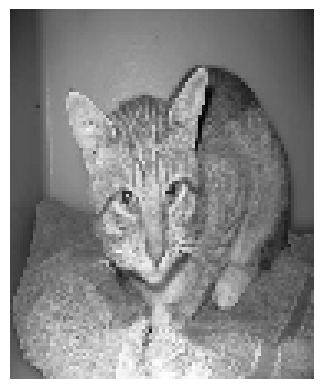

Failure Case
260
Predicted face but actual is non face


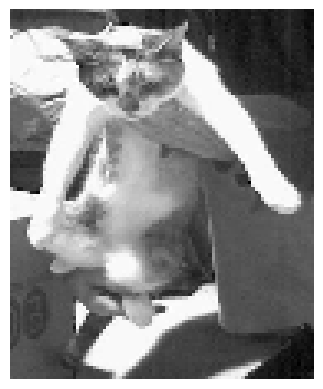

Failure Case
262
Predicted face but actual is non face


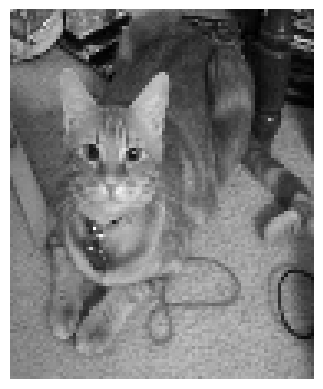

Failure Case
270
Predicted face but actual is non face


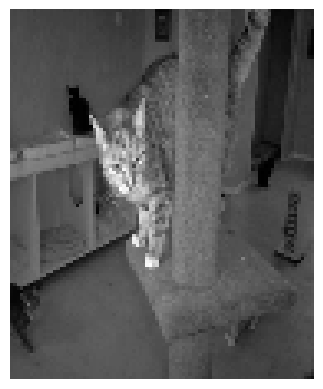

Failure Case
291
Predicted face but actual is non face


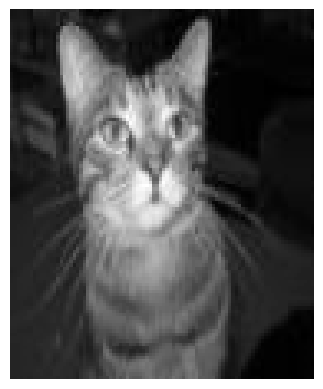

Failure Case
299
Predicted face but actual is non face


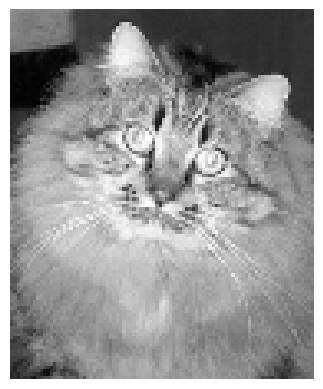

Failure Case
302
Predicted face but actual is non face


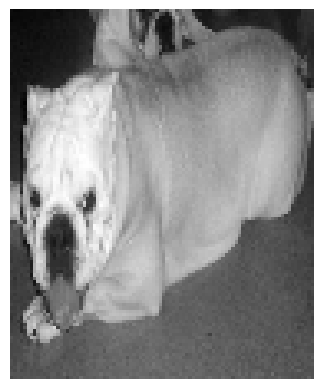

Failure Case
310
Predicted face but actual is non face


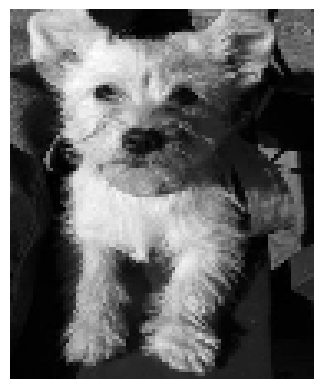

Failure Case
313
Predicted face but actual is non face


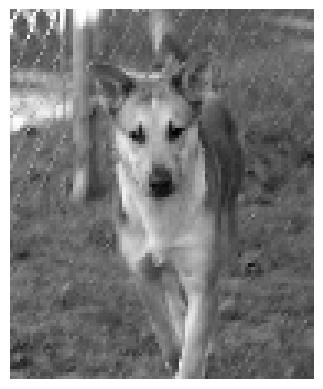

Failure Case
319
Predicted face but actual is non face


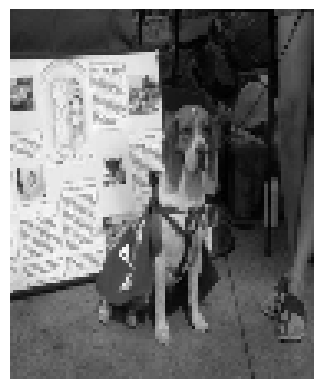

Failure Case
322
Predicted face but actual is non face


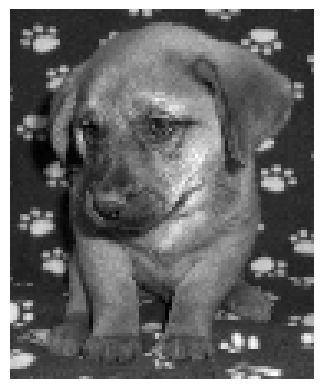

Failure Case
328
Predicted face but actual is non face


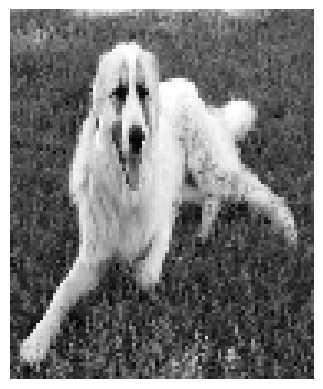

Failure Case
332
Predicted face but actual is non face


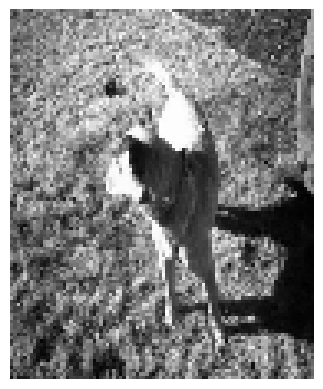

Failure Case
339
Predicted face but actual is non face


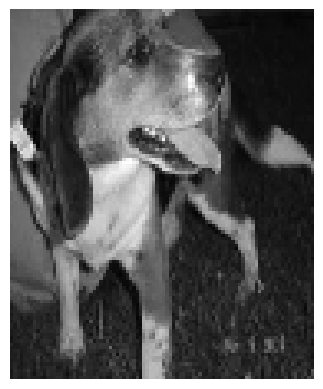

Failure Case
348
Predicted face but actual is non face


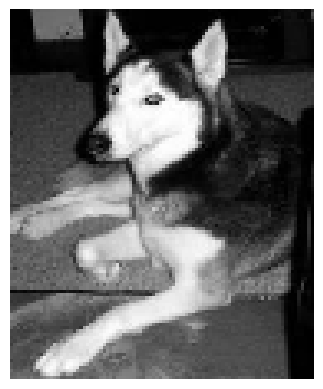

Failure Case
363
Predicted face but actual is non face


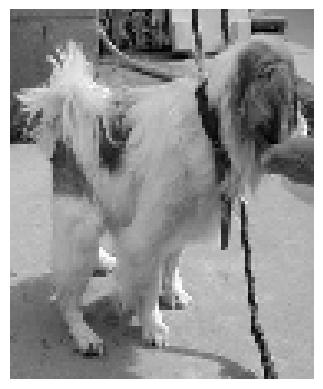

Failure Case
368
Predicted face but actual is non face


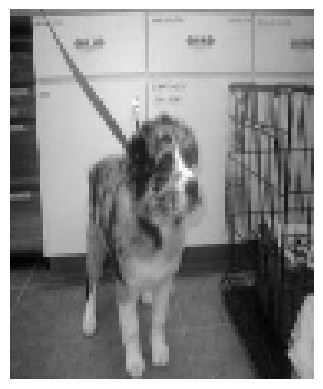

Failure Case
369
Predicted face but actual is non face


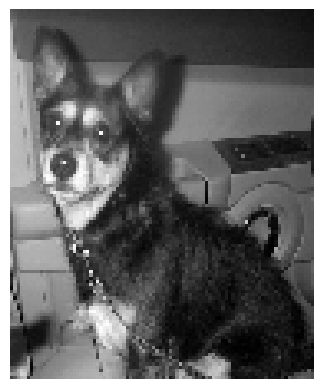

Failure Case
371
Predicted face but actual is non face


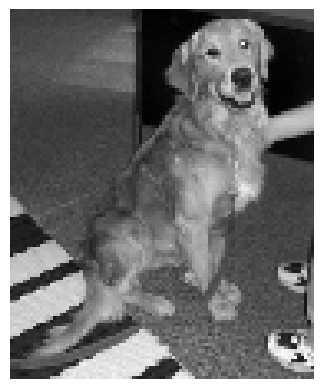

Failure Case
372
Predicted face but actual is non face


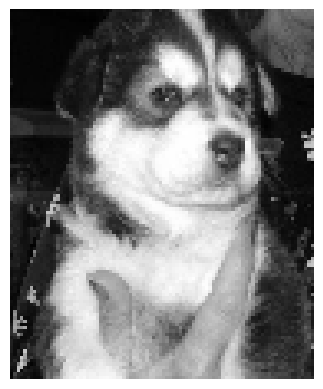

Failure Case
378
Predicted face but actual is non face


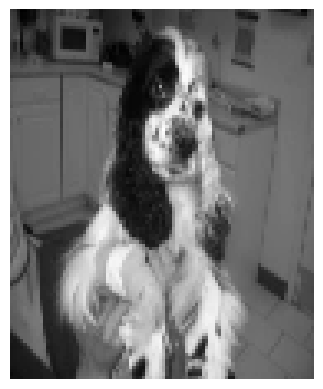

Failure Case
379
Predicted face but actual is non face


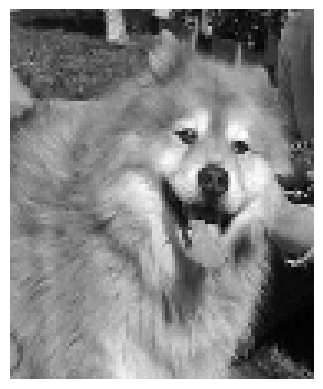

Failure Case
385
Predicted face but actual is non face


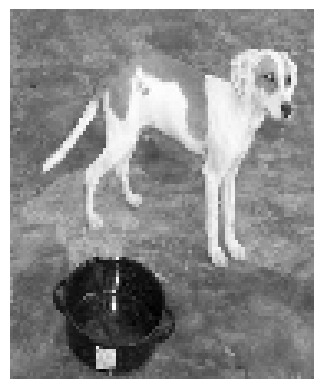

acc = 0.9125
Eigenvectors shape = (10304, 10304)
r =  105
U shape = (10304, 105)
projected_training shape = (400, 105)
projected_testing shape = (400, 105)
ACCURACY FOR ALPHA:0.9 AND K = 1 IS :- 0.9075
CONFUSION MATRIX:
[[199   1]
 [ 36 164]]
Failure Case
174
Predicted non face but actual is face


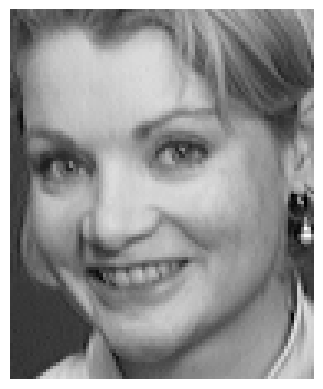

Failure Case
204
Predicted face but actual is non face


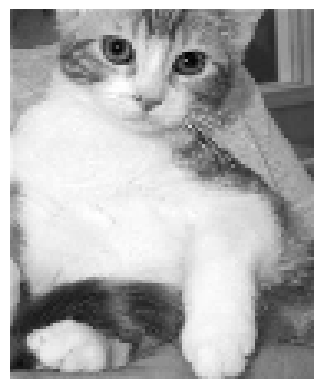

Failure Case
212
Predicted face but actual is non face


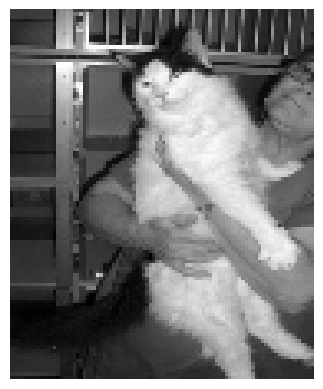

Failure Case
219
Predicted face but actual is non face


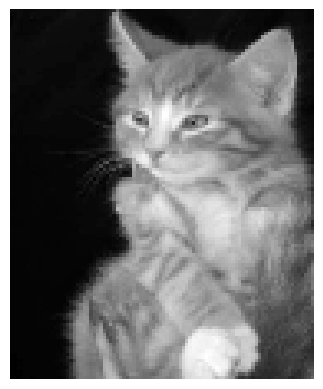

Failure Case
220
Predicted face but actual is non face


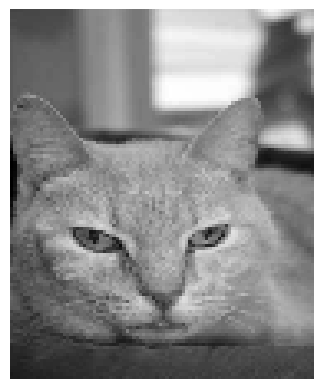

Failure Case
222
Predicted face but actual is non face


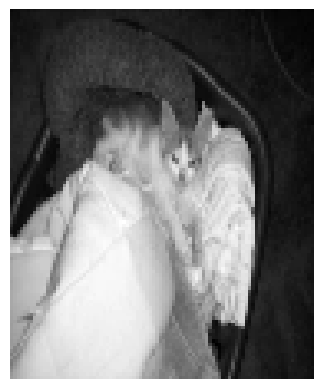

Failure Case
224
Predicted face but actual is non face


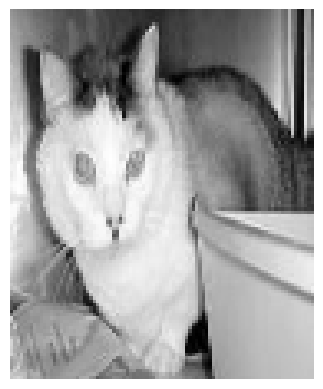

Failure Case
225
Predicted face but actual is non face


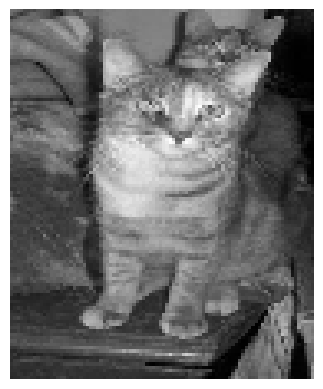

Failure Case
234
Predicted face but actual is non face


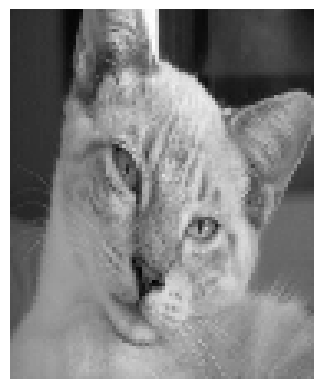

Failure Case
244
Predicted face but actual is non face


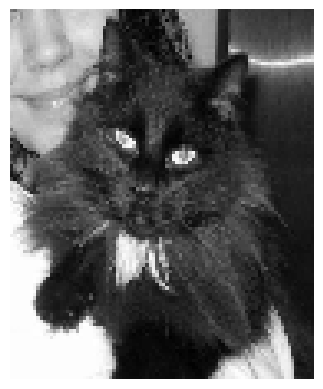

Failure Case
246
Predicted face but actual is non face


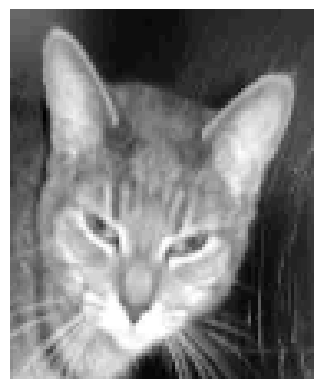

Failure Case
247
Predicted face but actual is non face


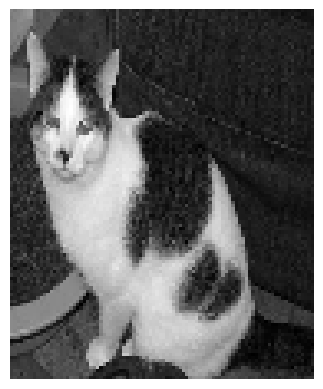

Failure Case
248
Predicted face but actual is non face


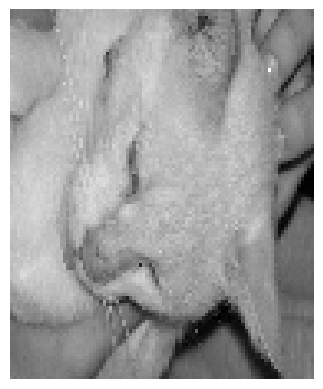

Failure Case
255
Predicted face but actual is non face


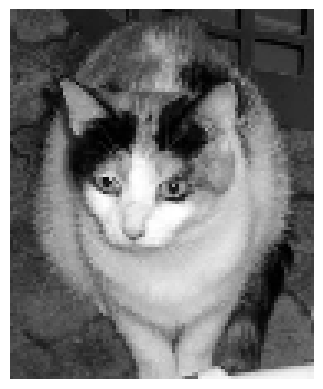

Failure Case
257
Predicted face but actual is non face


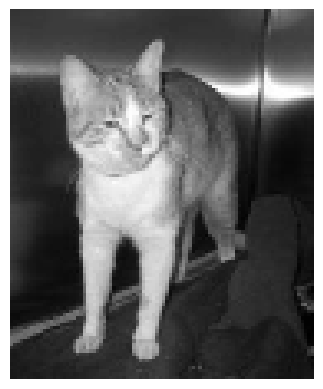

Failure Case
260
Predicted face but actual is non face


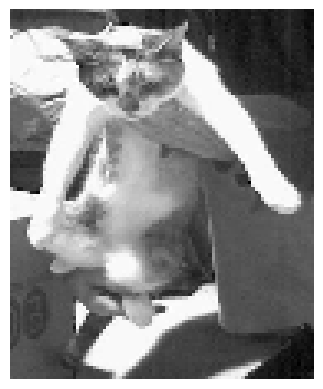

Failure Case
262
Predicted face but actual is non face


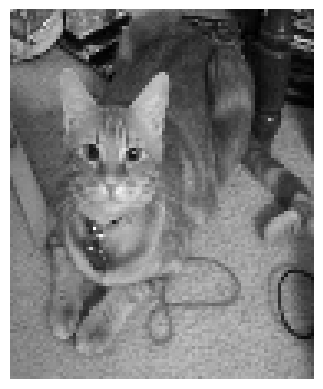

Failure Case
265
Predicted face but actual is non face


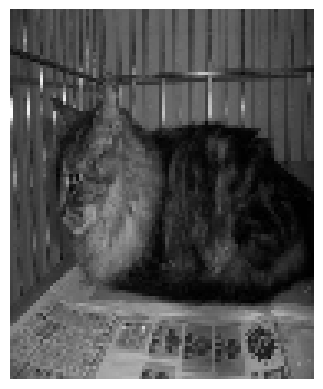

Failure Case
268
Predicted face but actual is non face


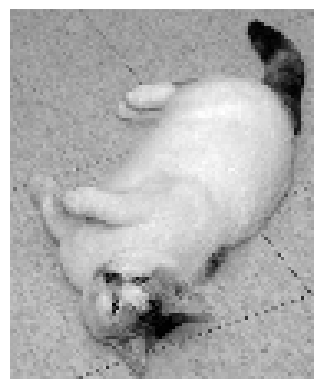

Failure Case
270
Predicted face but actual is non face


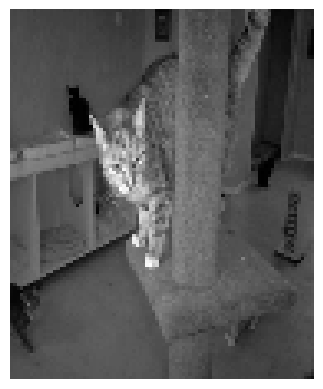

Failure Case
291
Predicted face but actual is non face


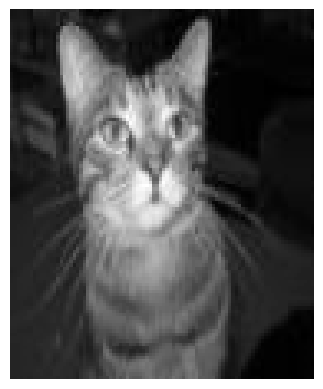

Failure Case
299
Predicted face but actual is non face


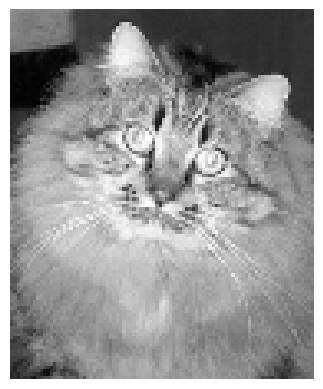

Failure Case
302
Predicted face but actual is non face


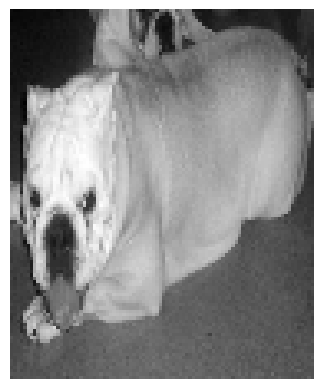

Failure Case
310
Predicted face but actual is non face


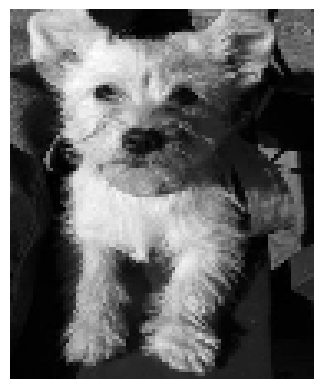

Failure Case
313
Predicted face but actual is non face


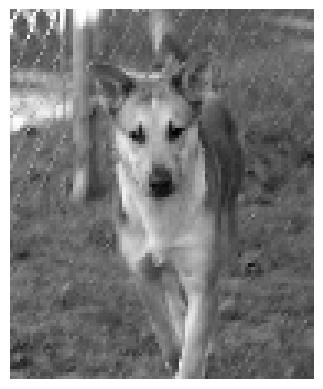

Failure Case
319
Predicted face but actual is non face


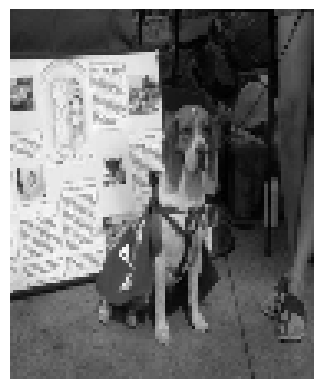

Failure Case
322
Predicted face but actual is non face


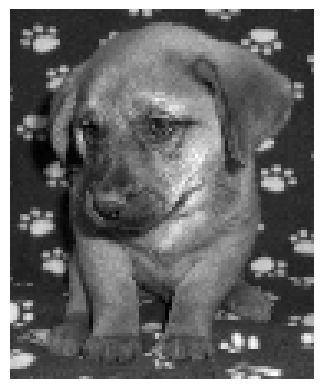

Failure Case
328
Predicted face but actual is non face


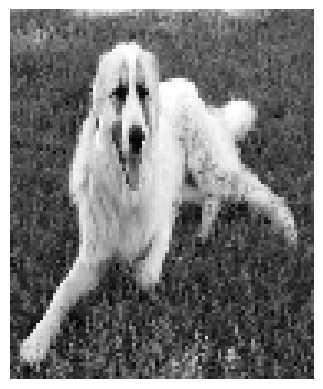

Failure Case
332
Predicted face but actual is non face


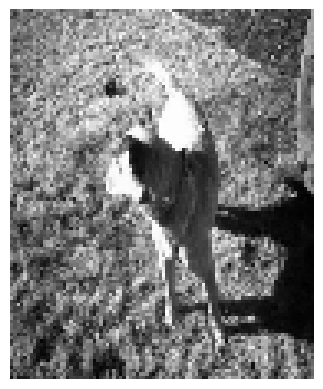

Failure Case
339
Predicted face but actual is non face


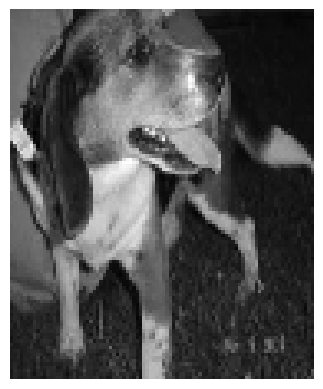

Failure Case
348
Predicted face but actual is non face


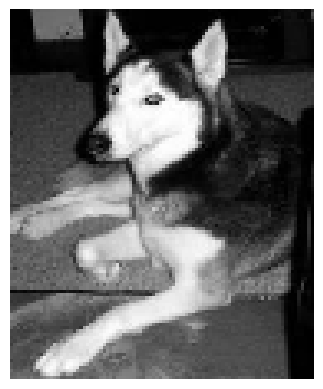

Failure Case
363
Predicted face but actual is non face


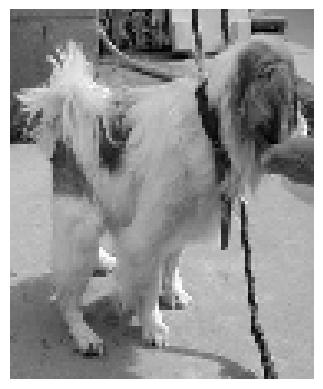

Failure Case
368
Predicted face but actual is non face


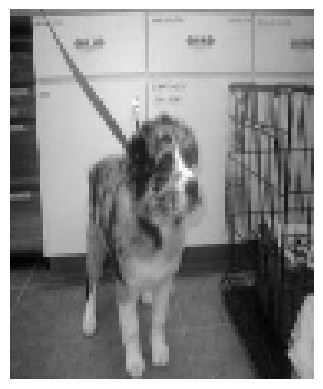

Failure Case
369
Predicted face but actual is non face


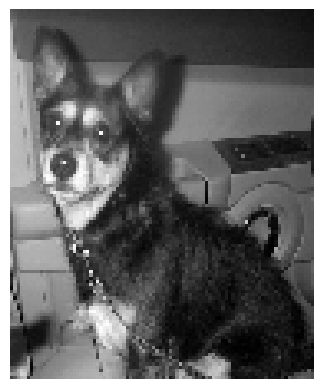

Failure Case
372
Predicted face but actual is non face


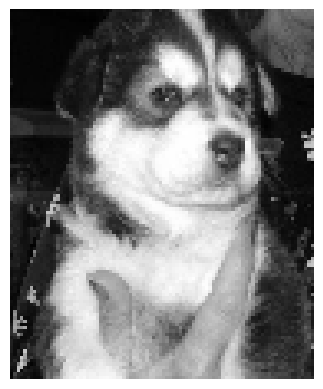

Failure Case
378
Predicted face but actual is non face


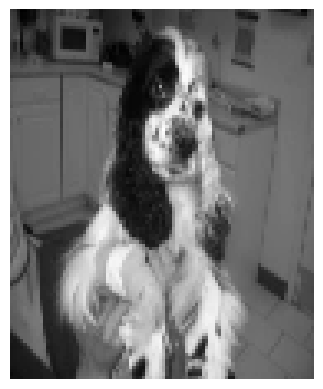

Failure Case
379
Predicted face but actual is non face


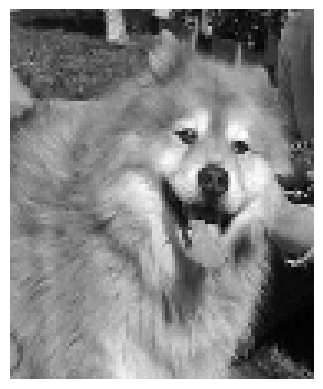

acc = 0.9075
Eigenvectors shape = (10304, 10304)
r =  178
U shape = (10304, 178)
projected_training shape = (400, 178)
projected_testing shape = (400, 178)
ACCURACY FOR ALPHA:0.95 AND K = 1 IS :- 0.8875
CONFUSION MATRIX:
[[200   0]
 [ 45 155]]
Failure Case
204
Predicted face but actual is non face


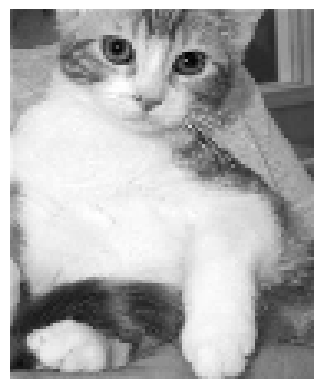

Failure Case
207
Predicted face but actual is non face


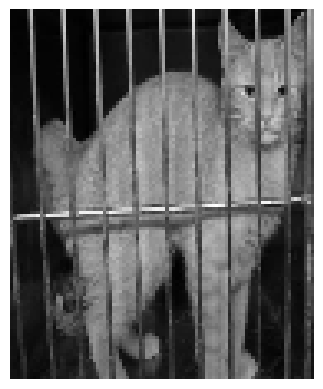

Failure Case
212
Predicted face but actual is non face


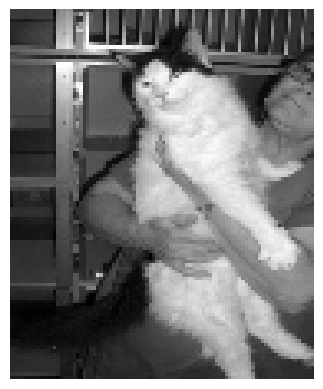

Failure Case
219
Predicted face but actual is non face


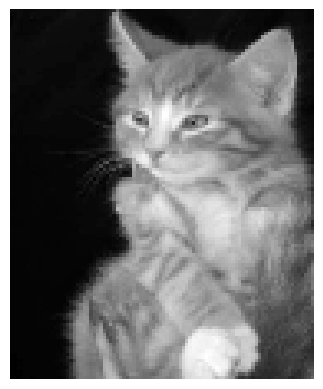

Failure Case
220
Predicted face but actual is non face


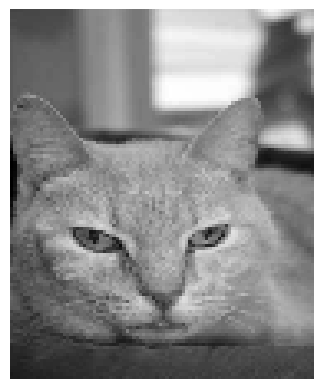

Failure Case
222
Predicted face but actual is non face


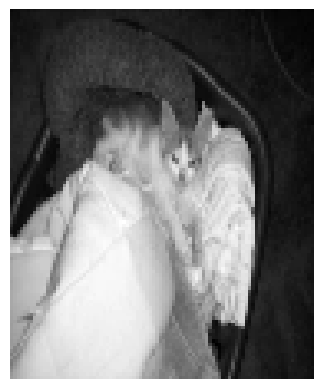

Failure Case
224
Predicted face but actual is non face


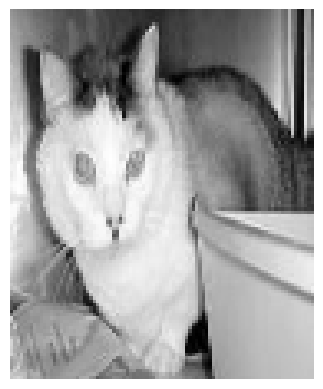

Failure Case
225
Predicted face but actual is non face


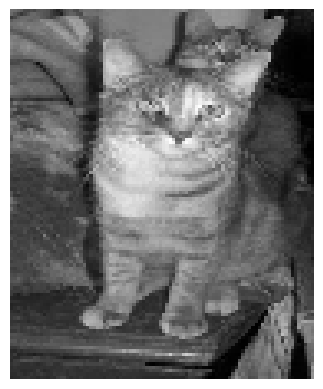

Failure Case
234
Predicted face but actual is non face


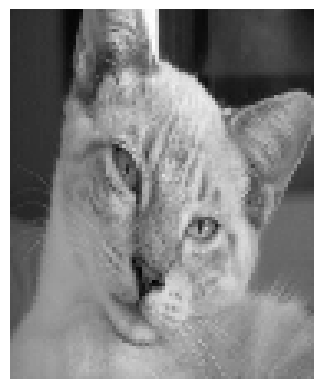

Failure Case
244
Predicted face but actual is non face


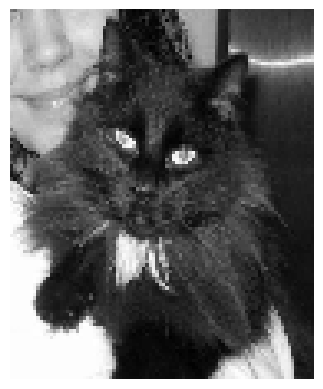

Failure Case
246
Predicted face but actual is non face


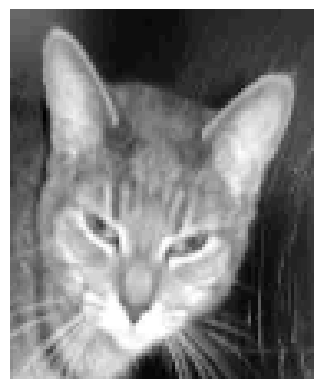

Failure Case
247
Predicted face but actual is non face


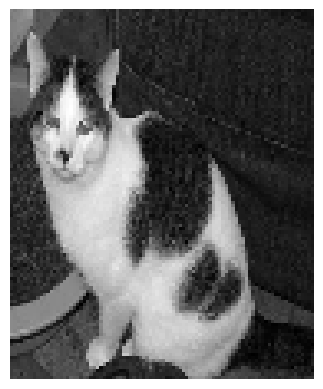

Failure Case
248
Predicted face but actual is non face


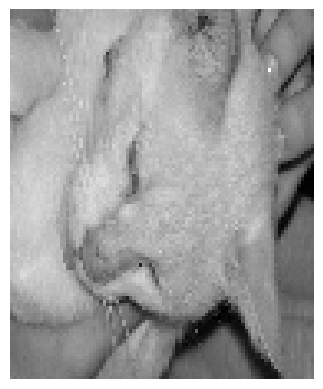

Failure Case
255
Predicted face but actual is non face


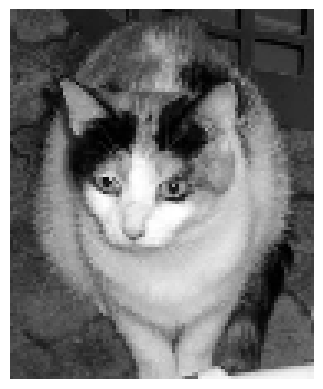

Failure Case
257
Predicted face but actual is non face


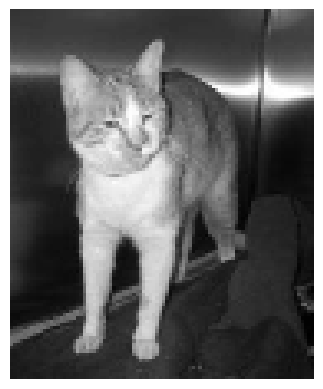

Failure Case
260
Predicted face but actual is non face


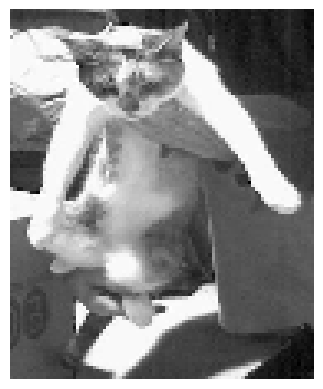

Failure Case
262
Predicted face but actual is non face


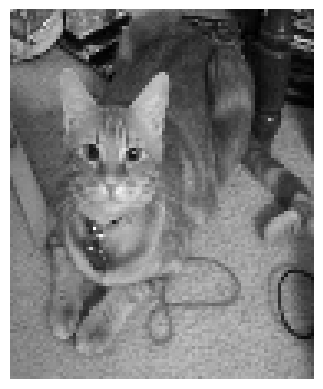

Failure Case
265
Predicted face but actual is non face


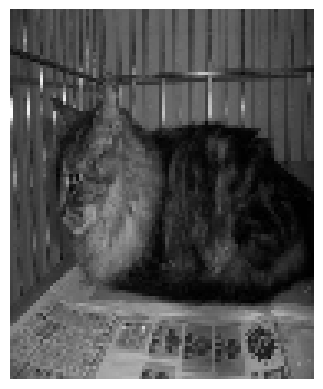

Failure Case
268
Predicted face but actual is non face


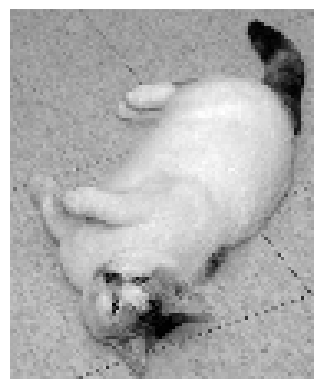

Failure Case
270
Predicted face but actual is non face


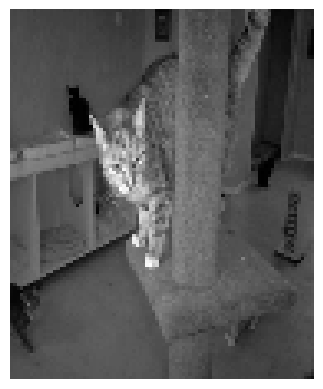

Failure Case
279
Predicted face but actual is non face


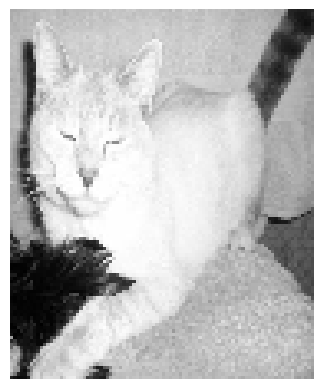

Failure Case
291
Predicted face but actual is non face


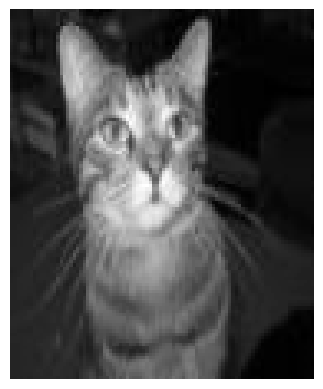

Failure Case
299
Predicted face but actual is non face


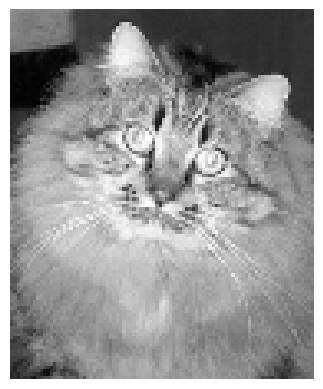

Failure Case
302
Predicted face but actual is non face


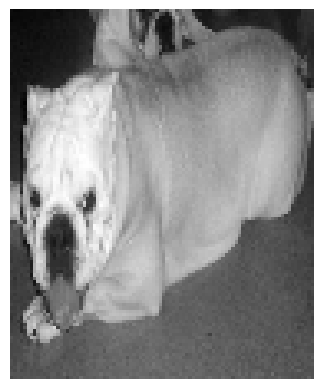

Failure Case
310
Predicted face but actual is non face


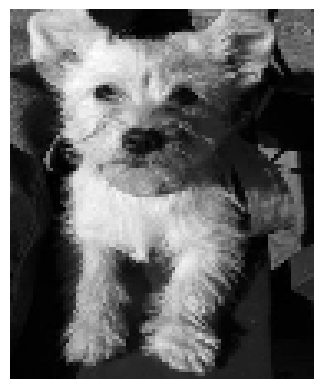

Failure Case
313
Predicted face but actual is non face


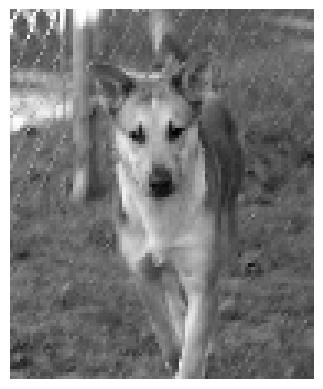

Failure Case
315
Predicted face but actual is non face


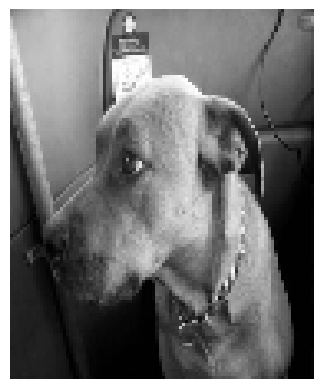

Failure Case
319
Predicted face but actual is non face


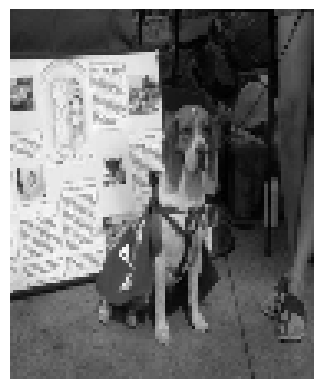

Failure Case
322
Predicted face but actual is non face


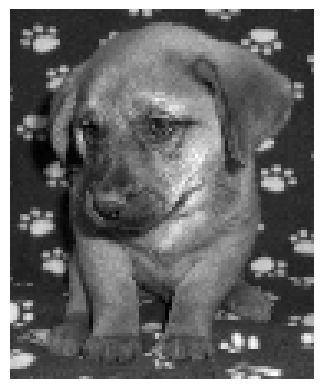

Failure Case
325
Predicted face but actual is non face


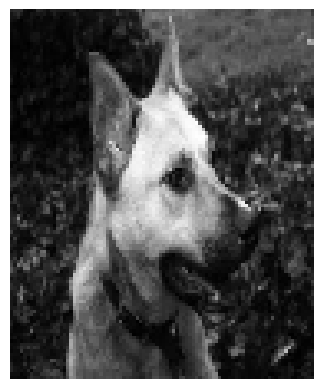

Failure Case
328
Predicted face but actual is non face


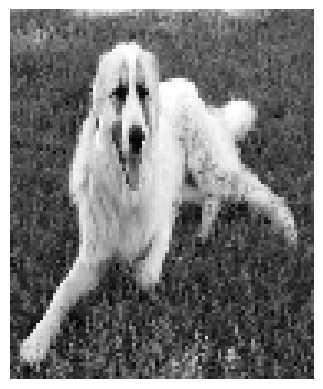

Failure Case
330
Predicted face but actual is non face


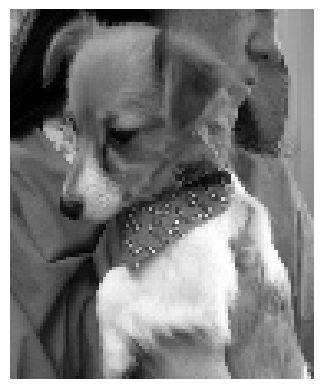

Failure Case
332
Predicted face but actual is non face


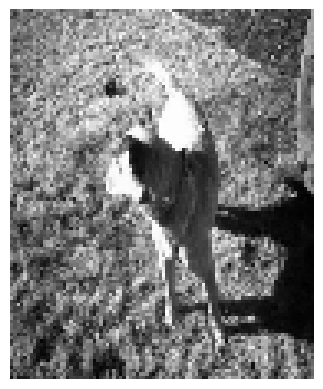

Failure Case
339
Predicted face but actual is non face


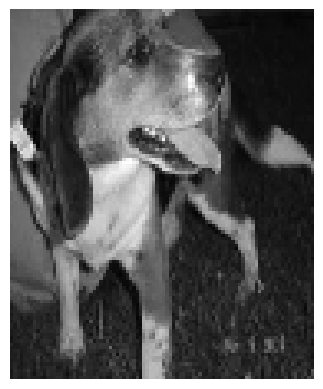

Failure Case
348
Predicted face but actual is non face


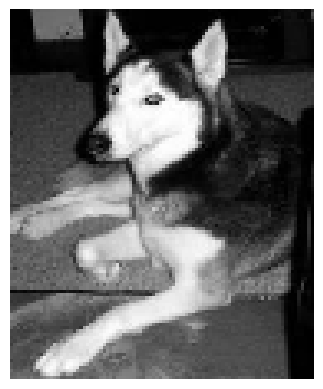

Failure Case
356
Predicted face but actual is non face


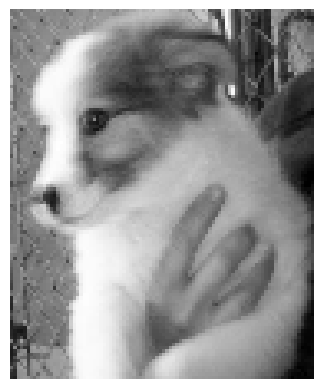

Failure Case
363
Predicted face but actual is non face


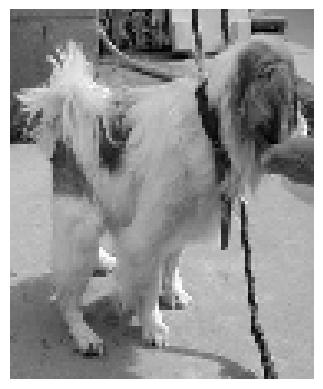

Failure Case
368
Predicted face but actual is non face


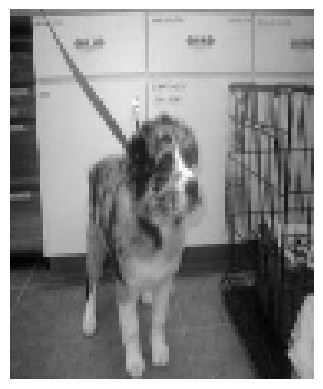

Failure Case
369
Predicted face but actual is non face


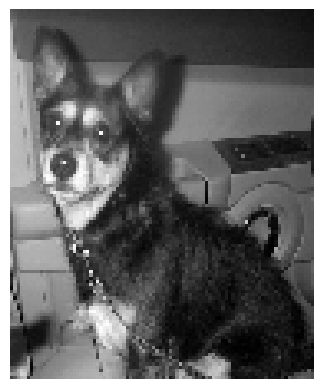

Failure Case
371
Predicted face but actual is non face


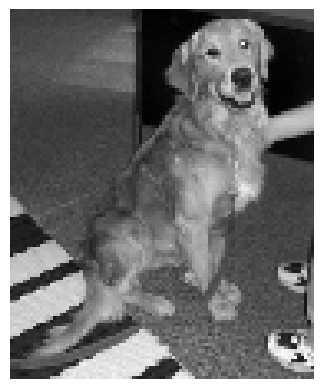

Failure Case
372
Predicted face but actual is non face


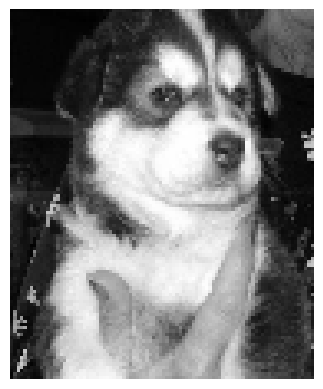

Failure Case
378
Predicted face but actual is non face


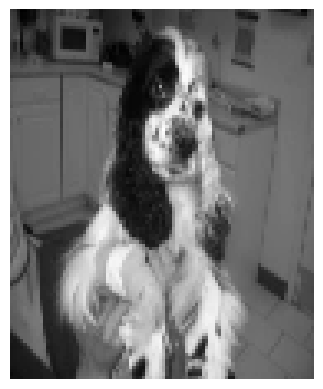

Failure Case
379
Predicted face but actual is non face


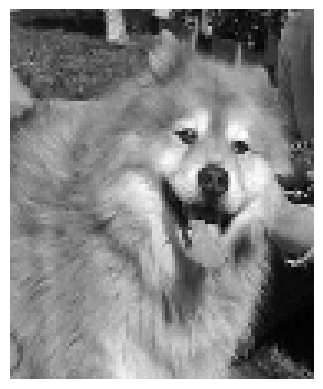

Failure Case
384
Predicted face but actual is non face


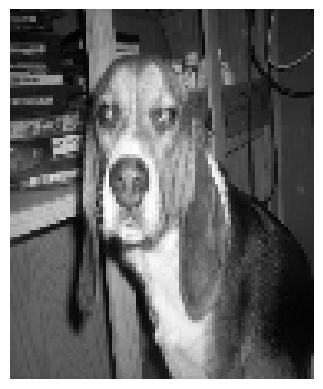

Failure Case
385
Predicted face but actual is non face


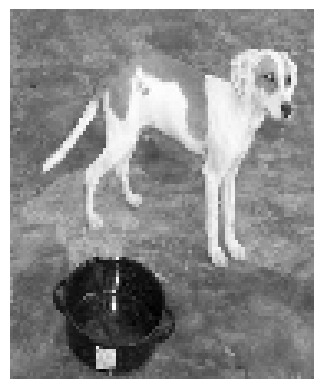

acc = 0.8875


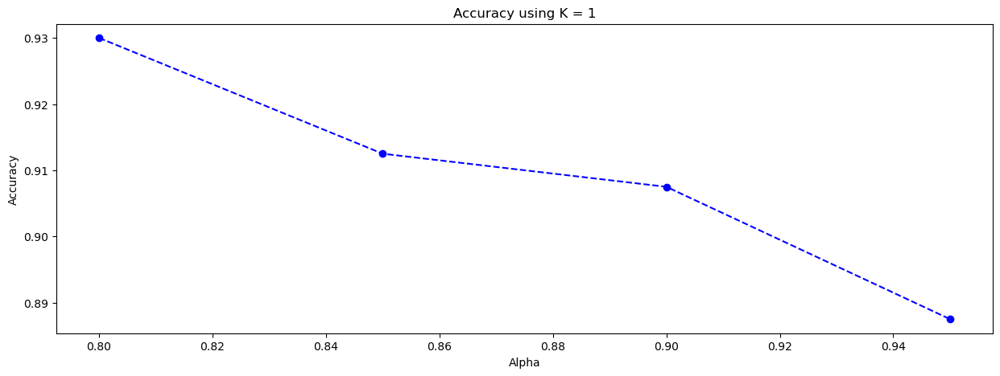

ACCURACY FOR ALPHA:0.8 AND K = 3 IS :- 0.8875
CONFUSION MATRIX:
[[200   0]
 [ 45 155]]
Failure Case
204
Predicted face but actual is non face


<Figure size 1000x1000 with 0 Axes>

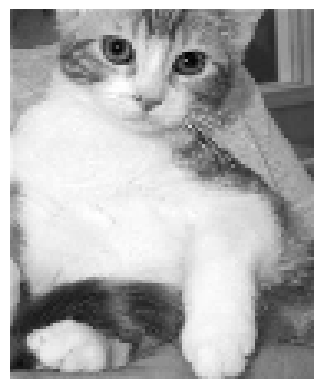

Failure Case
212
Predicted face but actual is non face


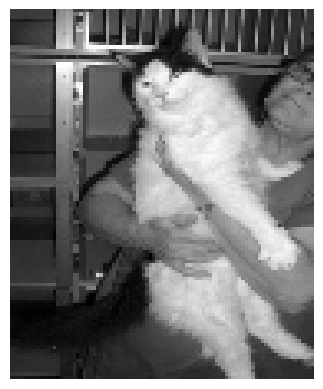

Failure Case
218
Predicted face but actual is non face


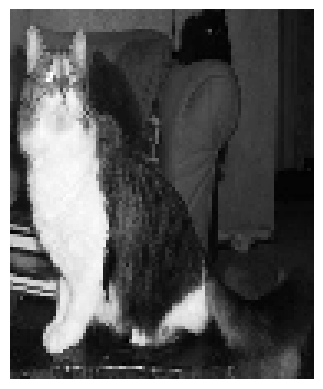

Failure Case
219
Predicted face but actual is non face


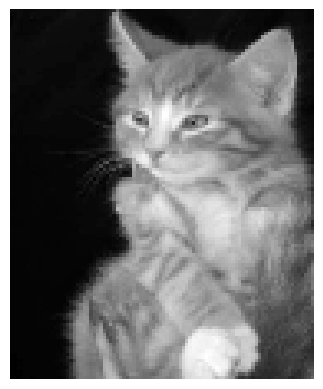

Failure Case
220
Predicted face but actual is non face


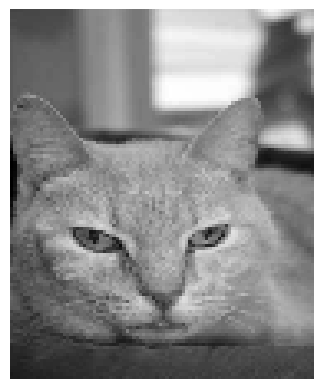

Failure Case
222
Predicted face but actual is non face


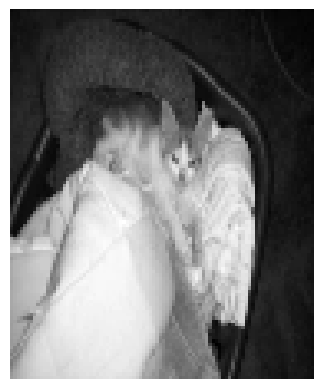

Failure Case
224
Predicted face but actual is non face


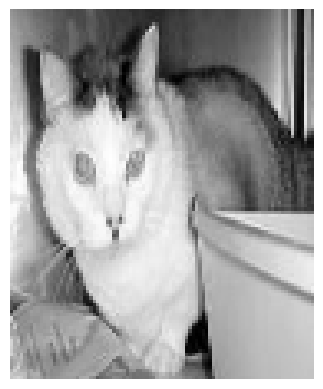

Failure Case
225
Predicted face but actual is non face


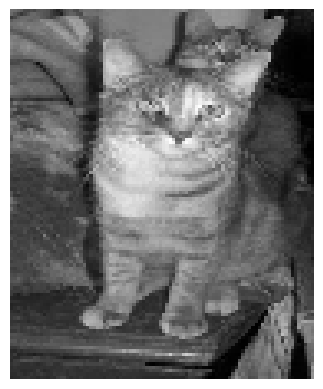

Failure Case
240
Predicted face but actual is non face


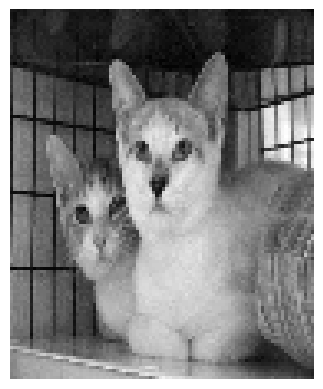

Failure Case
241
Predicted face but actual is non face


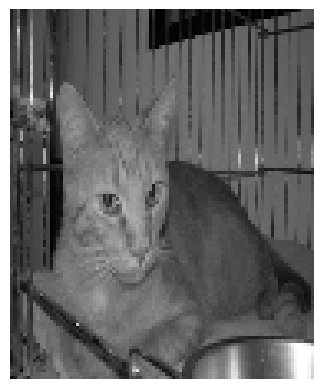

Failure Case
246
Predicted face but actual is non face


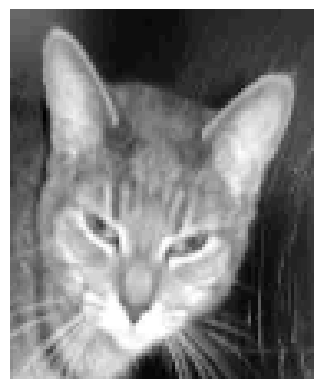

Failure Case
247
Predicted face but actual is non face


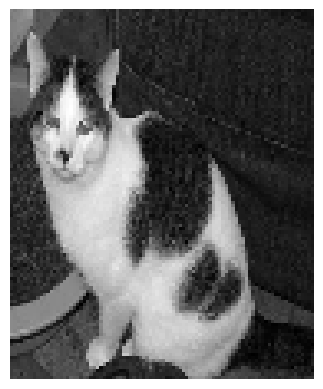

Failure Case
253
Predicted face but actual is non face


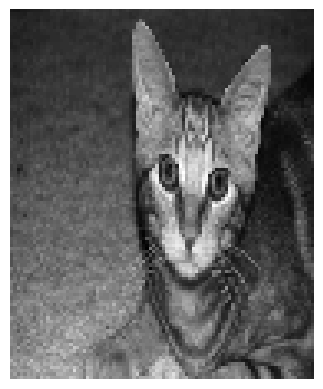

Failure Case
255
Predicted face but actual is non face


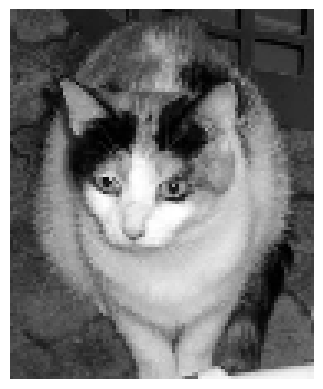

Failure Case
257
Predicted face but actual is non face


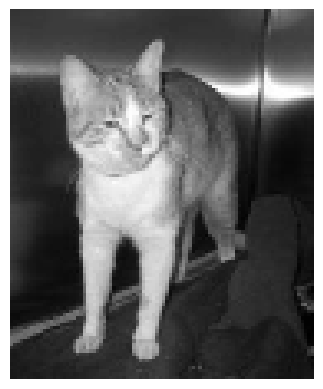

Failure Case
258
Predicted face but actual is non face


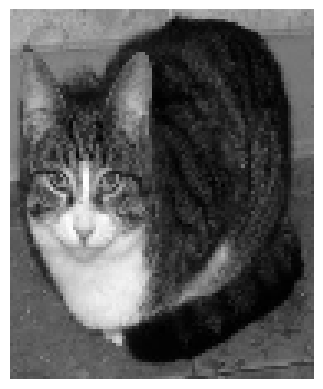

Failure Case
260
Predicted face but actual is non face


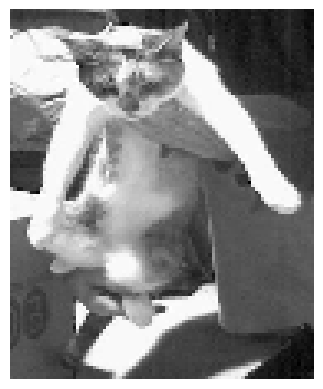

Failure Case
261
Predicted face but actual is non face


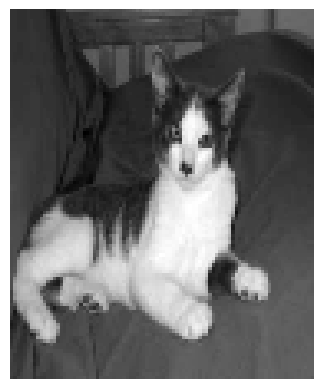

Failure Case
262
Predicted face but actual is non face


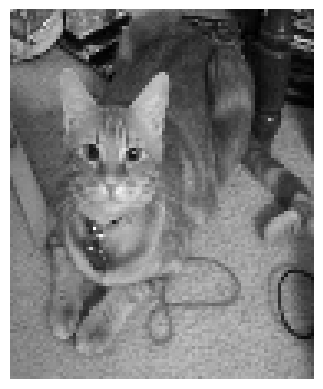

Failure Case
263
Predicted face but actual is non face


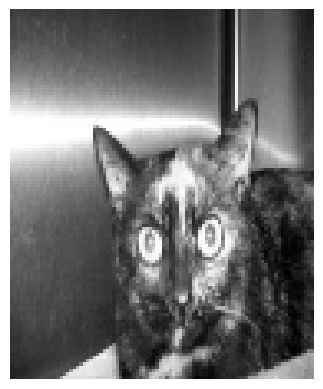

Failure Case
270
Predicted face but actual is non face


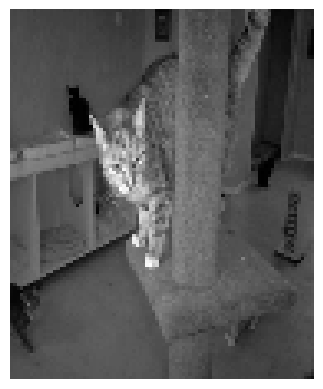

Failure Case
278
Predicted face but actual is non face


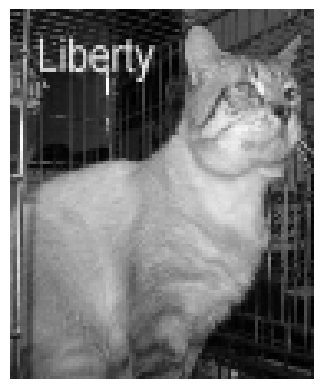

Failure Case
279
Predicted face but actual is non face


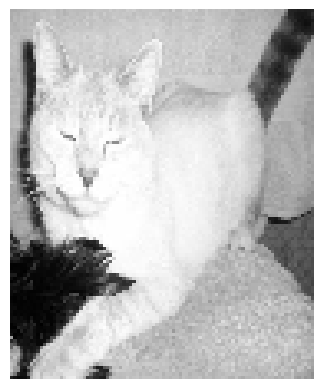

Failure Case
291
Predicted face but actual is non face


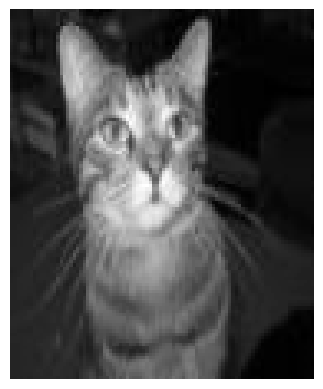

Failure Case
292
Predicted face but actual is non face


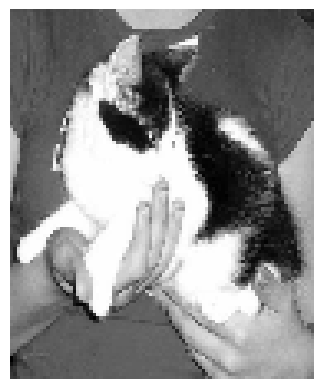

Failure Case
298
Predicted face but actual is non face


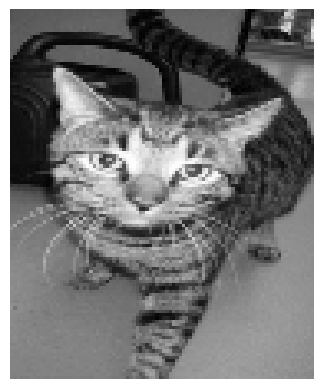

Failure Case
299
Predicted face but actual is non face


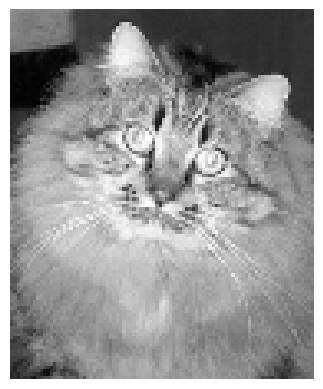

Failure Case
302
Predicted face but actual is non face


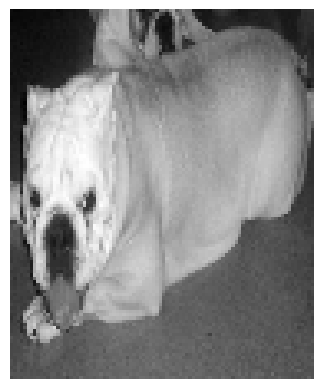

Failure Case
307
Predicted face but actual is non face


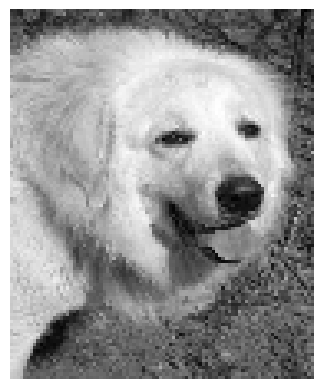

Failure Case
310
Predicted face but actual is non face


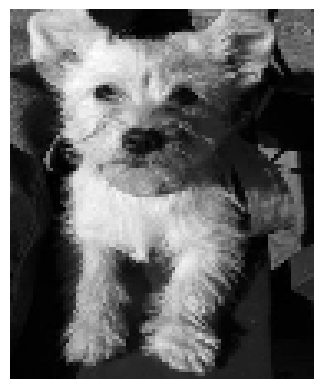

Failure Case
319
Predicted face but actual is non face


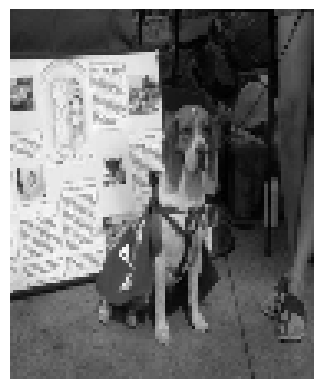

Failure Case
322
Predicted face but actual is non face


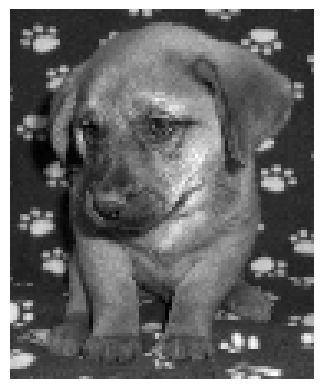

Failure Case
328
Predicted face but actual is non face


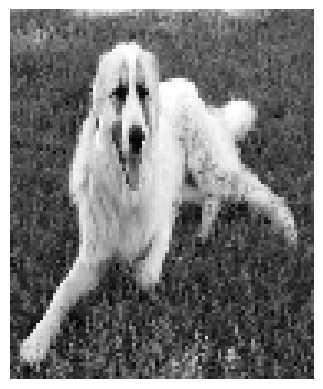

Failure Case
332
Predicted face but actual is non face


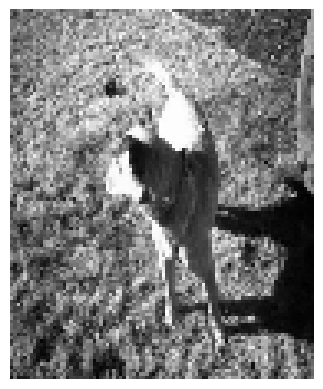

Failure Case
339
Predicted face but actual is non face


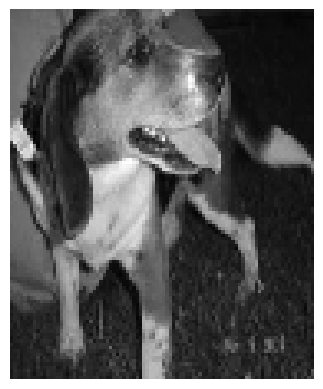

Failure Case
348
Predicted face but actual is non face


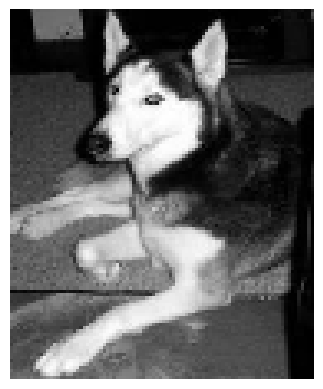

Failure Case
363
Predicted face but actual is non face


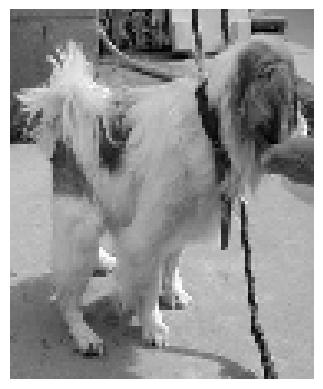

Failure Case
367
Predicted face but actual is non face


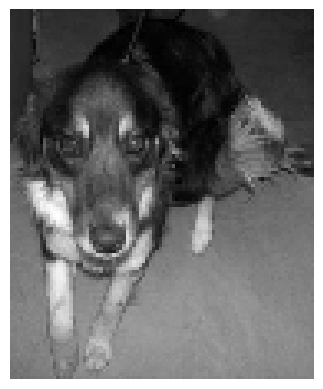

Failure Case
368
Predicted face but actual is non face


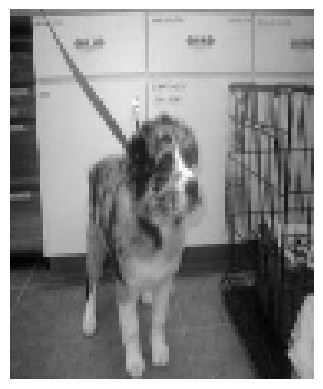

Failure Case
369
Predicted face but actual is non face


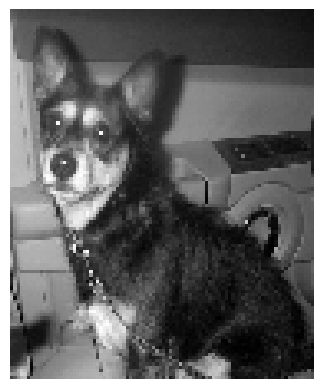

Failure Case
371
Predicted face but actual is non face


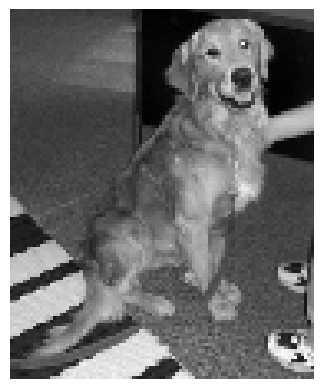

Failure Case
372
Predicted face but actual is non face


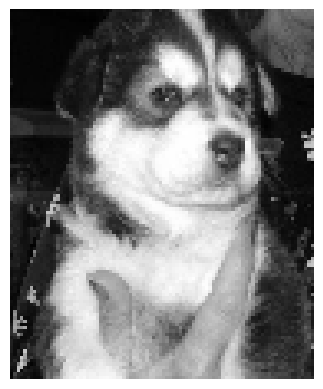

Failure Case
379
Predicted face but actual is non face


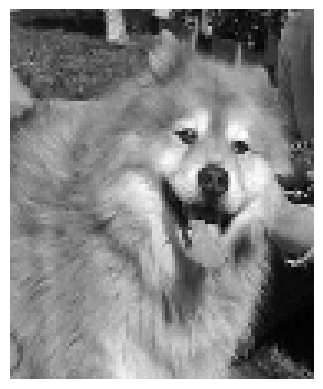

Failure Case
385
Predicted face but actual is non face


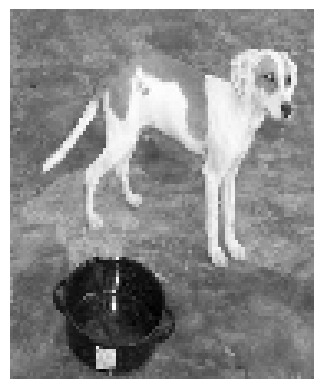

Failure Case
386
Predicted face but actual is non face


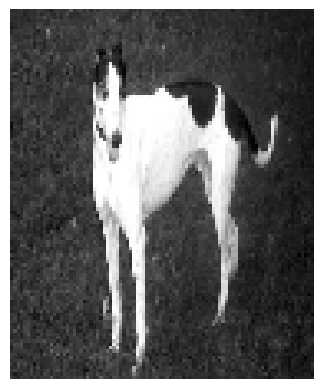

acc = 0.8875
ACCURACY FOR ALPHA:0.85 AND K = 3 IS :- 0.88
CONFUSION MATRIX:
[[200   0]
 [ 48 152]]
Failure Case
204
Predicted face but actual is non face


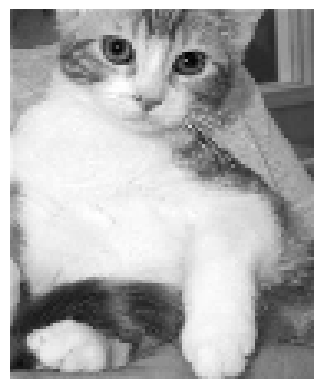

Failure Case
212
Predicted face but actual is non face


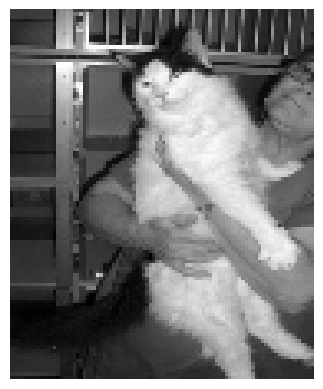

Failure Case
218
Predicted face but actual is non face


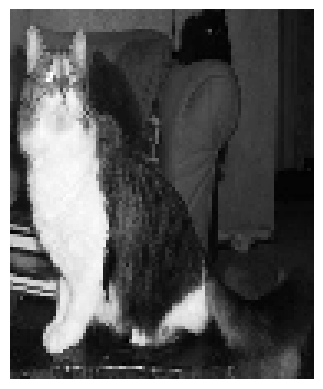

Failure Case
219
Predicted face but actual is non face


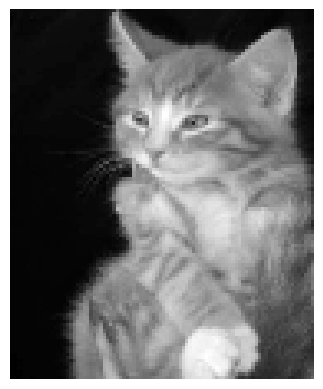

Failure Case
220
Predicted face but actual is non face


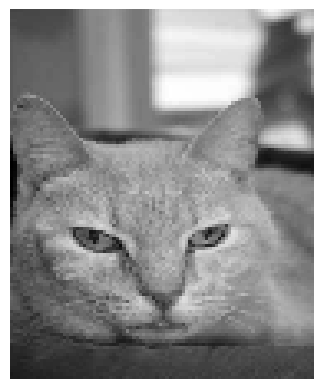

Failure Case
222
Predicted face but actual is non face


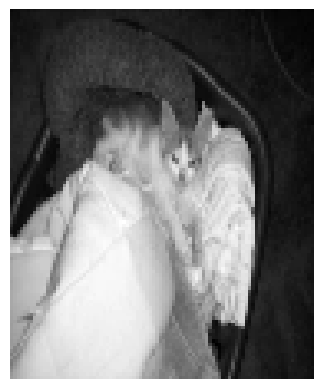

Failure Case
224
Predicted face but actual is non face


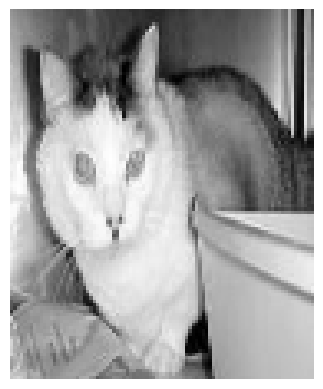

Failure Case
225
Predicted face but actual is non face


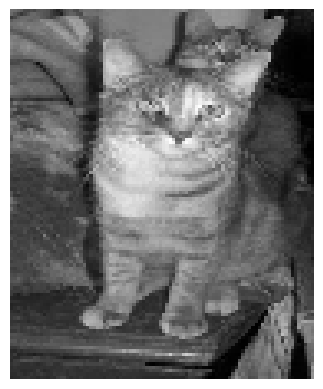

Failure Case
228
Predicted face but actual is non face


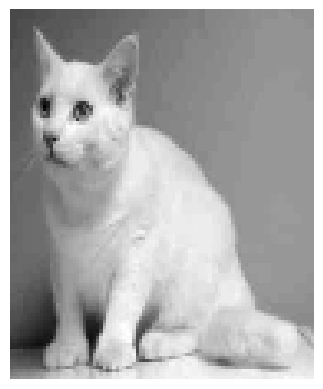

Failure Case
234
Predicted face but actual is non face


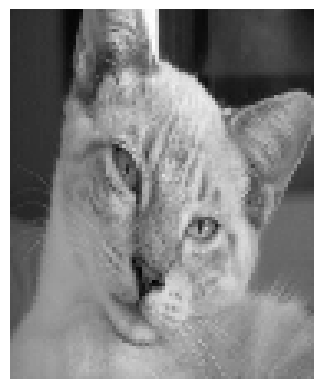

Failure Case
240
Predicted face but actual is non face


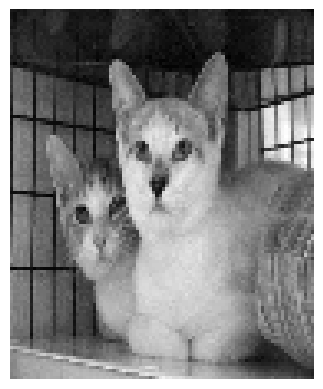

Failure Case
241
Predicted face but actual is non face


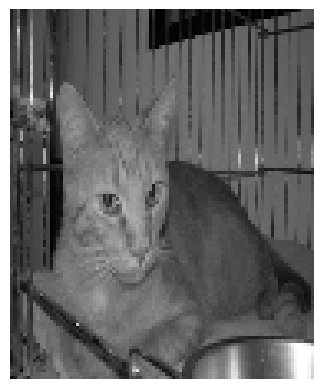

Failure Case
246
Predicted face but actual is non face


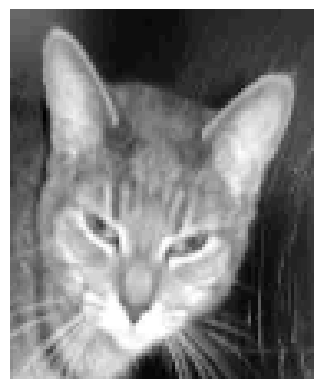

Failure Case
247
Predicted face but actual is non face


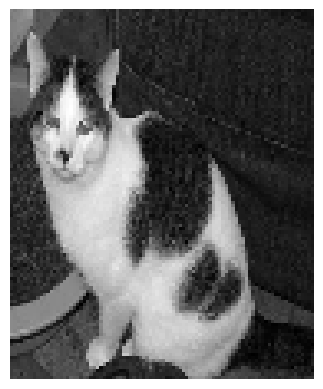

Failure Case
248
Predicted face but actual is non face


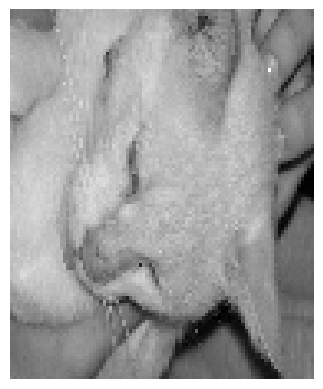

Failure Case
253
Predicted face but actual is non face


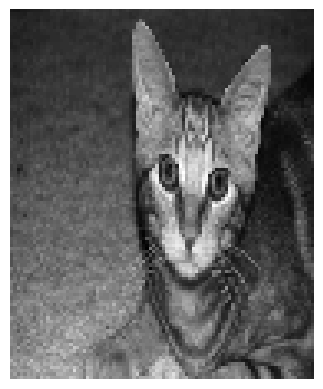

Failure Case
255
Predicted face but actual is non face


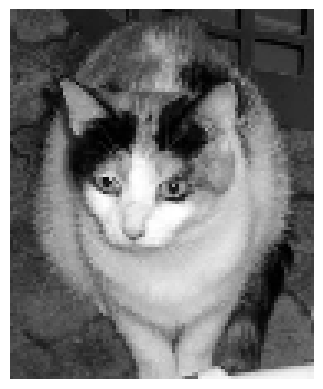

Failure Case
257
Predicted face but actual is non face


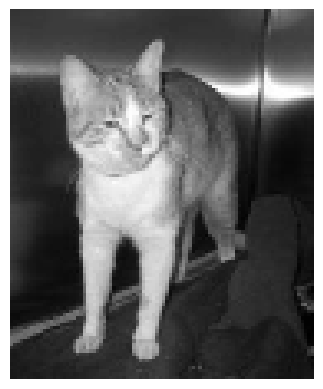

Failure Case
258
Predicted face but actual is non face


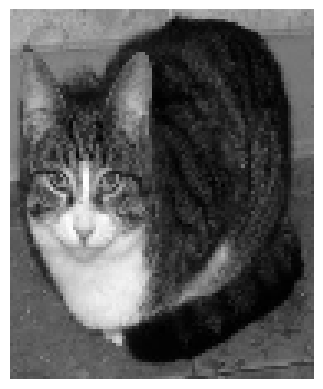

Failure Case
260
Predicted face but actual is non face


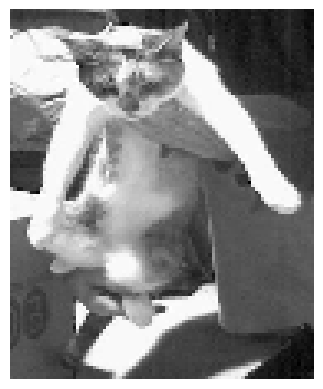

Failure Case
261
Predicted face but actual is non face


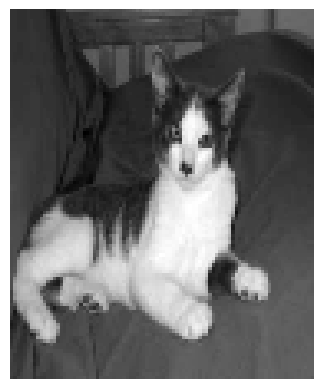

Failure Case
262
Predicted face but actual is non face


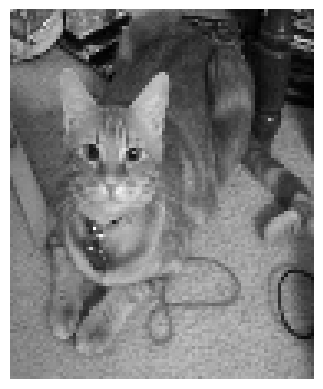

Failure Case
263
Predicted face but actual is non face


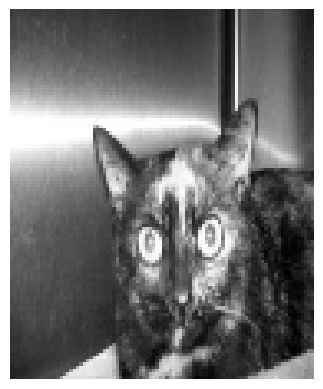

Failure Case
270
Predicted face but actual is non face


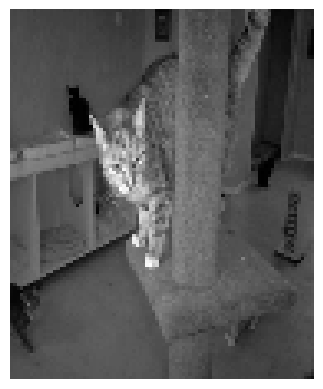

Failure Case
272
Predicted face but actual is non face


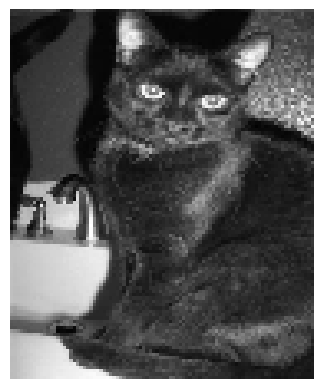

Failure Case
278
Predicted face but actual is non face


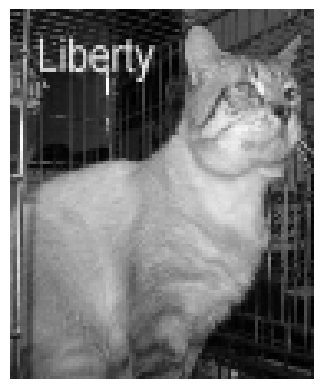

Failure Case
279
Predicted face but actual is non face


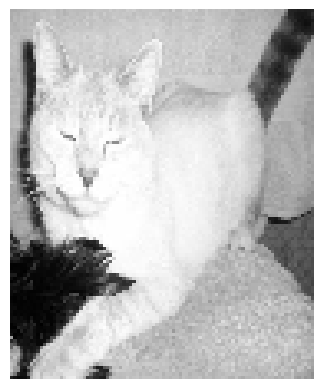

Failure Case
291
Predicted face but actual is non face


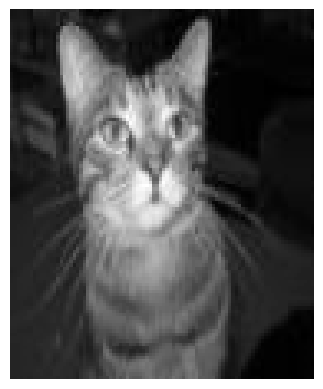

Failure Case
292
Predicted face but actual is non face


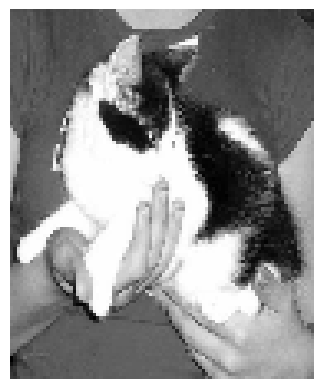

Failure Case
298
Predicted face but actual is non face


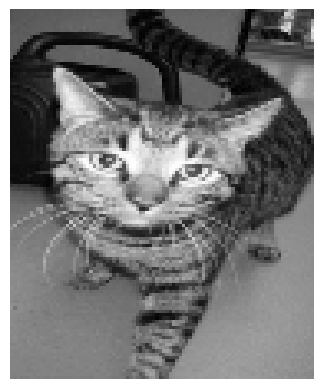

Failure Case
299
Predicted face but actual is non face


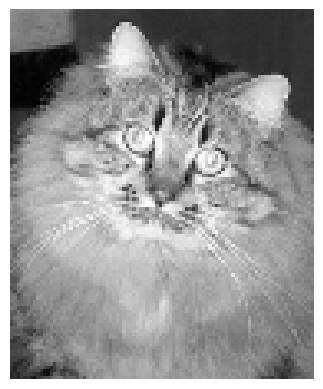

Failure Case
302
Predicted face but actual is non face


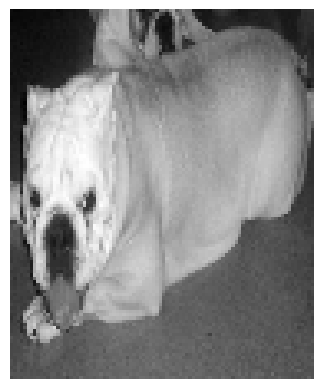

Failure Case
310
Predicted face but actual is non face


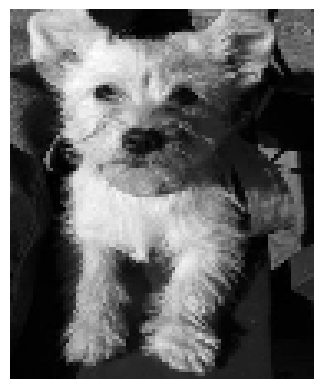

Failure Case
319
Predicted face but actual is non face


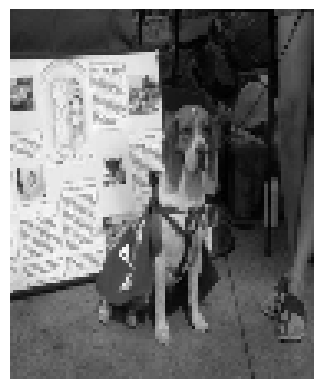

Failure Case
322
Predicted face but actual is non face


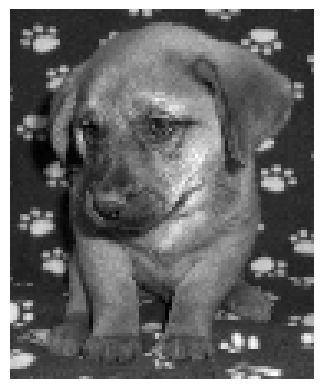

Failure Case
328
Predicted face but actual is non face


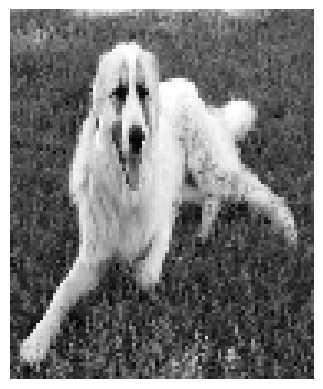

Failure Case
332
Predicted face but actual is non face


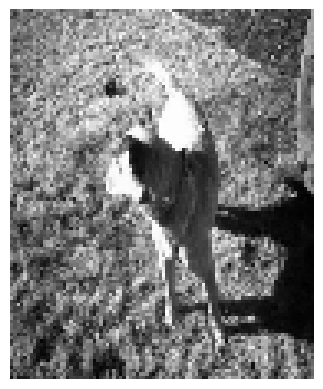

Failure Case
339
Predicted face but actual is non face


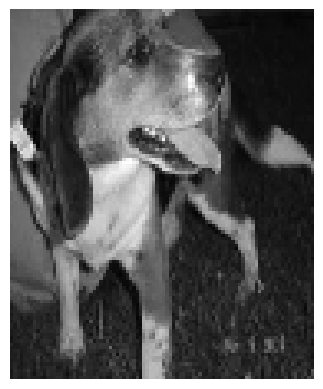

Failure Case
346
Predicted face but actual is non face


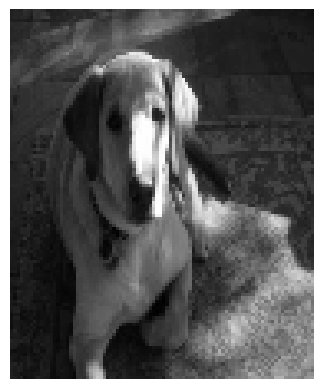

Failure Case
348
Predicted face but actual is non face


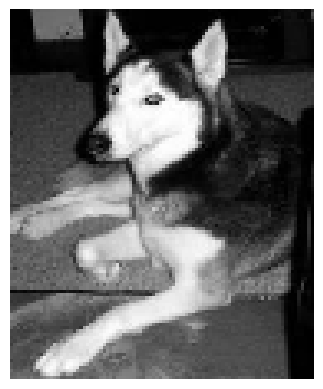

Failure Case
363
Predicted face but actual is non face


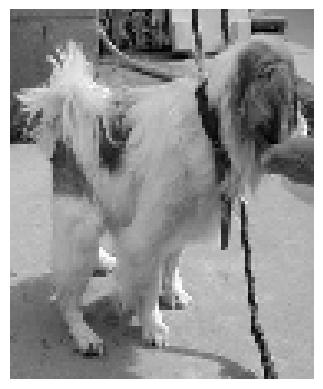

Failure Case
367
Predicted face but actual is non face


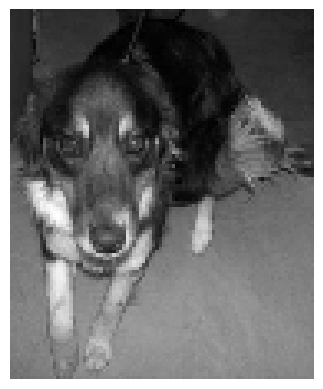

Failure Case
368
Predicted face but actual is non face


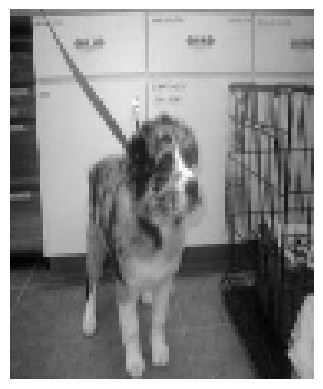

Failure Case
369
Predicted face but actual is non face


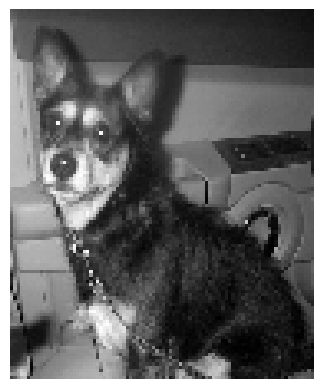

Failure Case
371
Predicted face but actual is non face


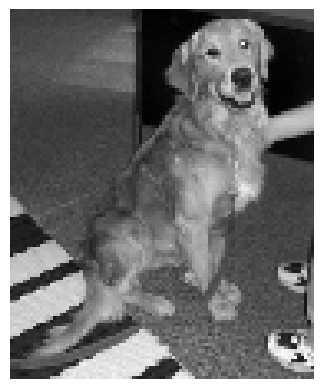

Failure Case
372
Predicted face but actual is non face


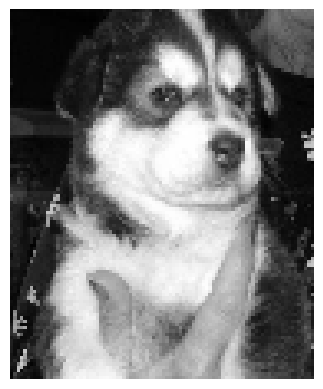

Failure Case
379
Predicted face but actual is non face


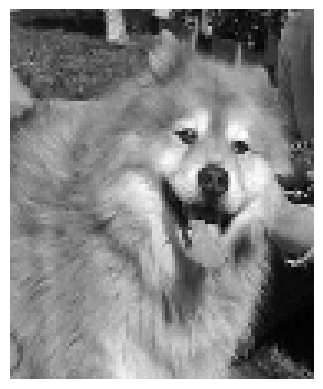

Failure Case
385
Predicted face but actual is non face


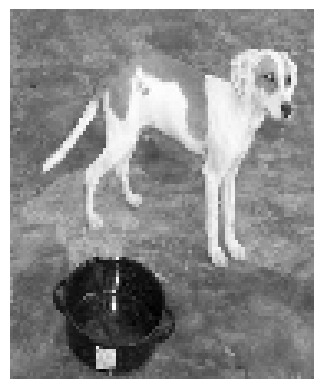

acc = 0.88
ACCURACY FOR ALPHA:0.9 AND K = 3 IS :- 0.865
CONFUSION MATRIX:
[[200   0]
 [ 54 146]]
Failure Case
204
Predicted face but actual is non face


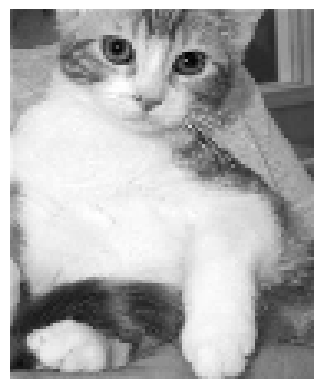

Failure Case
207
Predicted face but actual is non face


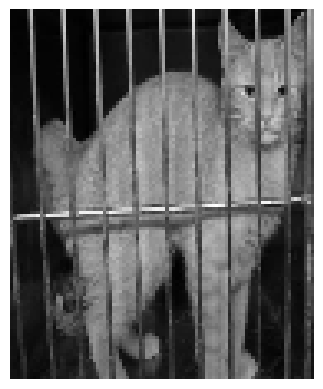

Failure Case
212
Predicted face but actual is non face


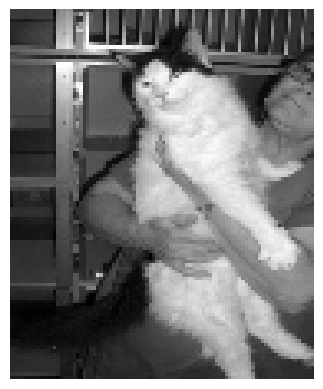

Failure Case
218
Predicted face but actual is non face


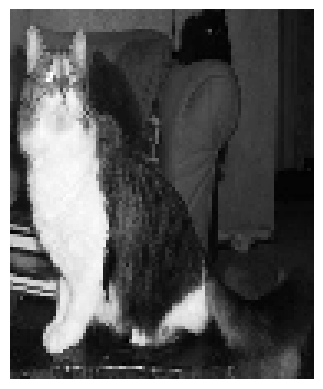

Failure Case
219
Predicted face but actual is non face


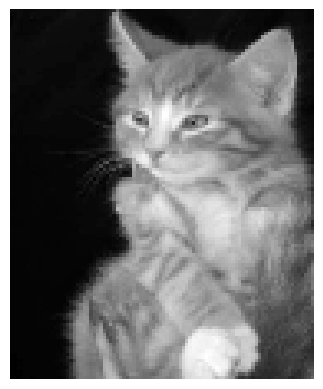

Failure Case
220
Predicted face but actual is non face


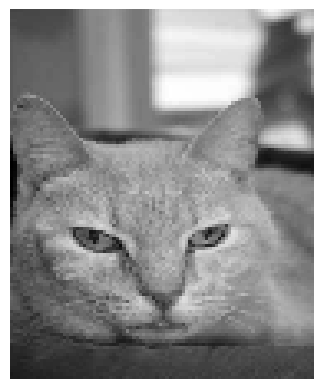

Failure Case
222
Predicted face but actual is non face


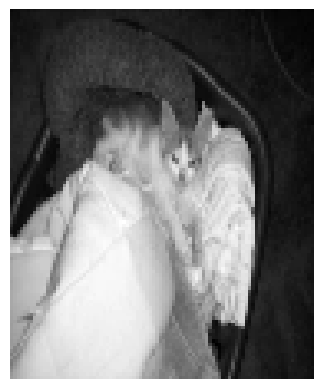

Failure Case
224
Predicted face but actual is non face


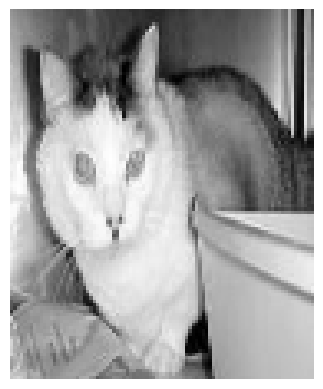

Failure Case
225
Predicted face but actual is non face


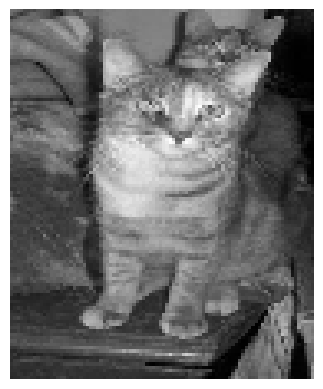

Failure Case
228
Predicted face but actual is non face


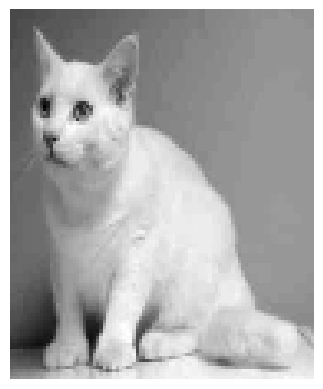

Failure Case
234
Predicted face but actual is non face


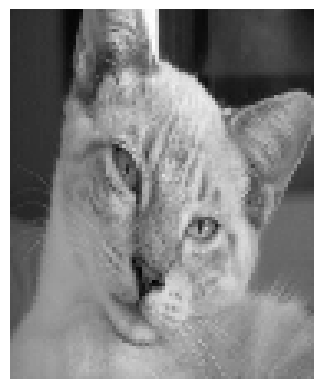

Failure Case
240
Predicted face but actual is non face


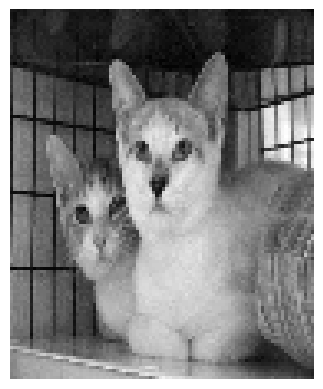

Failure Case
241
Predicted face but actual is non face


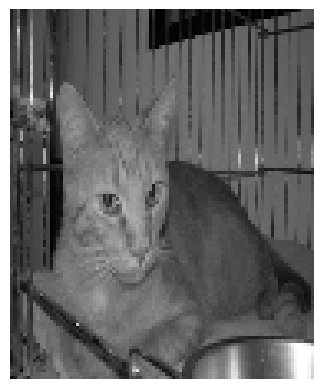

Failure Case
246
Predicted face but actual is non face


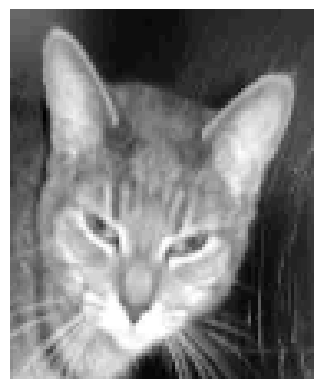

Failure Case
247
Predicted face but actual is non face


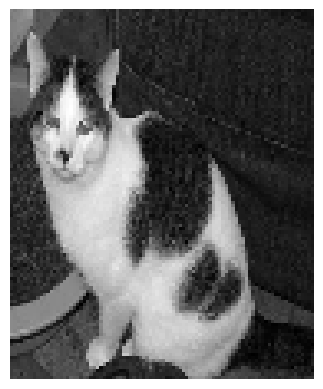

Failure Case
248
Predicted face but actual is non face


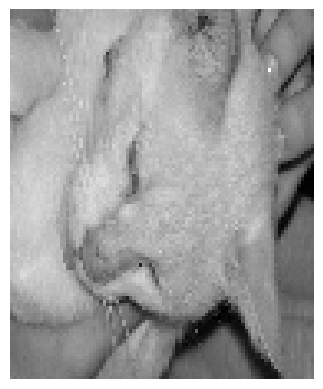

Failure Case
253
Predicted face but actual is non face


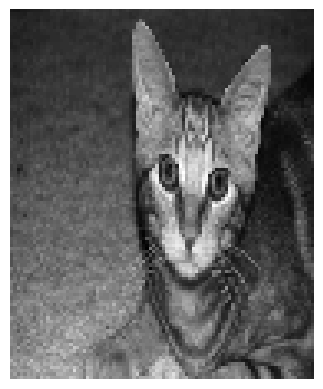

Failure Case
255
Predicted face but actual is non face


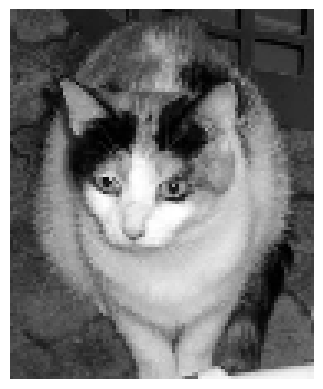

Failure Case
257
Predicted face but actual is non face


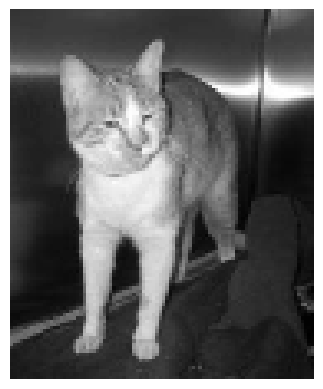

Failure Case
258
Predicted face but actual is non face


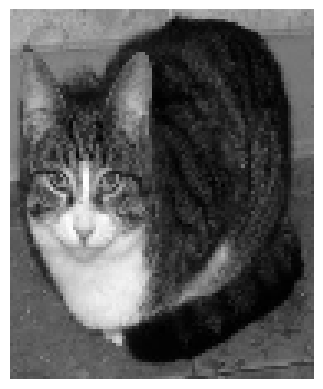

Failure Case
260
Predicted face but actual is non face


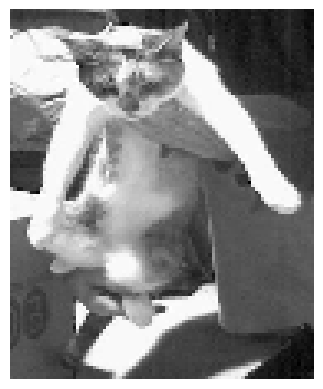

Failure Case
261
Predicted face but actual is non face


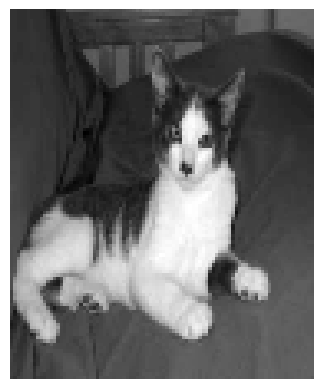

Failure Case
262
Predicted face but actual is non face


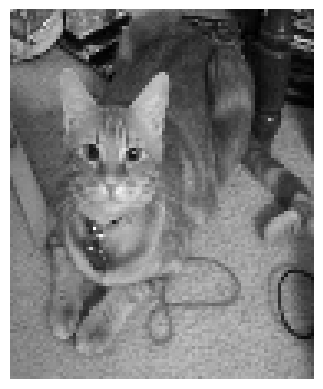

Failure Case
263
Predicted face but actual is non face


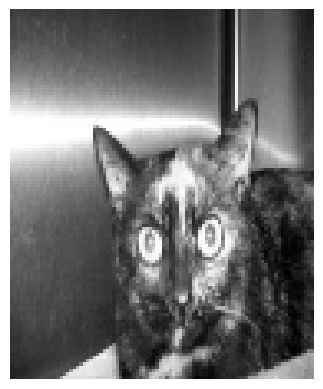

Failure Case
268
Predicted face but actual is non face


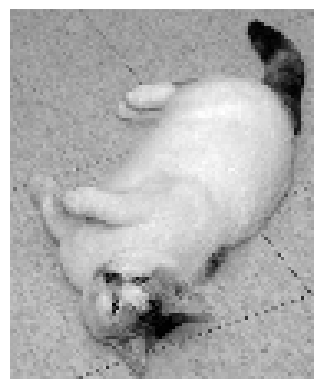

Failure Case
270
Predicted face but actual is non face


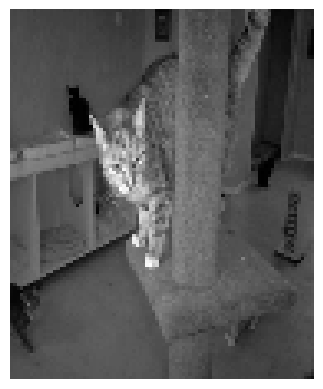

Failure Case
272
Predicted face but actual is non face


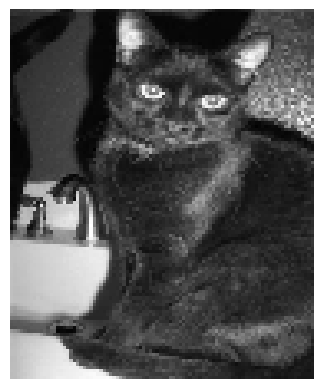

Failure Case
278
Predicted face but actual is non face


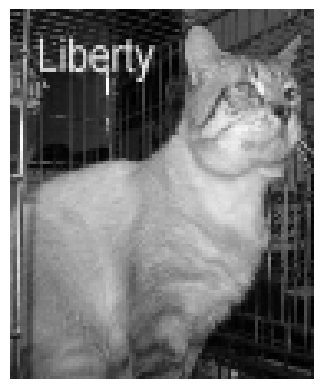

Failure Case
279
Predicted face but actual is non face


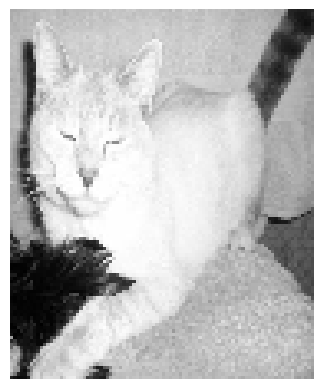

Failure Case
291
Predicted face but actual is non face


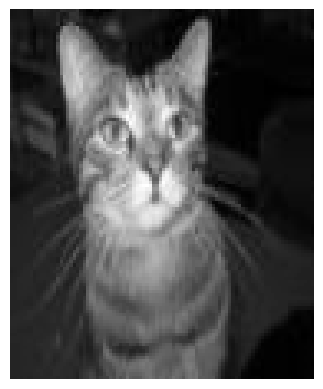

Failure Case
292
Predicted face but actual is non face


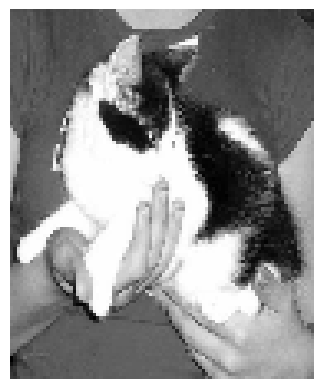

Failure Case
298
Predicted face but actual is non face


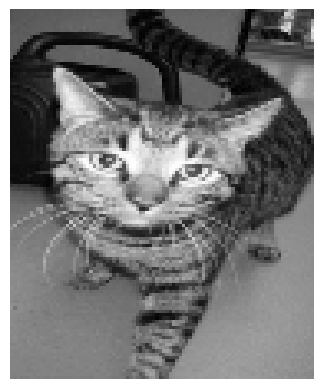

Failure Case
299
Predicted face but actual is non face


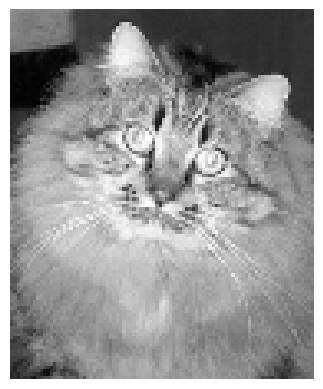

Failure Case
302
Predicted face but actual is non face


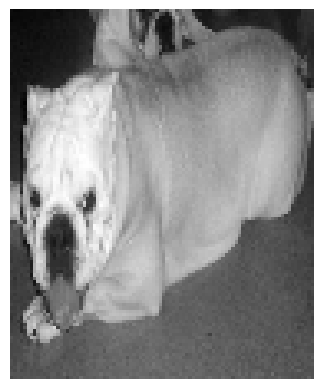

Failure Case
304
Predicted face but actual is non face


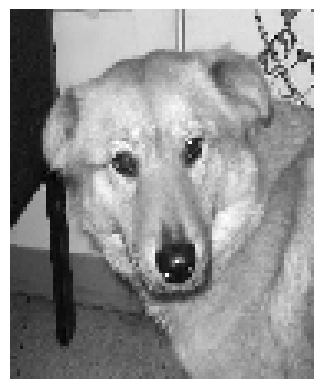

Failure Case
310
Predicted face but actual is non face


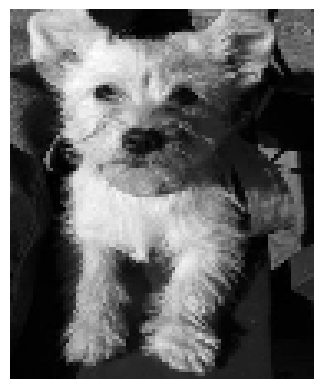

Failure Case
313
Predicted face but actual is non face


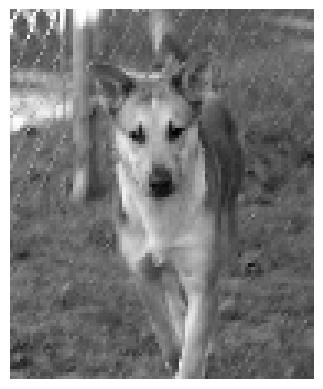

Failure Case
319
Predicted face but actual is non face


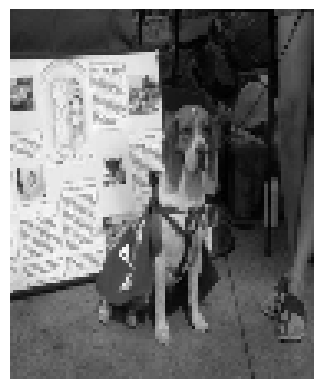

Failure Case
322
Predicted face but actual is non face


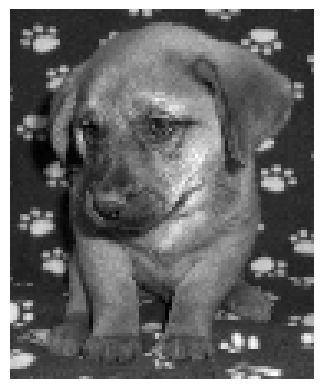

Failure Case
328
Predicted face but actual is non face


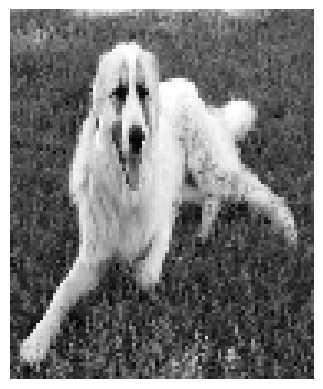

Failure Case
332
Predicted face but actual is non face


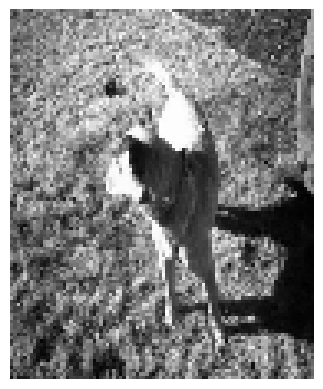

Failure Case
333
Predicted face but actual is non face


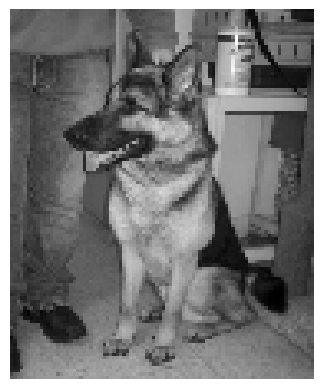

Failure Case
339
Predicted face but actual is non face


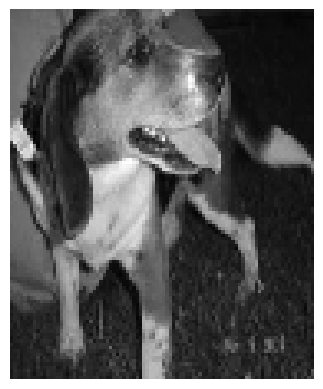

Failure Case
346
Predicted face but actual is non face


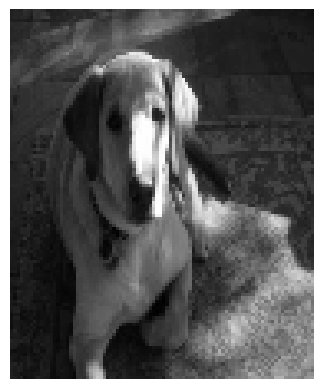

Failure Case
348
Predicted face but actual is non face


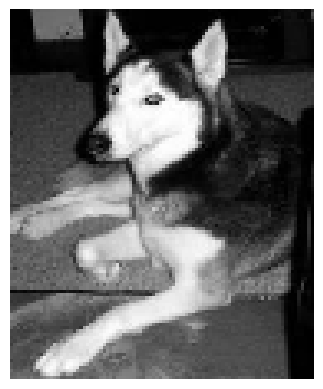

Failure Case
363
Predicted face but actual is non face


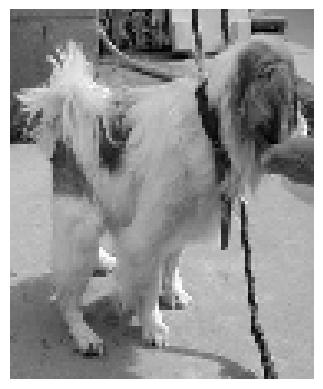

Failure Case
368
Predicted face but actual is non face


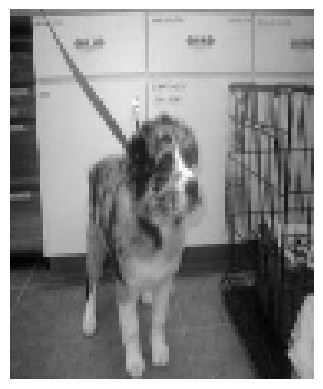

Failure Case
369
Predicted face but actual is non face


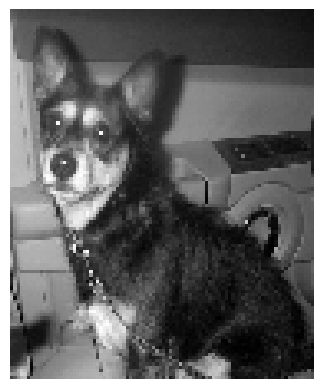

Failure Case
371
Predicted face but actual is non face


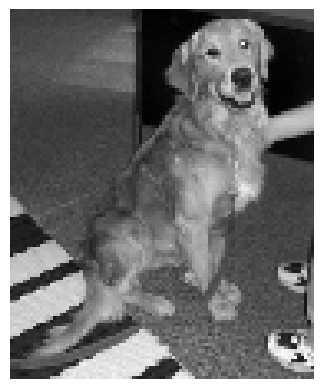

Failure Case
372
Predicted face but actual is non face


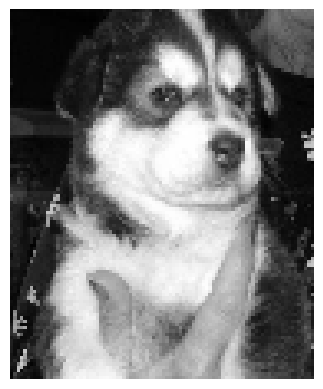

Failure Case
376
Predicted face but actual is non face


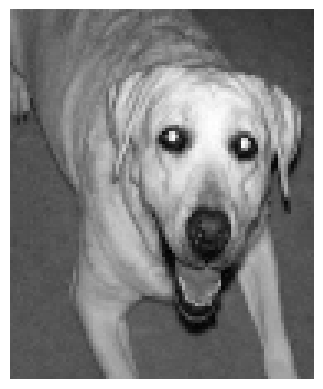

Failure Case
379
Predicted face but actual is non face


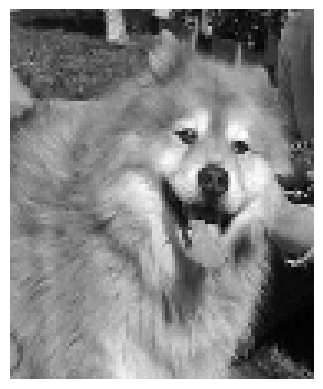

Failure Case
384
Predicted face but actual is non face


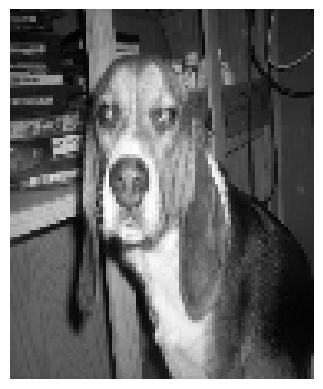

Failure Case
385
Predicted face but actual is non face


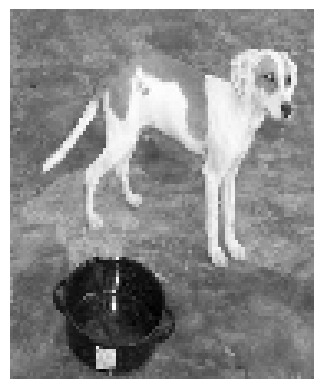

acc = 0.865
ACCURACY FOR ALPHA:0.95 AND K = 3 IS :- 0.8375
CONFUSION MATRIX:
[[200   0]
 [ 65 135]]
Failure Case
201
Predicted face but actual is non face


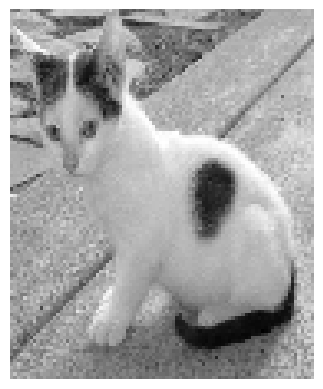

Failure Case
202
Predicted face but actual is non face


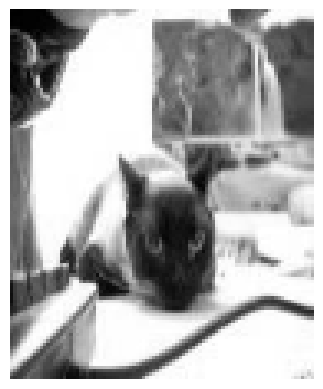

Failure Case
204
Predicted face but actual is non face


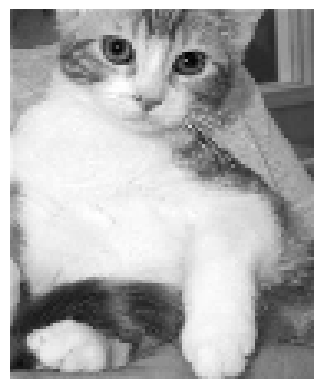

Failure Case
206
Predicted face but actual is non face


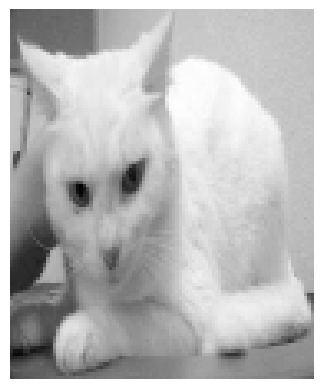

Failure Case
207
Predicted face but actual is non face


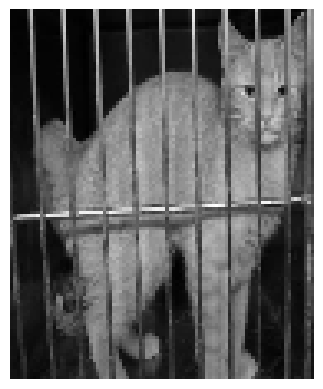

Failure Case
212
Predicted face but actual is non face


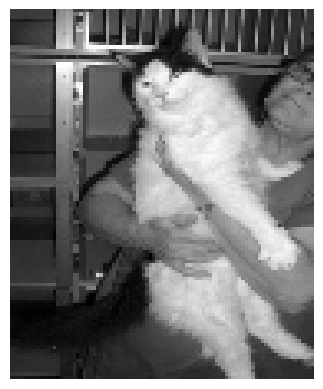

Failure Case
218
Predicted face but actual is non face


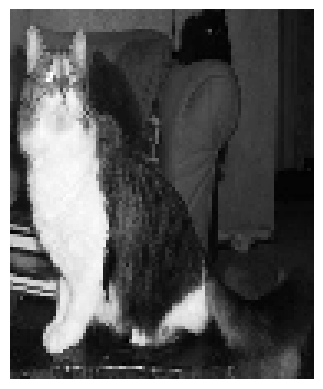

Failure Case
219
Predicted face but actual is non face


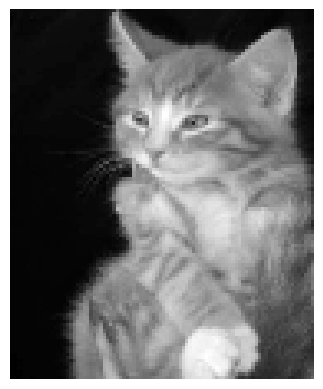

Failure Case
220
Predicted face but actual is non face


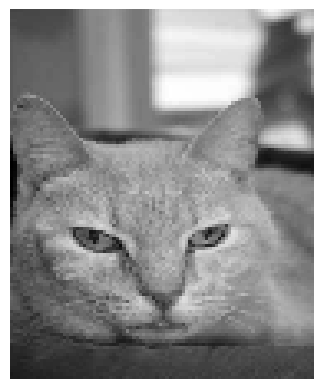

Failure Case
222
Predicted face but actual is non face


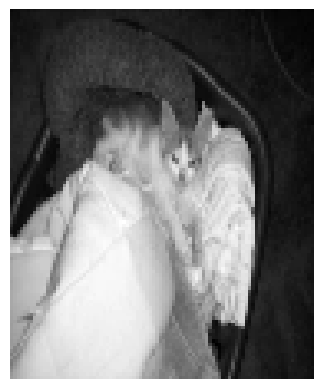

Failure Case
224
Predicted face but actual is non face


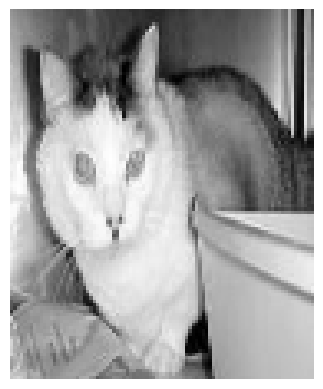

Failure Case
225
Predicted face but actual is non face


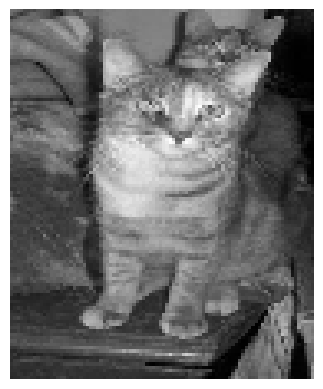

Failure Case
228
Predicted face but actual is non face


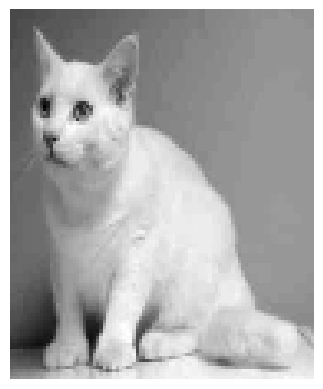

Failure Case
234
Predicted face but actual is non face


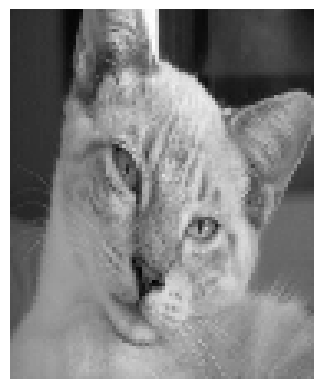

Failure Case
240
Predicted face but actual is non face


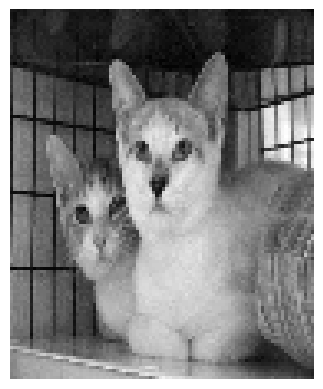

Failure Case
241
Predicted face but actual is non face


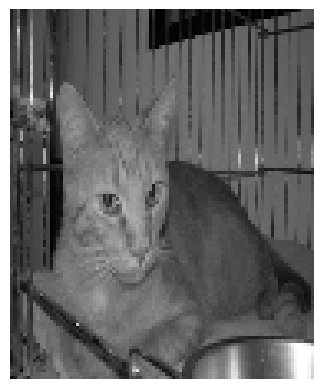

Failure Case
246
Predicted face but actual is non face


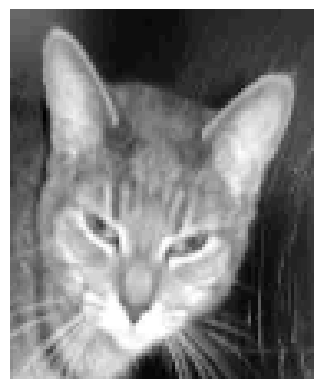

Failure Case
247
Predicted face but actual is non face


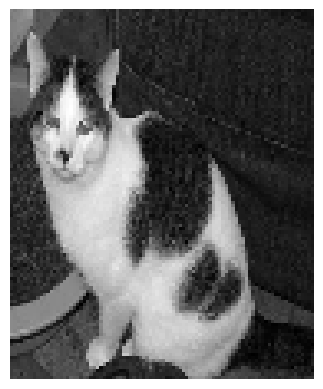

Failure Case
248
Predicted face but actual is non face


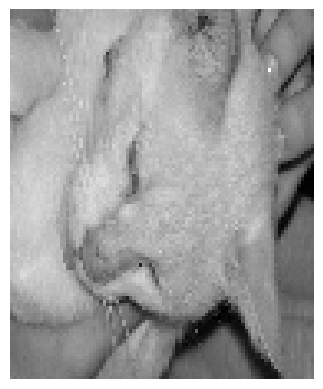

Failure Case
253
Predicted face but actual is non face


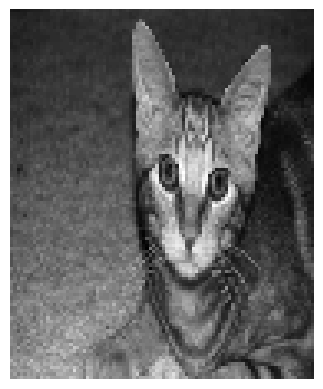

Failure Case
255
Predicted face but actual is non face


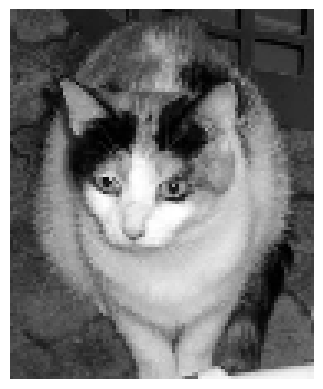

Failure Case
257
Predicted face but actual is non face


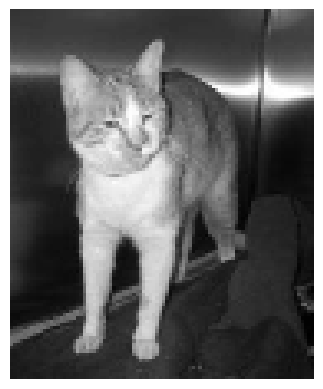

Failure Case
258
Predicted face but actual is non face


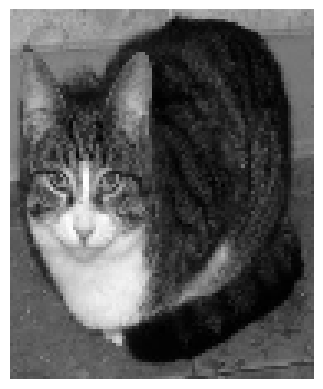

Failure Case
259
Predicted face but actual is non face


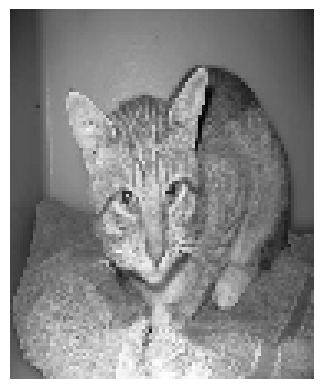

Failure Case
260
Predicted face but actual is non face


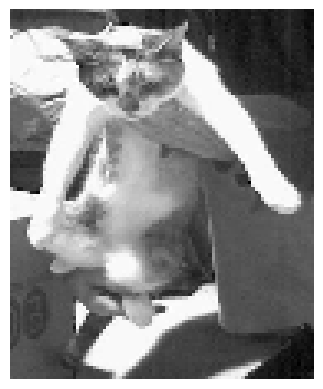

Failure Case
261
Predicted face but actual is non face


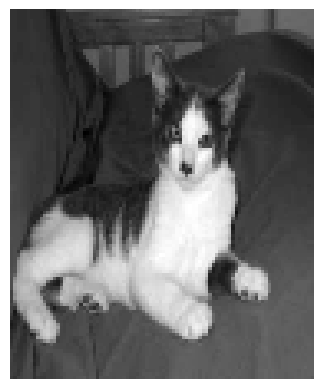

Failure Case
262
Predicted face but actual is non face


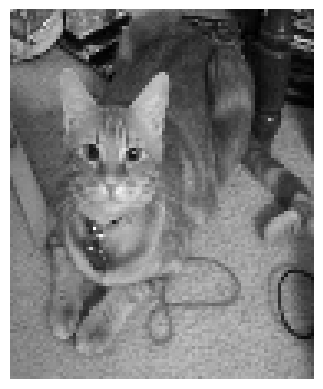

Failure Case
263
Predicted face but actual is non face


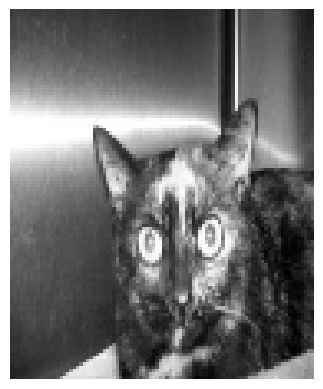

Failure Case
265
Predicted face but actual is non face


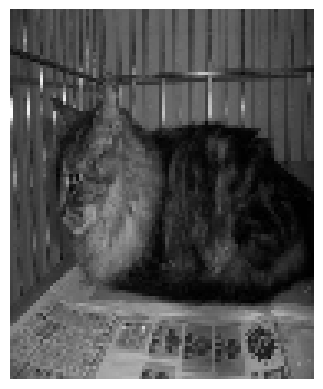

Failure Case
268
Predicted face but actual is non face


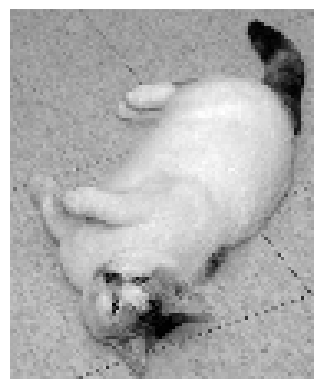

Failure Case
270
Predicted face but actual is non face


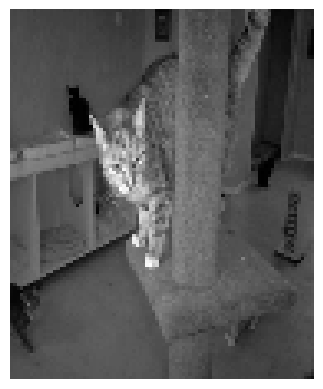

Failure Case
272
Predicted face but actual is non face


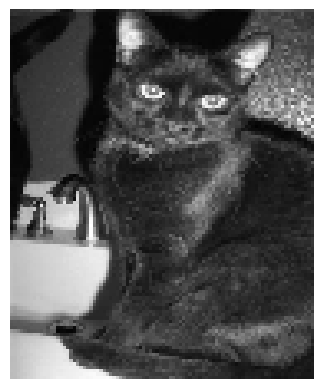

Failure Case
275
Predicted face but actual is non face


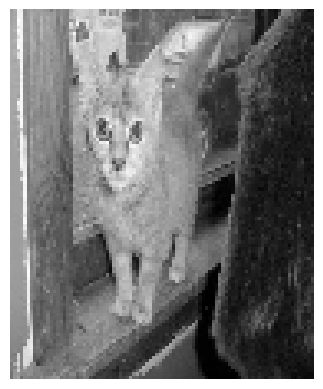

Failure Case
278
Predicted face but actual is non face


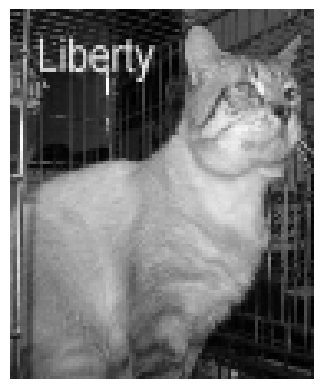

Failure Case
279
Predicted face but actual is non face


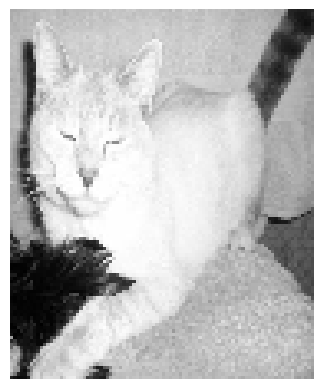

Failure Case
290
Predicted face but actual is non face


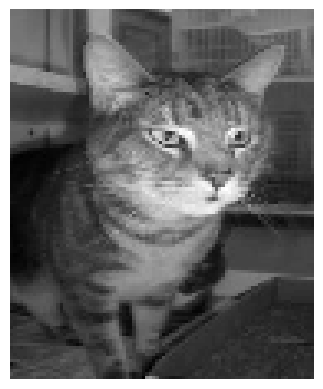

Failure Case
291
Predicted face but actual is non face


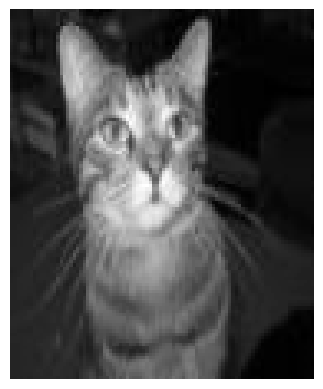

Failure Case
292
Predicted face but actual is non face


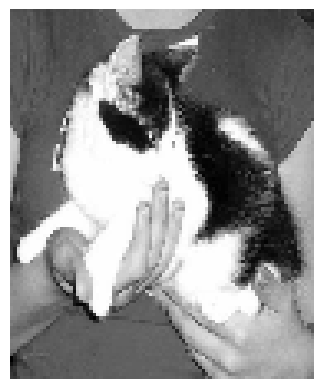

Failure Case
297
Predicted face but actual is non face


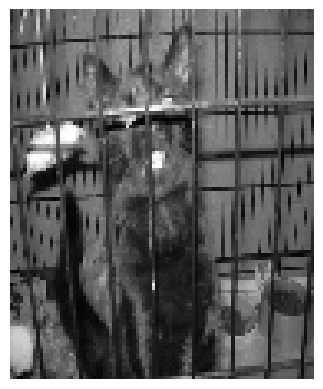

Failure Case
299
Predicted face but actual is non face


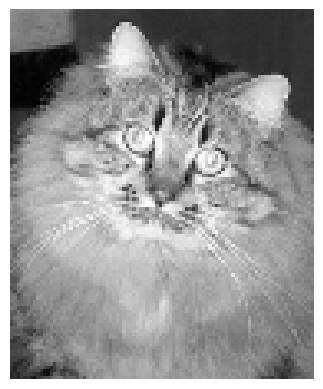

Failure Case
302
Predicted face but actual is non face


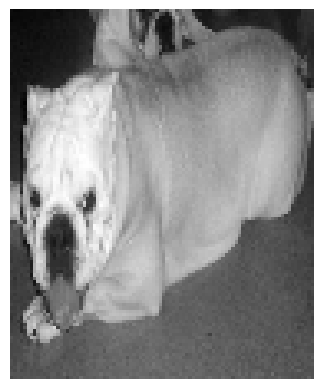

Failure Case
304
Predicted face but actual is non face


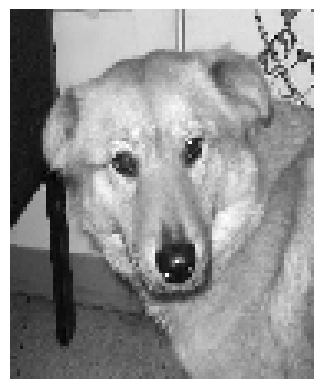

Failure Case
310
Predicted face but actual is non face


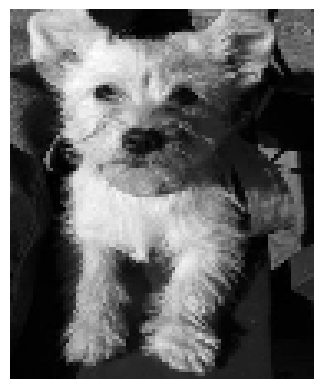

Failure Case
313
Predicted face but actual is non face


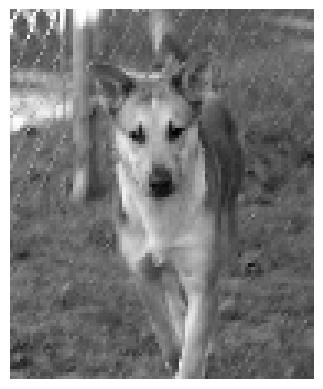

Failure Case
319
Predicted face but actual is non face


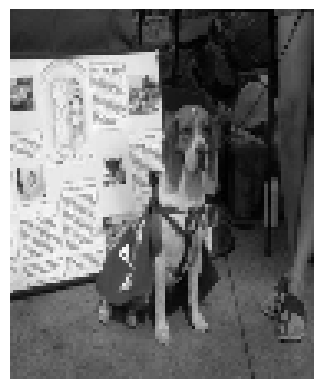

Failure Case
322
Predicted face but actual is non face


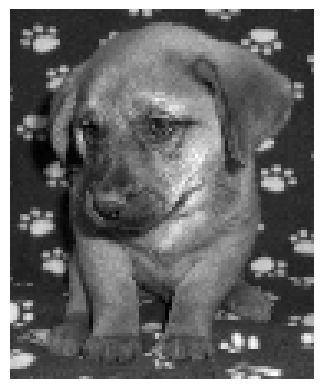

Failure Case
325
Predicted face but actual is non face


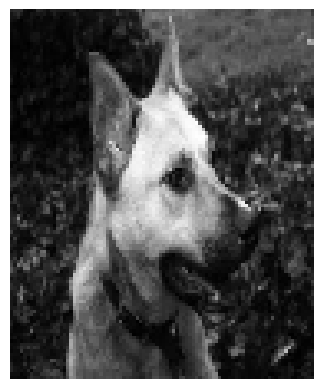

Failure Case
328
Predicted face but actual is non face


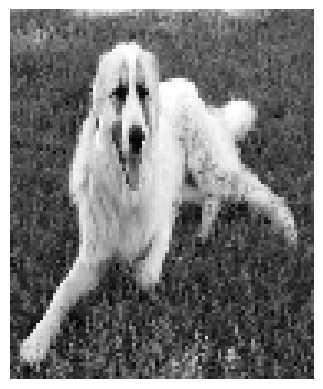

Failure Case
332
Predicted face but actual is non face


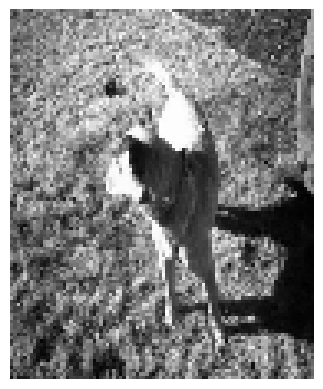

Failure Case
333
Predicted face but actual is non face


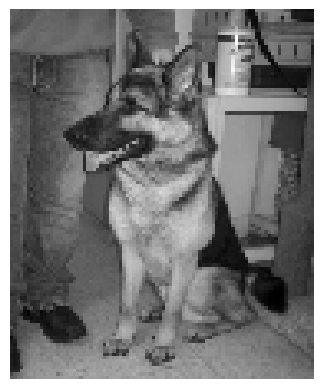

Failure Case
335
Predicted face but actual is non face


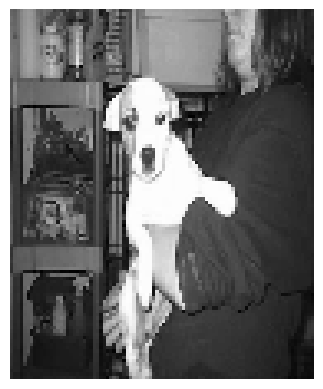

Failure Case
339
Predicted face but actual is non face


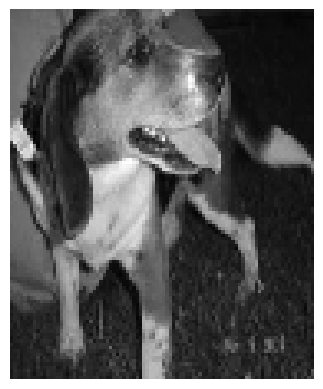

Failure Case
346
Predicted face but actual is non face


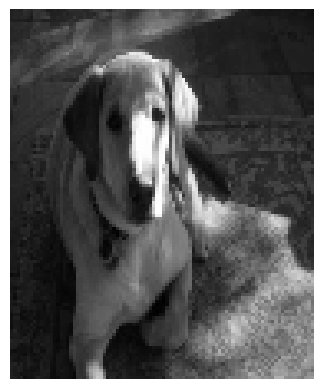

Failure Case
348
Predicted face but actual is non face


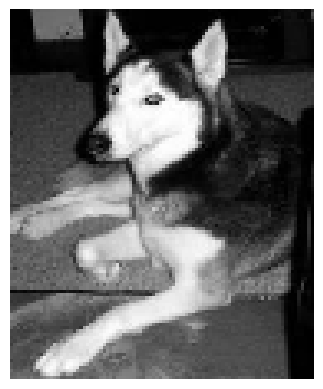

Failure Case
363
Predicted face but actual is non face


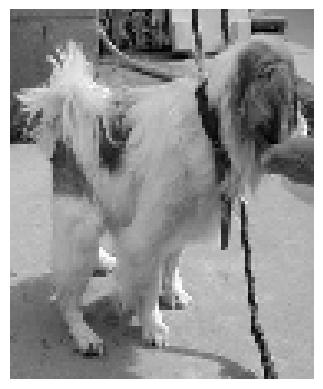

Failure Case
368
Predicted face but actual is non face


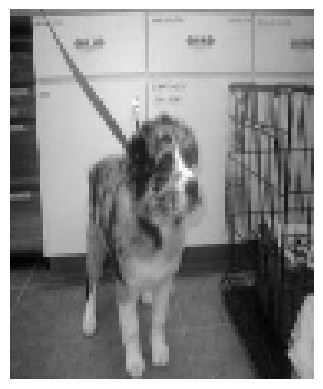

Failure Case
369
Predicted face but actual is non face


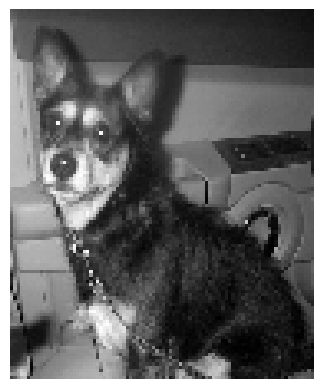

Failure Case
371
Predicted face but actual is non face


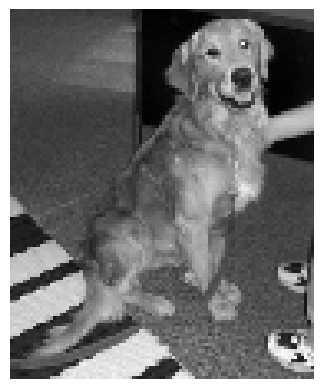

Failure Case
372
Predicted face but actual is non face


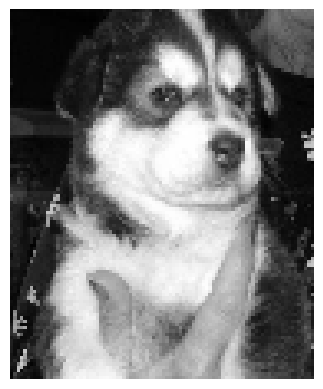

Failure Case
376
Predicted face but actual is non face


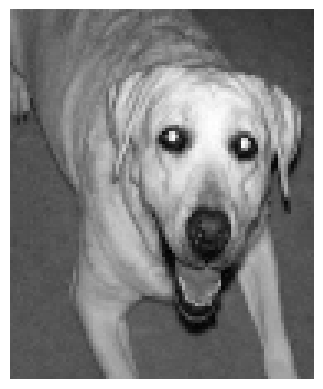

Failure Case
378
Predicted face but actual is non face


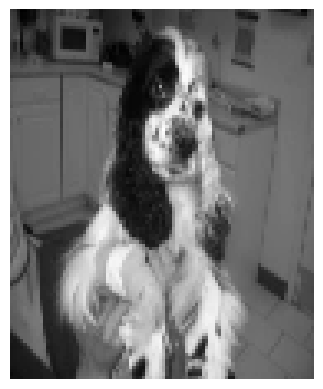

Failure Case
379
Predicted face but actual is non face


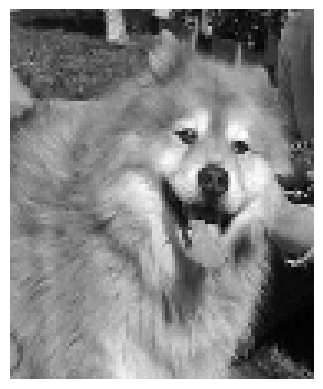

Failure Case
384
Predicted face but actual is non face


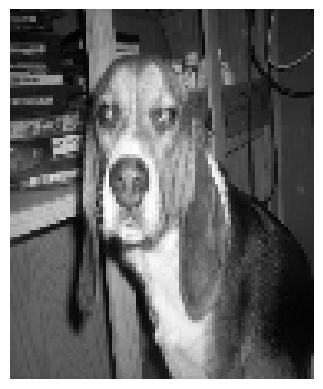

Failure Case
385
Predicted face but actual is non face


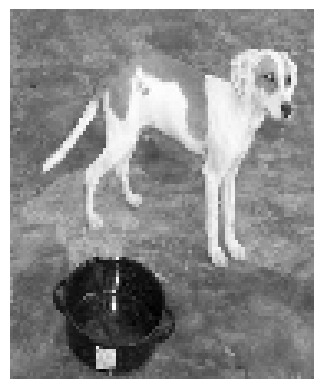

Failure Case
386
Predicted face but actual is non face


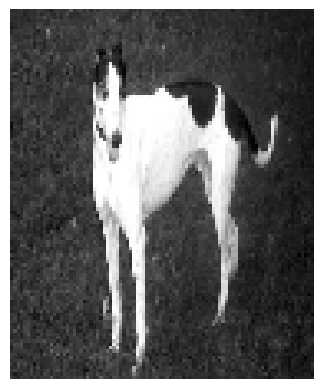

acc = 0.8375
Done for k = 3



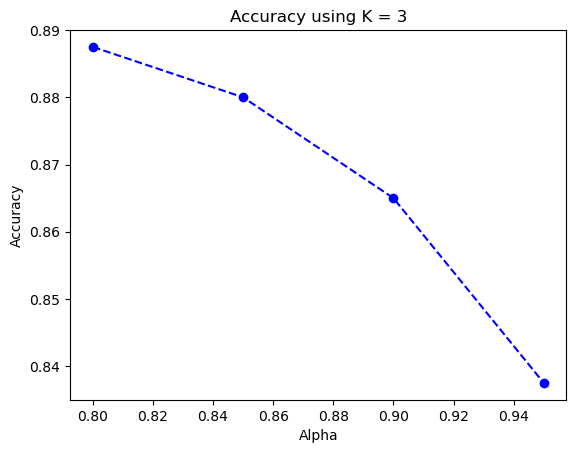

ACCURACY FOR ALPHA:0.8 AND K = 5 IS :- 0.8675
CONFUSION MATRIX:
[[200   0]
 [ 53 147]]
Failure Case
204
Predicted face but actual is non face


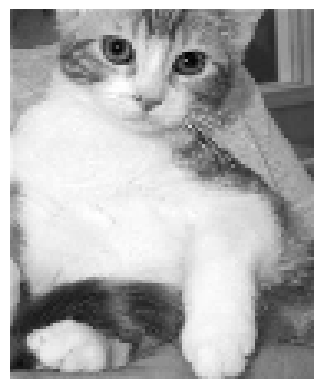

Failure Case
206
Predicted face but actual is non face


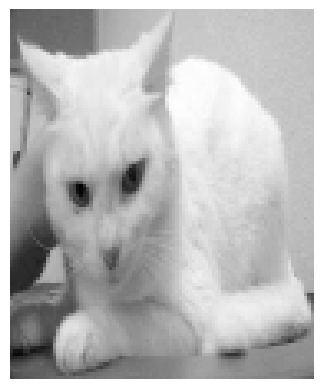

Failure Case
207
Predicted face but actual is non face


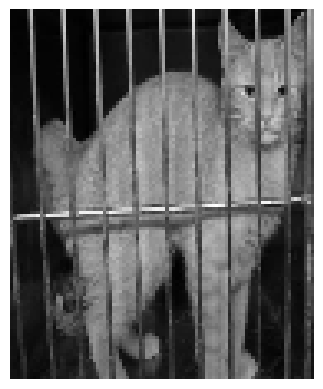

Failure Case
212
Predicted face but actual is non face


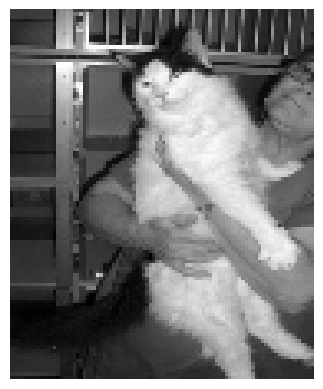

Failure Case
218
Predicted face but actual is non face


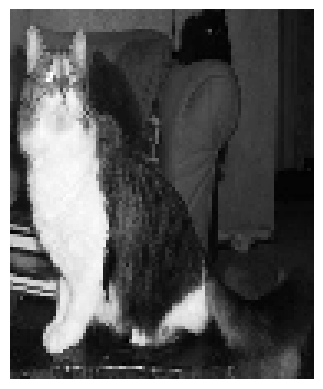

Failure Case
220
Predicted face but actual is non face


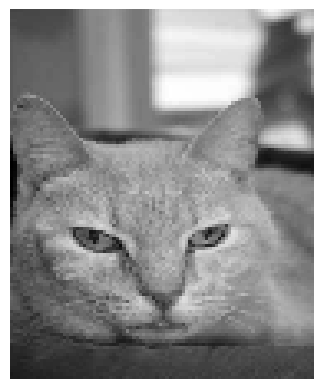

Failure Case
222
Predicted face but actual is non face


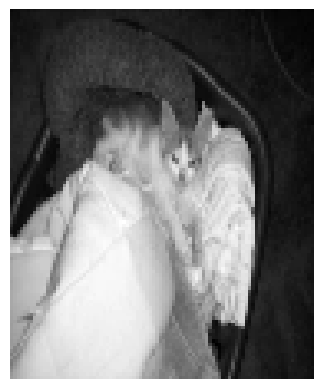

Failure Case
224
Predicted face but actual is non face


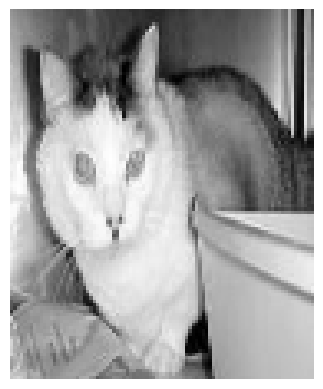

Failure Case
225
Predicted face but actual is non face


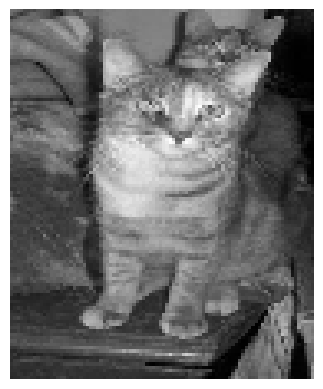

Failure Case
234
Predicted face but actual is non face


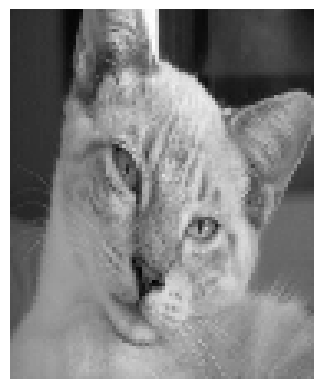

Failure Case
240
Predicted face but actual is non face


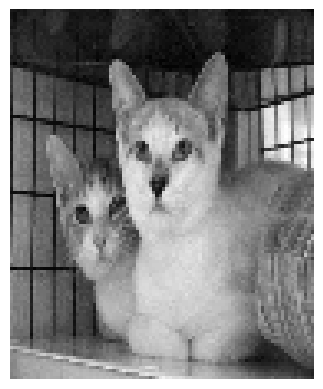

Failure Case
241
Predicted face but actual is non face


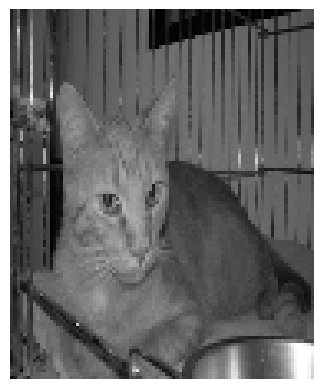

Failure Case
246
Predicted face but actual is non face


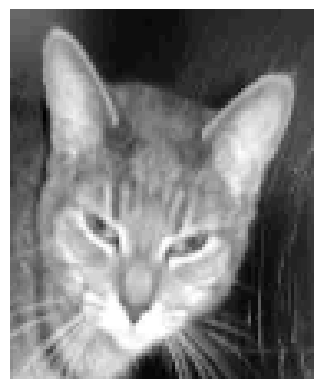

Failure Case
247
Predicted face but actual is non face


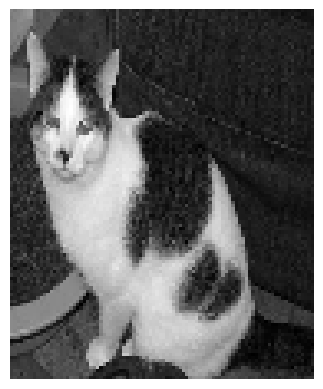

Failure Case
248
Predicted face but actual is non face


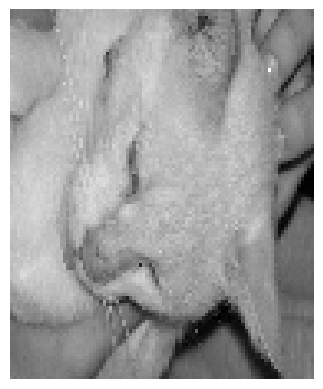

Failure Case
253
Predicted face but actual is non face


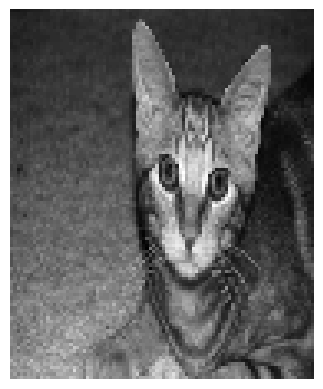

Failure Case
255
Predicted face but actual is non face


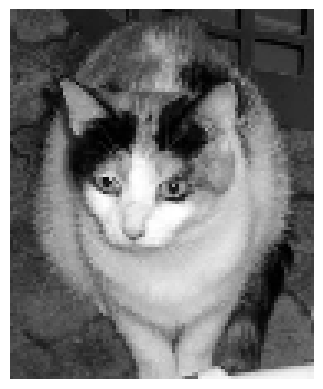

Failure Case
257
Predicted face but actual is non face


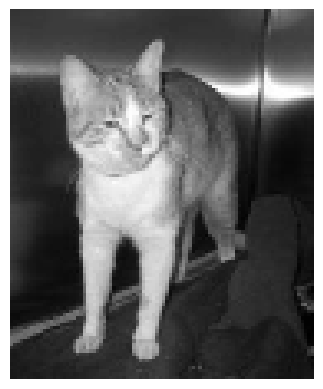

Failure Case
258
Predicted face but actual is non face


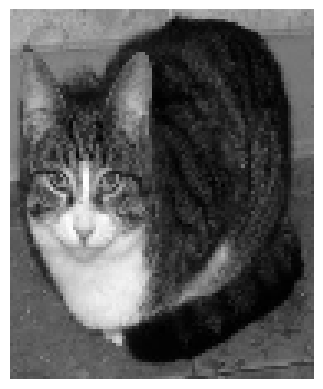

Failure Case
260
Predicted face but actual is non face


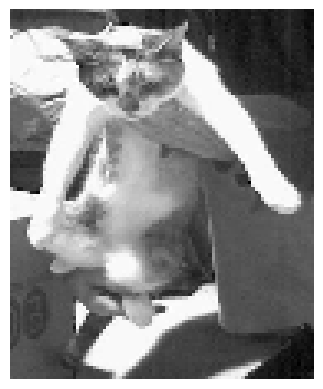

Failure Case
261
Predicted face but actual is non face


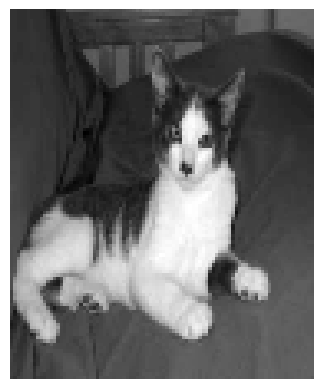

Failure Case
262
Predicted face but actual is non face


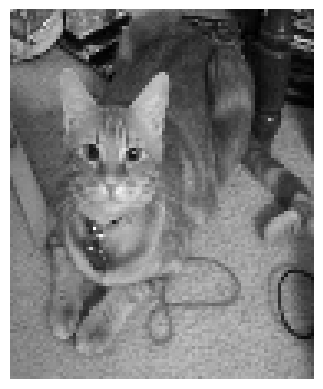

Failure Case
263
Predicted face but actual is non face


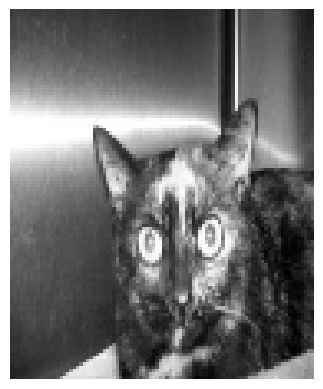

Failure Case
270
Predicted face but actual is non face


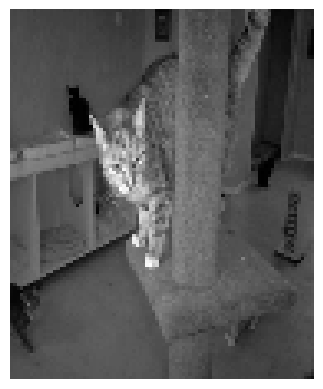

Failure Case
272
Predicted face but actual is non face


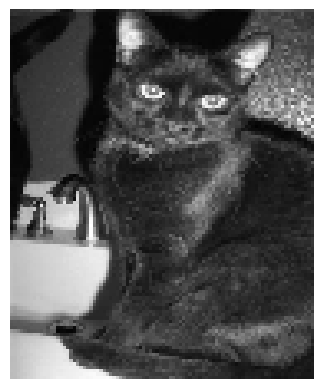

Failure Case
278
Predicted face but actual is non face


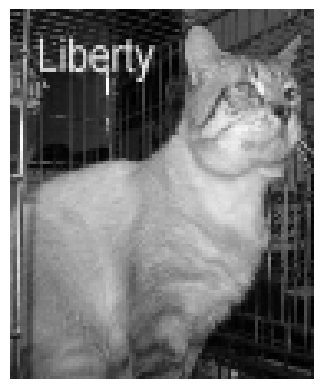

Failure Case
279
Predicted face but actual is non face


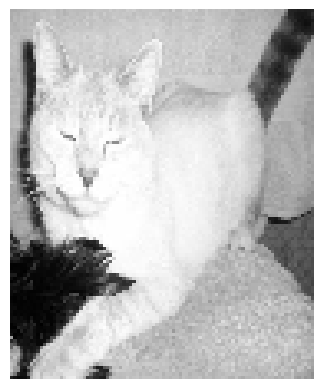

Failure Case
291
Predicted face but actual is non face


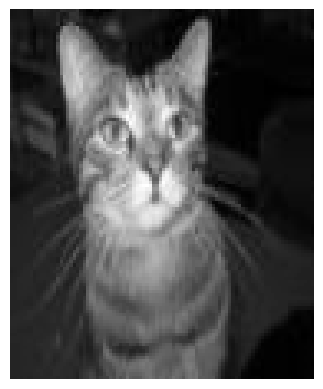

Failure Case
292
Predicted face but actual is non face


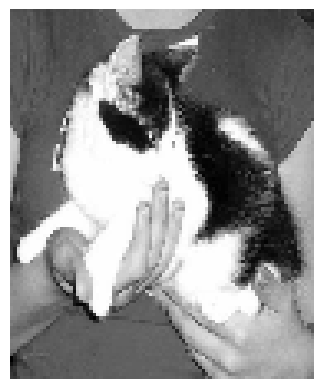

Failure Case
298
Predicted face but actual is non face


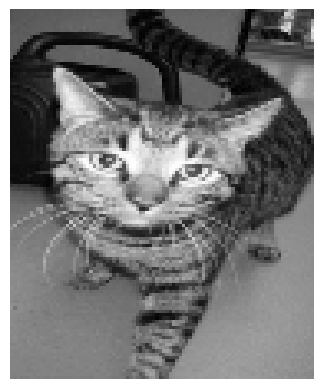

Failure Case
299
Predicted face but actual is non face


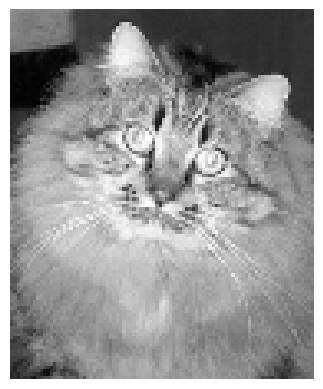

Failure Case
302
Predicted face but actual is non face


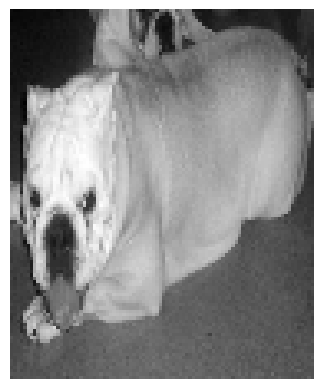

Failure Case
307
Predicted face but actual is non face


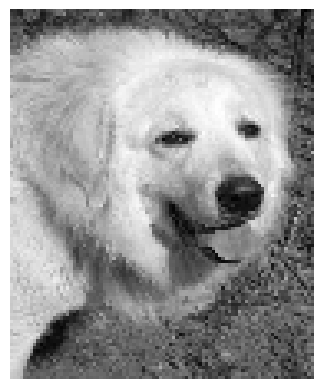

Failure Case
310
Predicted face but actual is non face


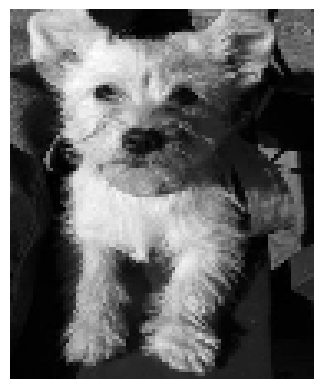

Failure Case
319
Predicted face but actual is non face


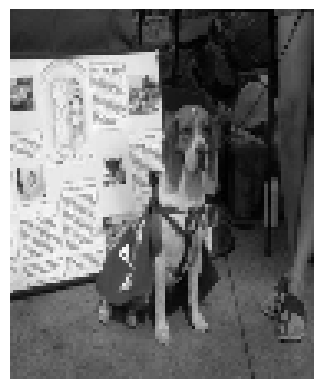

Failure Case
322
Predicted face but actual is non face


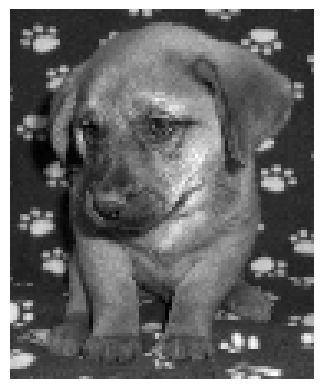

Failure Case
325
Predicted face but actual is non face


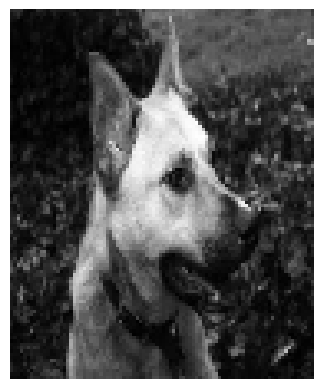

Failure Case
328
Predicted face but actual is non face


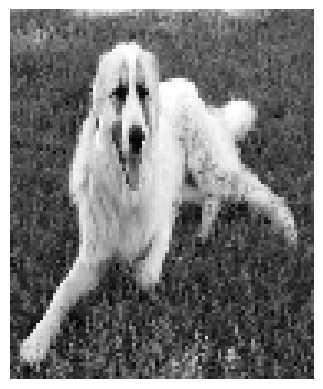

Failure Case
332
Predicted face but actual is non face


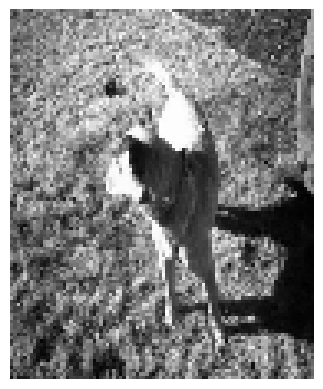

Failure Case
339
Predicted face but actual is non face


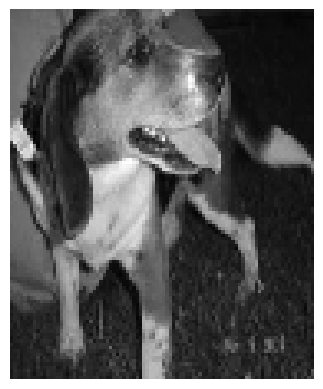

Failure Case
346
Predicted face but actual is non face


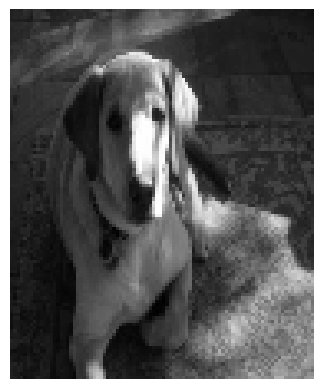

Failure Case
348
Predicted face but actual is non face


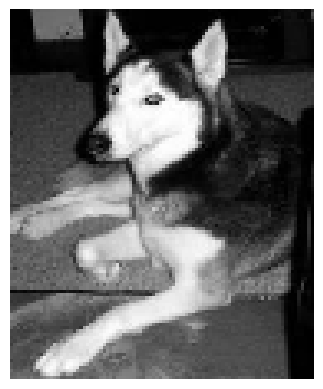

Failure Case
351
Predicted face but actual is non face


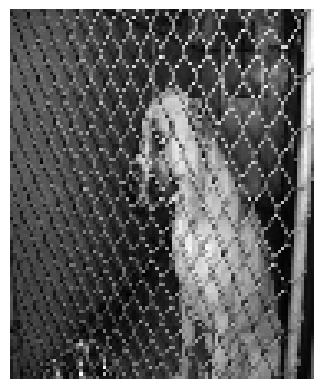

Failure Case
356
Predicted face but actual is non face


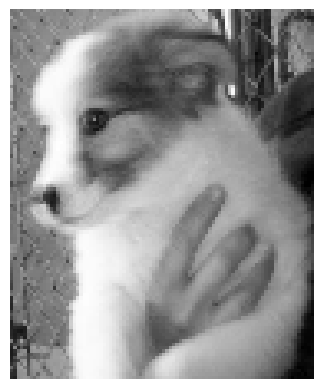

Failure Case
365
Predicted face but actual is non face


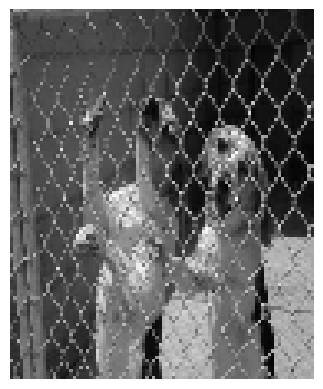

Failure Case
367
Predicted face but actual is non face


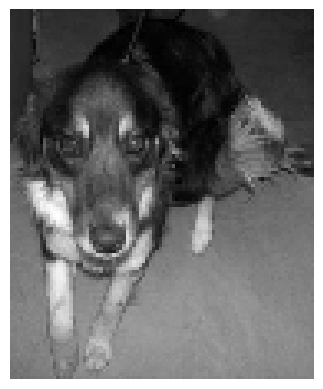

Failure Case
368
Predicted face but actual is non face


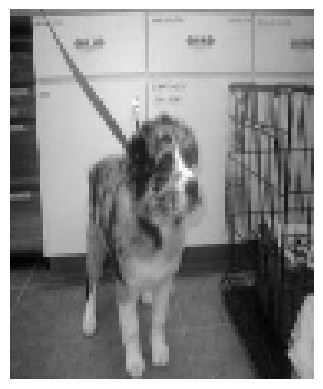

Failure Case
369
Predicted face but actual is non face


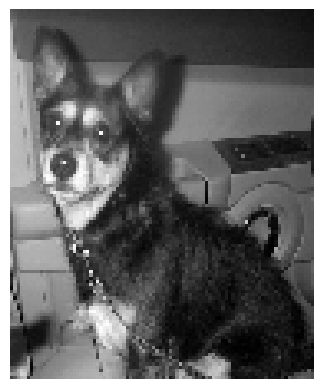

Failure Case
372
Predicted face but actual is non face


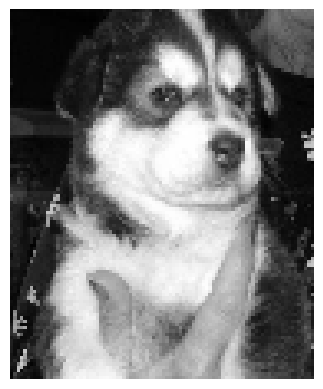

Failure Case
376
Predicted face but actual is non face


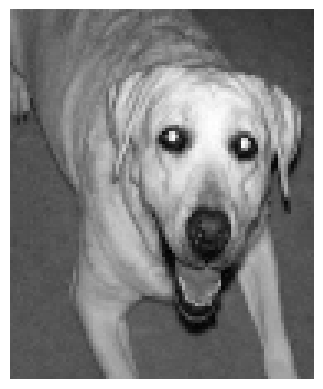

Failure Case
379
Predicted face but actual is non face


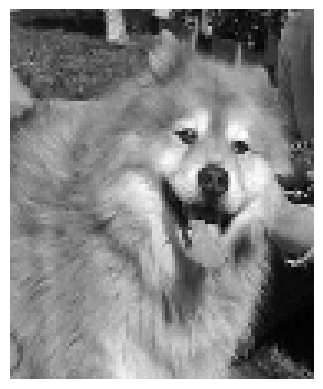

Failure Case
384
Predicted face but actual is non face


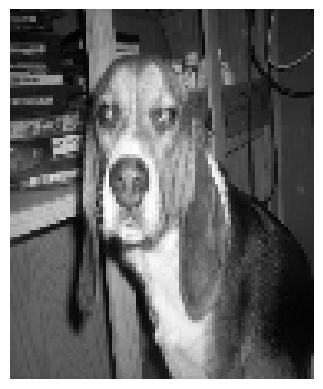

Failure Case
385
Predicted face but actual is non face


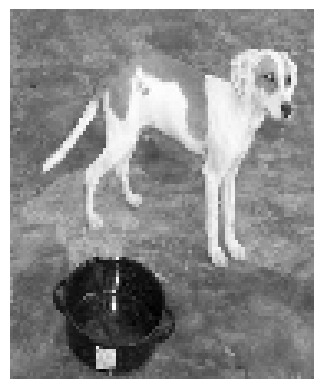

acc = 0.8675
ACCURACY FOR ALPHA:0.85 AND K = 5 IS :- 0.84
CONFUSION MATRIX:
[[200   0]
 [ 64 136]]
Failure Case
200
Predicted face but actual is non face


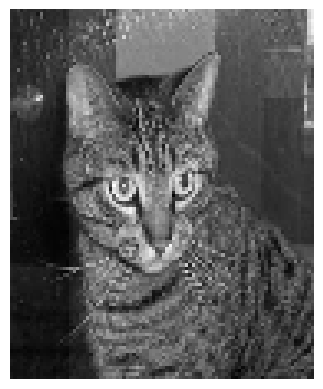

Failure Case
201
Predicted face but actual is non face


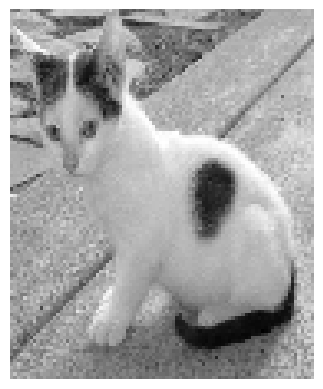

Failure Case
204
Predicted face but actual is non face


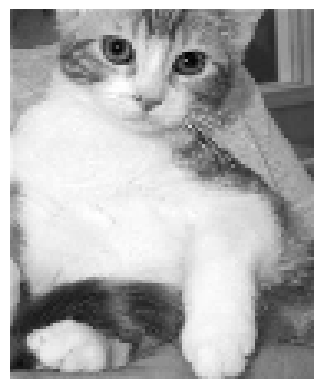

Failure Case
206
Predicted face but actual is non face


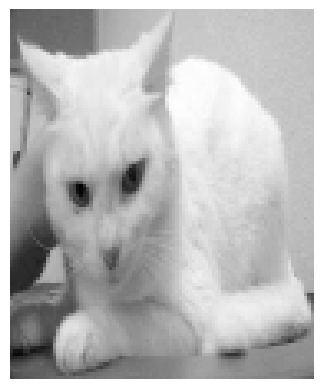

Failure Case
207
Predicted face but actual is non face


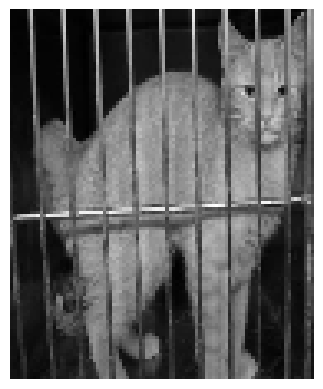

Failure Case
212
Predicted face but actual is non face


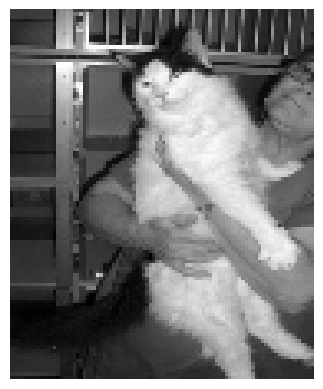

Failure Case
216
Predicted face but actual is non face


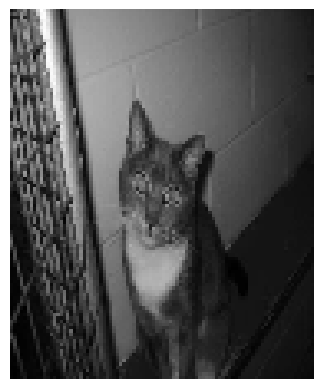

Failure Case
218
Predicted face but actual is non face


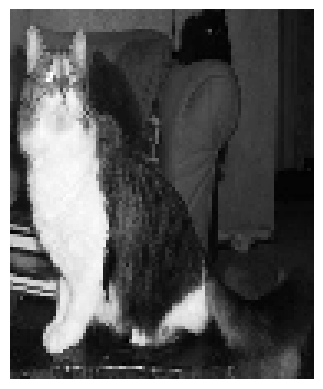

Failure Case
220
Predicted face but actual is non face


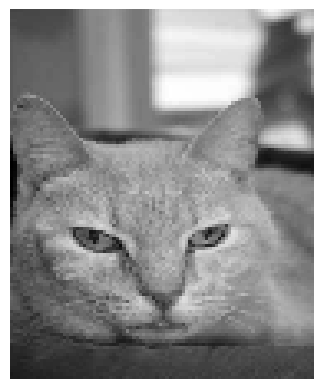

Failure Case
222
Predicted face but actual is non face


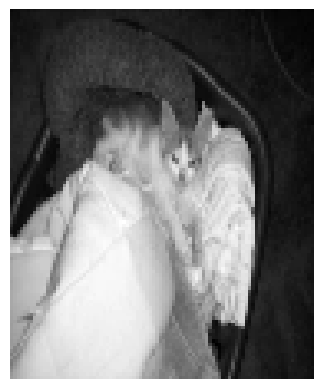

Failure Case
224
Predicted face but actual is non face


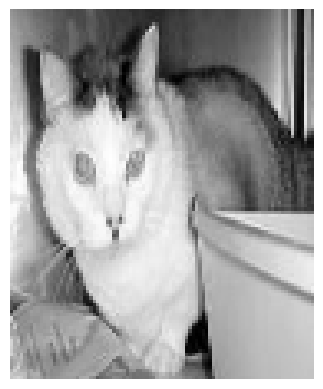

Failure Case
225
Predicted face but actual is non face


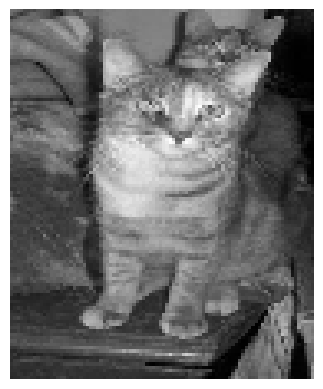

Failure Case
228
Predicted face but actual is non face


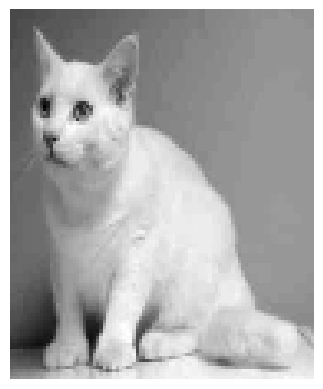

Failure Case
234
Predicted face but actual is non face


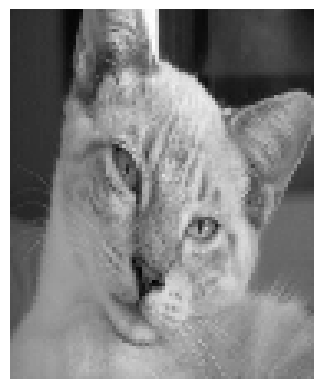

Failure Case
236
Predicted face but actual is non face


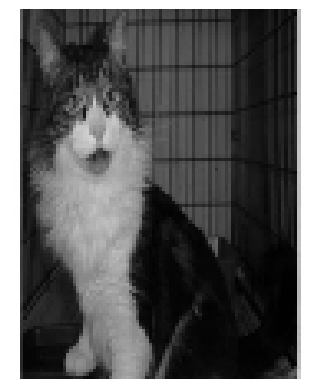

Failure Case
240
Predicted face but actual is non face


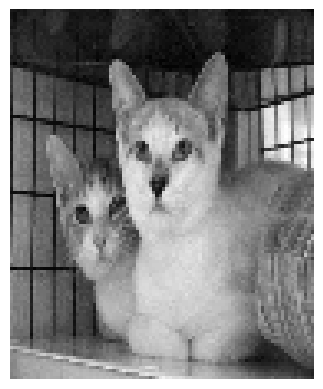

Failure Case
241
Predicted face but actual is non face


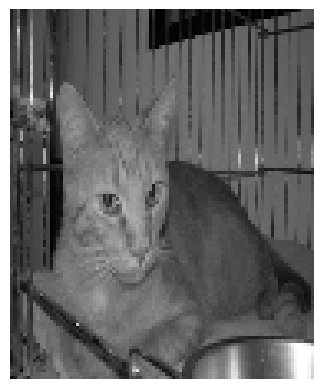

Failure Case
246
Predicted face but actual is non face


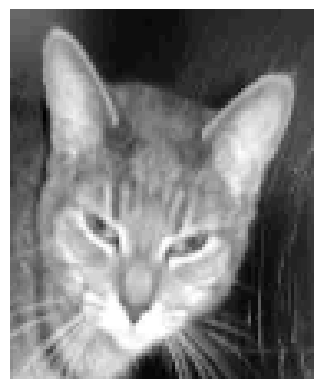

Failure Case
247
Predicted face but actual is non face


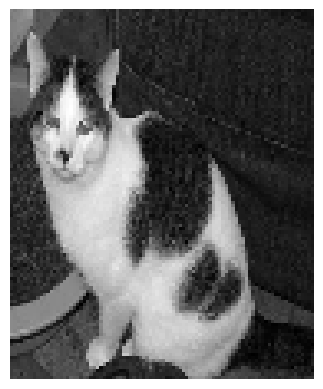

Failure Case
248
Predicted face but actual is non face


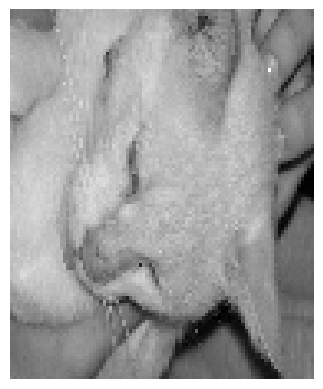

Failure Case
253
Predicted face but actual is non face


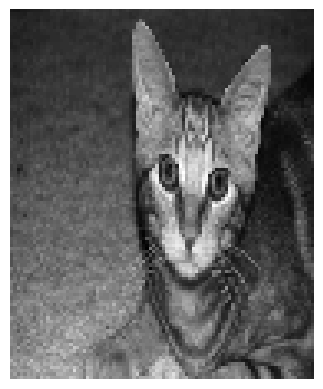

Failure Case
255
Predicted face but actual is non face


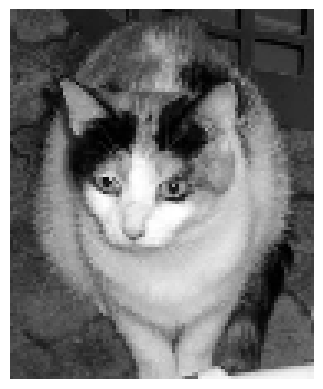

Failure Case
257
Predicted face but actual is non face


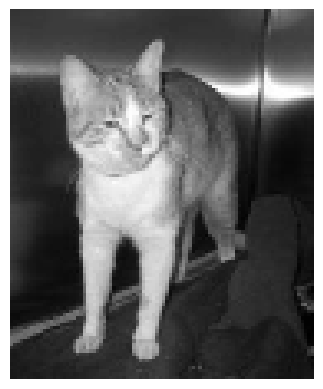

Failure Case
258
Predicted face but actual is non face


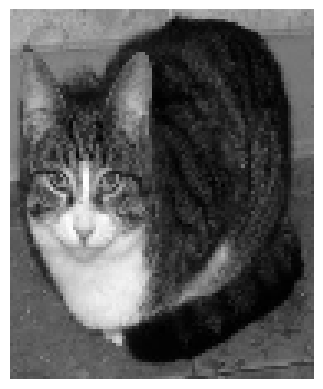

Failure Case
259
Predicted face but actual is non face


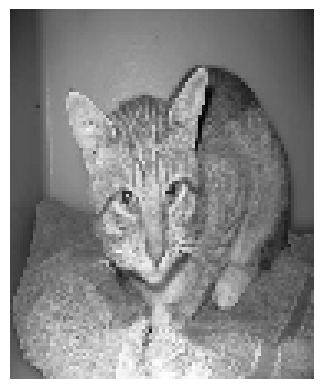

Failure Case
260
Predicted face but actual is non face


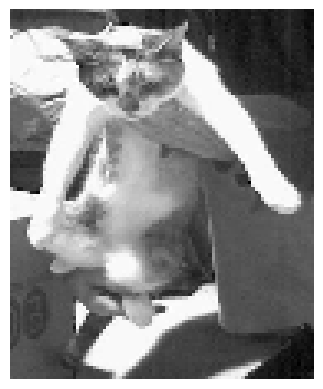

Failure Case
261
Predicted face but actual is non face


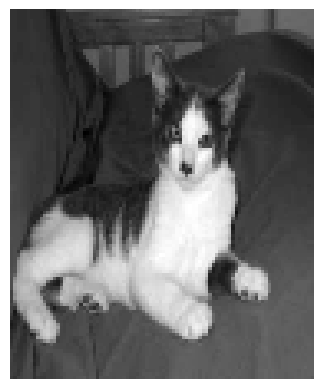

Failure Case
262
Predicted face but actual is non face


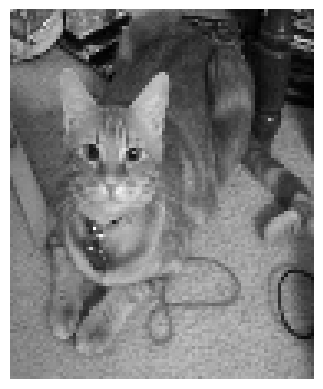

Failure Case
263
Predicted face but actual is non face


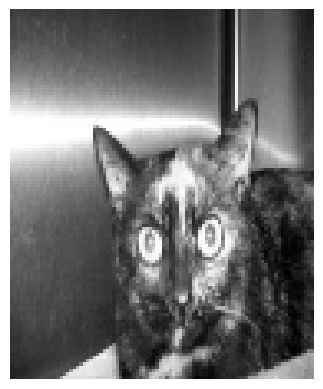

Failure Case
270
Predicted face but actual is non face


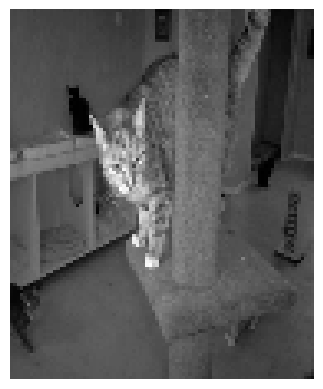

Failure Case
272
Predicted face but actual is non face


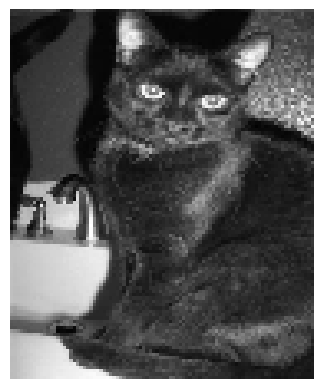

Failure Case
278
Predicted face but actual is non face


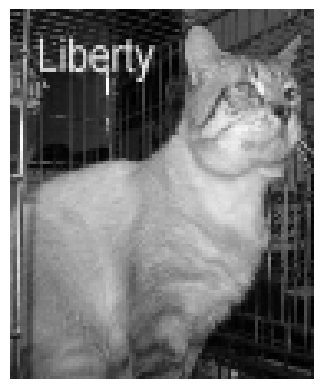

Failure Case
279
Predicted face but actual is non face


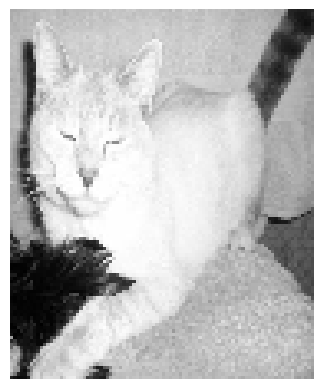

Failure Case
291
Predicted face but actual is non face


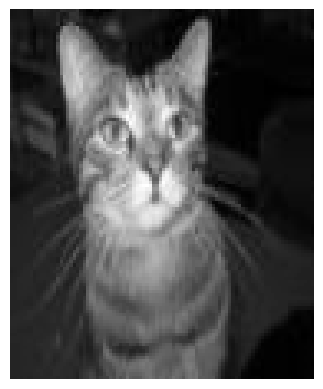

Failure Case
292
Predicted face but actual is non face


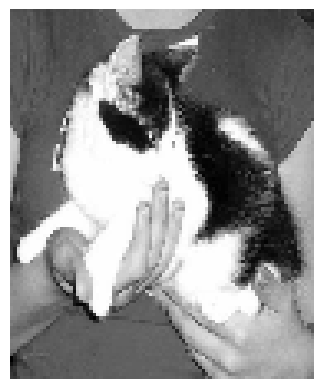

Failure Case
297
Predicted face but actual is non face


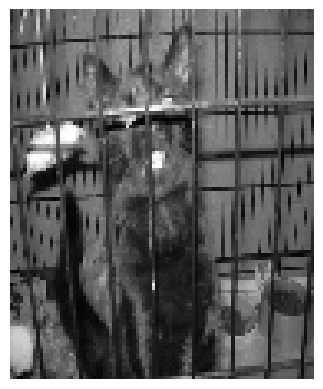

Failure Case
298
Predicted face but actual is non face


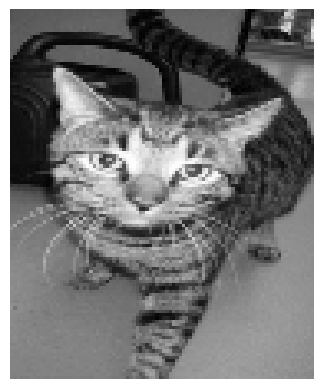

Failure Case
299
Predicted face but actual is non face


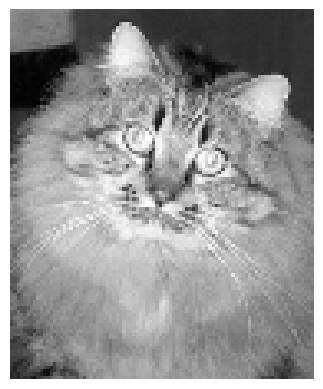

Failure Case
302
Predicted face but actual is non face


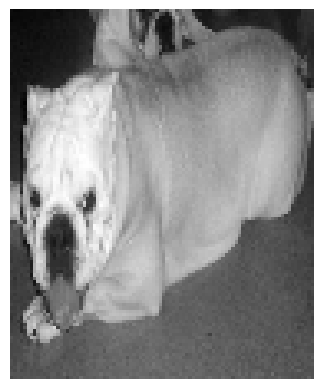

Failure Case
307
Predicted face but actual is non face


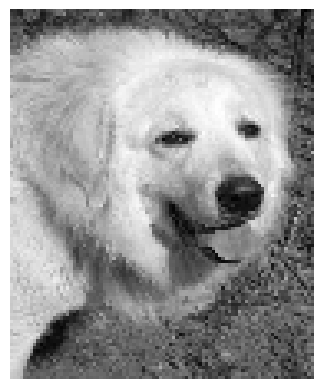

Failure Case
310
Predicted face but actual is non face


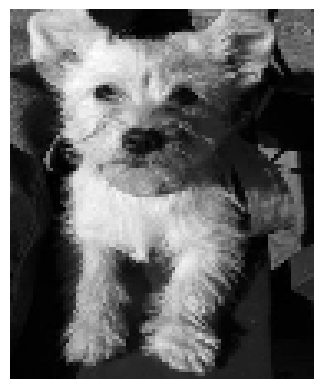

Failure Case
313
Predicted face but actual is non face


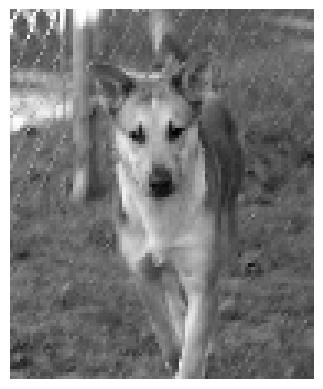

Failure Case
319
Predicted face but actual is non face


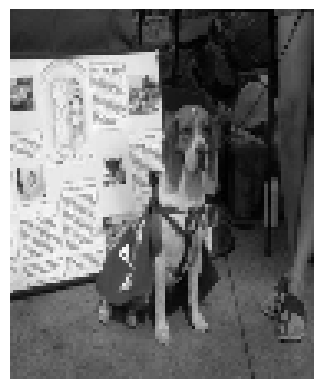

Failure Case
322
Predicted face but actual is non face


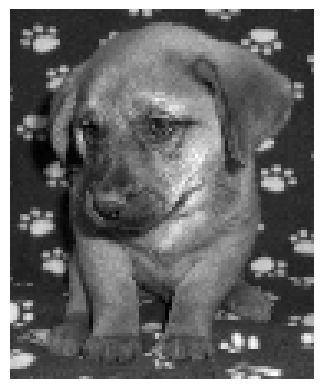

Failure Case
325
Predicted face but actual is non face


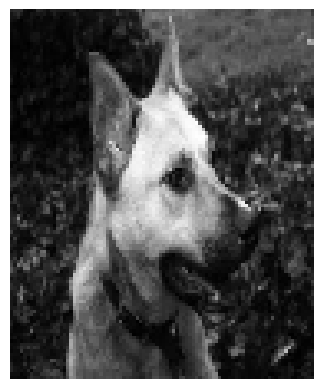

Failure Case
328
Predicted face but actual is non face


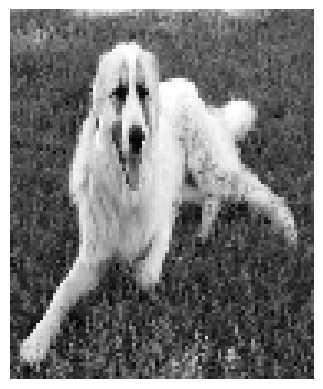

Failure Case
332
Predicted face but actual is non face


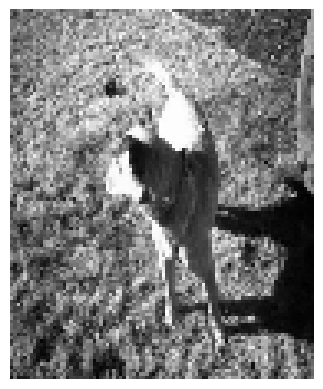

Failure Case
333
Predicted face but actual is non face


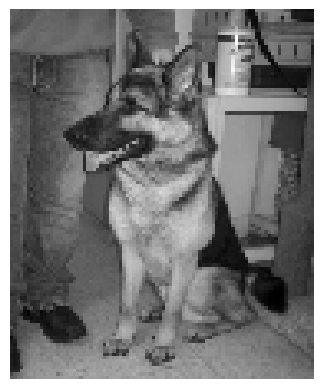

Failure Case
339
Predicted face but actual is non face


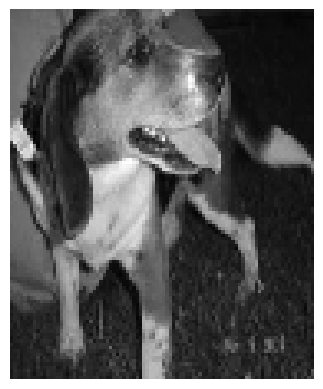

Failure Case
346
Predicted face but actual is non face


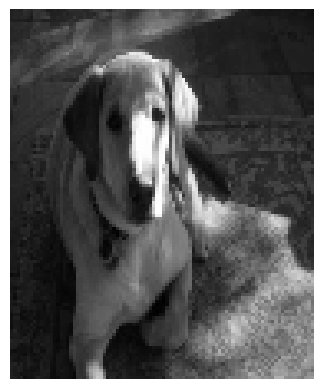

Failure Case
348
Predicted face but actual is non face


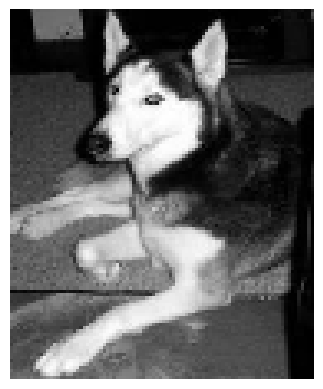

Failure Case
351
Predicted face but actual is non face


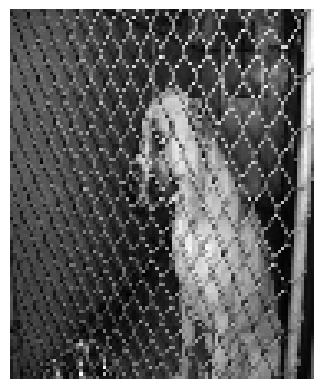

Failure Case
356
Predicted face but actual is non face


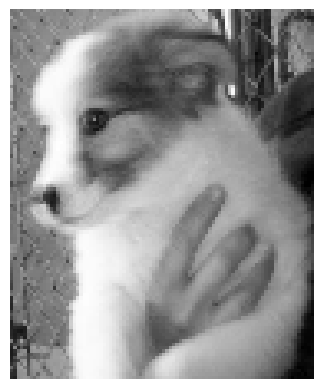

Failure Case
363
Predicted face but actual is non face


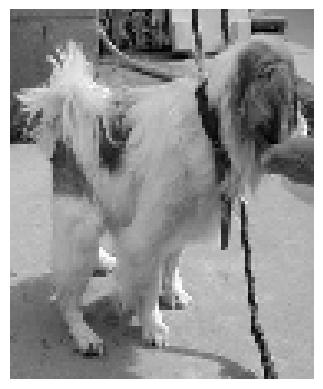

Failure Case
365
Predicted face but actual is non face


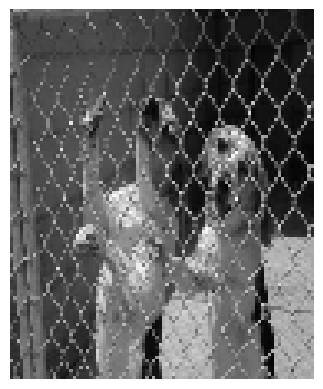

Failure Case
367
Predicted face but actual is non face


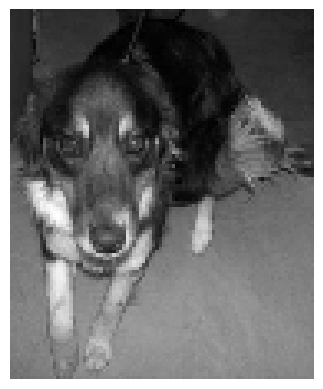

Failure Case
368
Predicted face but actual is non face


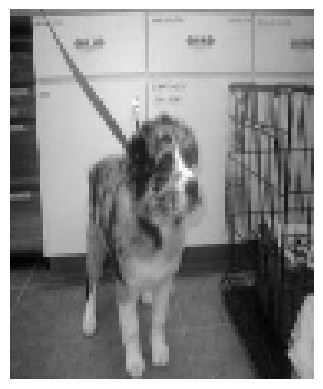

Failure Case
369
Predicted face but actual is non face


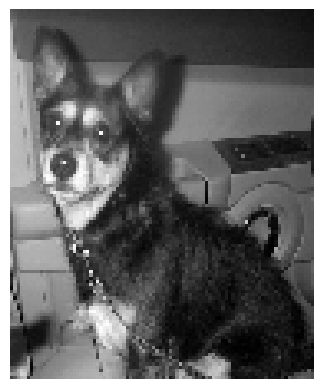

Failure Case
372
Predicted face but actual is non face


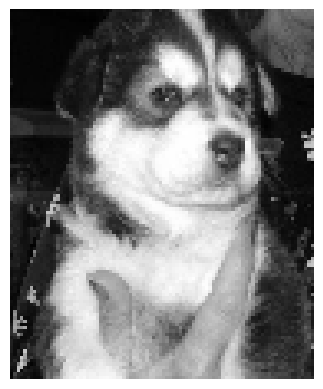

Failure Case
378
Predicted face but actual is non face


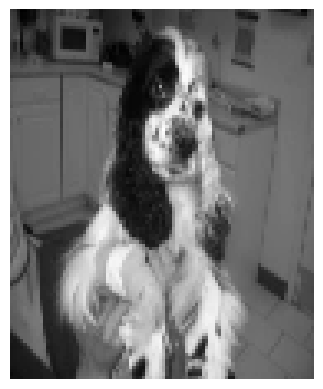

Failure Case
379
Predicted face but actual is non face


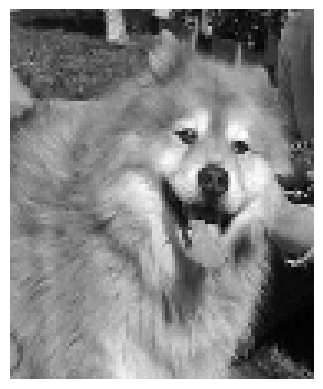

Failure Case
384
Predicted face but actual is non face


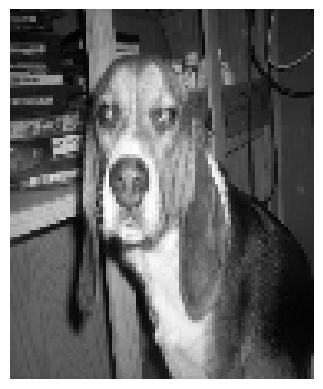

Failure Case
385
Predicted face but actual is non face


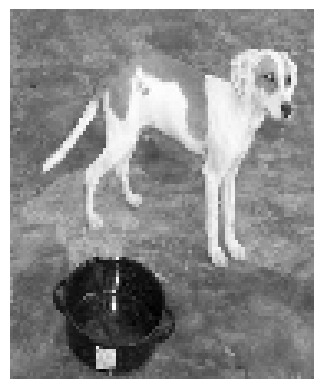

Failure Case
386
Predicted face but actual is non face


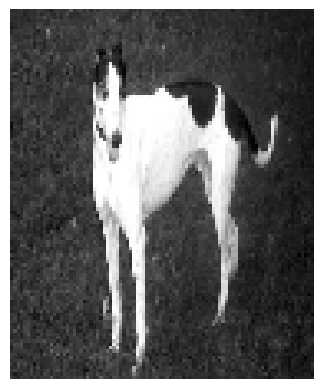

acc = 0.84
ACCURACY FOR ALPHA:0.9 AND K = 5 IS :- 0.8225
CONFUSION MATRIX:
[[200   0]
 [ 71 129]]
Failure Case
200
Predicted face but actual is non face


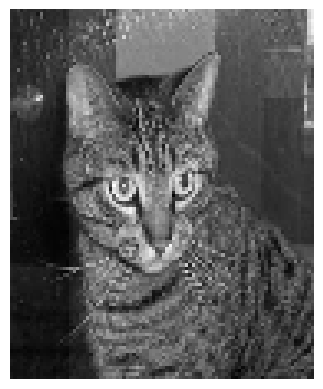

Failure Case
201
Predicted face but actual is non face


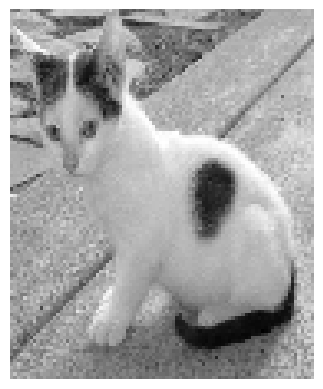

Failure Case
204
Predicted face but actual is non face


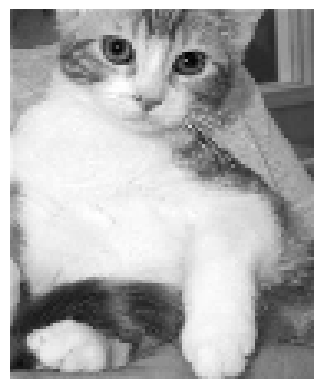

Failure Case
206
Predicted face but actual is non face


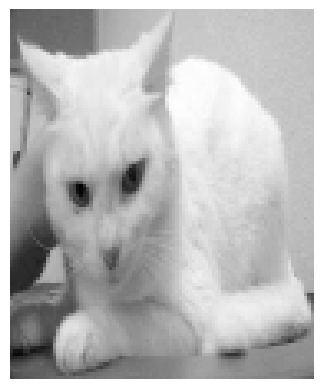

Failure Case
207
Predicted face but actual is non face


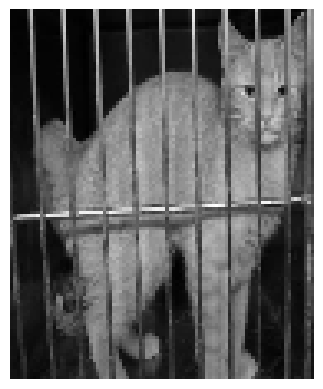

Failure Case
212
Predicted face but actual is non face


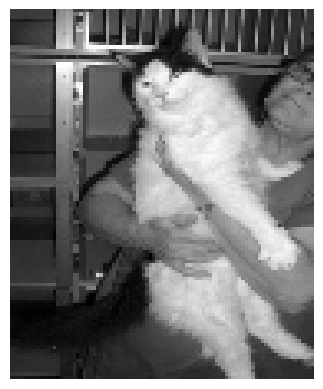

Failure Case
216
Predicted face but actual is non face


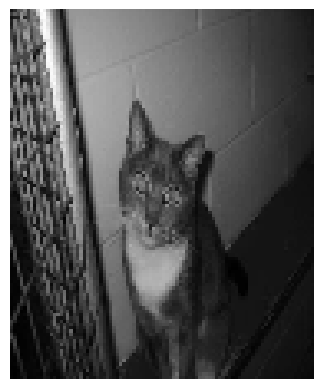

Failure Case
218
Predicted face but actual is non face


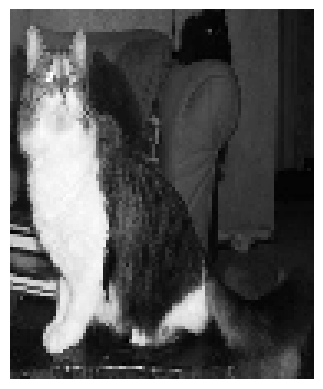

Failure Case
220
Predicted face but actual is non face


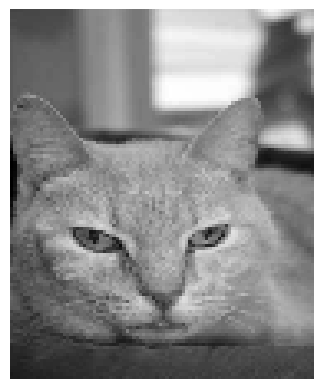

Failure Case
222
Predicted face but actual is non face


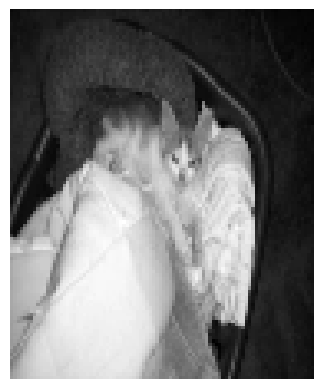

Failure Case
224
Predicted face but actual is non face


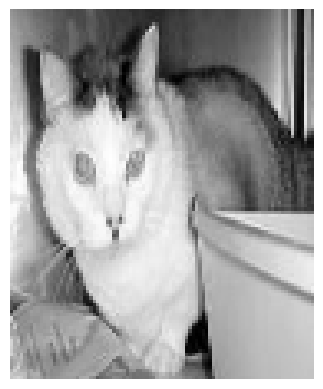

Failure Case
225
Predicted face but actual is non face


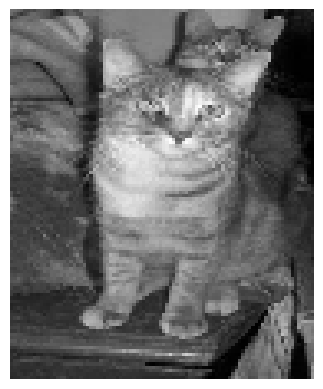

Failure Case
228
Predicted face but actual is non face


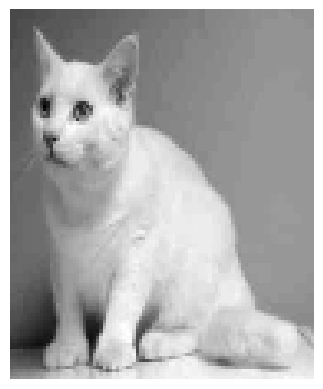

Failure Case
234
Predicted face but actual is non face


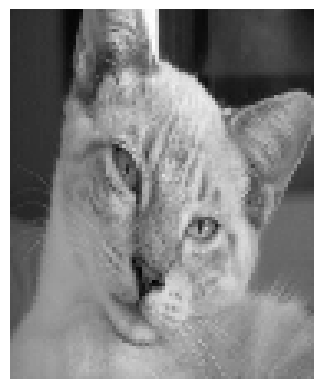

Failure Case
236
Predicted face but actual is non face


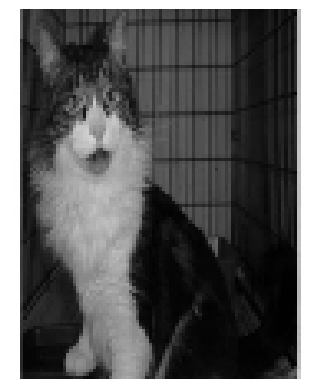

Failure Case
238
Predicted face but actual is non face


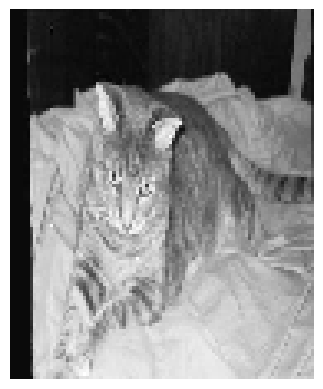

Failure Case
240
Predicted face but actual is non face


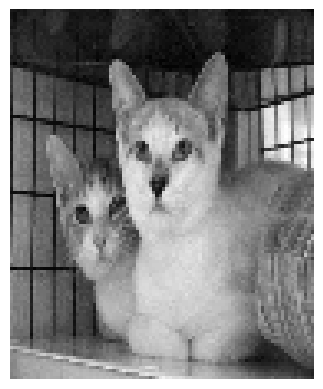

Failure Case
241
Predicted face but actual is non face


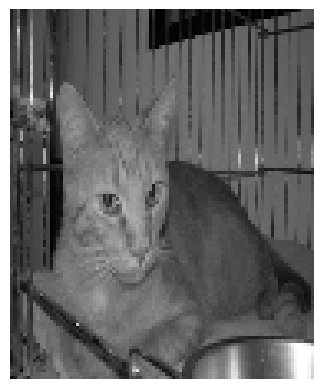

Failure Case
246
Predicted face but actual is non face


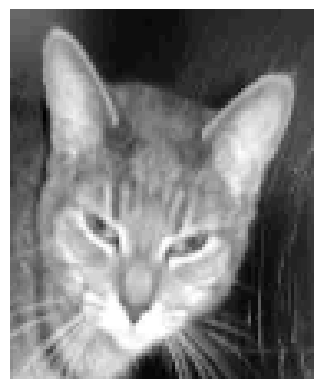

Failure Case
247
Predicted face but actual is non face


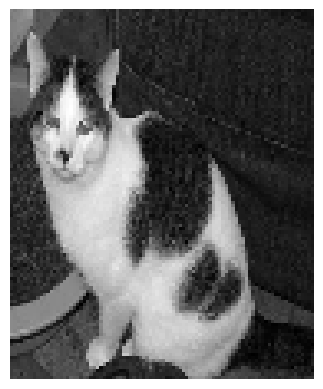

Failure Case
248
Predicted face but actual is non face


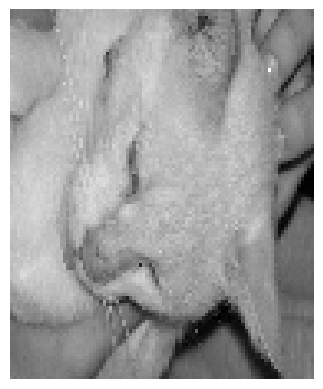

Failure Case
253
Predicted face but actual is non face


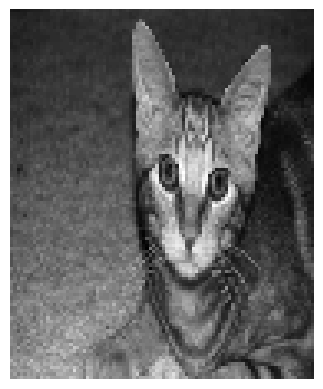

Failure Case
255
Predicted face but actual is non face


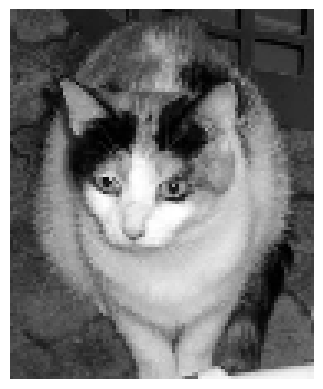

Failure Case
257
Predicted face but actual is non face


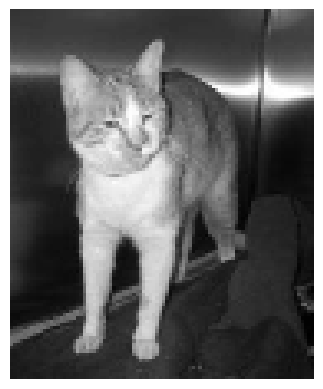

Failure Case
258
Predicted face but actual is non face


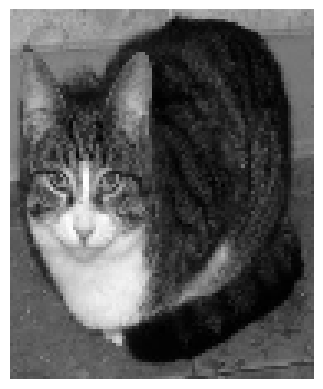

Failure Case
259
Predicted face but actual is non face


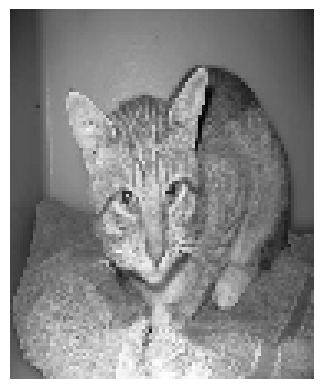

Failure Case
260
Predicted face but actual is non face


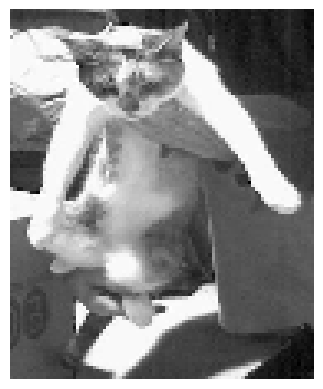

Failure Case
261
Predicted face but actual is non face


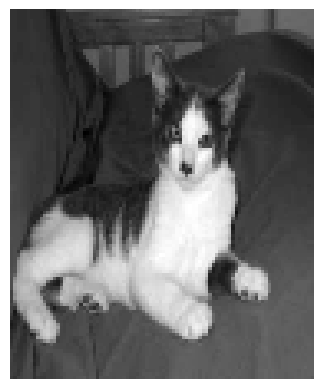

Failure Case
262
Predicted face but actual is non face


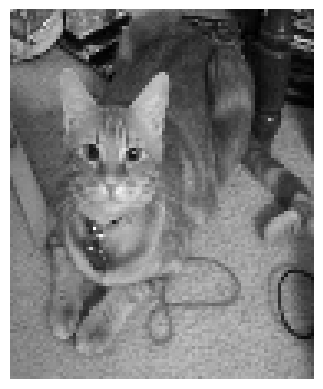

Failure Case
263
Predicted face but actual is non face


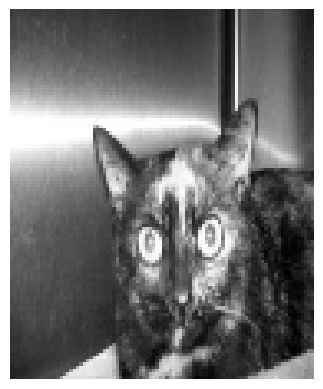

Failure Case
267
Predicted face but actual is non face


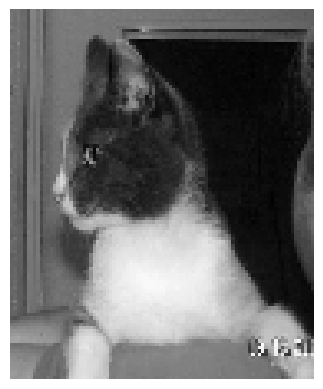

Failure Case
268
Predicted face but actual is non face


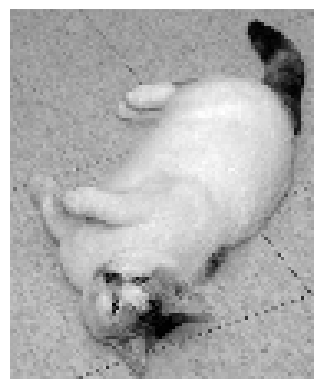

Failure Case
270
Predicted face but actual is non face


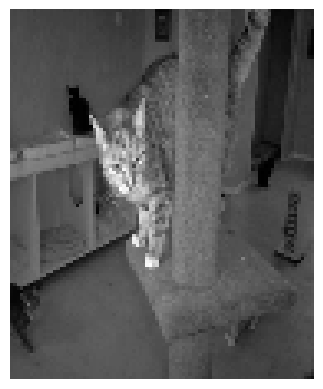

Failure Case
272
Predicted face but actual is non face


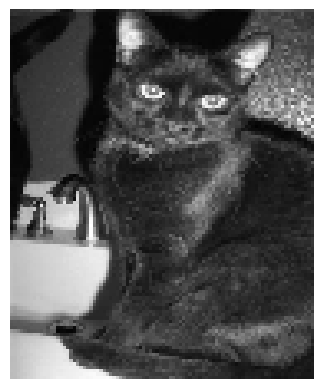

Failure Case
278
Predicted face but actual is non face


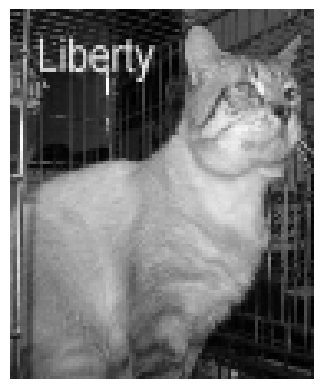

Failure Case
279
Predicted face but actual is non face


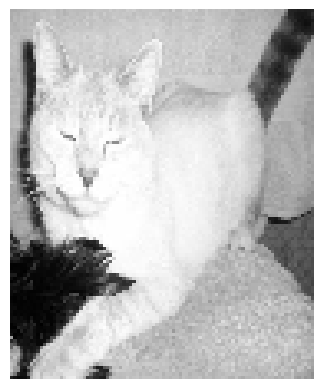

Failure Case
283
Predicted face but actual is non face


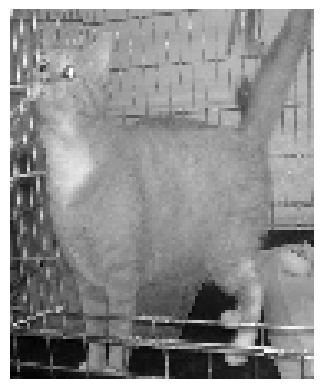

Failure Case
291
Predicted face but actual is non face


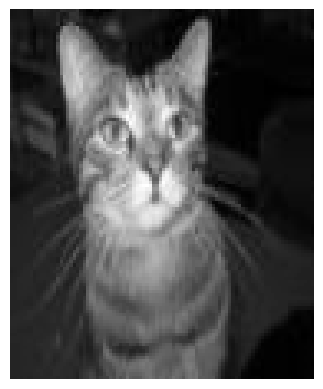

Failure Case
292
Predicted face but actual is non face


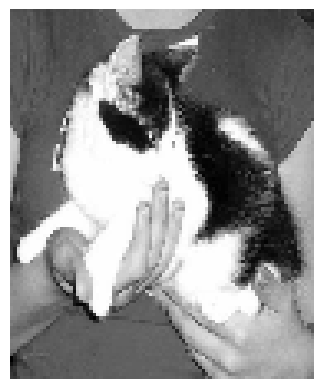

Failure Case
297
Predicted face but actual is non face


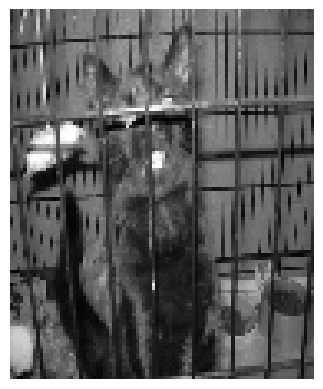

Failure Case
298
Predicted face but actual is non face


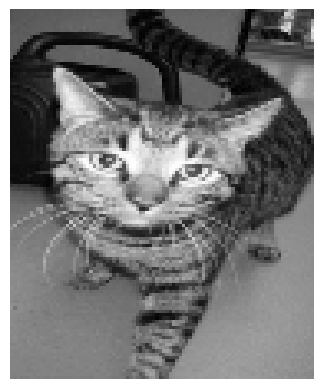

Failure Case
299
Predicted face but actual is non face


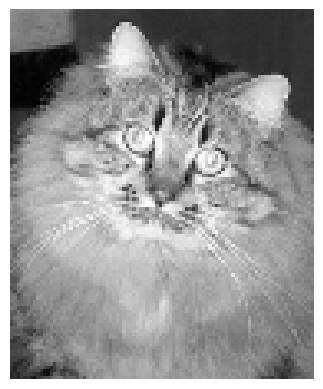

Failure Case
302
Predicted face but actual is non face


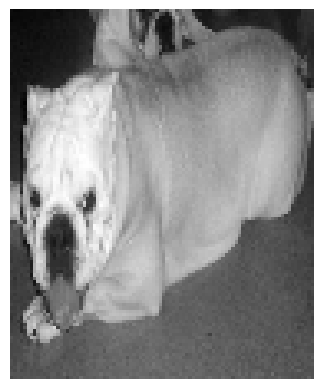

Failure Case
304
Predicted face but actual is non face


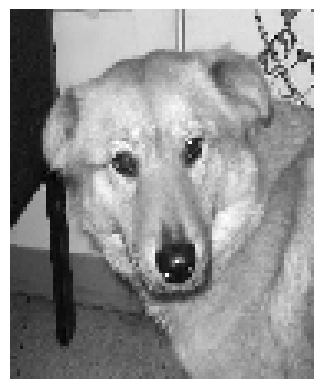

Failure Case
307
Predicted face but actual is non face


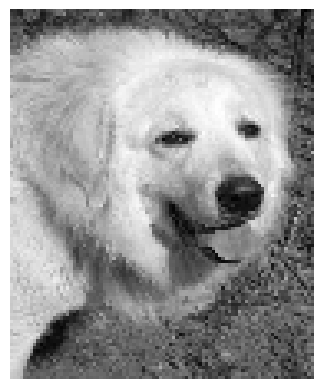

Failure Case
310
Predicted face but actual is non face


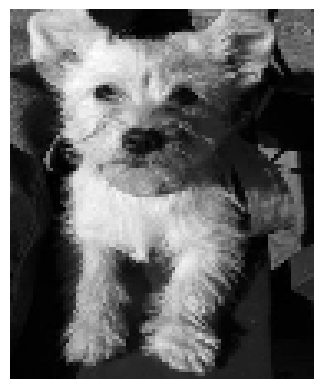

Failure Case
313
Predicted face but actual is non face


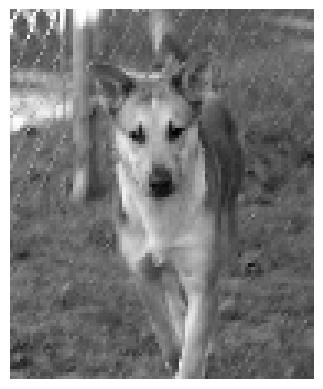

Failure Case
319
Predicted face but actual is non face


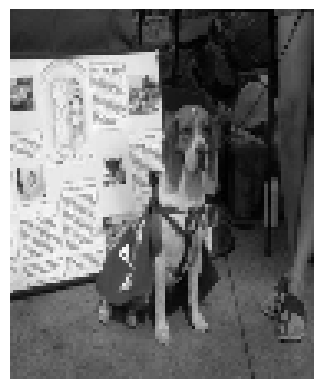

Failure Case
322
Predicted face but actual is non face


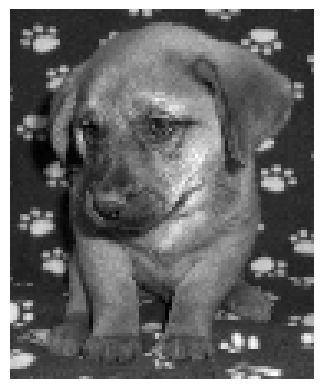

Failure Case
325
Predicted face but actual is non face


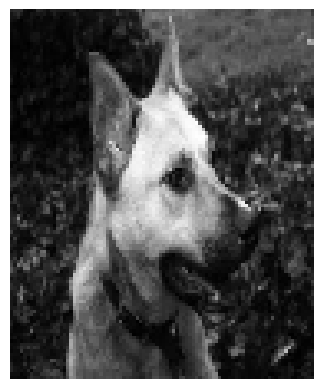

Failure Case
328
Predicted face but actual is non face


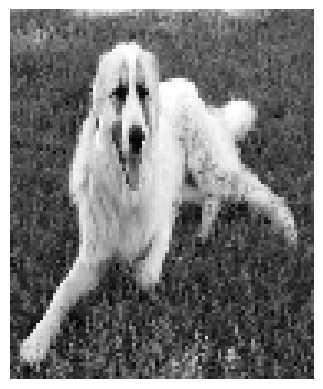

Failure Case
332
Predicted face but actual is non face


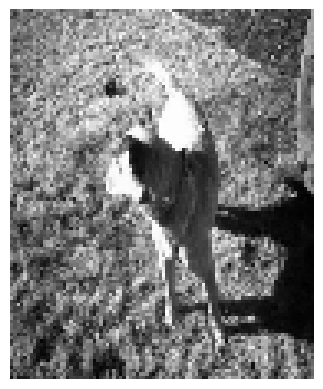

Failure Case
333
Predicted face but actual is non face


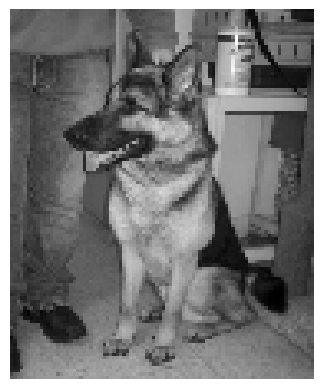

Failure Case
335
Predicted face but actual is non face


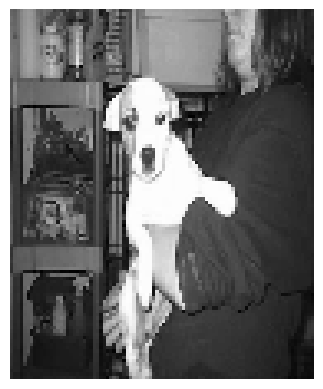

Failure Case
339
Predicted face but actual is non face


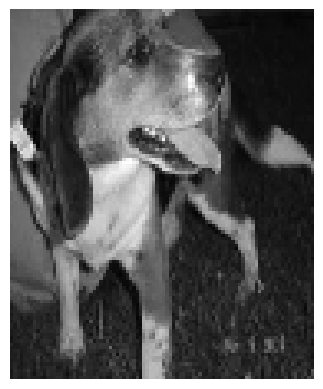

Failure Case
346
Predicted face but actual is non face


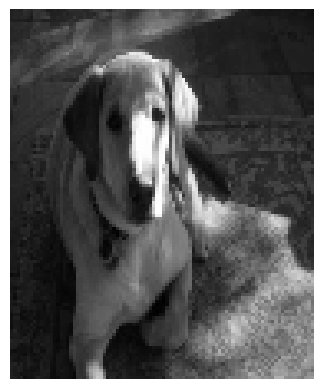

Failure Case
348
Predicted face but actual is non face


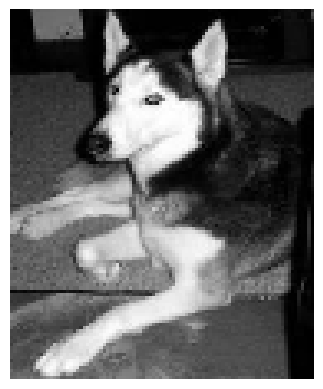

Failure Case
351
Predicted face but actual is non face


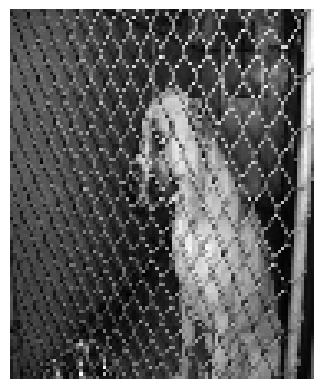

Failure Case
356
Predicted face but actual is non face


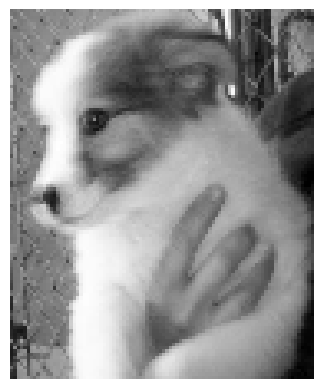

Failure Case
363
Predicted face but actual is non face


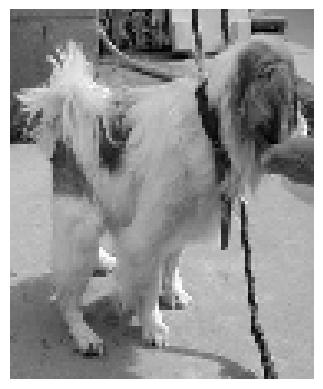

Failure Case
365
Predicted face but actual is non face


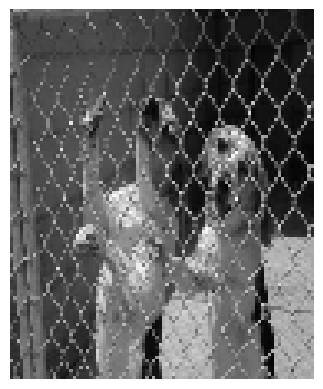

Failure Case
367
Predicted face but actual is non face


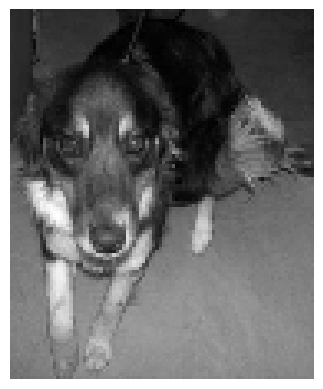

Failure Case
368
Predicted face but actual is non face


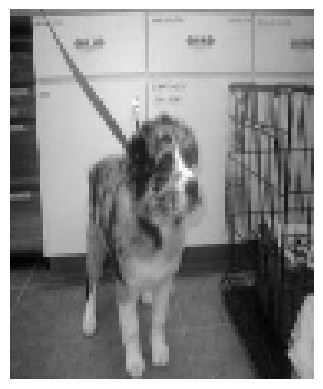

Failure Case
369
Predicted face but actual is non face


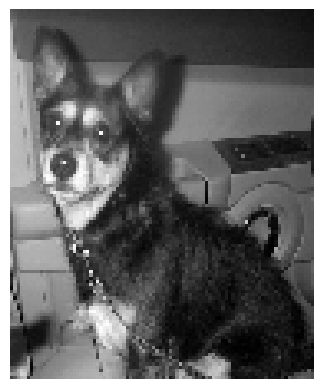

Failure Case
372
Predicted face but actual is non face


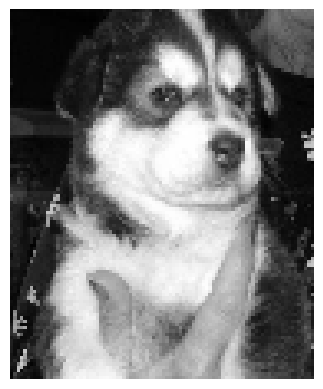

Failure Case
376
Predicted face but actual is non face


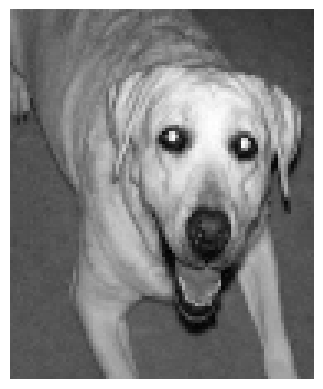

Failure Case
378
Predicted face but actual is non face


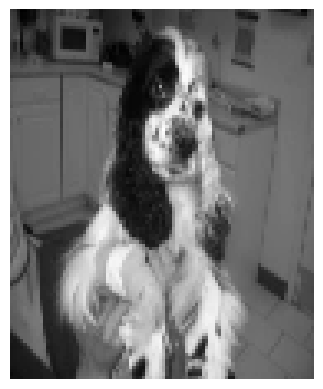

Failure Case
379
Predicted face but actual is non face


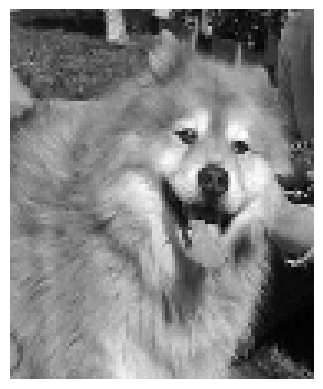

Failure Case
384
Predicted face but actual is non face


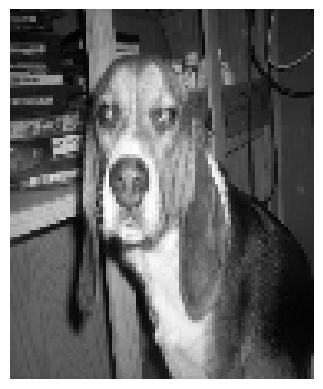

Failure Case
385
Predicted face but actual is non face


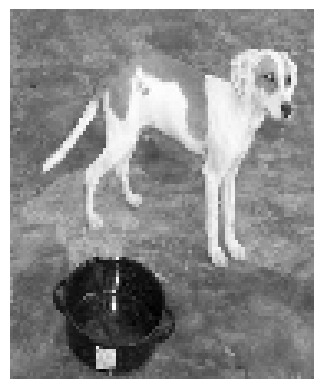

Failure Case
386
Predicted face but actual is non face


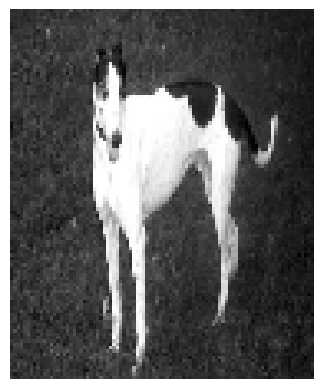

acc = 0.8225
ACCURACY FOR ALPHA:0.95 AND K = 5 IS :- 0.8075
CONFUSION MATRIX:
[[200   0]
 [ 77 123]]
Failure Case
200
Predicted face but actual is non face


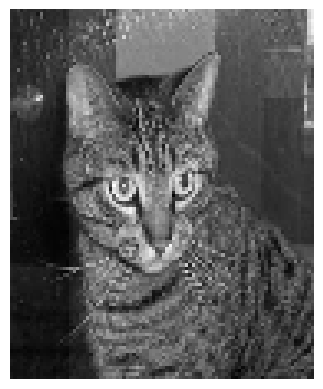

Failure Case
201
Predicted face but actual is non face


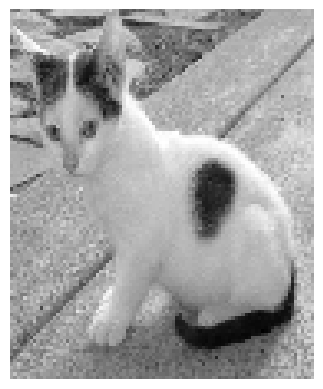

Failure Case
204
Predicted face but actual is non face


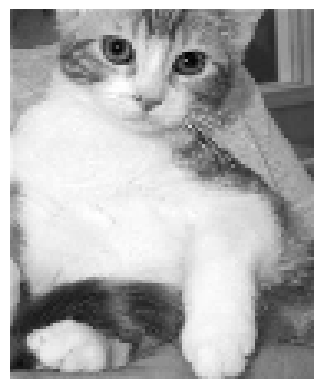

Failure Case
206
Predicted face but actual is non face


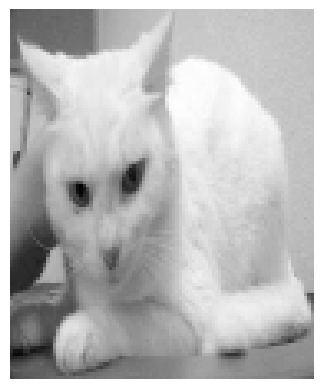

Failure Case
207
Predicted face but actual is non face


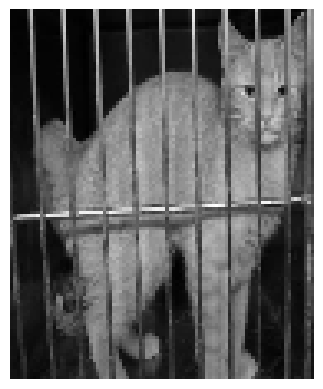

Failure Case
212
Predicted face but actual is non face


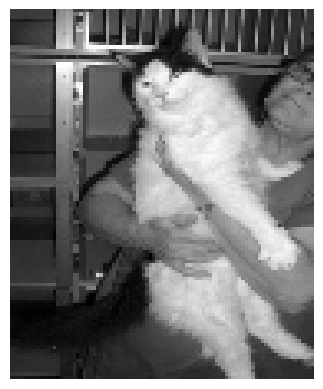

Failure Case
216
Predicted face but actual is non face


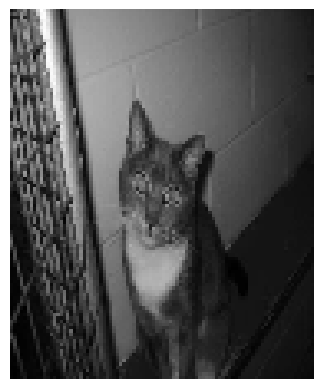

Failure Case
217
Predicted face but actual is non face


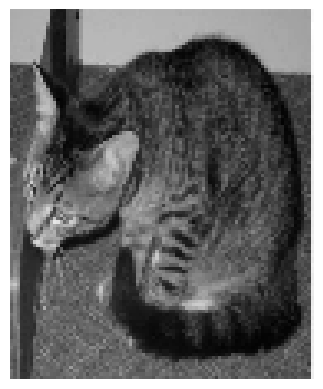

Failure Case
218
Predicted face but actual is non face


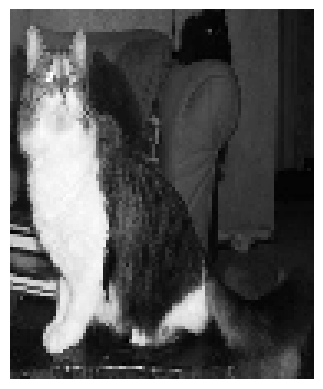

Failure Case
220
Predicted face but actual is non face


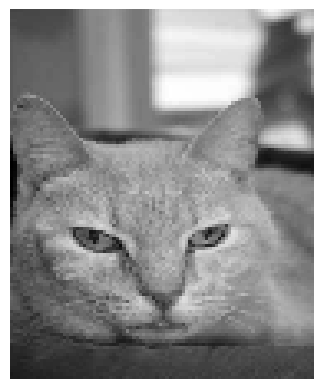

Failure Case
222
Predicted face but actual is non face


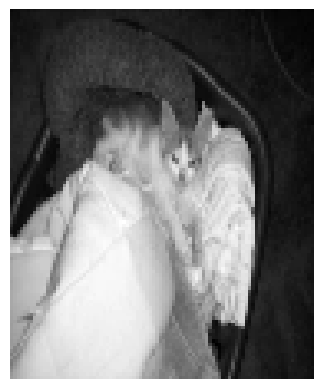

Failure Case
224
Predicted face but actual is non face


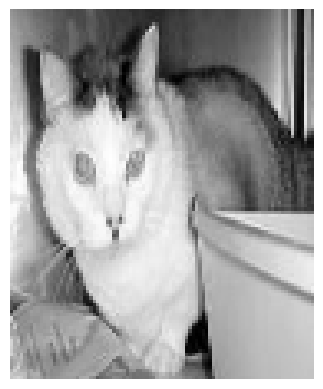

Failure Case
225
Predicted face but actual is non face


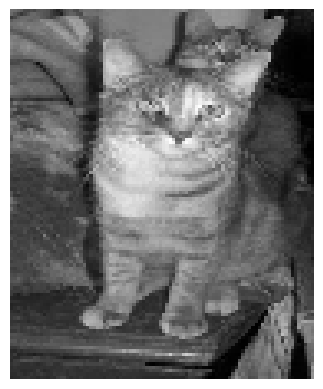

Failure Case
228
Predicted face but actual is non face


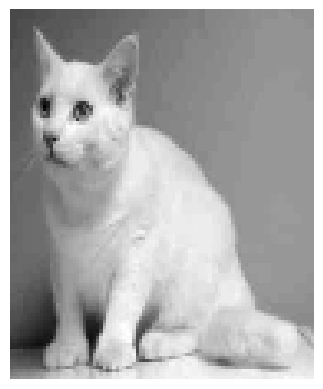

Failure Case
234
Predicted face but actual is non face


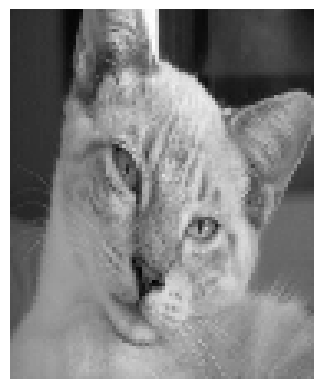

Failure Case
236
Predicted face but actual is non face


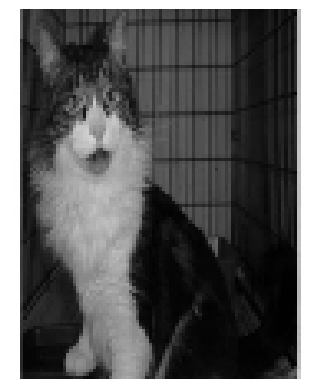

Failure Case
238
Predicted face but actual is non face


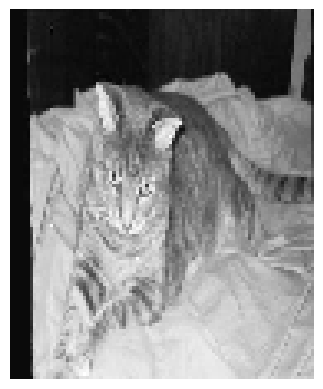

Failure Case
240
Predicted face but actual is non face


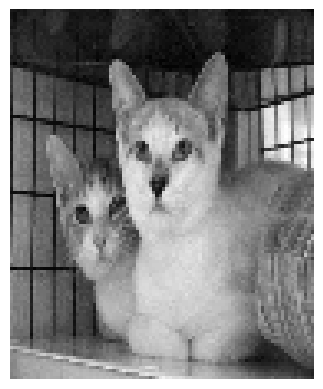

Failure Case
241
Predicted face but actual is non face


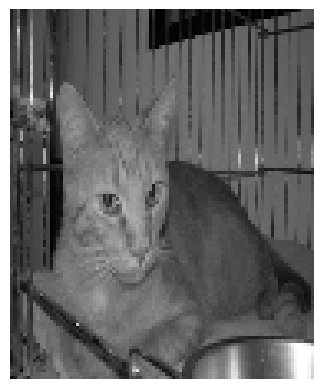

Failure Case
246
Predicted face but actual is non face


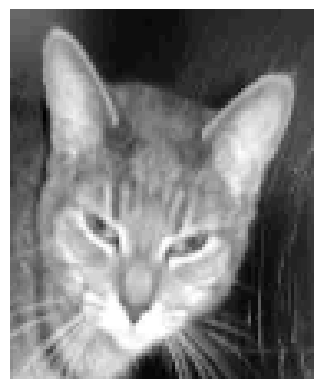

Failure Case
247
Predicted face but actual is non face


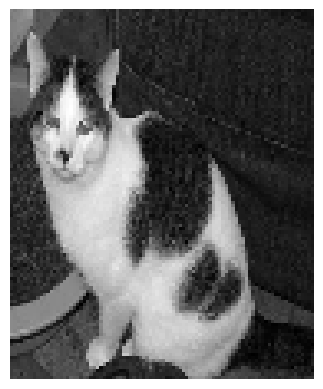

Failure Case
248
Predicted face but actual is non face


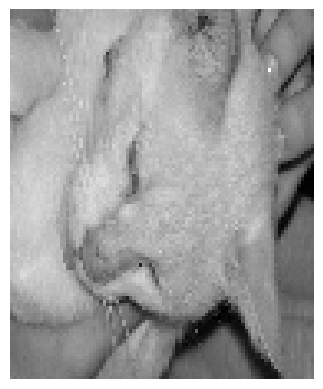

Failure Case
253
Predicted face but actual is non face


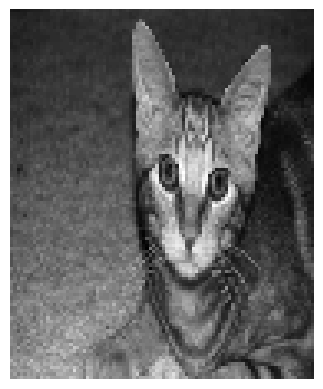

Failure Case
255
Predicted face but actual is non face


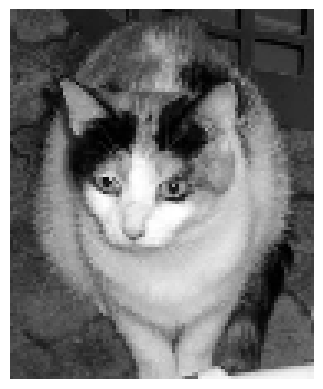

Failure Case
257
Predicted face but actual is non face


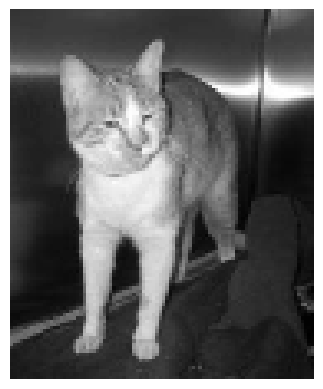

Failure Case
258
Predicted face but actual is non face


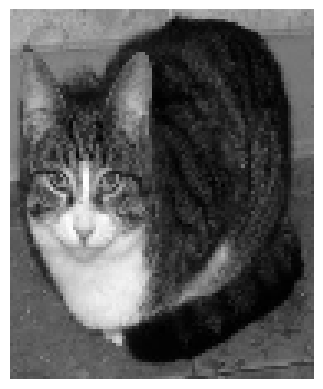

Failure Case
259
Predicted face but actual is non face


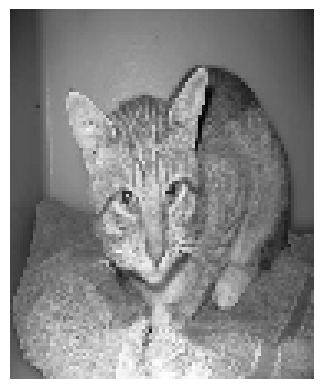

Failure Case
260
Predicted face but actual is non face


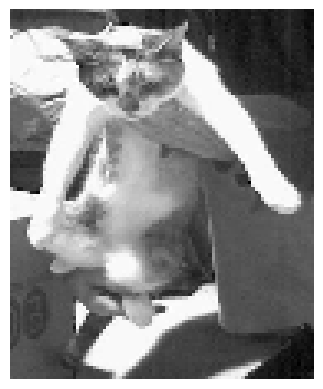

Failure Case
261
Predicted face but actual is non face


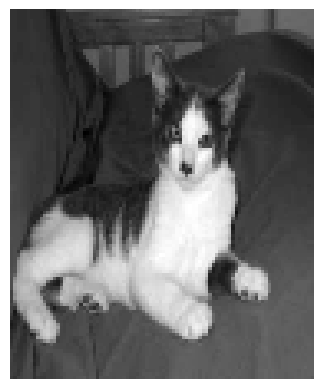

Failure Case
262
Predicted face but actual is non face


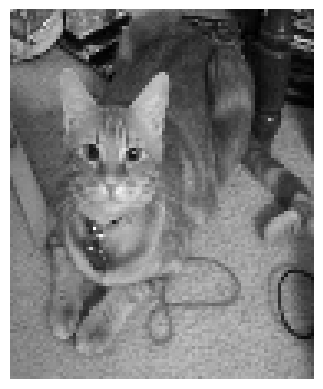

Failure Case
263
Predicted face but actual is non face


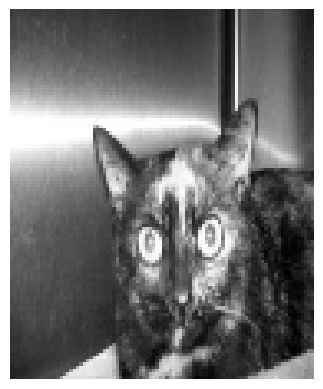

Failure Case
267
Predicted face but actual is non face


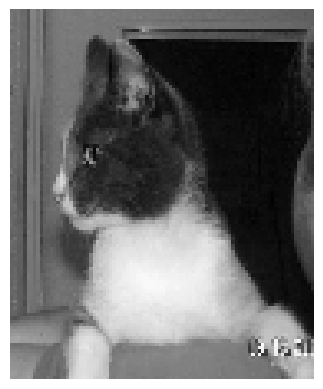

Failure Case
268
Predicted face but actual is non face


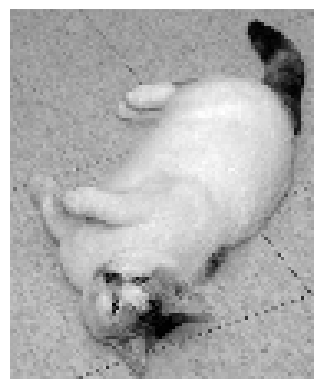

Failure Case
270
Predicted face but actual is non face


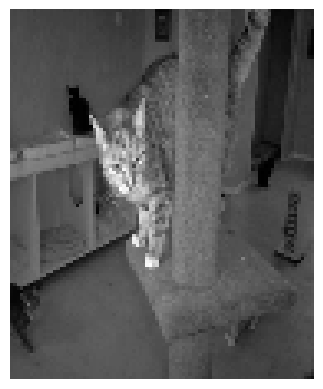

Failure Case
272
Predicted face but actual is non face


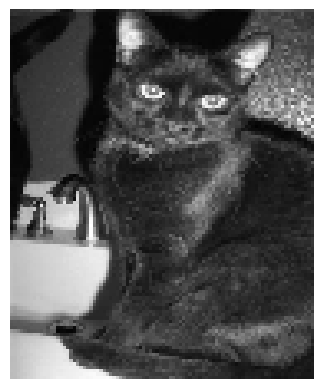

Failure Case
275
Predicted face but actual is non face


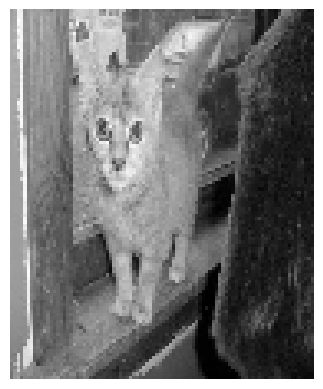

Failure Case
278
Predicted face but actual is non face


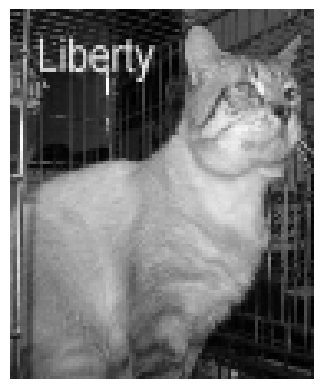

Failure Case
279
Predicted face but actual is non face


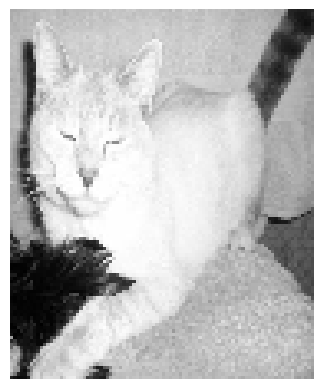

Failure Case
282
Predicted face but actual is non face


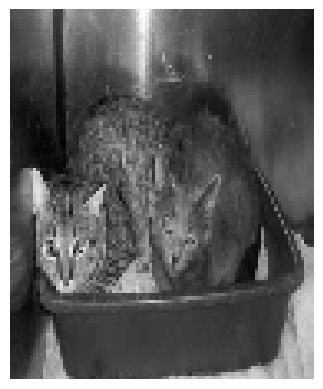

Failure Case
283
Predicted face but actual is non face


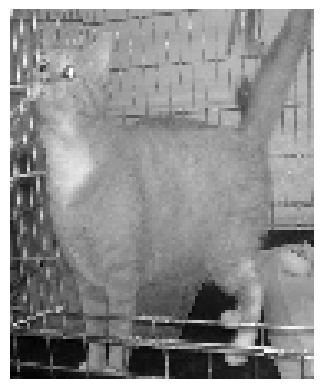

Failure Case
291
Predicted face but actual is non face


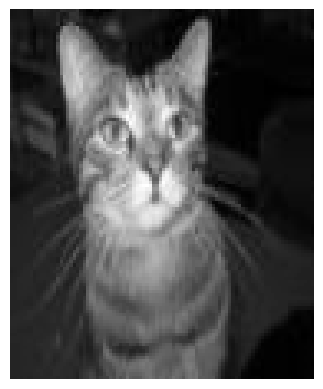

Failure Case
292
Predicted face but actual is non face


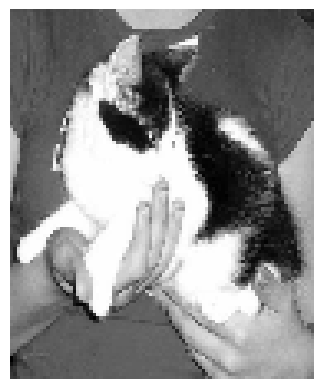

Failure Case
297
Predicted face but actual is non face


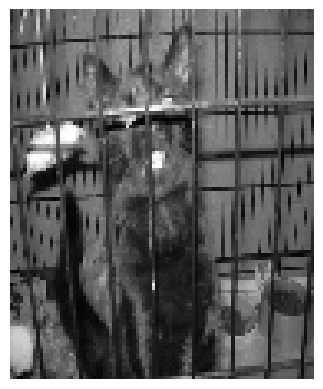

Failure Case
298
Predicted face but actual is non face


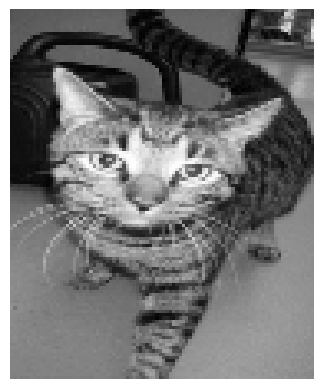

Failure Case
299
Predicted face but actual is non face


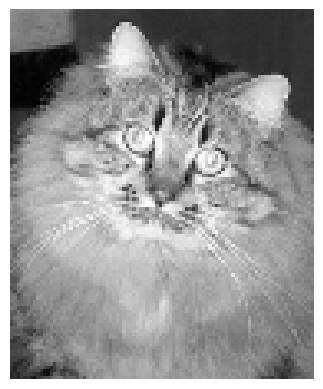

Failure Case
301
Predicted face but actual is non face


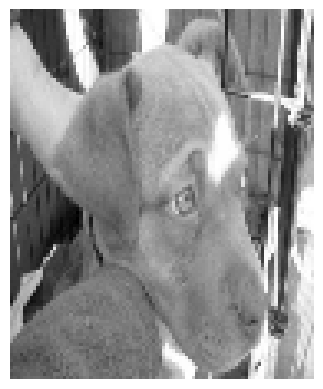

Failure Case
302
Predicted face but actual is non face


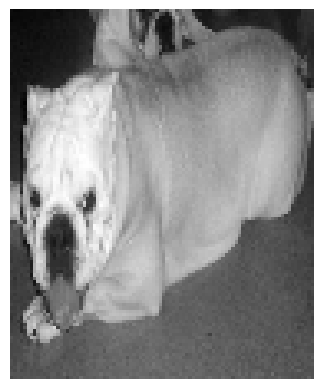

Failure Case
304
Predicted face but actual is non face


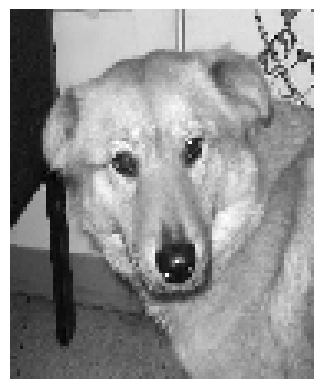

Failure Case
307
Predicted face but actual is non face


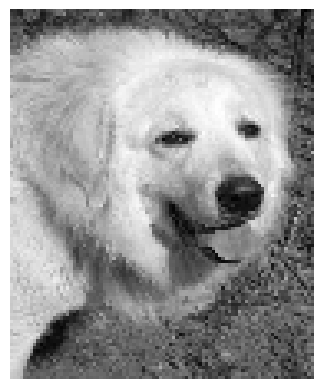

Failure Case
310
Predicted face but actual is non face


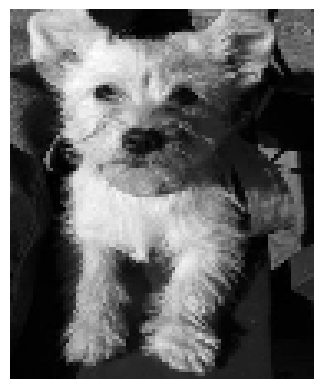

Failure Case
313
Predicted face but actual is non face


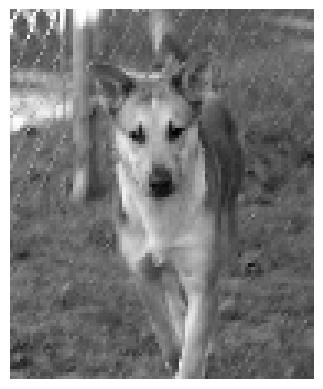

Failure Case
319
Predicted face but actual is non face


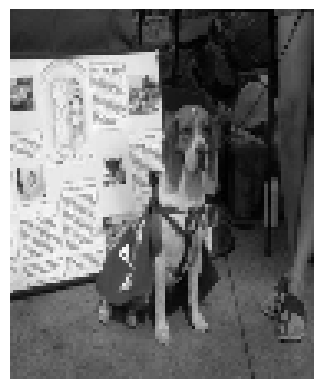

Failure Case
322
Predicted face but actual is non face


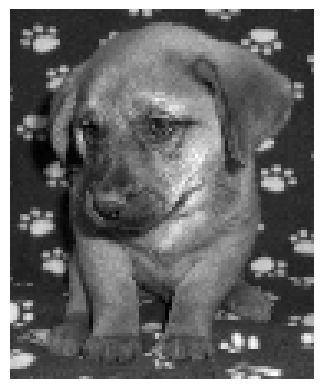

Failure Case
325
Predicted face but actual is non face


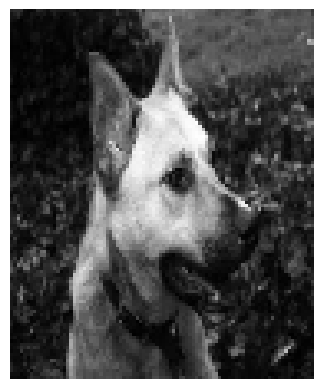

Failure Case
328
Predicted face but actual is non face


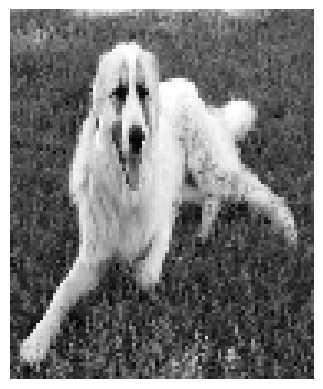

Failure Case
329
Predicted face but actual is non face


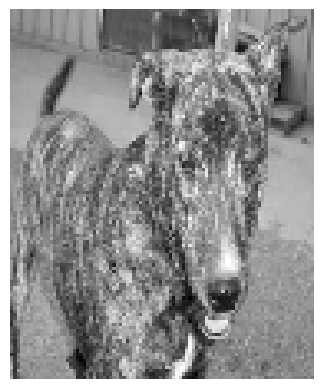

Failure Case
332
Predicted face but actual is non face


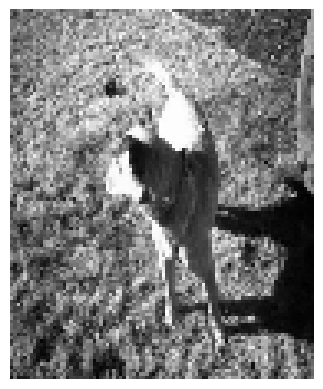

Failure Case
333
Predicted face but actual is non face


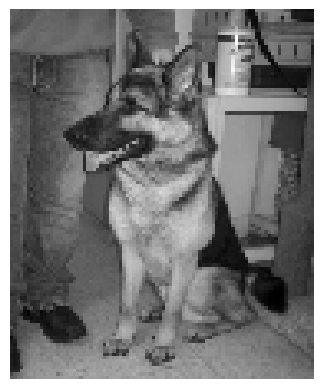

Failure Case
335
Predicted face but actual is non face


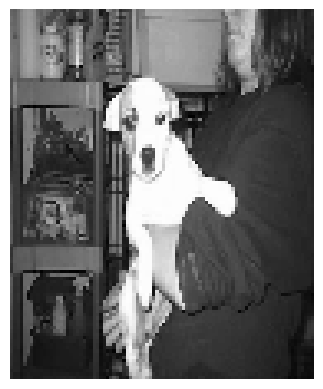

Failure Case
339
Predicted face but actual is non face


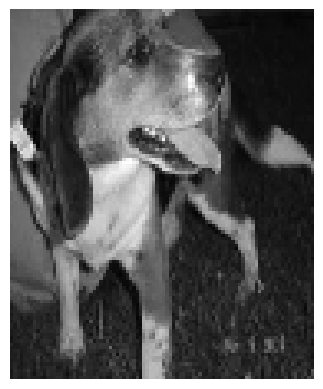

Failure Case
346
Predicted face but actual is non face


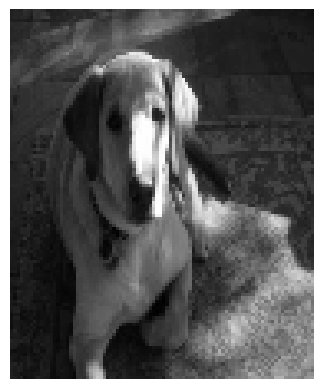

Failure Case
348
Predicted face but actual is non face


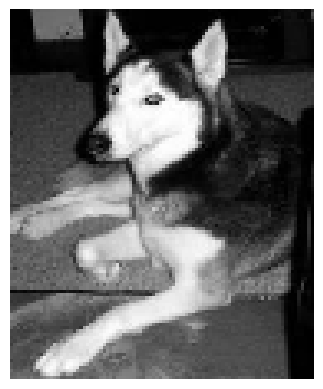

Failure Case
351
Predicted face but actual is non face


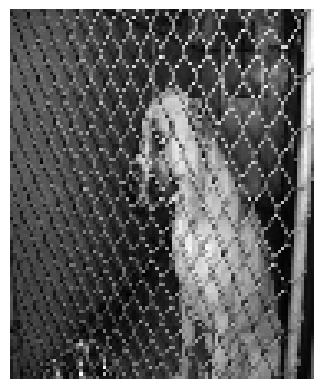

Failure Case
356
Predicted face but actual is non face


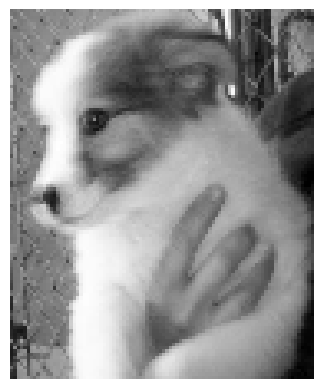

Failure Case
362
Predicted face but actual is non face


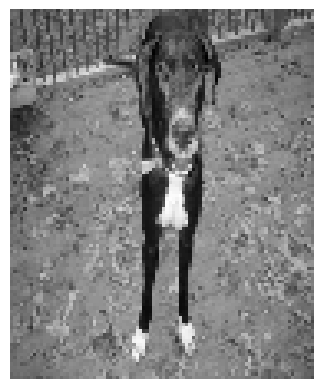

Failure Case
363
Predicted face but actual is non face


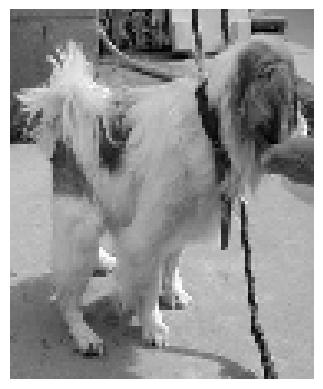

Failure Case
365
Predicted face but actual is non face


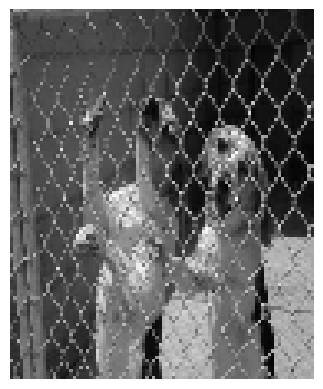

Failure Case
367
Predicted face but actual is non face


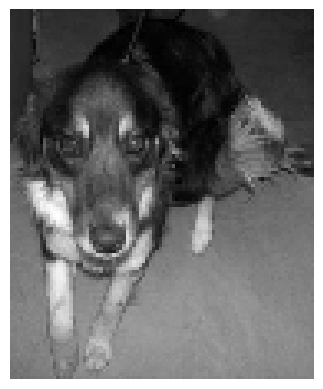

Failure Case
368
Predicted face but actual is non face


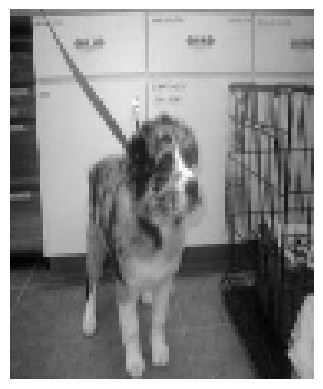

Failure Case
369
Predicted face but actual is non face


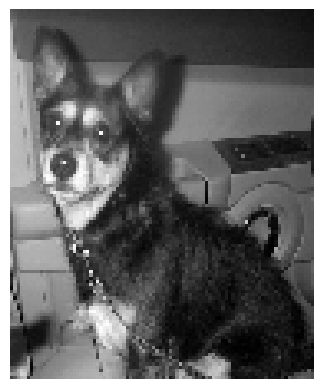

Failure Case
372
Predicted face but actual is non face


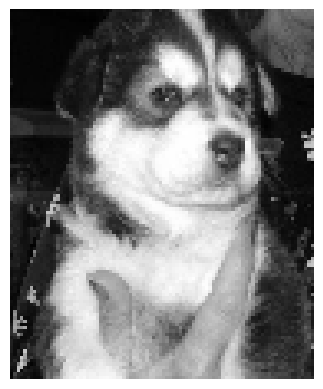

Failure Case
376
Predicted face but actual is non face


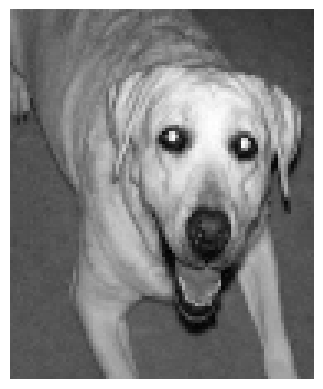

Failure Case
378
Predicted face but actual is non face


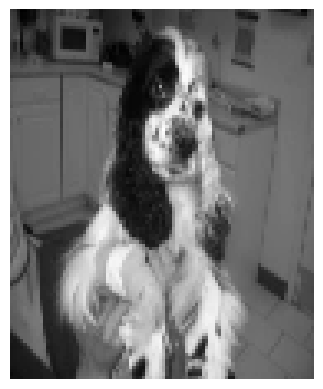

Failure Case
379
Predicted face but actual is non face


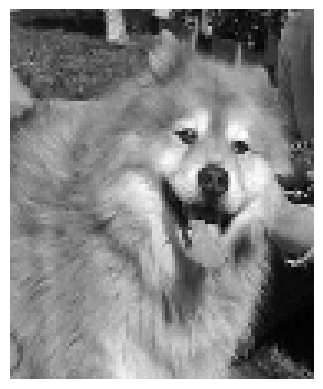

Failure Case
384
Predicted face but actual is non face


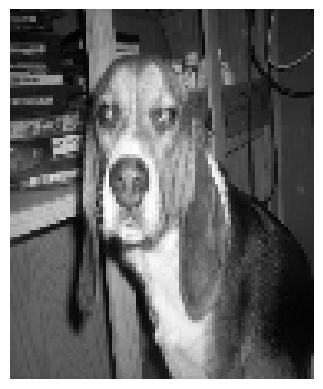

Failure Case
385
Predicted face but actual is non face


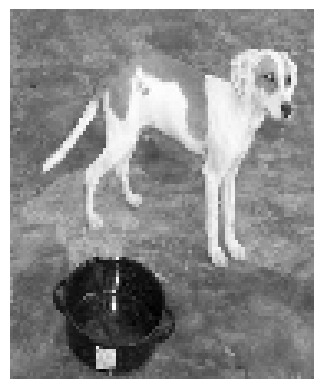

Failure Case
386
Predicted face but actual is non face


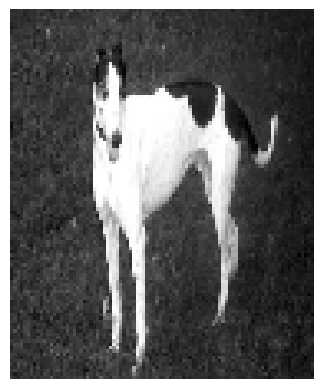

acc = 0.8075
Done for k = 5



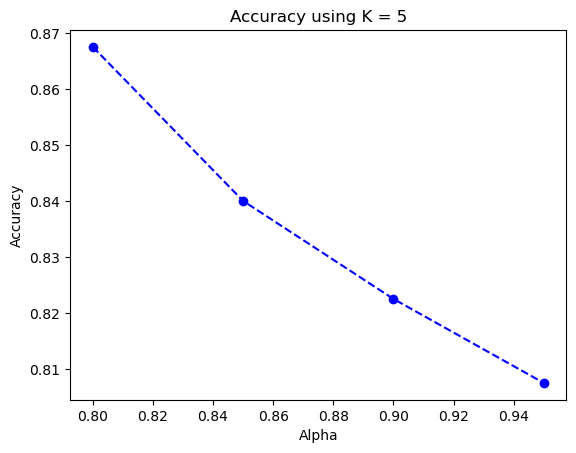

ACCURACY FOR ALPHA:0.8 AND K = 7 IS :- 0.85
CONFUSION MATRIX:
[[200   0]
 [ 60 140]]
Failure Case
200
Predicted face but actual is non face


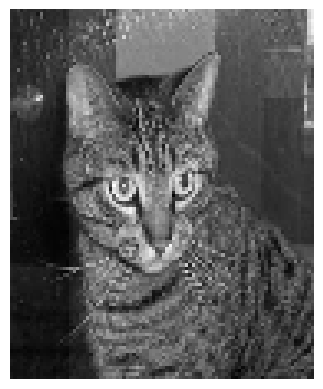

Failure Case
204
Predicted face but actual is non face


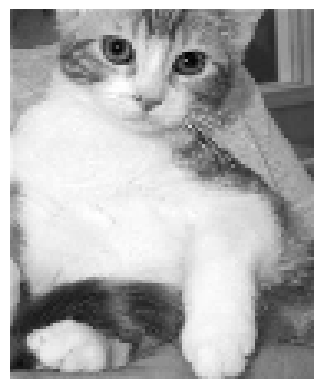

Failure Case
206
Predicted face but actual is non face


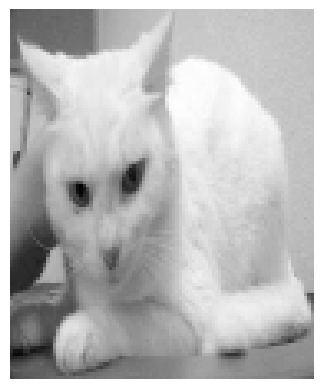

Failure Case
207
Predicted face but actual is non face


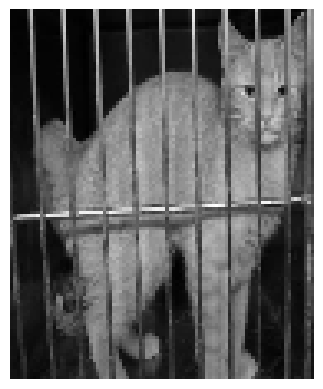

Failure Case
212
Predicted face but actual is non face


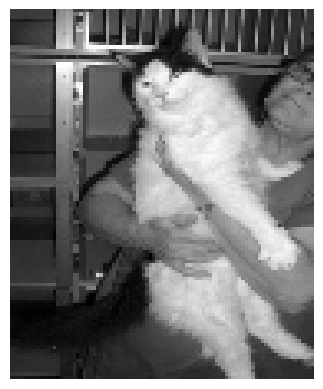

Failure Case
216
Predicted face but actual is non face


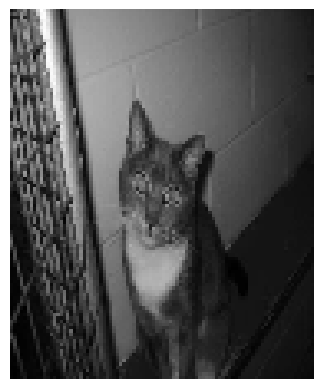

Failure Case
218
Predicted face but actual is non face


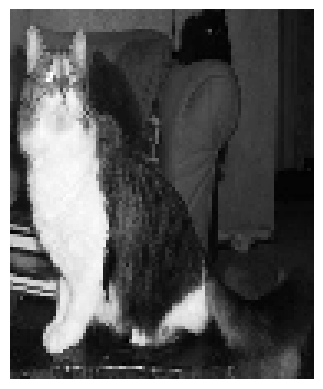

Failure Case
220
Predicted face but actual is non face


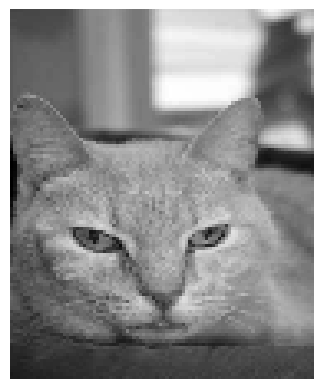

Failure Case
222
Predicted face but actual is non face


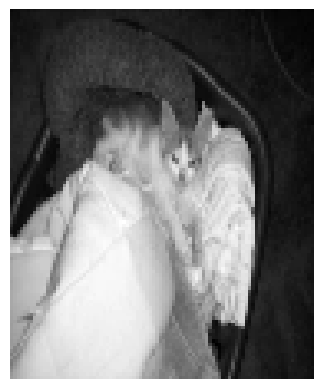

Failure Case
224
Predicted face but actual is non face


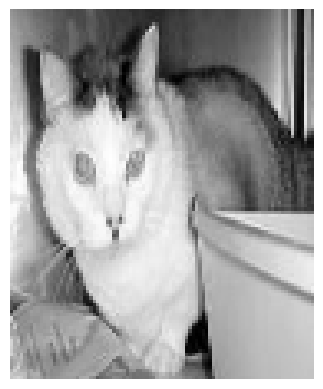

Failure Case
225
Predicted face but actual is non face


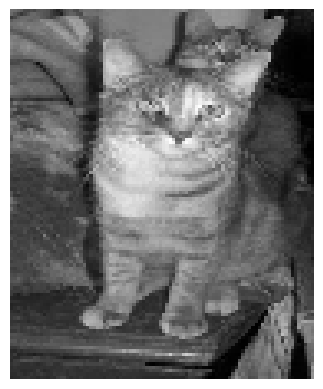

Failure Case
228
Predicted face but actual is non face


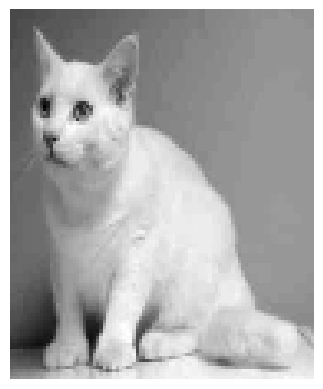

Failure Case
234
Predicted face but actual is non face


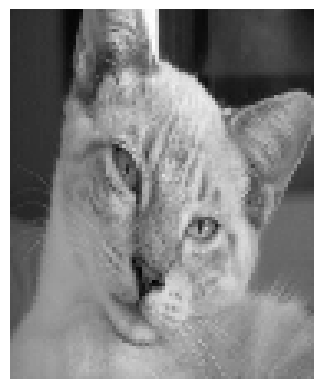

Failure Case
240
Predicted face but actual is non face


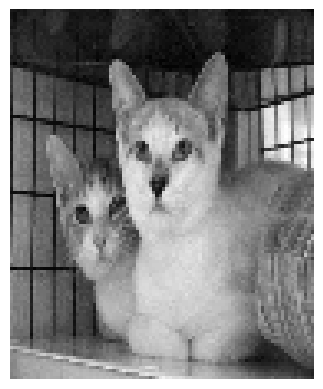

Failure Case
241
Predicted face but actual is non face


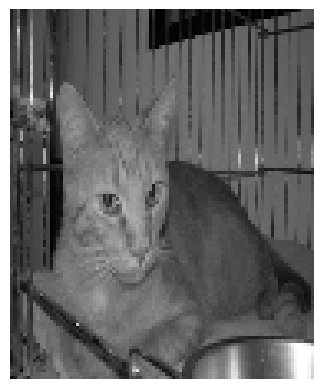

Failure Case
246
Predicted face but actual is non face


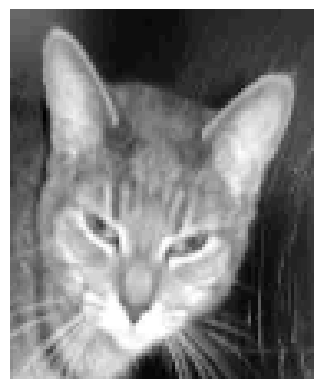

Failure Case
247
Predicted face but actual is non face


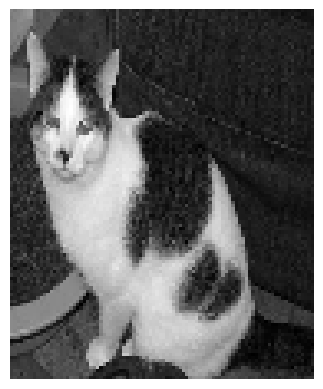

Failure Case
248
Predicted face but actual is non face


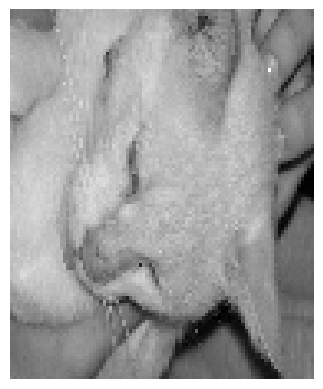

Failure Case
253
Predicted face but actual is non face


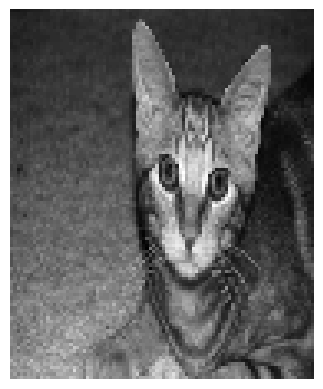

Failure Case
255
Predicted face but actual is non face


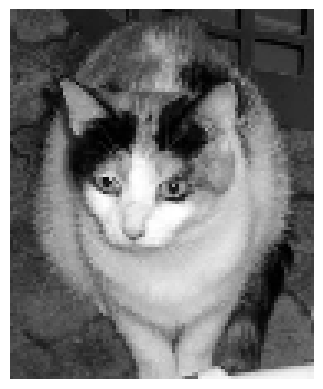

Failure Case
257
Predicted face but actual is non face


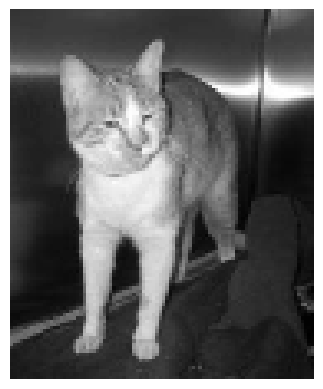

Failure Case
258
Predicted face but actual is non face


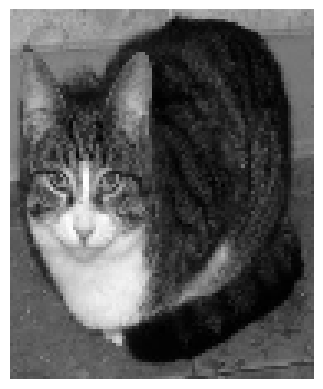

Failure Case
260
Predicted face but actual is non face


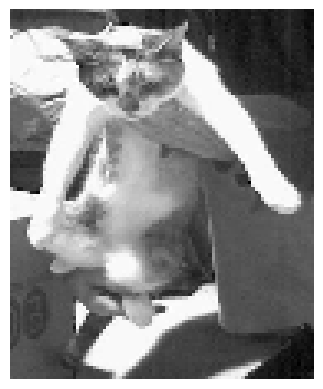

Failure Case
261
Predicted face but actual is non face


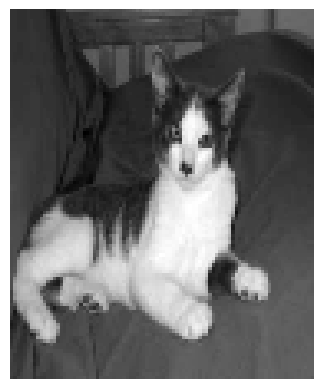

Failure Case
262
Predicted face but actual is non face


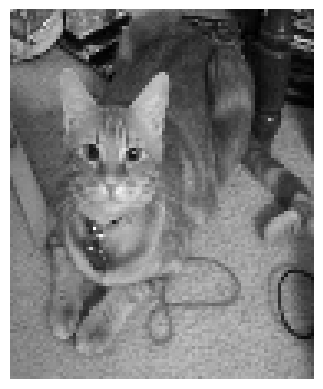

Failure Case
263
Predicted face but actual is non face


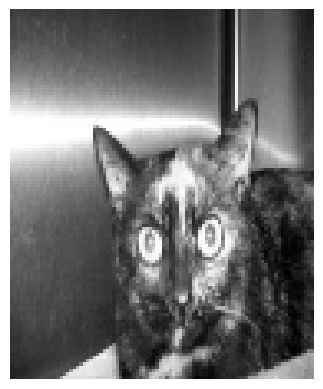

Failure Case
270
Predicted face but actual is non face


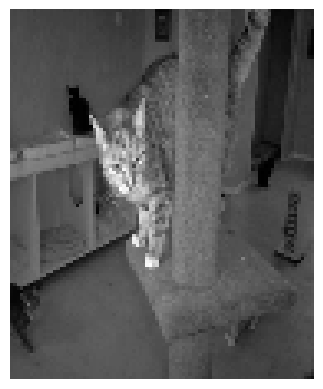

Failure Case
272
Predicted face but actual is non face


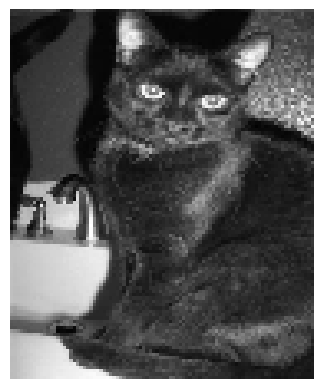

Failure Case
278
Predicted face but actual is non face


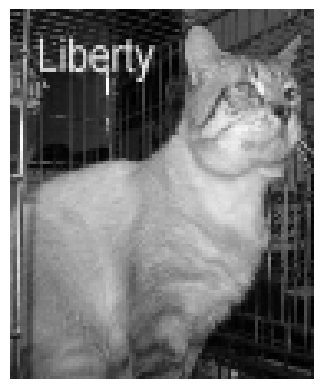

Failure Case
279
Predicted face but actual is non face


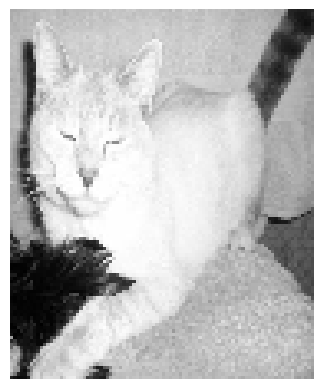

Failure Case
290
Predicted face but actual is non face


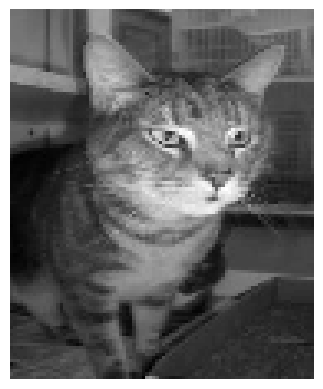

Failure Case
291
Predicted face but actual is non face


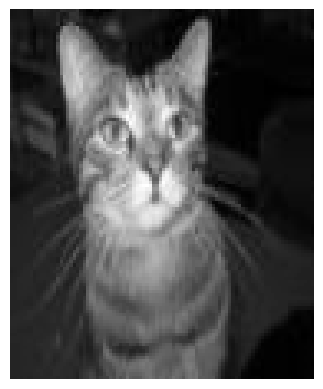

Failure Case
292
Predicted face but actual is non face


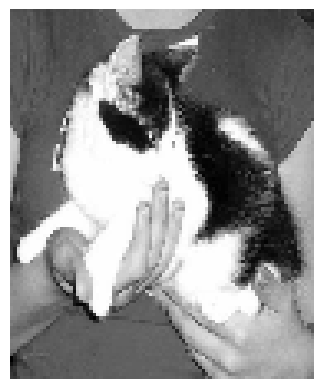

Failure Case
298
Predicted face but actual is non face


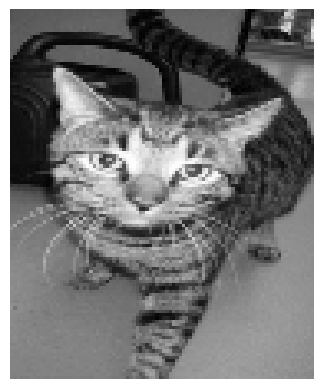

Failure Case
299
Predicted face but actual is non face


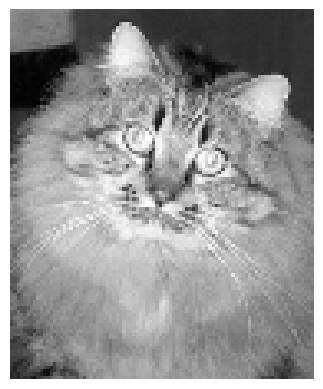

Failure Case
302
Predicted face but actual is non face


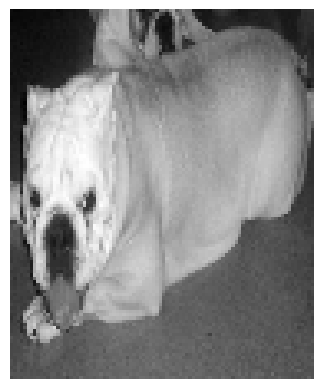

Failure Case
304
Predicted face but actual is non face


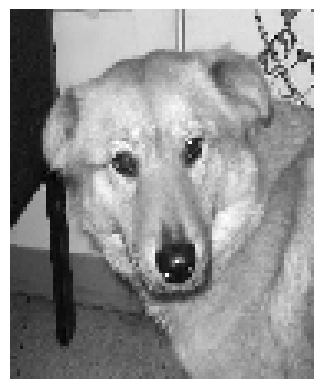

Failure Case
307
Predicted face but actual is non face


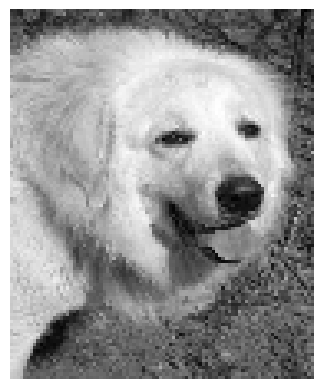

Failure Case
310
Predicted face but actual is non face


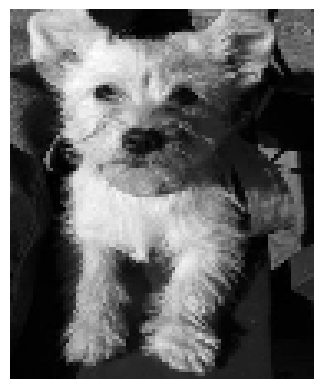

Failure Case
319
Predicted face but actual is non face


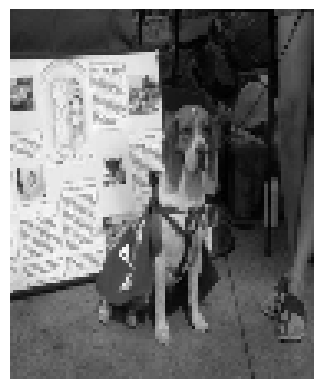

Failure Case
322
Predicted face but actual is non face


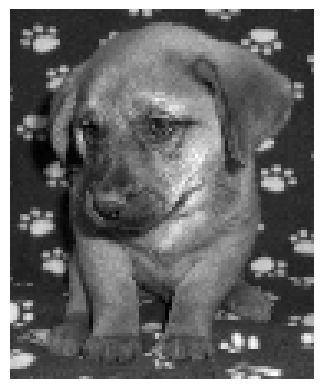

Failure Case
325
Predicted face but actual is non face


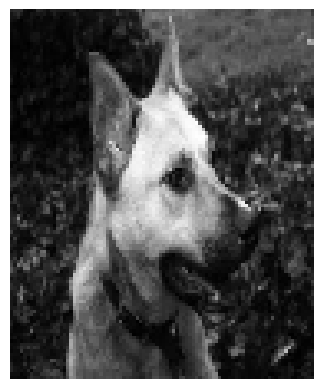

Failure Case
328
Predicted face but actual is non face


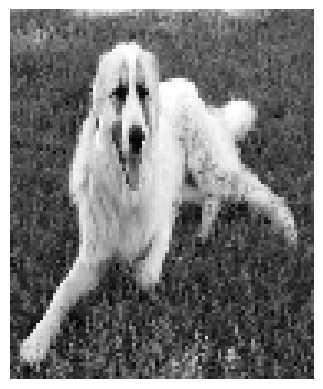

Failure Case
332
Predicted face but actual is non face


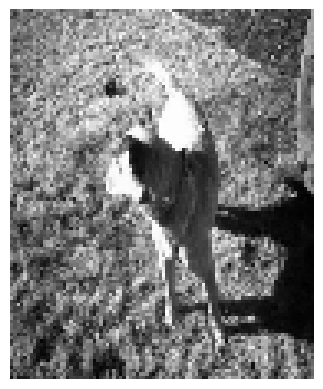

Failure Case
339
Predicted face but actual is non face


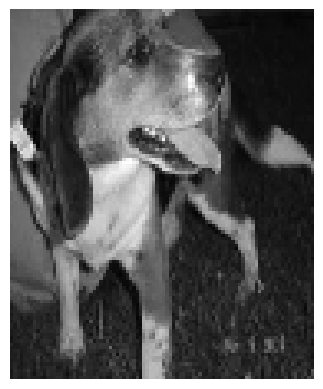

Failure Case
346
Predicted face but actual is non face


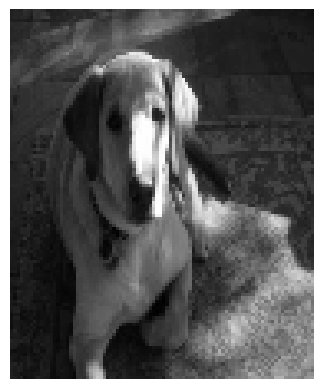

Failure Case
348
Predicted face but actual is non face


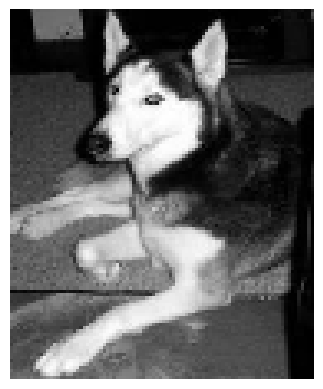

Failure Case
351
Predicted face but actual is non face


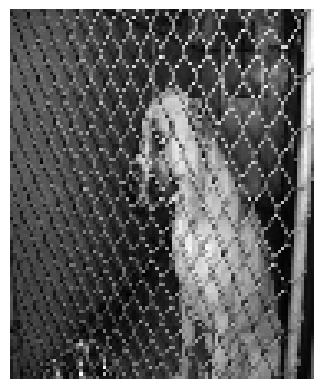

Failure Case
356
Predicted face but actual is non face


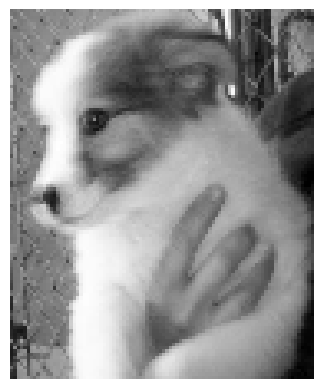

Failure Case
363
Predicted face but actual is non face


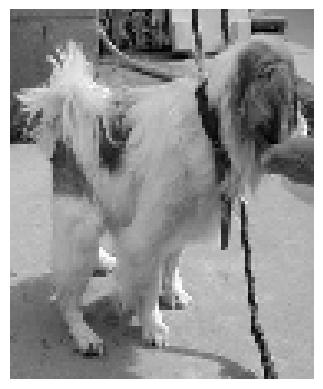

Failure Case
365
Predicted face but actual is non face


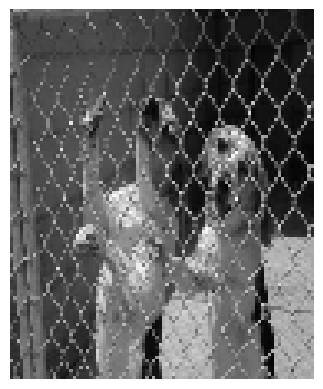

Failure Case
367
Predicted face but actual is non face


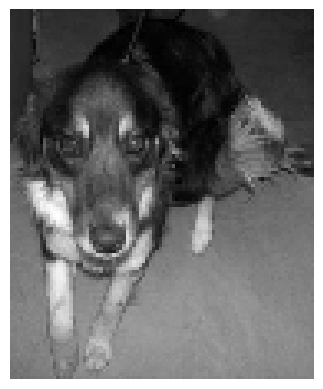

Failure Case
368
Predicted face but actual is non face


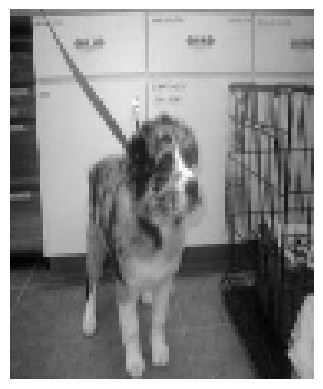

Failure Case
369
Predicted face but actual is non face


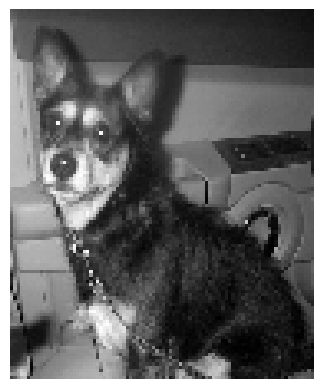

Failure Case
372
Predicted face but actual is non face


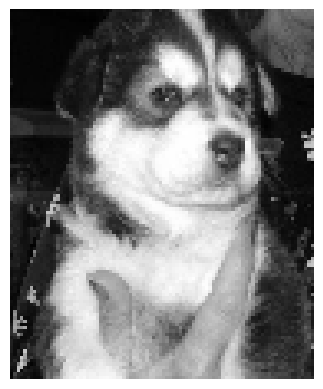

Failure Case
376
Predicted face but actual is non face


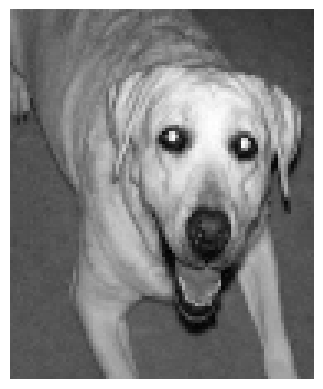

Failure Case
379
Predicted face but actual is non face


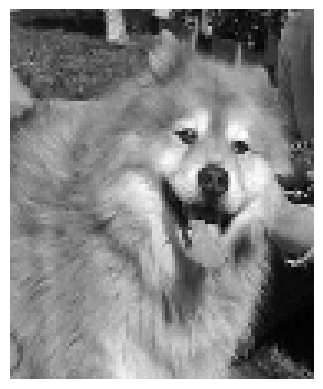

Failure Case
384
Predicted face but actual is non face


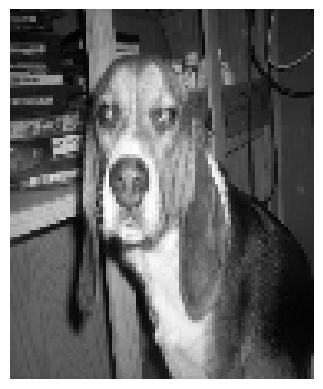

Failure Case
385
Predicted face but actual is non face


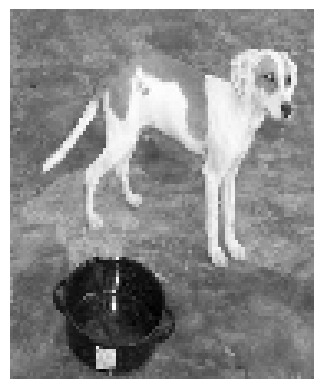

Failure Case
386
Predicted face but actual is non face


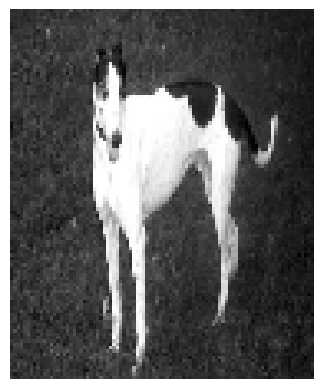

acc = 0.85
ACCURACY FOR ALPHA:0.85 AND K = 7 IS :- 0.835
CONFUSION MATRIX:
[[200   0]
 [ 66 134]]
Failure Case
200
Predicted face but actual is non face


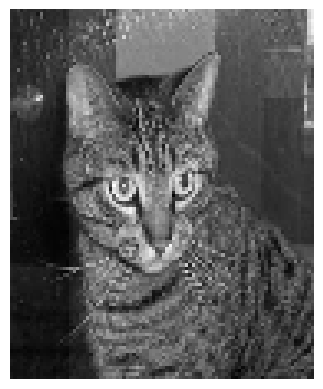

Failure Case
201
Predicted face but actual is non face


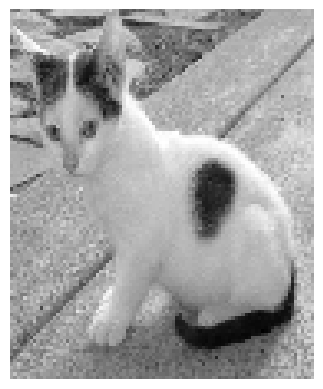

Failure Case
204
Predicted face but actual is non face


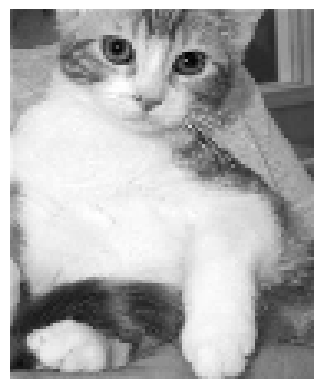

Failure Case
206
Predicted face but actual is non face


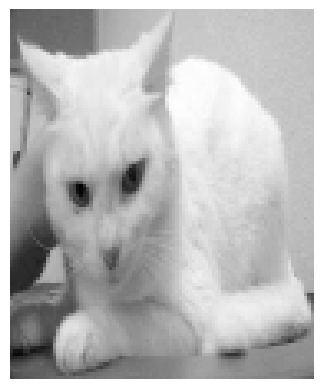

Failure Case
207
Predicted face but actual is non face


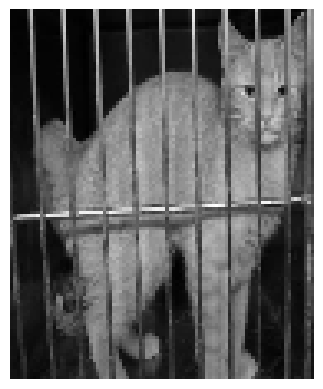

Failure Case
212
Predicted face but actual is non face


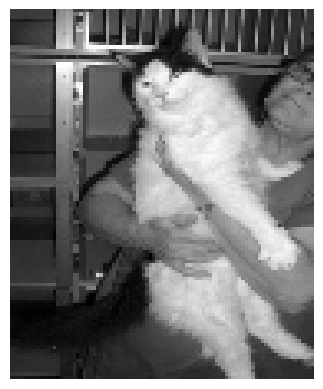

Failure Case
216
Predicted face but actual is non face


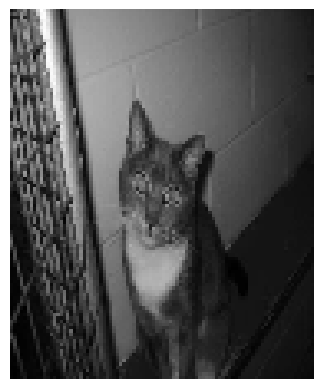

Failure Case
218
Predicted face but actual is non face


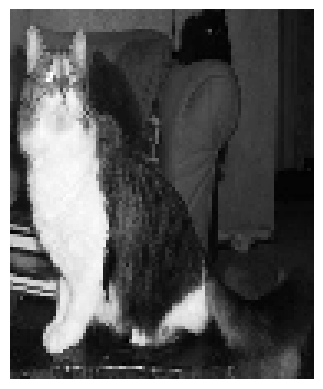

Failure Case
220
Predicted face but actual is non face


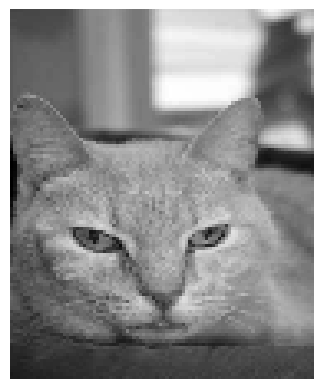

Failure Case
222
Predicted face but actual is non face


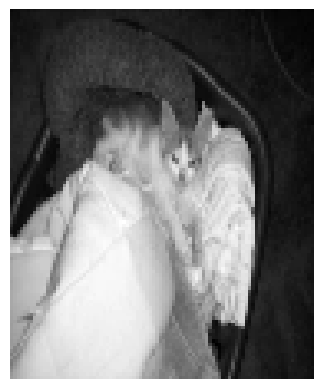

Failure Case
224
Predicted face but actual is non face


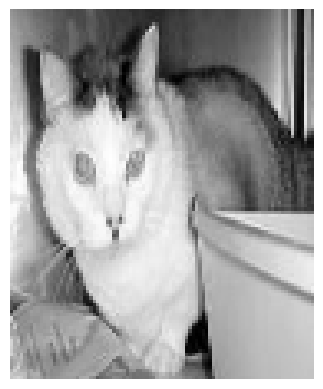

Failure Case
225
Predicted face but actual is non face


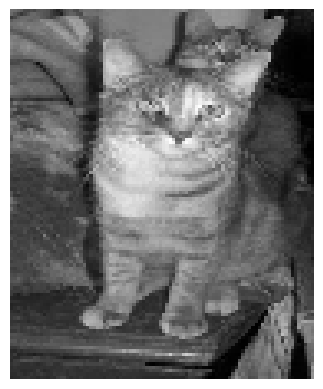

Failure Case
228
Predicted face but actual is non face


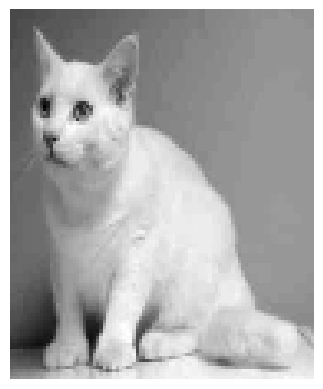

Failure Case
234
Predicted face but actual is non face


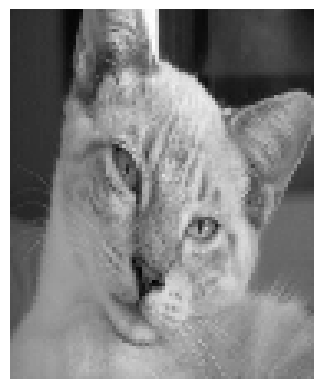

Failure Case
236
Predicted face but actual is non face


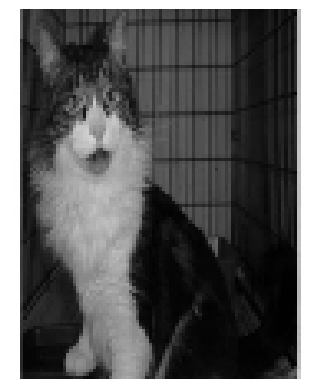

Failure Case
240
Predicted face but actual is non face


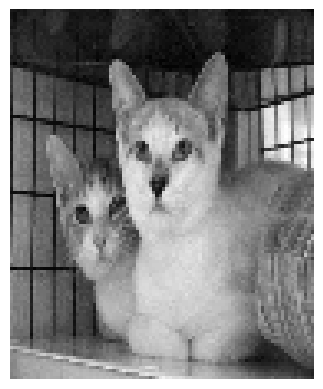

Failure Case
241
Predicted face but actual is non face


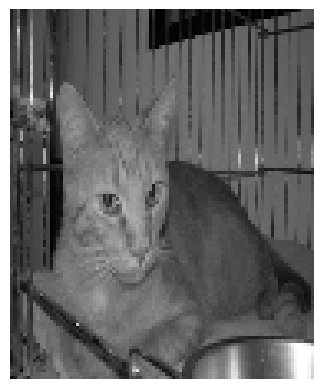

Failure Case
246
Predicted face but actual is non face


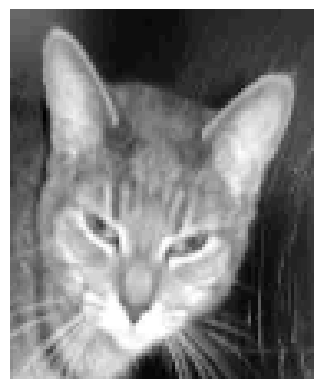

Failure Case
247
Predicted face but actual is non face


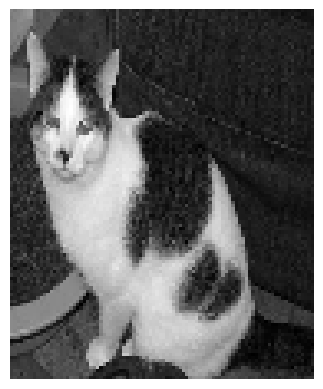

Failure Case
248
Predicted face but actual is non face


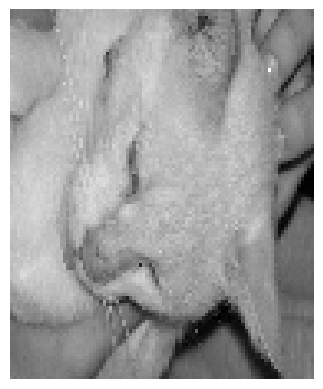

Failure Case
253
Predicted face but actual is non face


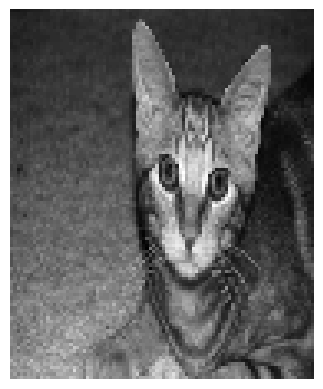

Failure Case
255
Predicted face but actual is non face


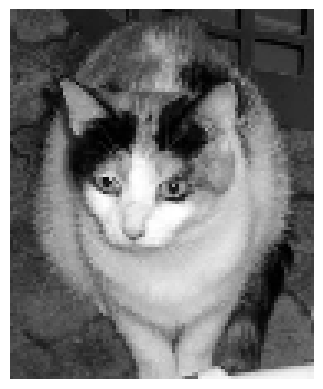

Failure Case
257
Predicted face but actual is non face


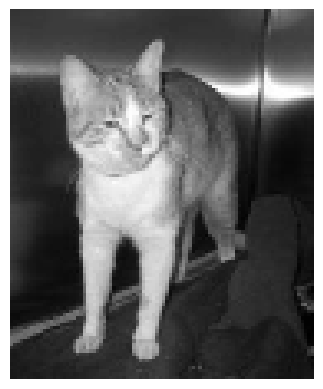

Failure Case
258
Predicted face but actual is non face


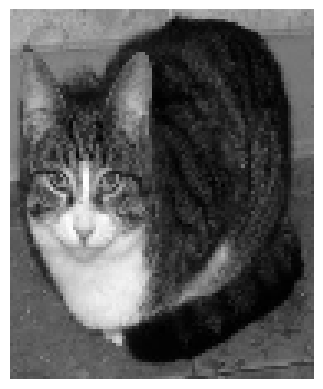

Failure Case
259
Predicted face but actual is non face


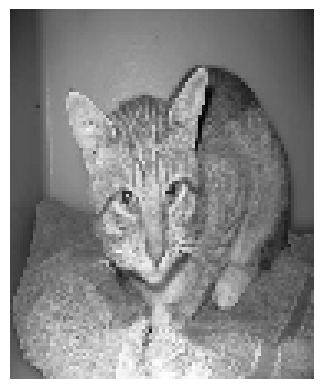

Failure Case
260
Predicted face but actual is non face


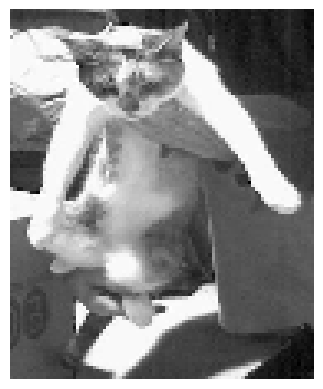

Failure Case
261
Predicted face but actual is non face


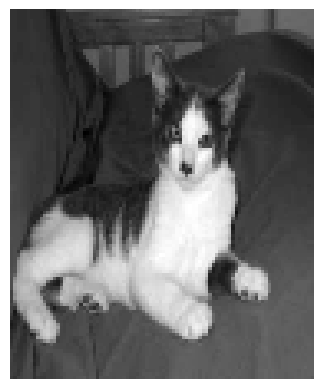

Failure Case
262
Predicted face but actual is non face


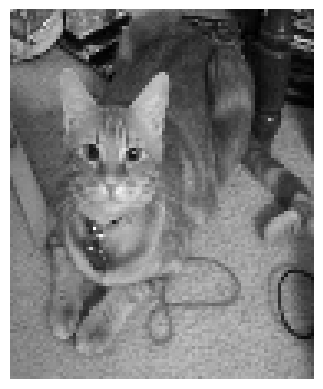

Failure Case
263
Predicted face but actual is non face


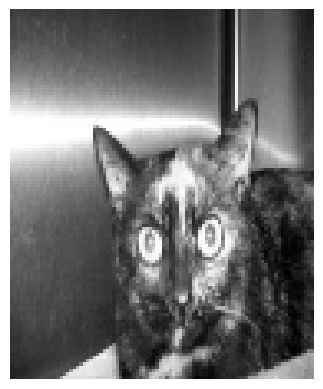

Failure Case
270
Predicted face but actual is non face


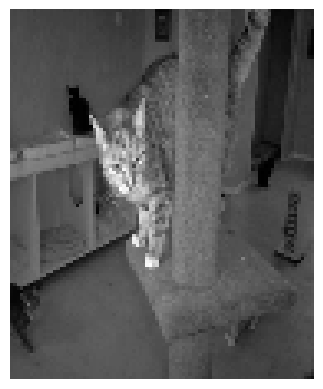

Failure Case
272
Predicted face but actual is non face


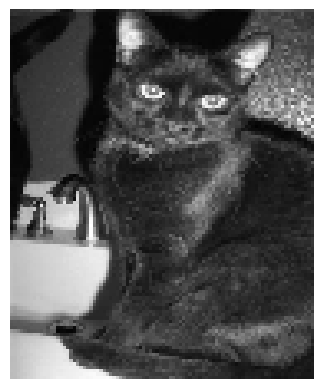

Failure Case
278
Predicted face but actual is non face


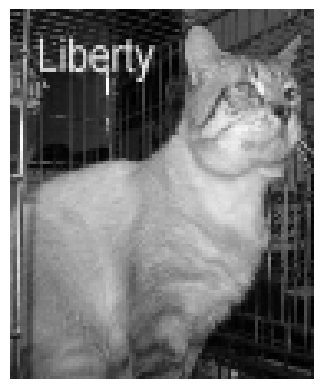

Failure Case
279
Predicted face but actual is non face


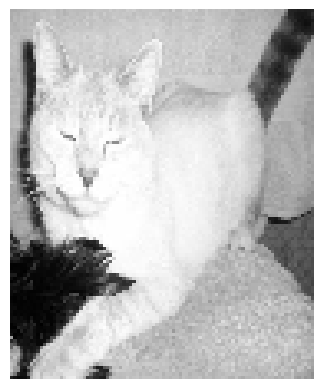

Failure Case
291
Predicted face but actual is non face


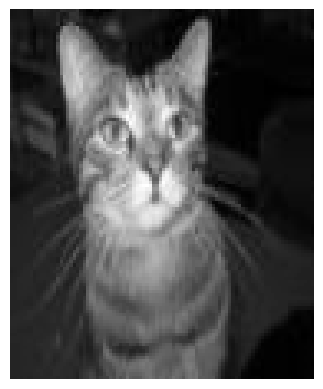

Failure Case
292
Predicted face but actual is non face


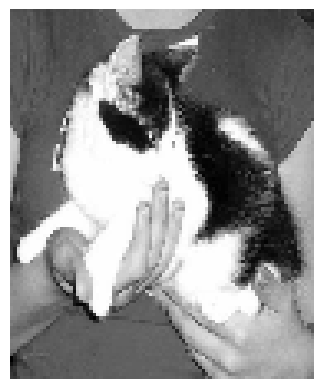

Failure Case
298
Predicted face but actual is non face


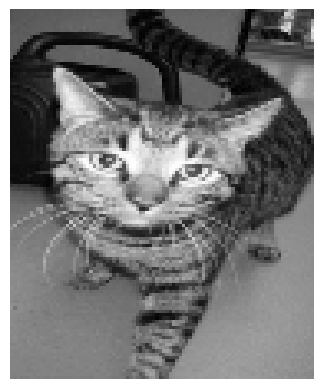

Failure Case
299
Predicted face but actual is non face


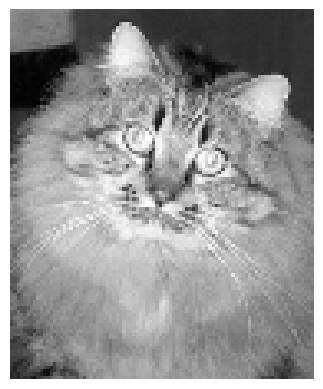

Failure Case
302
Predicted face but actual is non face


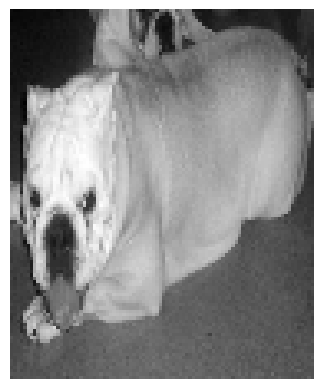

Failure Case
304
Predicted face but actual is non face


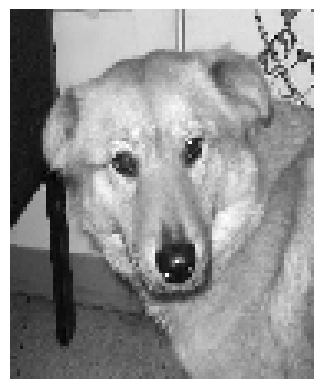

Failure Case
307
Predicted face but actual is non face


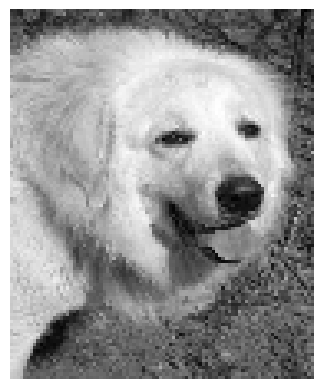

Failure Case
310
Predicted face but actual is non face


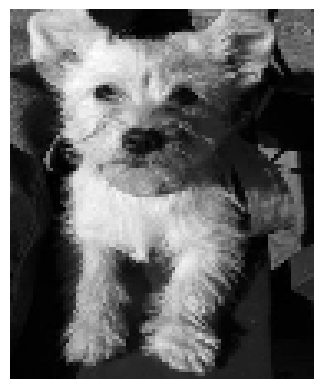

Failure Case
313
Predicted face but actual is non face


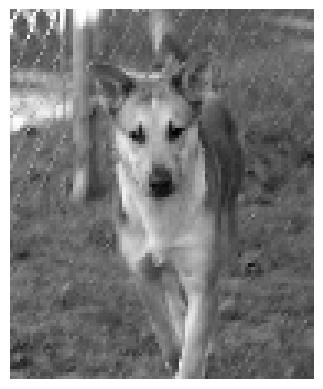

Failure Case
315
Predicted face but actual is non face


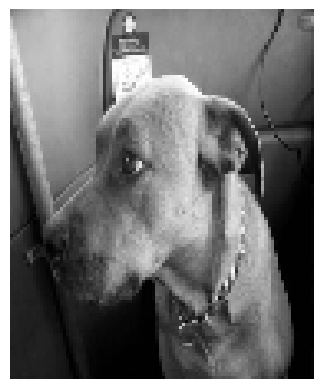

Failure Case
319
Predicted face but actual is non face


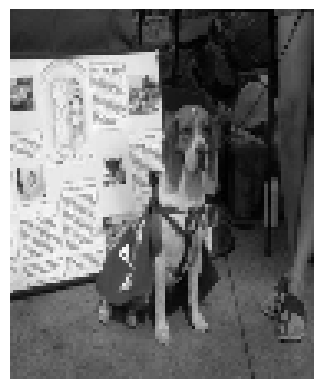

Failure Case
322
Predicted face but actual is non face


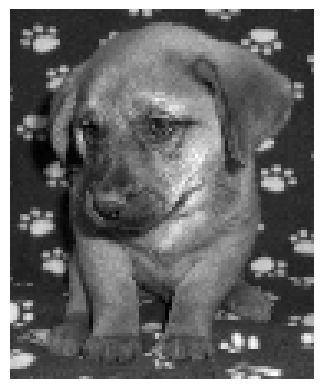

Failure Case
325
Predicted face but actual is non face


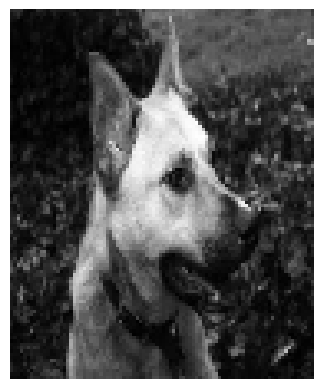

Failure Case
328
Predicted face but actual is non face


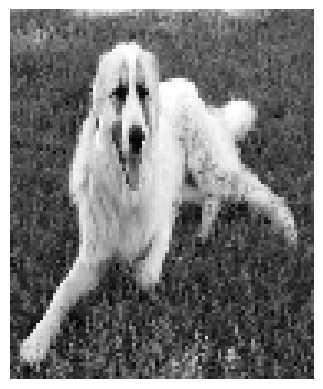

Failure Case
332
Predicted face but actual is non face


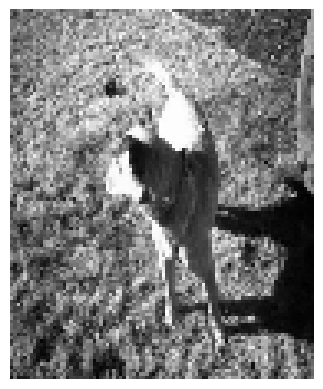

Failure Case
339
Predicted face but actual is non face


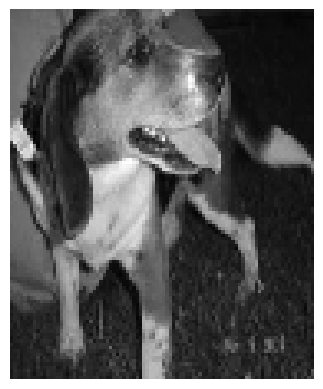

Failure Case
346
Predicted face but actual is non face


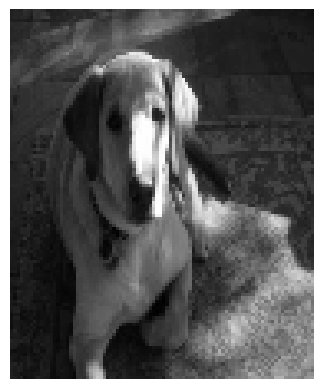

Failure Case
348
Predicted face but actual is non face


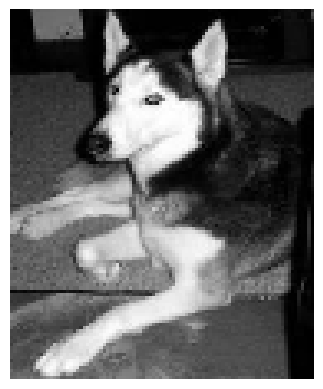

Failure Case
351
Predicted face but actual is non face


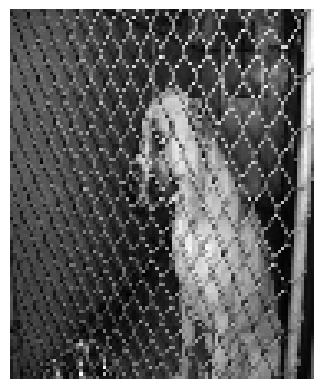

Failure Case
356
Predicted face but actual is non face


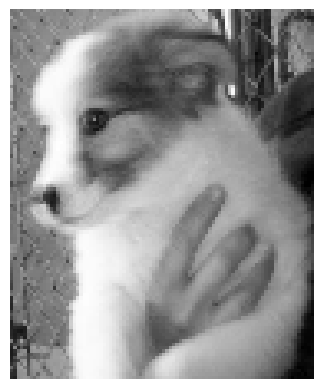

Failure Case
362
Predicted face but actual is non face


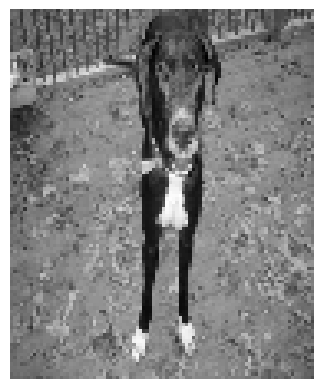

Failure Case
363
Predicted face but actual is non face


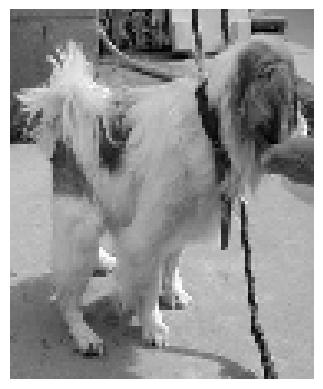

Failure Case
365
Predicted face but actual is non face


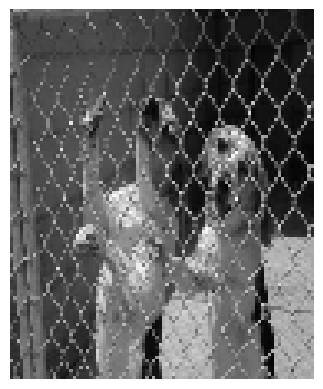

Failure Case
367
Predicted face but actual is non face


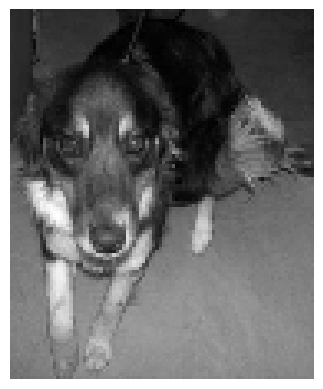

Failure Case
368
Predicted face but actual is non face


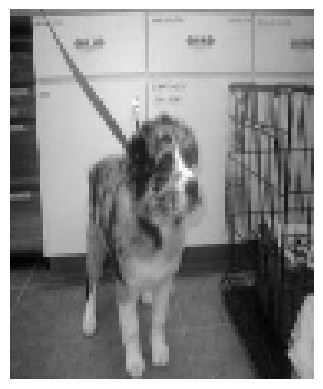

Failure Case
369
Predicted face but actual is non face


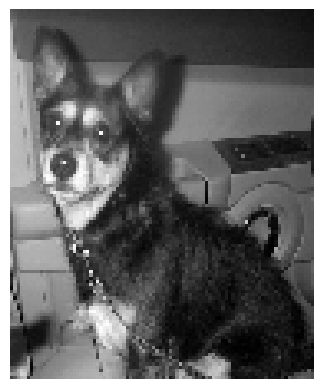

Failure Case
372
Predicted face but actual is non face


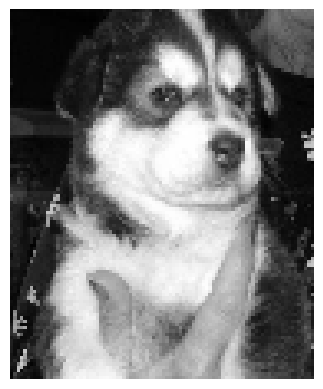

Failure Case
376
Predicted face but actual is non face


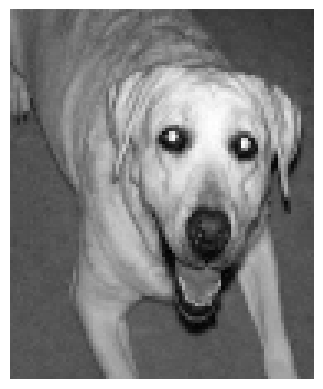

Failure Case
378
Predicted face but actual is non face


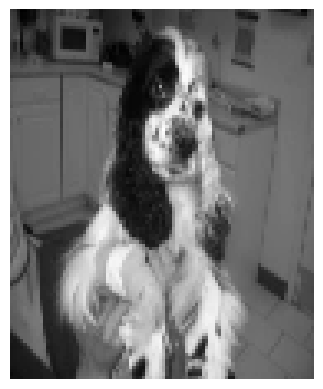

Failure Case
379
Predicted face but actual is non face


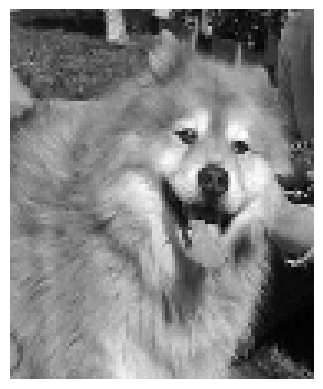

Failure Case
384
Predicted face but actual is non face


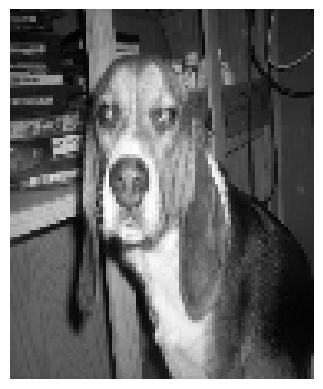

Failure Case
385
Predicted face but actual is non face


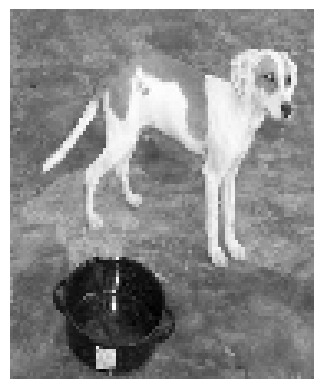

Failure Case
386
Predicted face but actual is non face


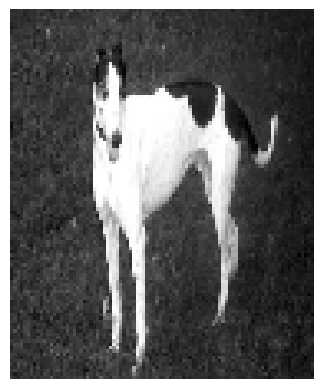

acc = 0.835
ACCURACY FOR ALPHA:0.9 AND K = 7 IS :- 0.81
CONFUSION MATRIX:
[[200   0]
 [ 76 124]]
Failure Case
200
Predicted face but actual is non face


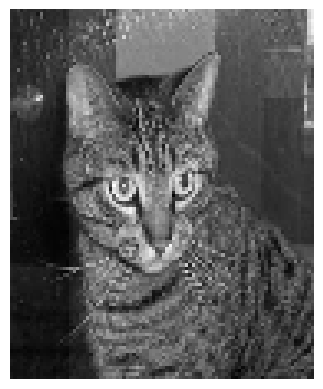

Failure Case
201
Predicted face but actual is non face


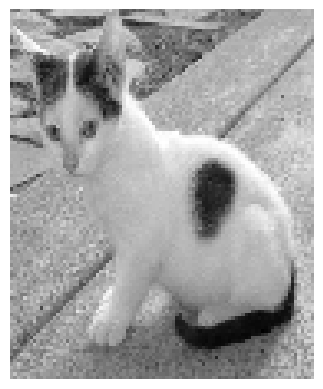

Failure Case
204
Predicted face but actual is non face


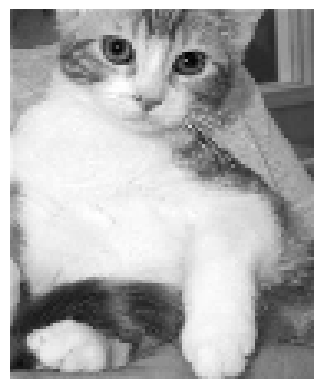

Failure Case
206
Predicted face but actual is non face


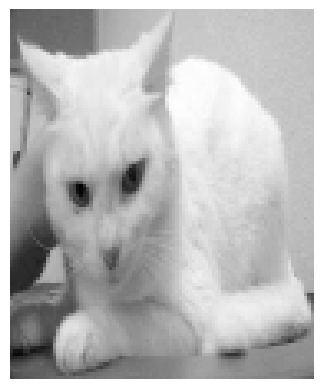

Failure Case
207
Predicted face but actual is non face


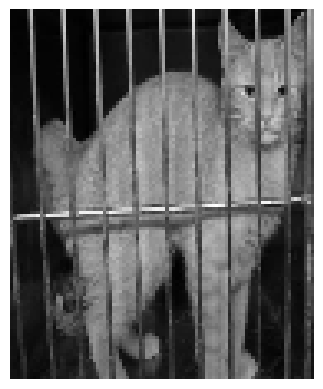

Failure Case
212
Predicted face but actual is non face


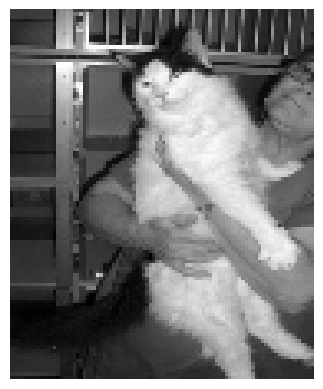

Failure Case
216
Predicted face but actual is non face


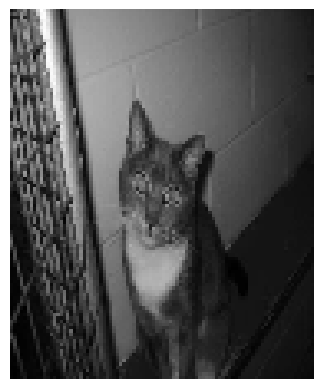

Failure Case
218
Predicted face but actual is non face


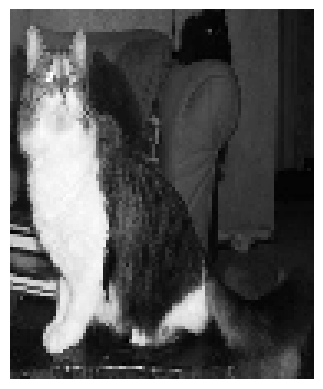

Failure Case
220
Predicted face but actual is non face


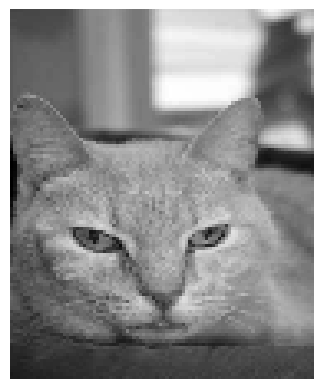

Failure Case
222
Predicted face but actual is non face


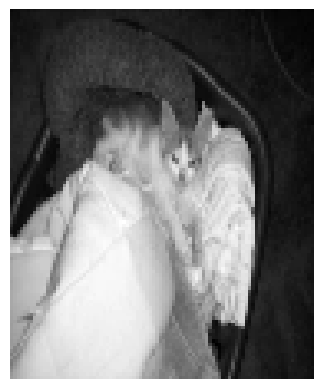

Failure Case
224
Predicted face but actual is non face


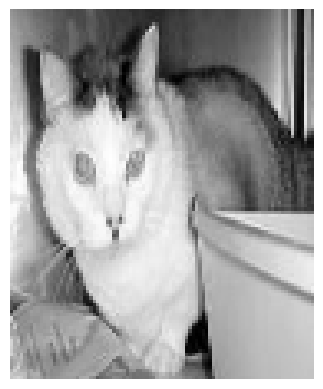

Failure Case
225
Predicted face but actual is non face


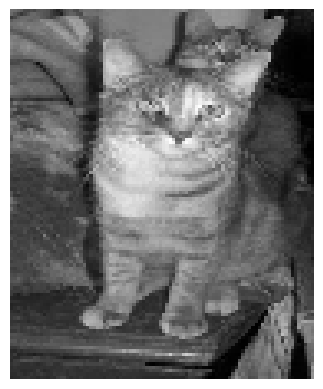

Failure Case
228
Predicted face but actual is non face


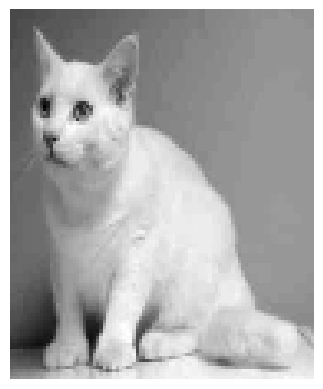

Failure Case
234
Predicted face but actual is non face


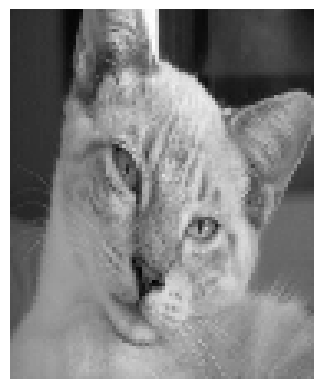

Failure Case
236
Predicted face but actual is non face


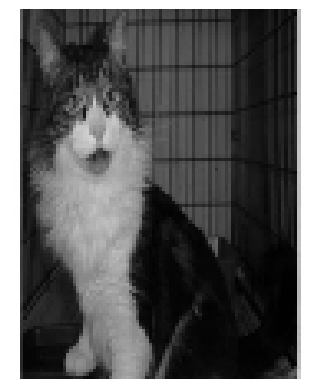

Failure Case
237
Predicted face but actual is non face


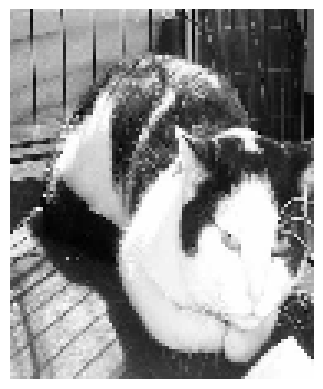

Failure Case
240
Predicted face but actual is non face


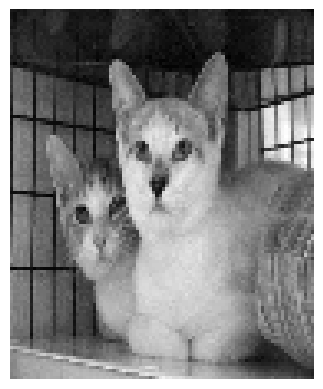

Failure Case
241
Predicted face but actual is non face


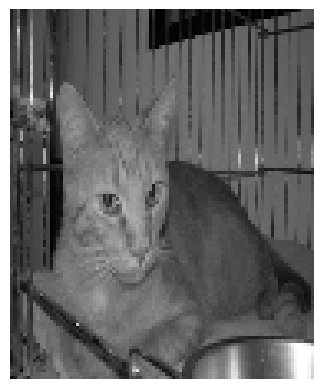

Failure Case
246
Predicted face but actual is non face


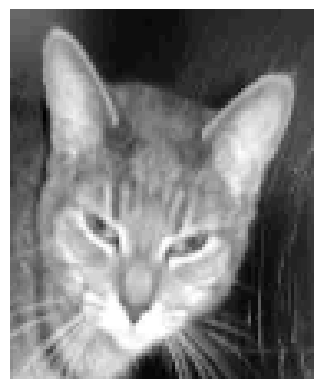

Failure Case
247
Predicted face but actual is non face


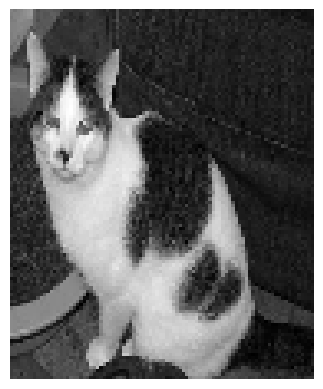

Failure Case
248
Predicted face but actual is non face


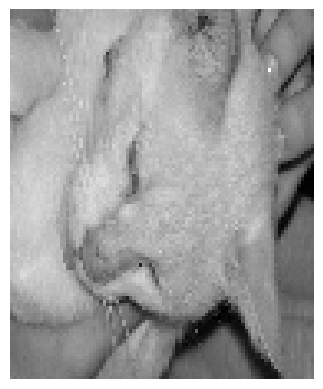

Failure Case
253
Predicted face but actual is non face


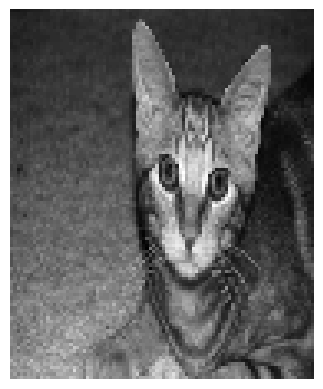

Failure Case
255
Predicted face but actual is non face


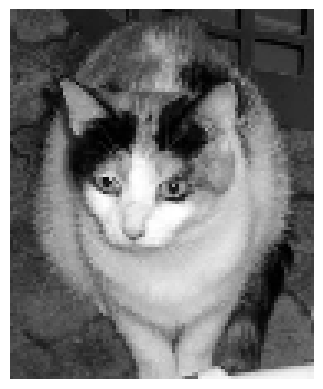

Failure Case
257
Predicted face but actual is non face


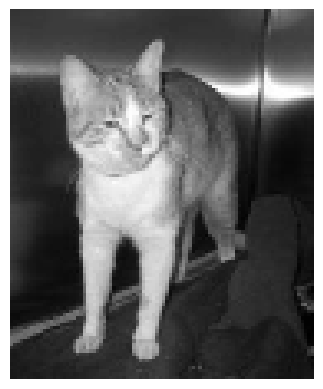

Failure Case
258
Predicted face but actual is non face


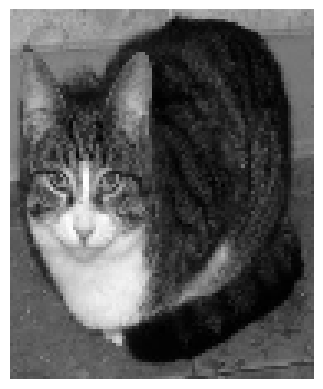

Failure Case
260
Predicted face but actual is non face


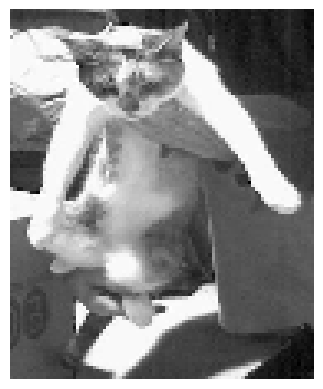

Failure Case
261
Predicted face but actual is non face


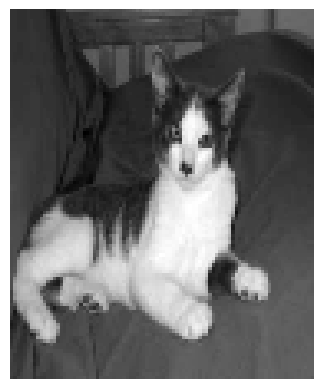

Failure Case
262
Predicted face but actual is non face


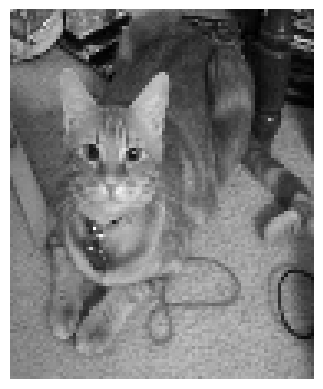

Failure Case
263
Predicted face but actual is non face


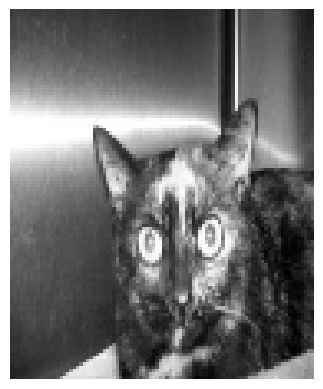

Failure Case
264
Predicted face but actual is non face


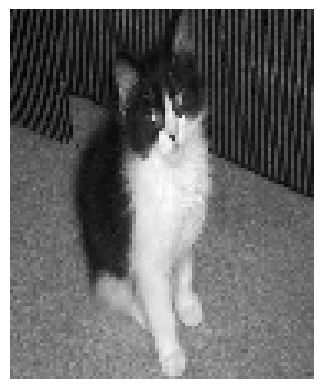

Failure Case
270
Predicted face but actual is non face


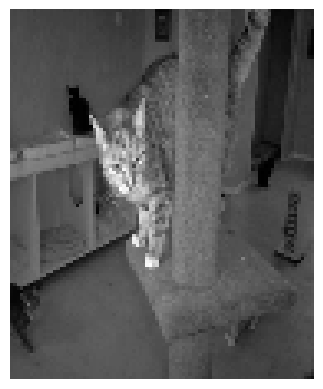

Failure Case
272
Predicted face but actual is non face


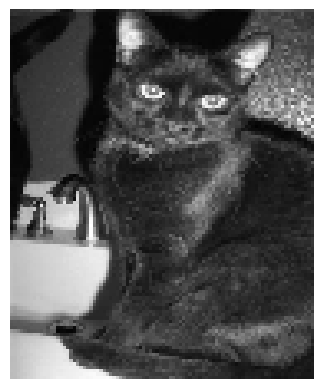

Failure Case
275
Predicted face but actual is non face


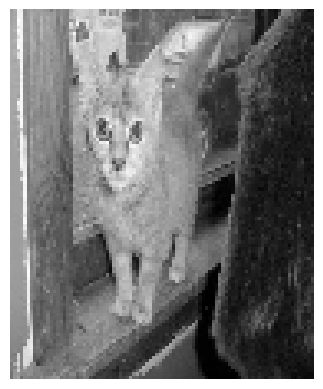

Failure Case
278
Predicted face but actual is non face


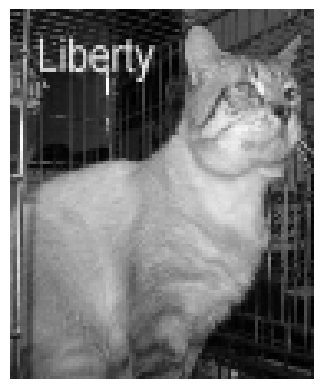

Failure Case
279
Predicted face but actual is non face


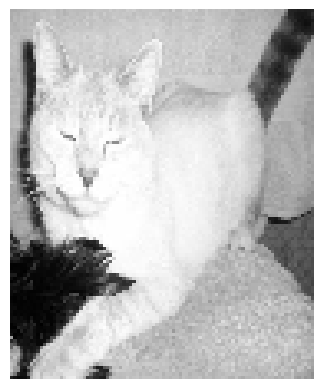

Failure Case
283
Predicted face but actual is non face


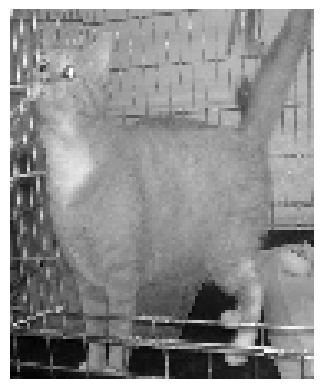

Failure Case
290
Predicted face but actual is non face


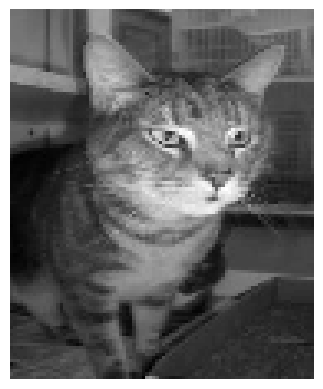

Failure Case
291
Predicted face but actual is non face


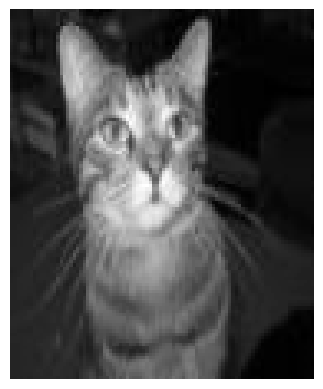

Failure Case
292
Predicted face but actual is non face


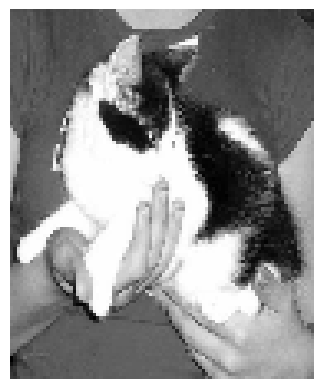

Failure Case
297
Predicted face but actual is non face


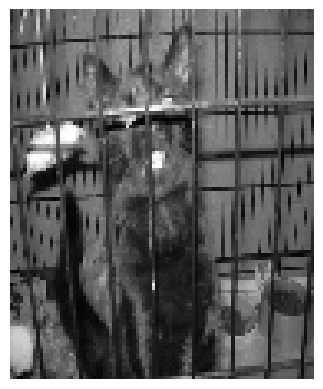

Failure Case
298
Predicted face but actual is non face


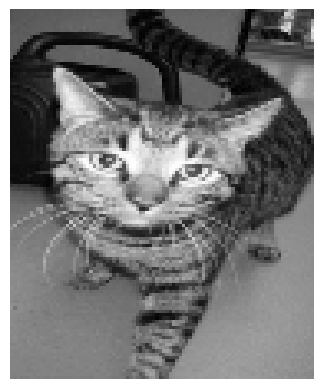

Failure Case
299
Predicted face but actual is non face


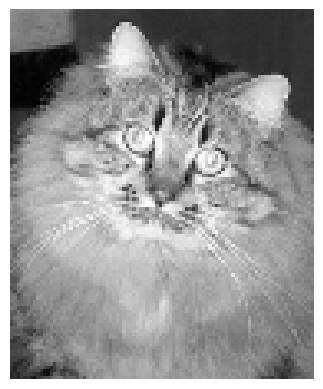

Failure Case
302
Predicted face but actual is non face


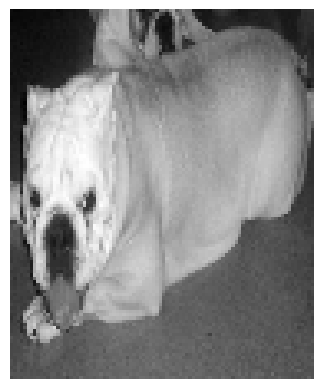

Failure Case
304
Predicted face but actual is non face


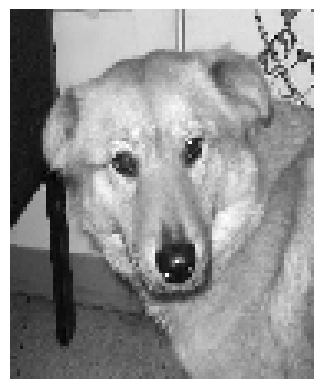

Failure Case
307
Predicted face but actual is non face


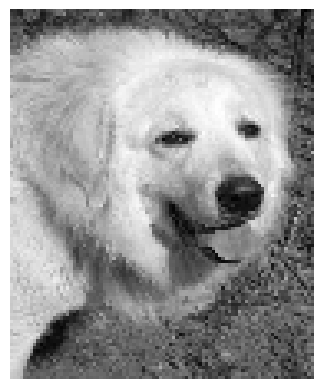

Failure Case
310
Predicted face but actual is non face


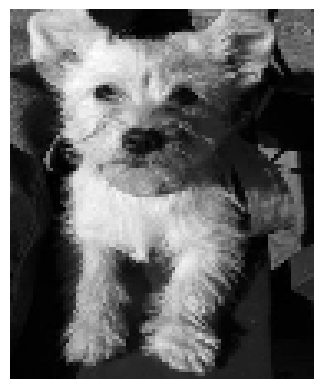

Failure Case
313
Predicted face but actual is non face


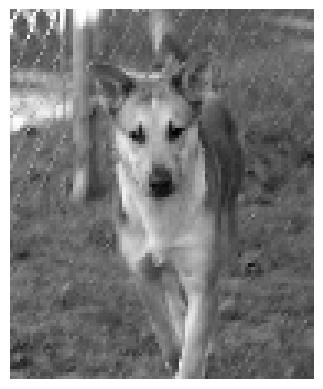

Failure Case
315
Predicted face but actual is non face


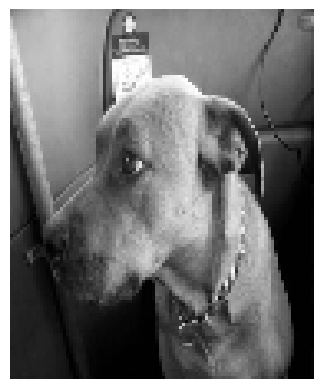

Failure Case
319
Predicted face but actual is non face


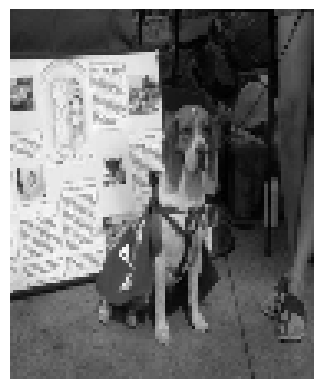

Failure Case
322
Predicted face but actual is non face


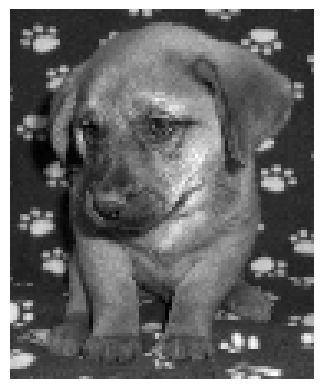

Failure Case
325
Predicted face but actual is non face


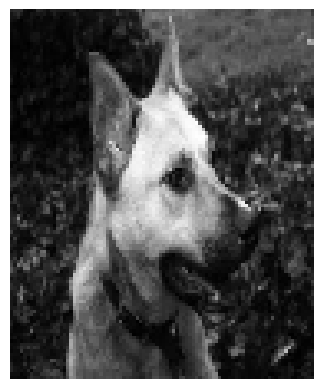

Failure Case
326
Predicted face but actual is non face


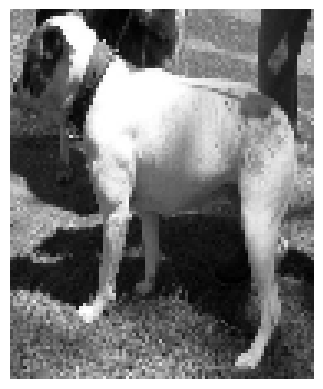

Failure Case
328
Predicted face but actual is non face


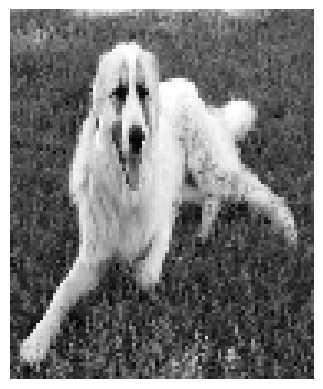

Failure Case
332
Predicted face but actual is non face


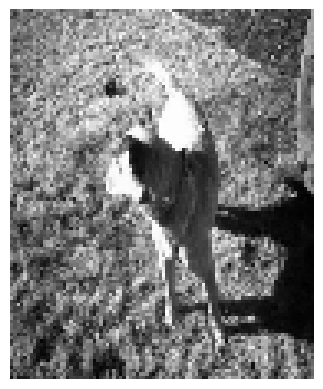

Failure Case
333
Predicted face but actual is non face


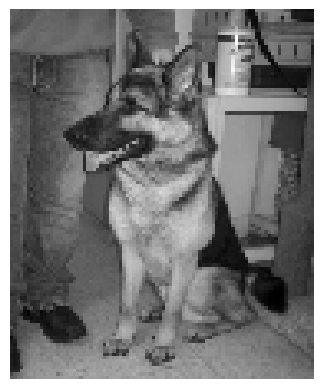

Failure Case
335
Predicted face but actual is non face


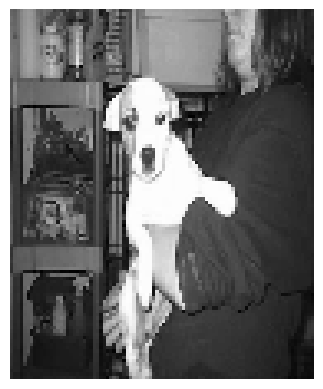

Failure Case
339
Predicted face but actual is non face


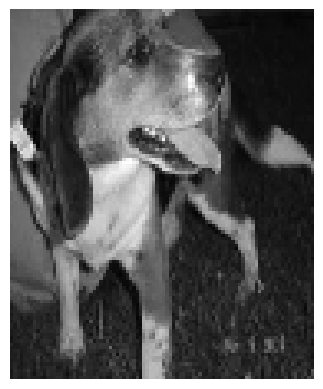

Failure Case
346
Predicted face but actual is non face


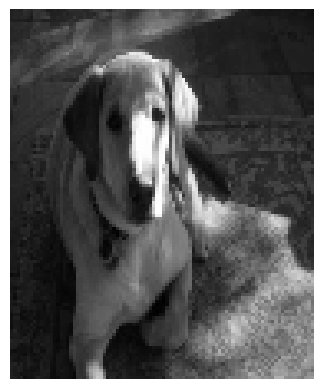

Failure Case
348
Predicted face but actual is non face


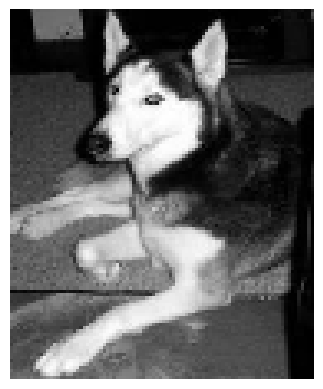

Failure Case
351
Predicted face but actual is non face


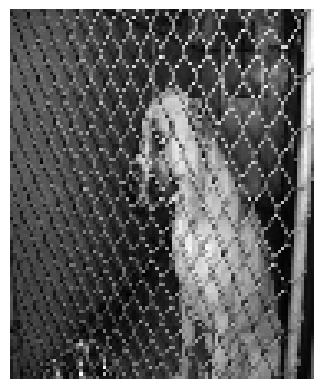

Failure Case
356
Predicted face but actual is non face


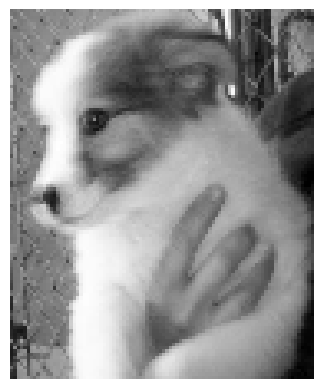

Failure Case
359
Predicted face but actual is non face


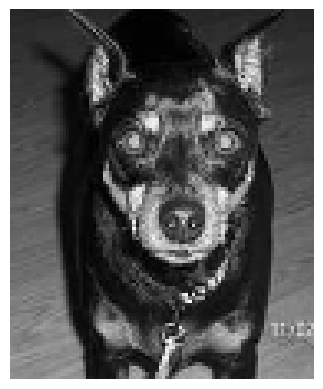

Failure Case
362
Predicted face but actual is non face


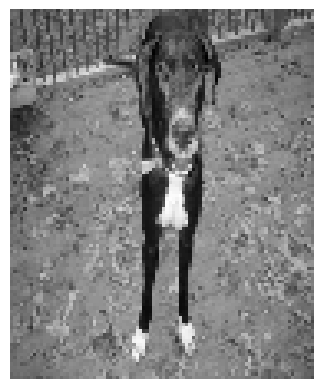

Failure Case
363
Predicted face but actual is non face


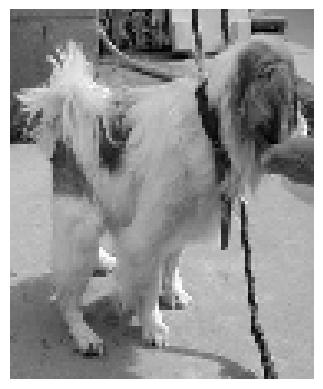

Failure Case
365
Predicted face but actual is non face


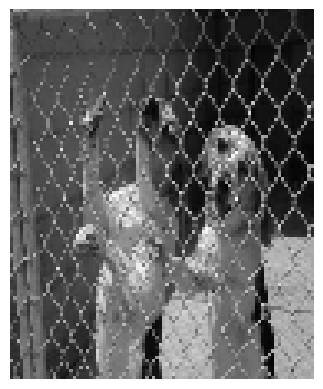

Failure Case
367
Predicted face but actual is non face


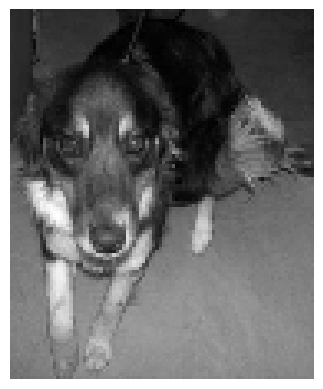

Failure Case
368
Predicted face but actual is non face


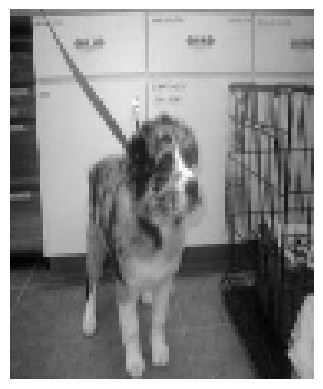

Failure Case
369
Predicted face but actual is non face


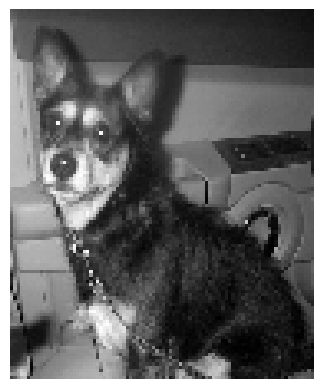

Failure Case
372
Predicted face but actual is non face


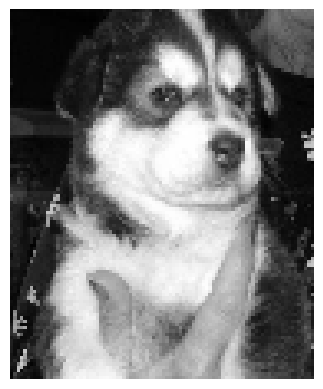

Failure Case
376
Predicted face but actual is non face


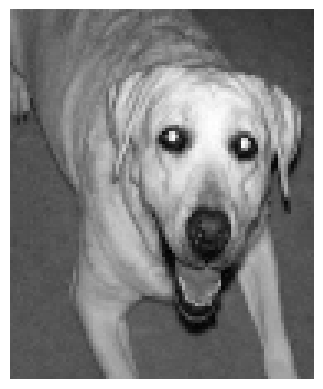

Failure Case
378
Predicted face but actual is non face


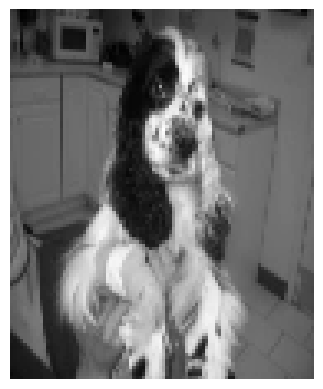

Failure Case
379
Predicted face but actual is non face


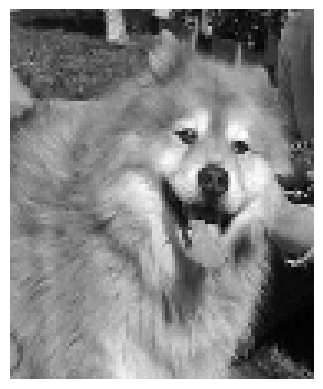

Failure Case
384
Predicted face but actual is non face


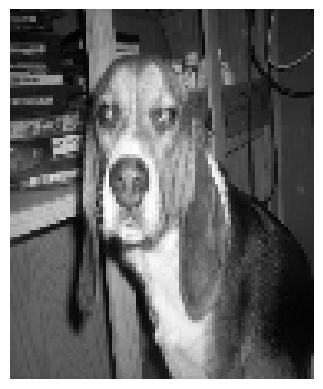

Failure Case
385
Predicted face but actual is non face


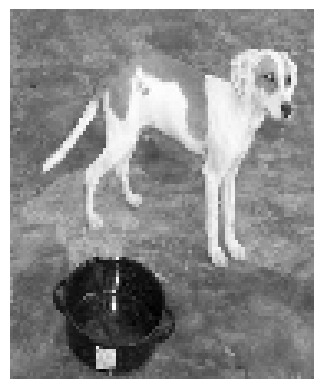

Failure Case
386
Predicted face but actual is non face


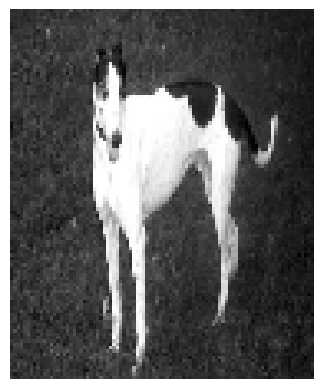

Failure Case
396
Predicted face but actual is non face


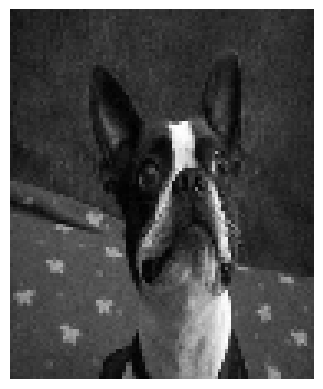

acc = 0.81
ACCURACY FOR ALPHA:0.95 AND K = 7 IS :- 0.795
CONFUSION MATRIX:
[[200   0]
 [ 82 118]]
Failure Case
200
Predicted face but actual is non face


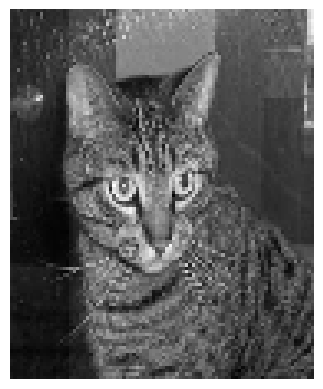

Failure Case
201
Predicted face but actual is non face


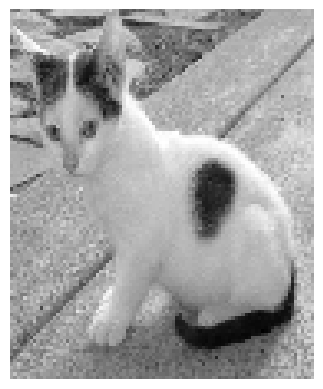

Failure Case
204
Predicted face but actual is non face


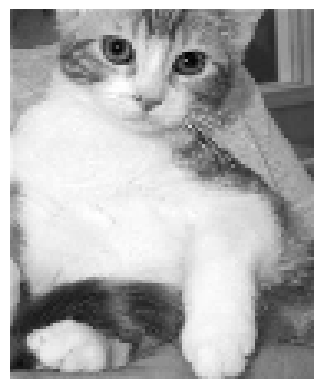

Failure Case
206
Predicted face but actual is non face


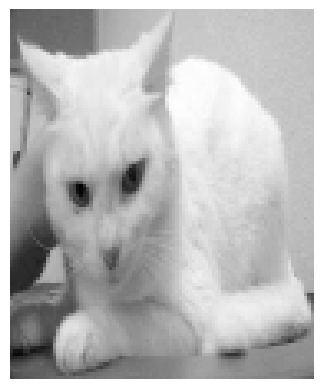

Failure Case
207
Predicted face but actual is non face


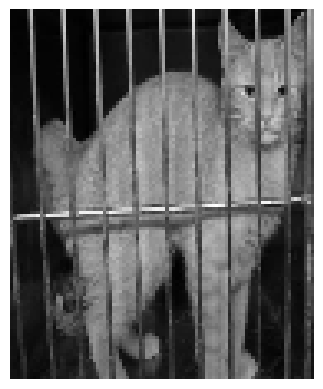

Failure Case
212
Predicted face but actual is non face


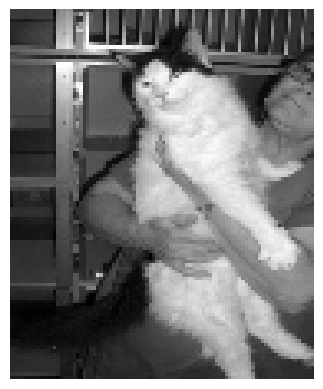

Failure Case
216
Predicted face but actual is non face


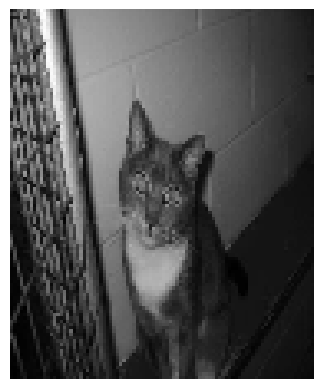

Failure Case
218
Predicted face but actual is non face


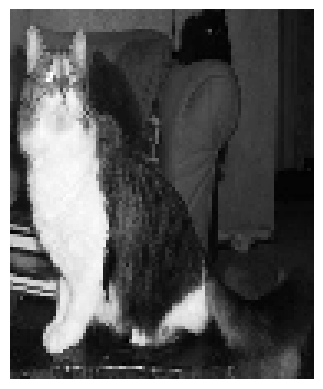

Failure Case
220
Predicted face but actual is non face


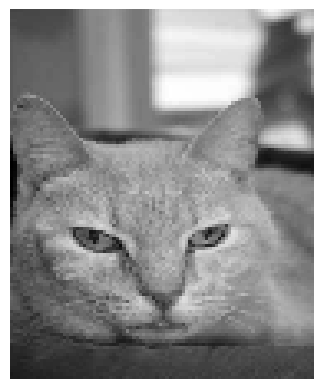

Failure Case
222
Predicted face but actual is non face


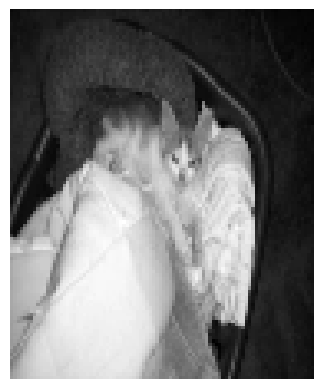

Failure Case
224
Predicted face but actual is non face


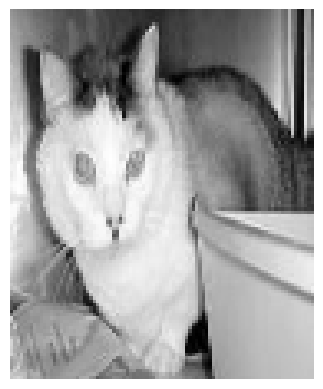

Failure Case
225
Predicted face but actual is non face


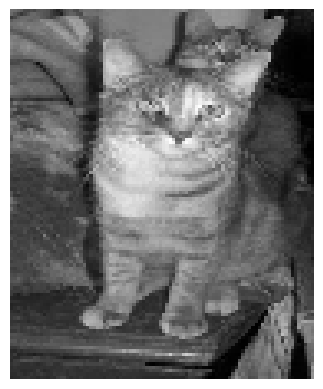

Failure Case
228
Predicted face but actual is non face


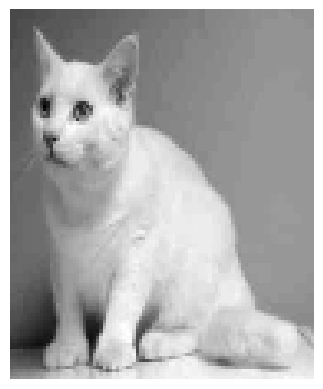

Failure Case
234
Predicted face but actual is non face


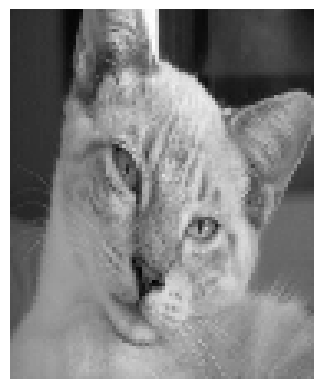

Failure Case
236
Predicted face but actual is non face


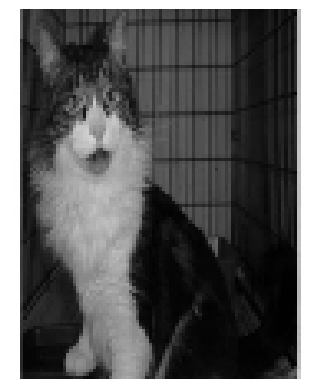

Failure Case
237
Predicted face but actual is non face


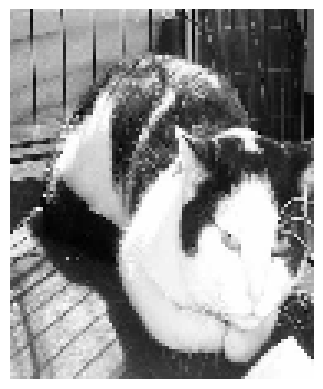

Failure Case
238
Predicted face but actual is non face


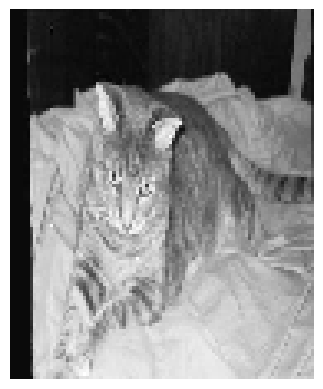

Failure Case
240
Predicted face but actual is non face


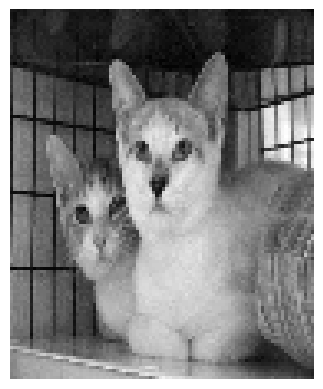

Failure Case
241
Predicted face but actual is non face


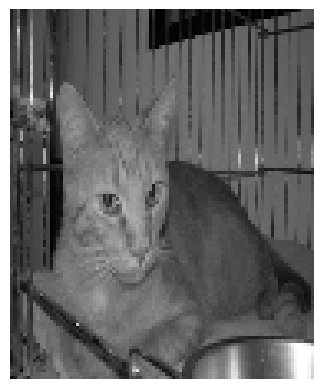

Failure Case
246
Predicted face but actual is non face


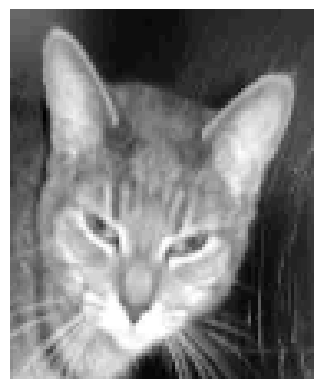

Failure Case
247
Predicted face but actual is non face


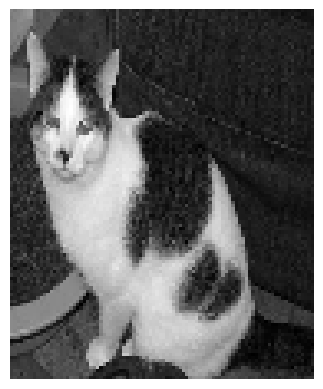

Failure Case
248
Predicted face but actual is non face


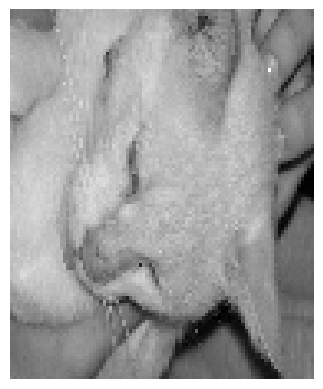

Failure Case
253
Predicted face but actual is non face


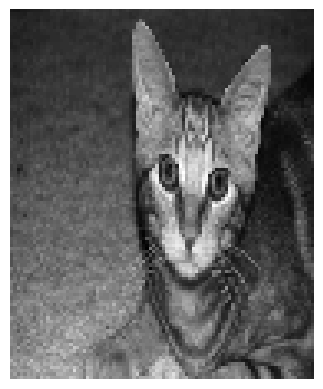

Failure Case
255
Predicted face but actual is non face


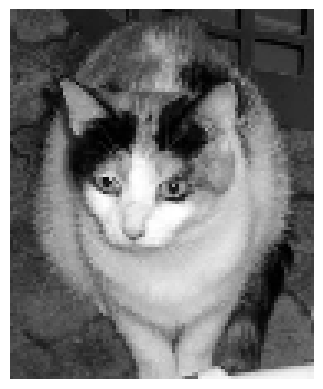

Failure Case
257
Predicted face but actual is non face


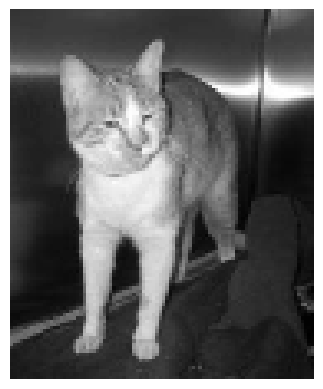

Failure Case
258
Predicted face but actual is non face


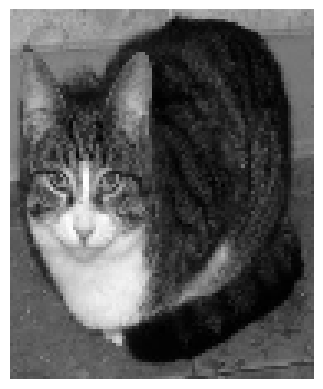

Failure Case
260
Predicted face but actual is non face


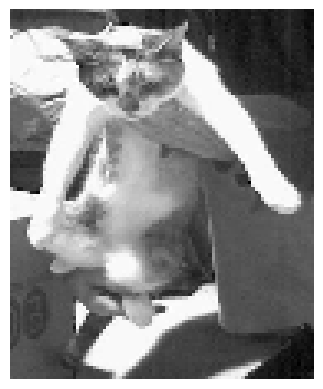

Failure Case
261
Predicted face but actual is non face


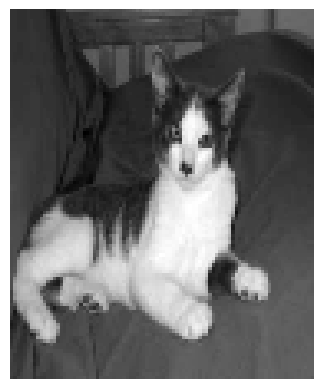

Failure Case
262
Predicted face but actual is non face


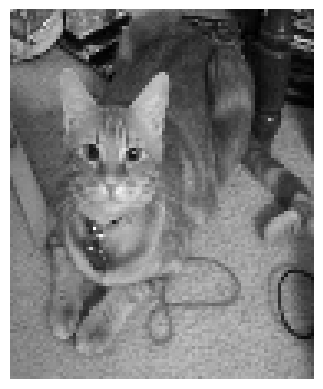

Failure Case
263
Predicted face but actual is non face


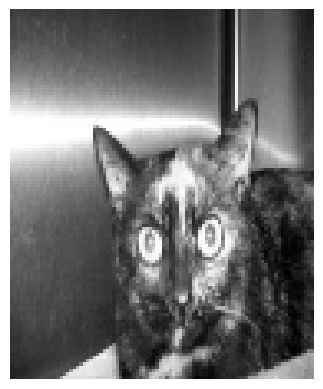

Failure Case
264
Predicted face but actual is non face


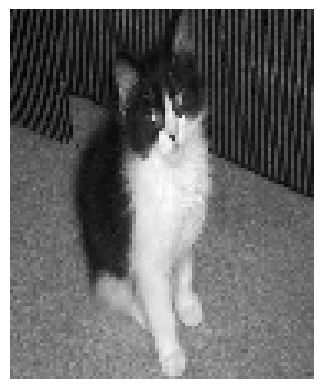

Failure Case
267
Predicted face but actual is non face


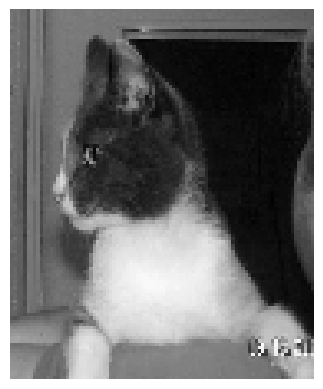

Failure Case
268
Predicted face but actual is non face


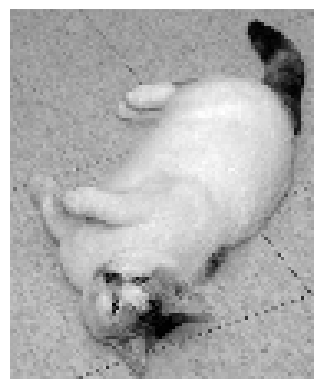

Failure Case
270
Predicted face but actual is non face


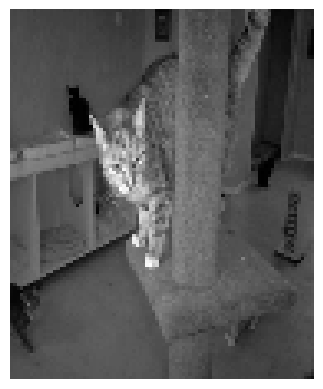

Failure Case
272
Predicted face but actual is non face


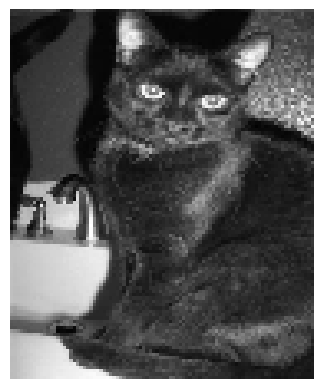

Failure Case
275
Predicted face but actual is non face


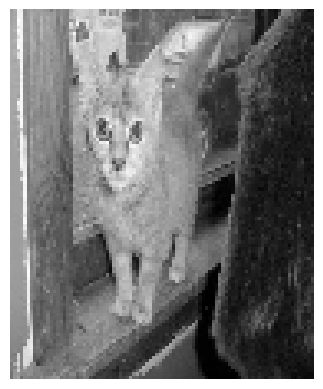

Failure Case
278
Predicted face but actual is non face


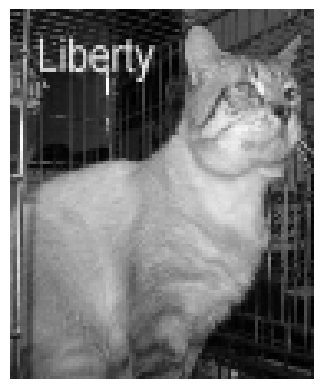

Failure Case
279
Predicted face but actual is non face


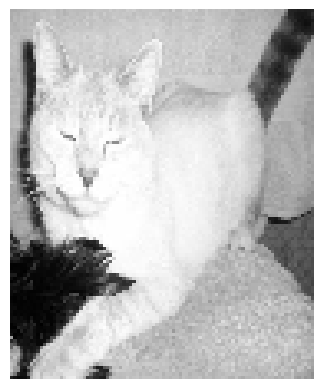

Failure Case
282
Predicted face but actual is non face


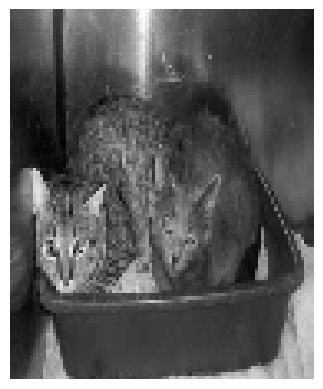

Failure Case
283
Predicted face but actual is non face


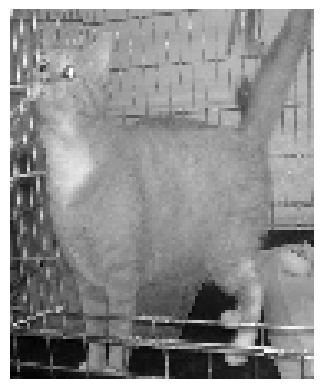

Failure Case
290
Predicted face but actual is non face


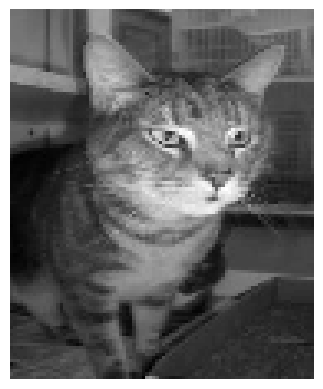

Failure Case
291
Predicted face but actual is non face


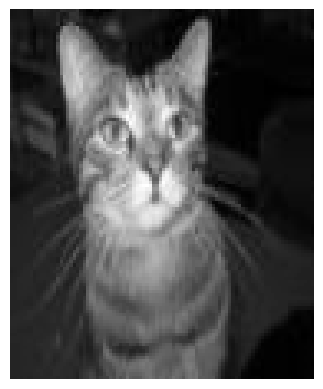

Failure Case
292
Predicted face but actual is non face


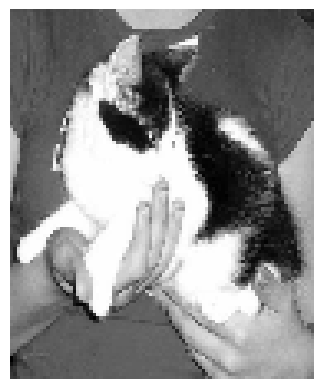

Failure Case
297
Predicted face but actual is non face


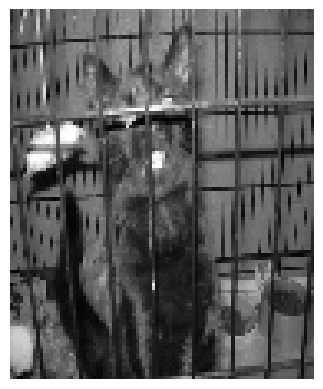

Failure Case
298
Predicted face but actual is non face


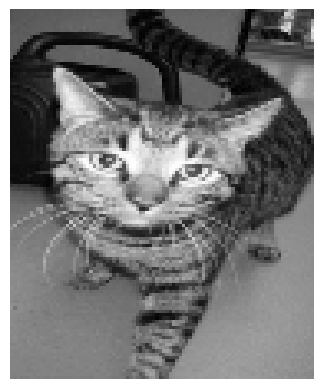

Failure Case
299
Predicted face but actual is non face


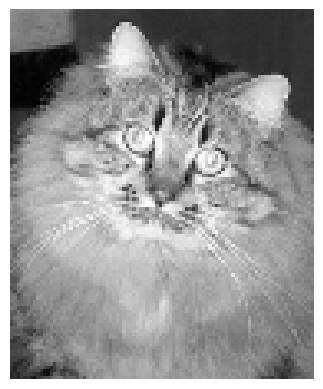

Failure Case
301
Predicted face but actual is non face


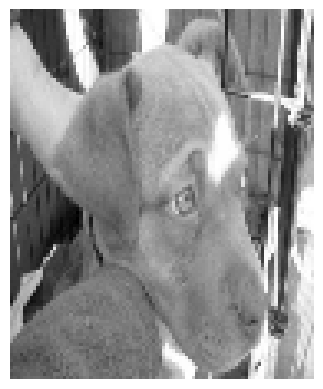

Failure Case
302
Predicted face but actual is non face


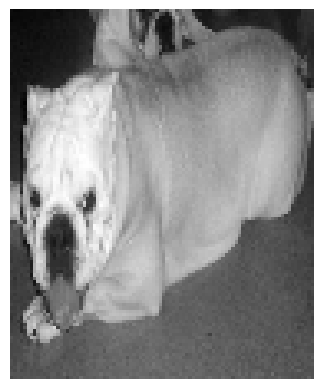

Failure Case
304
Predicted face but actual is non face


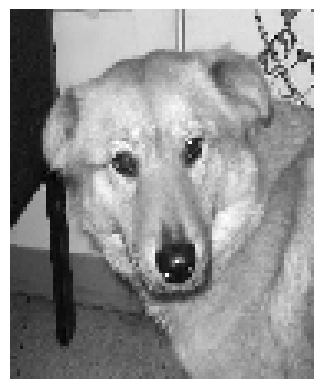

Failure Case
307
Predicted face but actual is non face


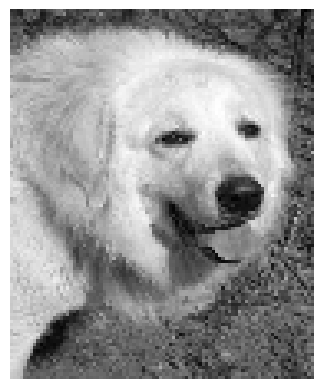

Failure Case
310
Predicted face but actual is non face


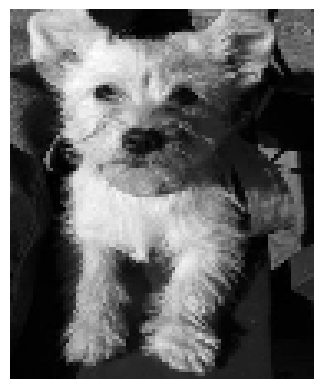

Failure Case
313
Predicted face but actual is non face


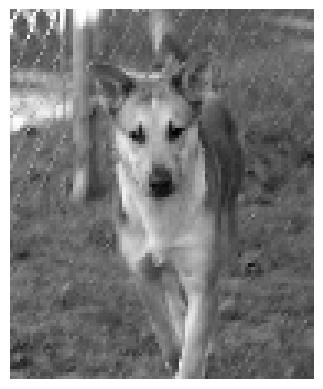

Failure Case
315
Predicted face but actual is non face


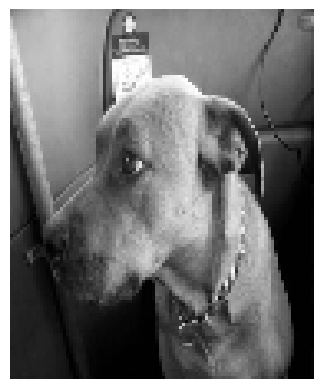

Failure Case
319
Predicted face but actual is non face


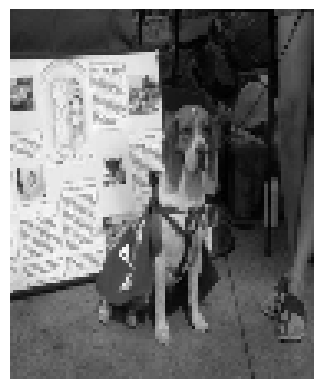

Failure Case
322
Predicted face but actual is non face


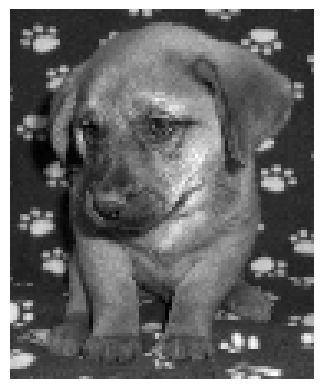

Failure Case
325
Predicted face but actual is non face


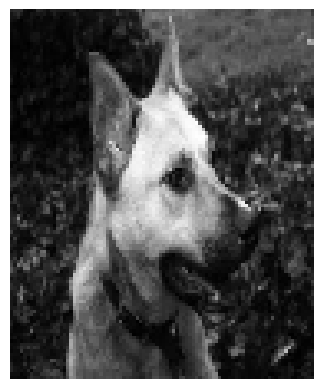

Failure Case
326
Predicted face but actual is non face


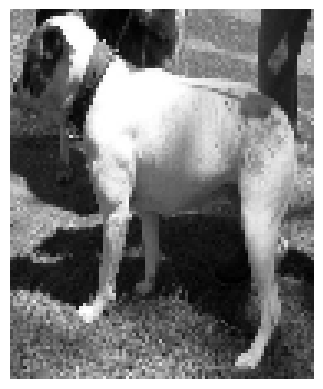

Failure Case
328
Predicted face but actual is non face


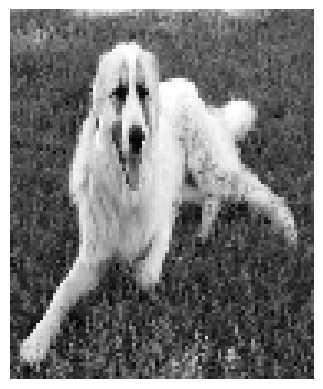

Failure Case
332
Predicted face but actual is non face


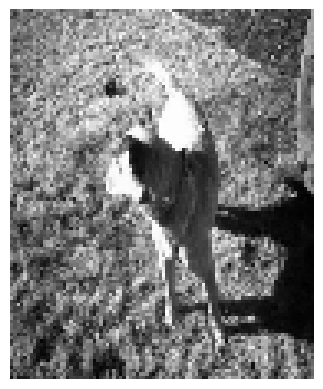

Failure Case
333
Predicted face but actual is non face


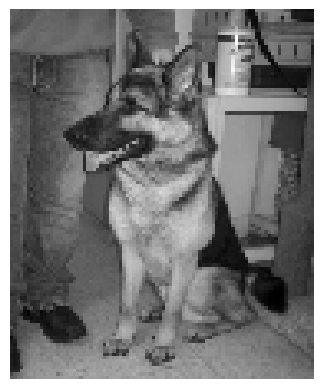

Failure Case
335
Predicted face but actual is non face


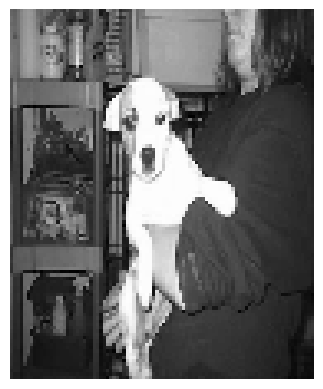

Failure Case
339
Predicted face but actual is non face


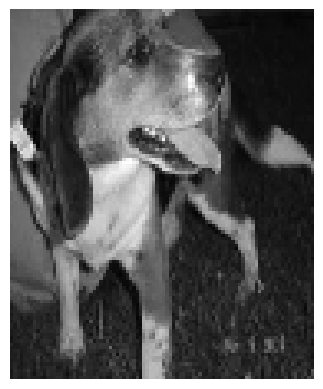

Failure Case
346
Predicted face but actual is non face


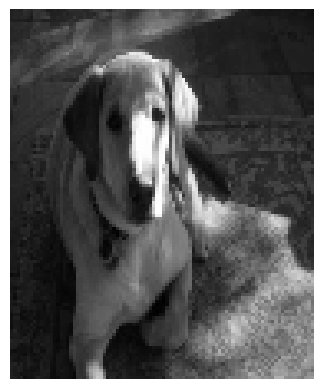

Failure Case
348
Predicted face but actual is non face


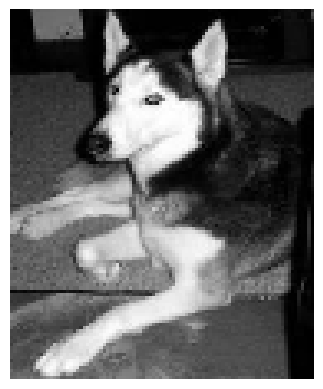

Failure Case
351
Predicted face but actual is non face


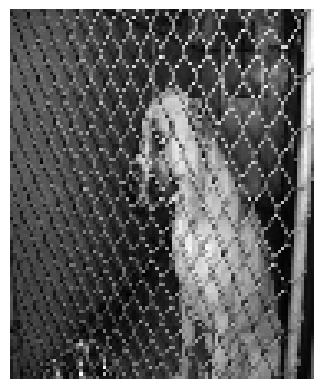

Failure Case
356
Predicted face but actual is non face


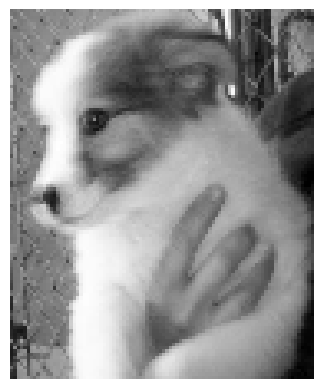

Failure Case
359
Predicted face but actual is non face


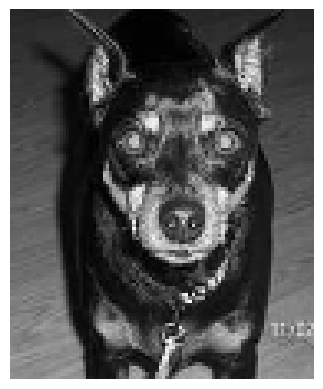

Failure Case
362
Predicted face but actual is non face


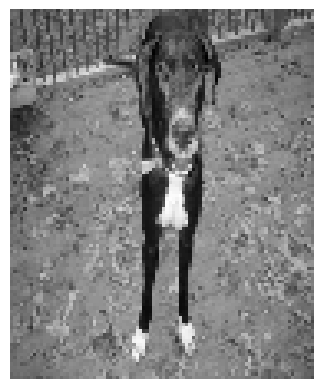

Failure Case
363
Predicted face but actual is non face


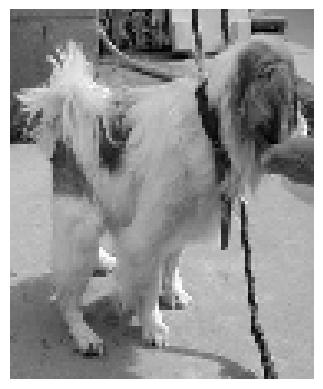

Failure Case
365
Predicted face but actual is non face


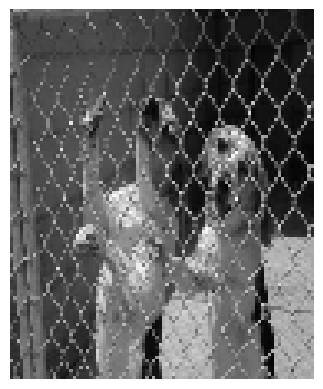

Failure Case
366
Predicted face but actual is non face


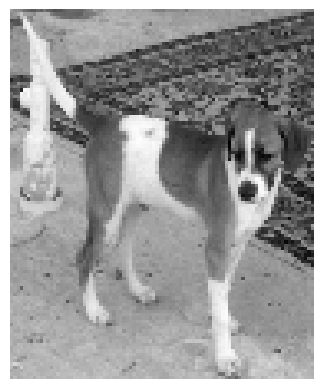

Failure Case
367
Predicted face but actual is non face


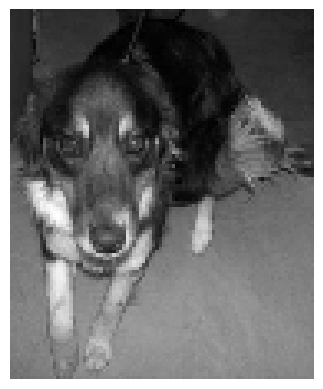

Failure Case
368
Predicted face but actual is non face


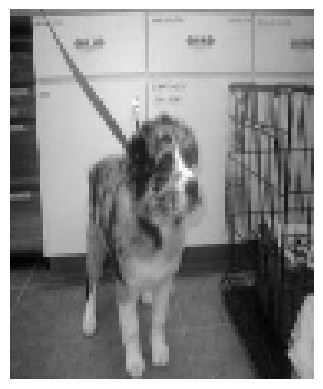

Failure Case
369
Predicted face but actual is non face


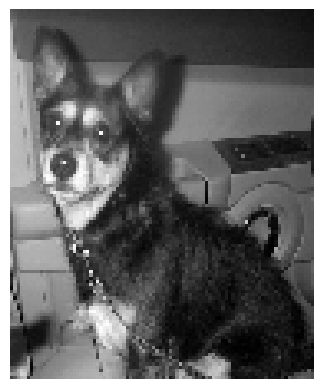

Failure Case
372
Predicted face but actual is non face


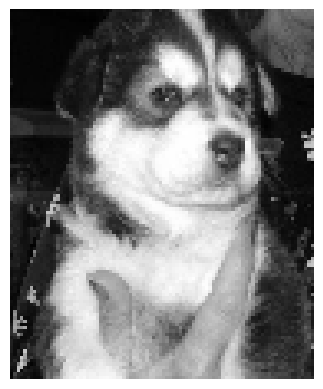

Failure Case
376
Predicted face but actual is non face


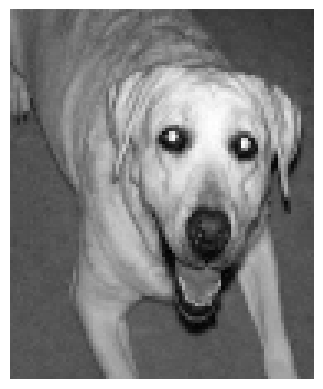

Failure Case
378
Predicted face but actual is non face


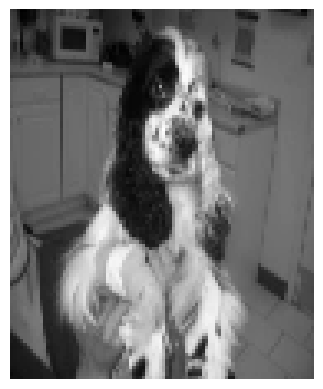

Failure Case
379
Predicted face but actual is non face


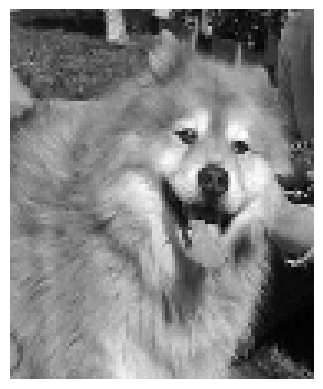

Failure Case
382
Predicted face but actual is non face


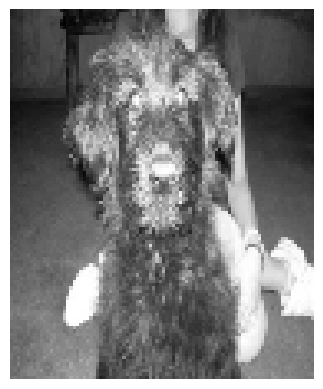

Failure Case
384
Predicted face but actual is non face


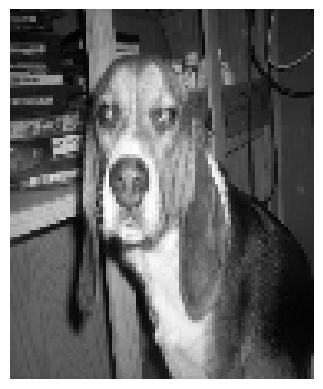

Failure Case
385
Predicted face but actual is non face


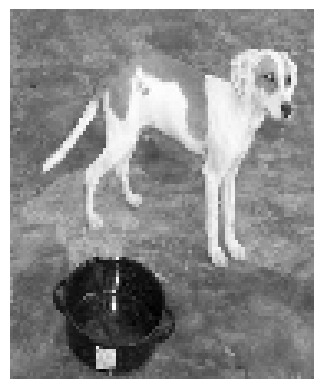

Failure Case
386
Predicted face but actual is non face


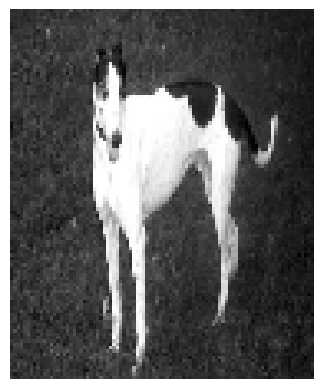

acc = 0.795
Done for k = 7



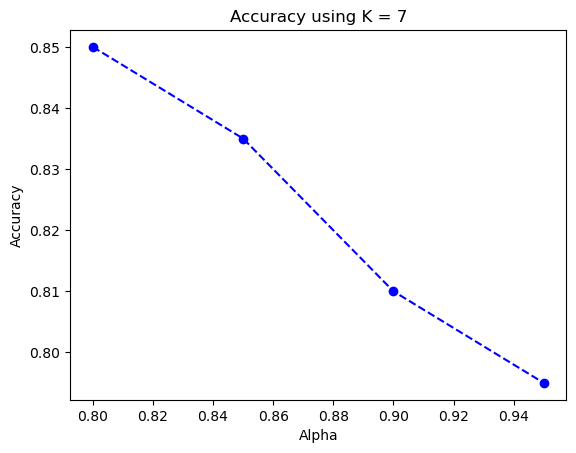

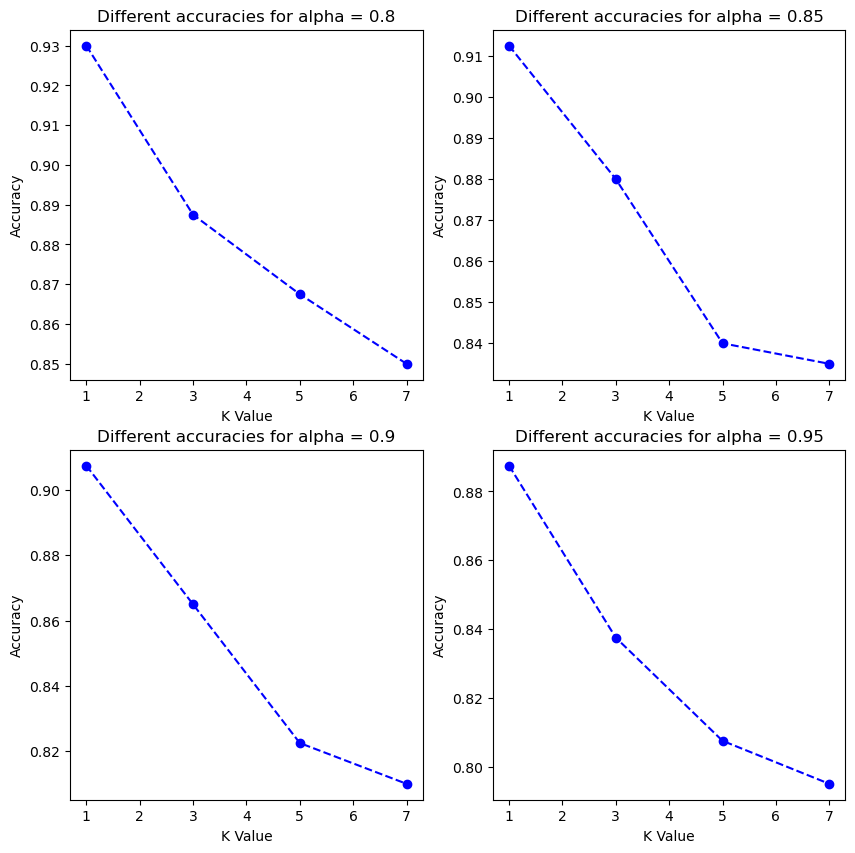

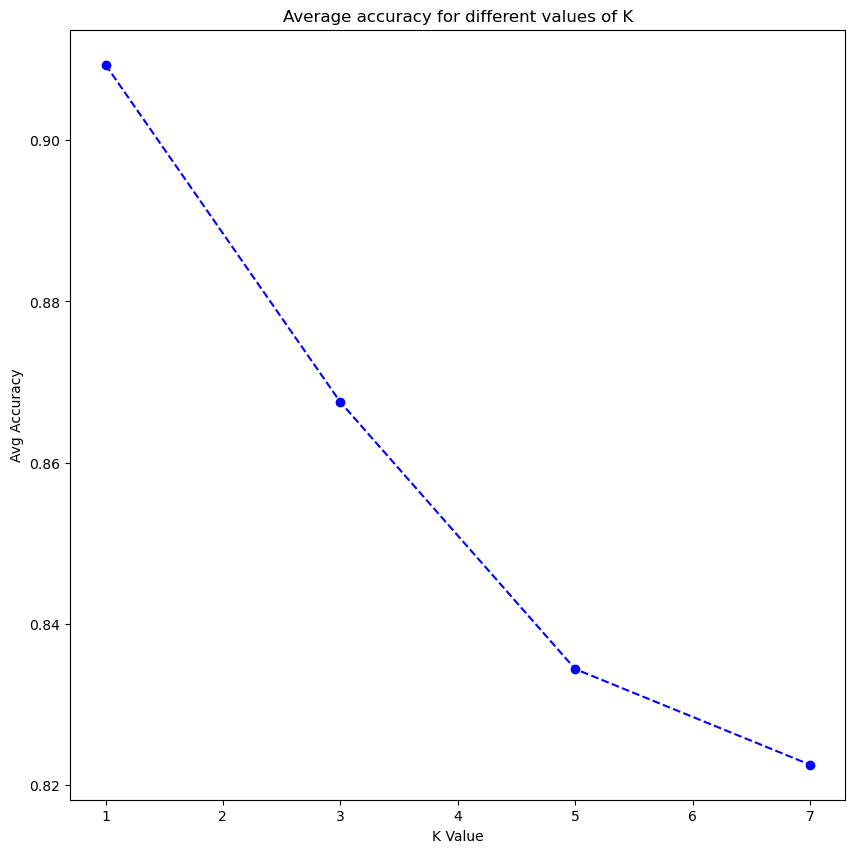

================LDA================
Number of samples in class 0 equal 200
Number of samples in class 1 equal 200
Accuracy using k = 1 = 0.81
CONFUSION MATRIX:
[[166  34]
 [ 42 158]]
Failure Case
12
Predicted non face but actual is face


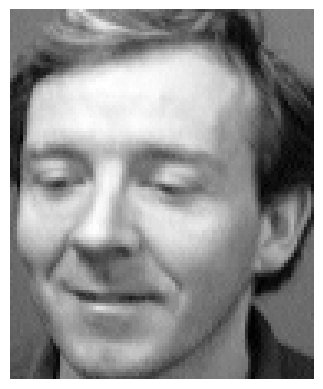

Failure Case
17
Predicted non face but actual is face


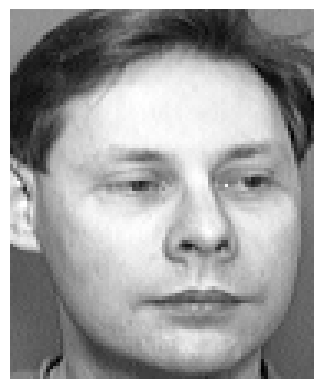

Failure Case
22
Predicted non face but actual is face


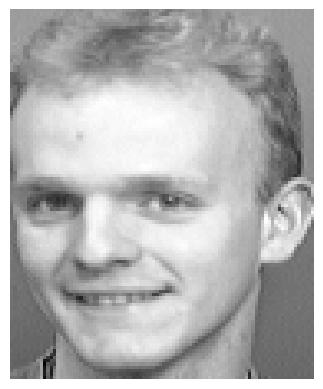

Failure Case
27
Predicted non face but actual is face


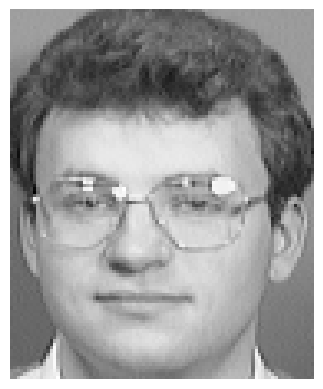

Failure Case
28
Predicted non face but actual is face


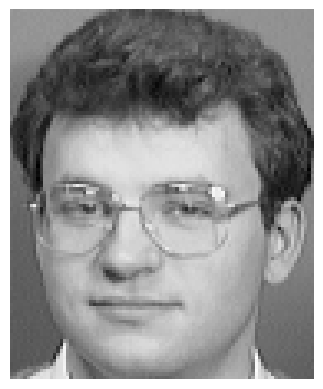

Failure Case
29
Predicted non face but actual is face


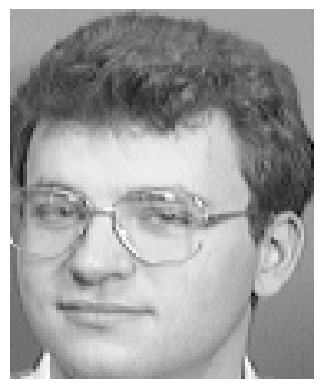

Failure Case
51
Predicted non face but actual is face


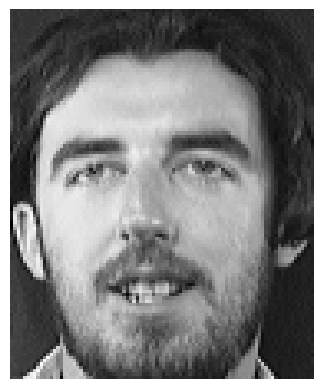

Failure Case
52
Predicted non face but actual is face


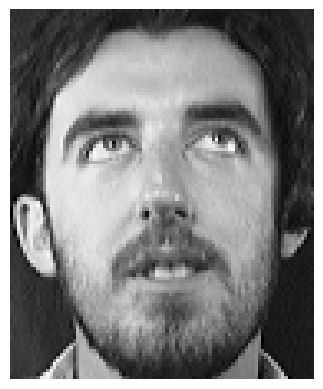

Failure Case
53
Predicted non face but actual is face


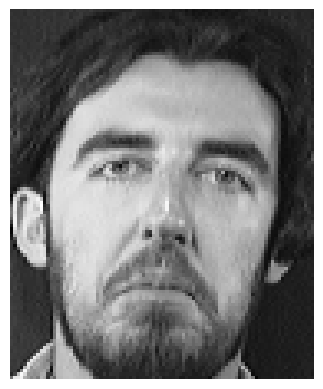

Failure Case
61
Predicted non face but actual is face


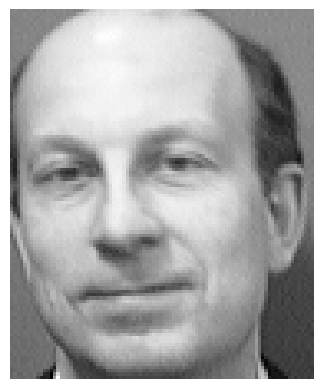

Failure Case
63
Predicted non face but actual is face


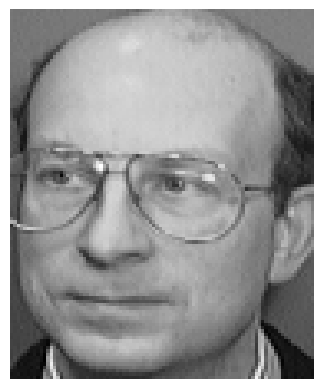

Failure Case
65
Predicted non face but actual is face


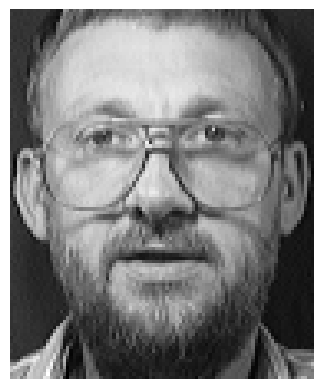

Failure Case
67
Predicted non face but actual is face


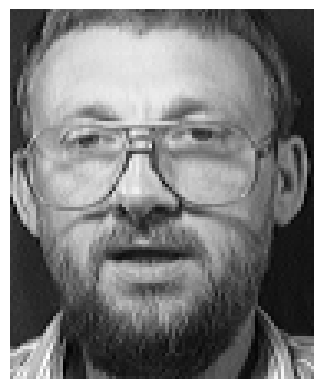

Failure Case
74
Predicted non face but actual is face


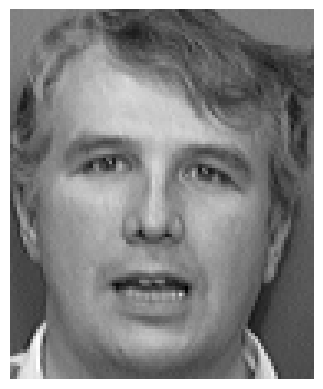

Failure Case
75
Predicted non face but actual is face


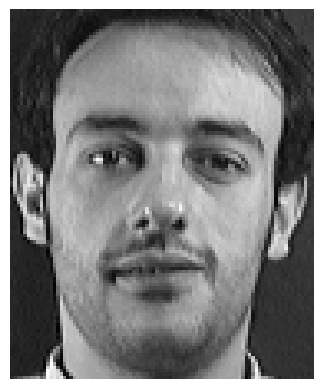

Failure Case
80
Predicted non face but actual is face


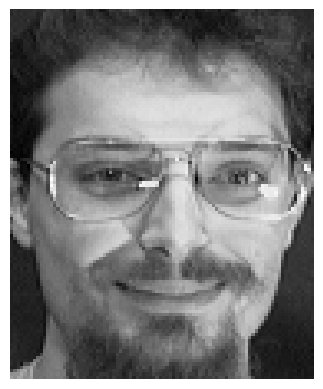

Failure Case
96
Predicted non face but actual is face


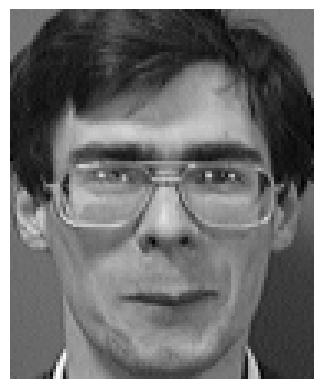

Failure Case
100
Predicted non face but actual is face


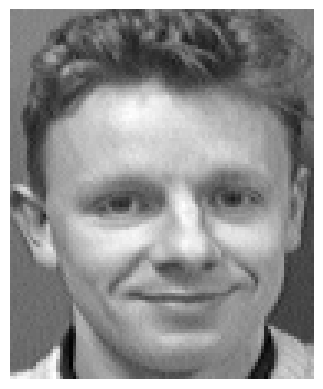

Failure Case
106
Predicted non face but actual is face


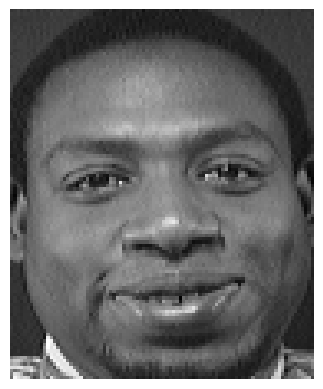

Failure Case
111
Predicted non face but actual is face


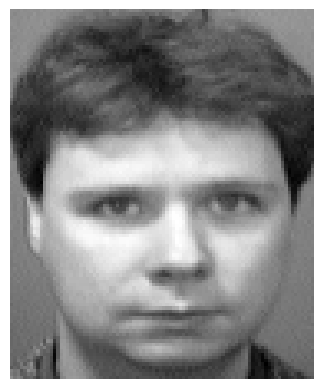

Failure Case
122
Predicted non face but actual is face


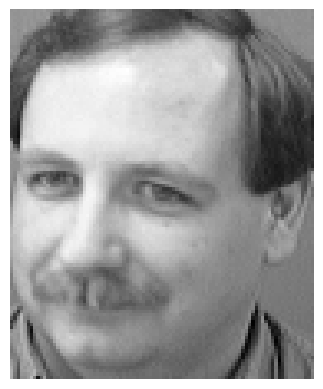

Failure Case
127
Predicted non face but actual is face


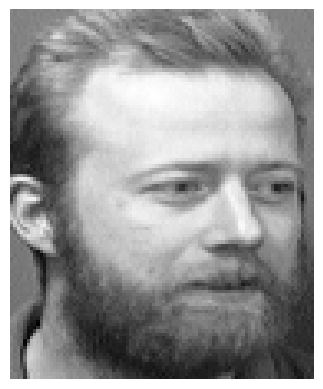

Failure Case
136
Predicted non face but actual is face


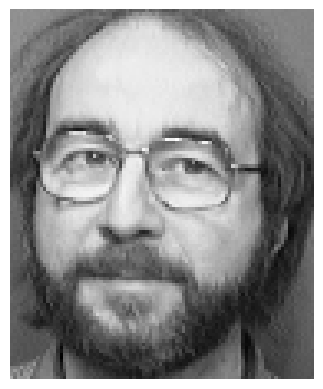

Failure Case
146
Predicted non face but actual is face


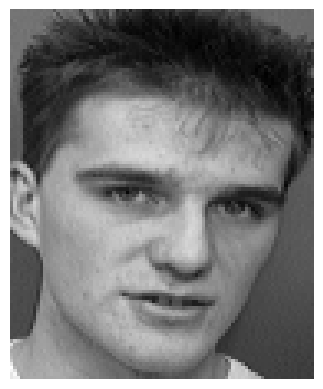

Failure Case
155
Predicted non face but actual is face


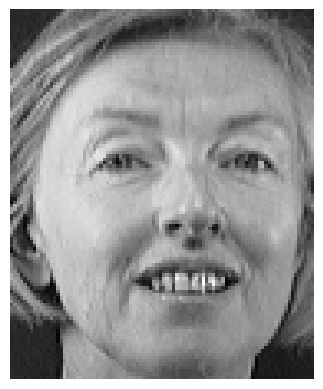

Failure Case
156
Predicted non face but actual is face


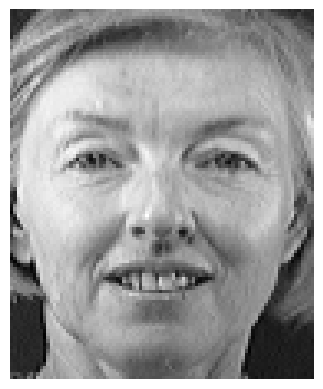

Failure Case
161
Predicted non face but actual is face


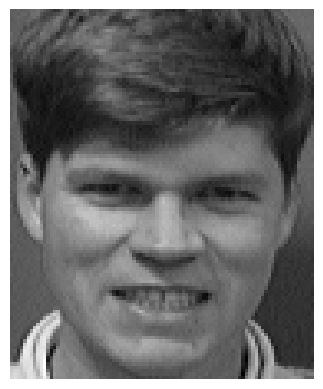

Failure Case
165
Predicted non face but actual is face


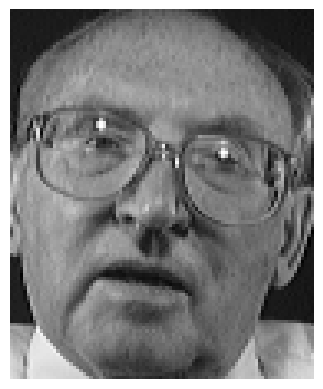

Failure Case
167
Predicted non face but actual is face


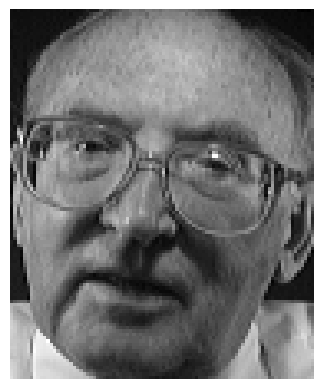

Failure Case
168
Predicted non face but actual is face


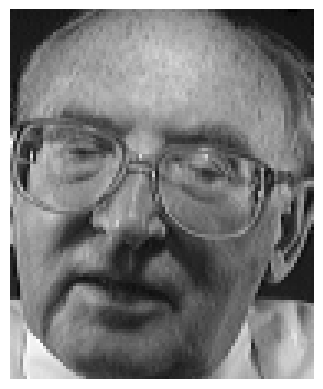

Failure Case
171
Predicted non face but actual is face


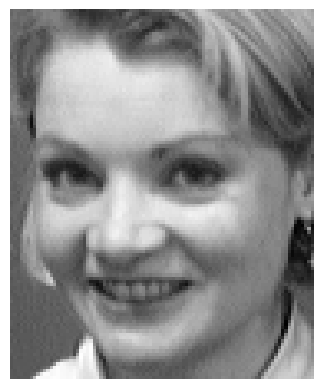

Failure Case
181
Predicted non face but actual is face


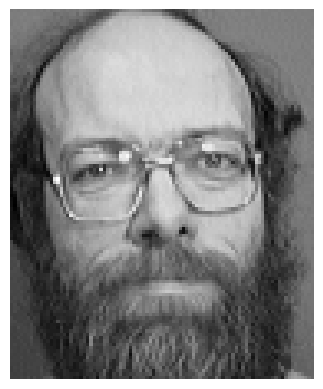

Failure Case
189
Predicted non face but actual is face


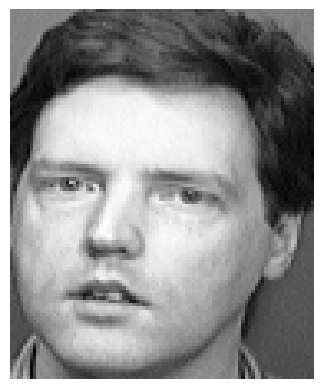

Failure Case
199
Predicted non face but actual is face


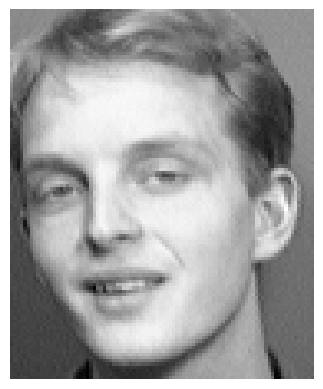

Failure Case
207
Predicted face but actual is non face


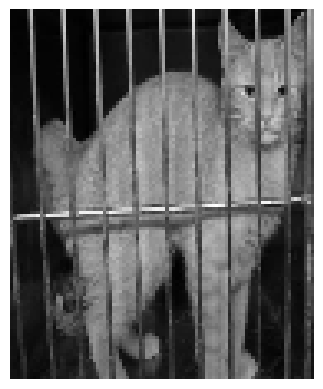

Failure Case
212
Predicted face but actual is non face


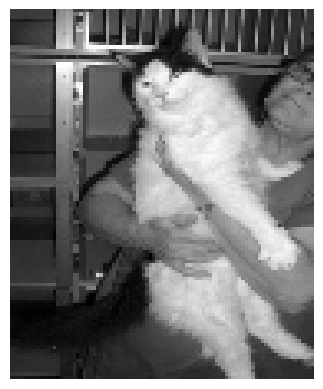

Failure Case
214
Predicted face but actual is non face


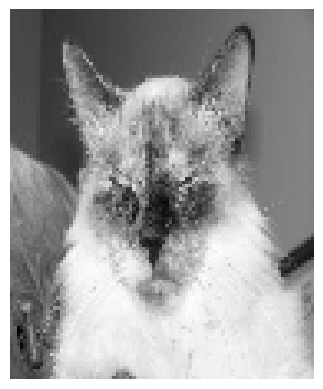

Failure Case
218
Predicted face but actual is non face


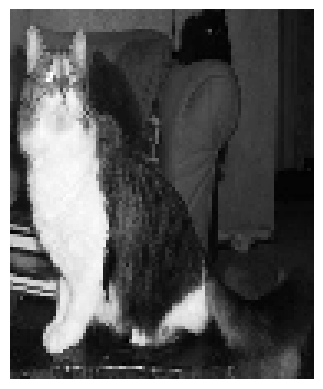

Failure Case
219
Predicted face but actual is non face


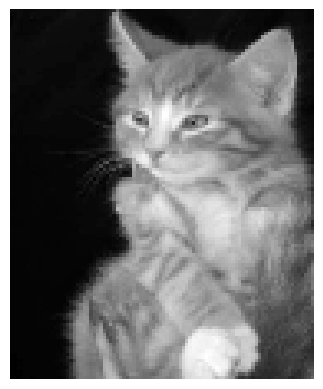

Failure Case
222
Predicted face but actual is non face


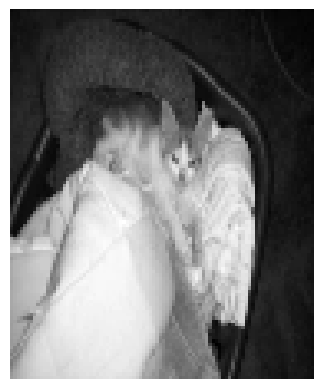

Failure Case
225
Predicted face but actual is non face


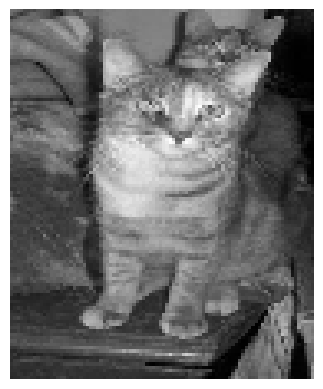

Failure Case
232
Predicted face but actual is non face


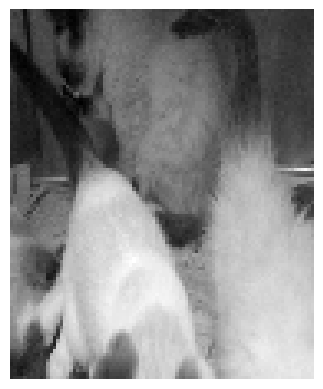

Failure Case
234
Predicted face but actual is non face


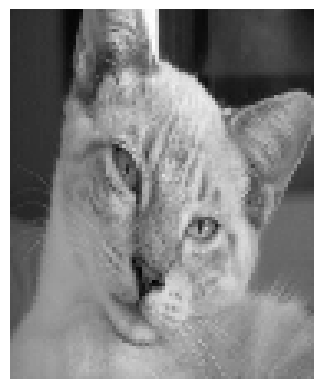

Failure Case
238
Predicted face but actual is non face


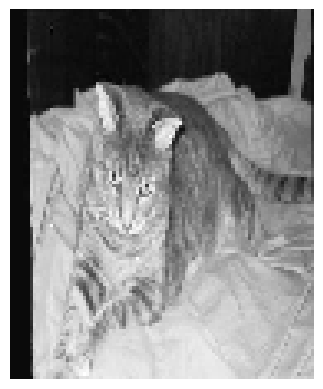

Failure Case
246
Predicted face but actual is non face


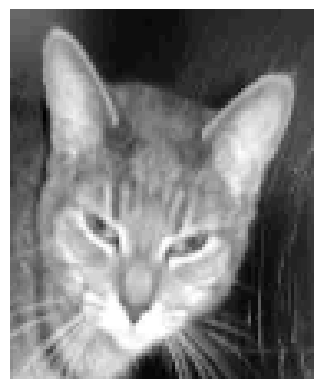

Failure Case
247
Predicted face but actual is non face


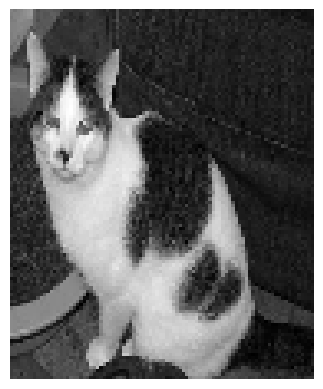

Failure Case
253
Predicted face but actual is non face


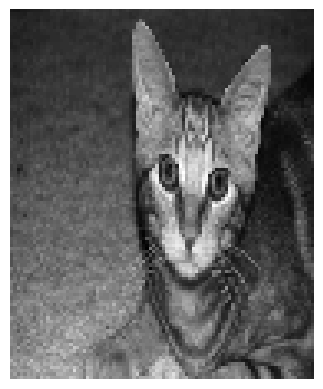

Failure Case
255
Predicted face but actual is non face


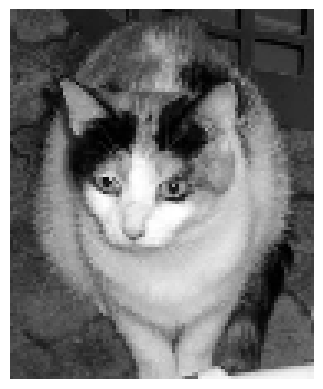

Failure Case
257
Predicted face but actual is non face


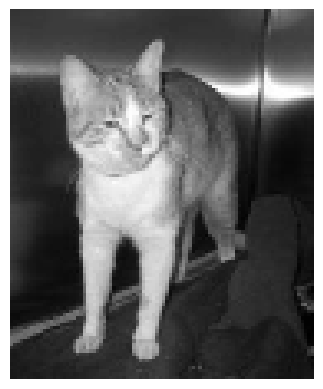

Failure Case
260
Predicted face but actual is non face


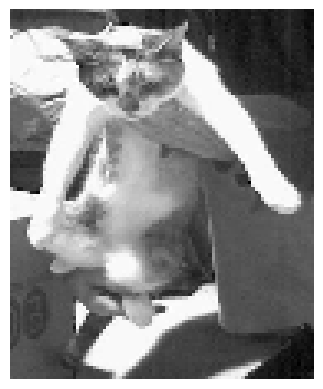

Failure Case
261
Predicted face but actual is non face


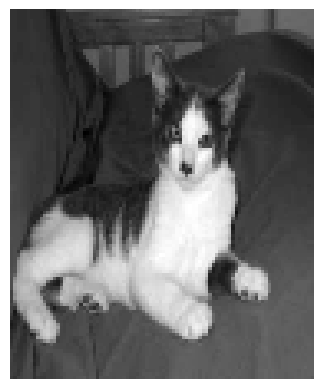

Failure Case
262
Predicted face but actual is non face


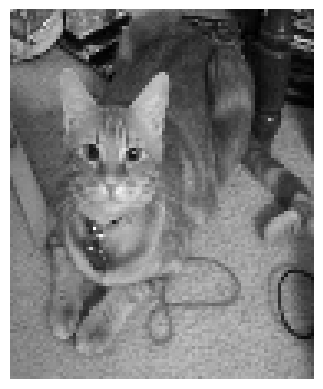

Failure Case
263
Predicted face but actual is non face


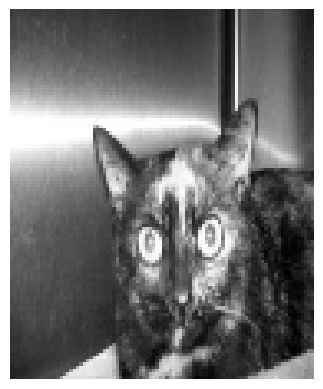

Failure Case
270
Predicted face but actual is non face


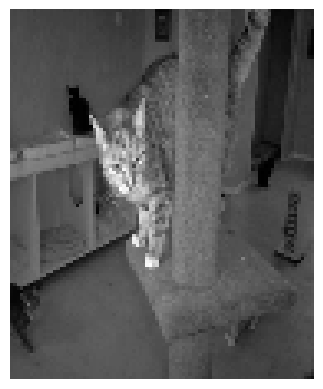

Failure Case
271
Predicted face but actual is non face


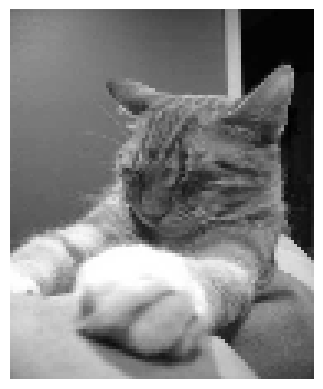

Failure Case
279
Predicted face but actual is non face


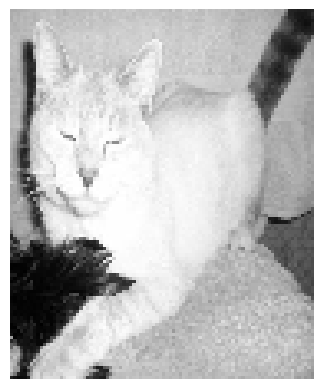

Failure Case
281
Predicted face but actual is non face


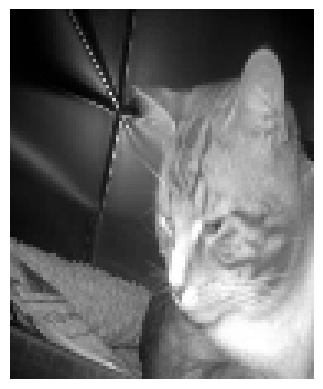

Failure Case
290
Predicted face but actual is non face


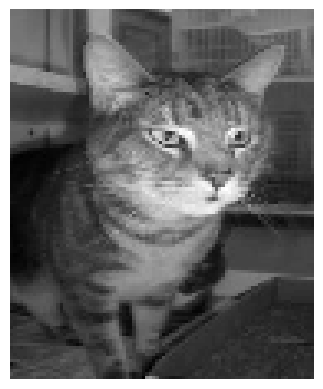

Failure Case
291
Predicted face but actual is non face


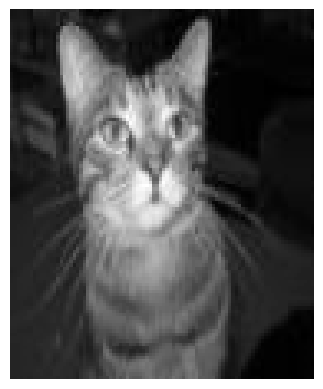

Failure Case
292
Predicted face but actual is non face


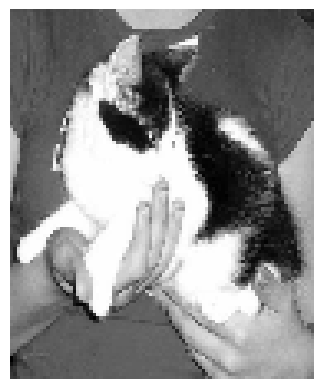

Failure Case
298
Predicted face but actual is non face


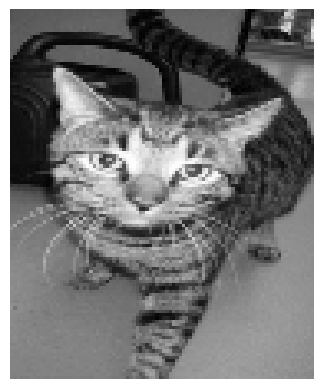

Failure Case
299
Predicted face but actual is non face


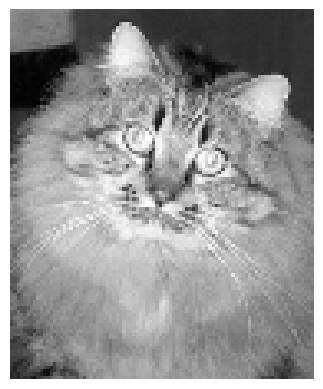

Failure Case
307
Predicted face but actual is non face


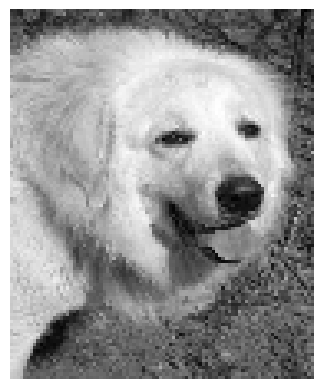

Failure Case
310
Predicted face but actual is non face


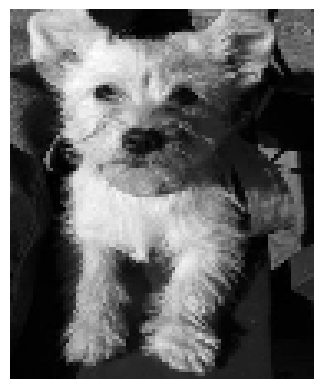

Failure Case
322
Predicted face but actual is non face


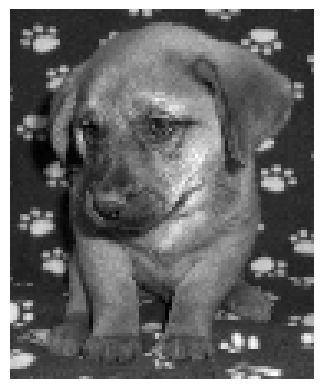

Failure Case
325
Predicted face but actual is non face


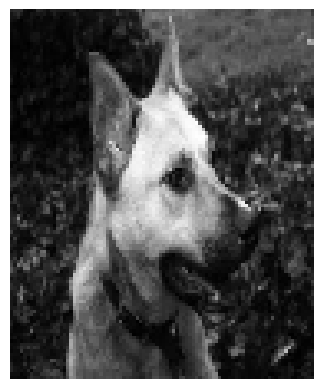

Failure Case
328
Predicted face but actual is non face


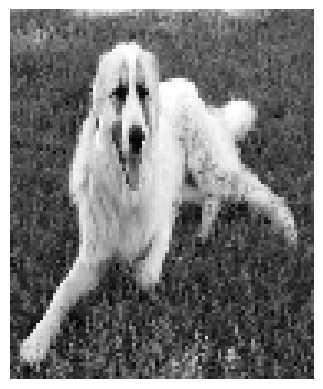

Failure Case
339
Predicted face but actual is non face


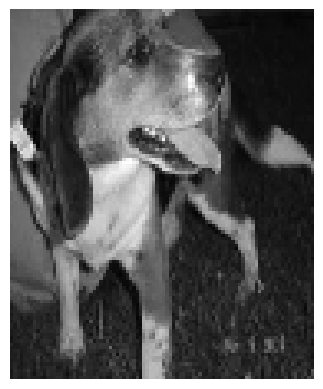

Failure Case
342
Predicted face but actual is non face


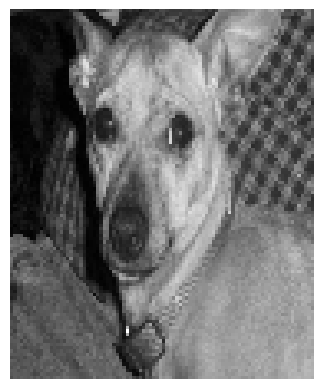

Failure Case
372
Predicted face but actual is non face


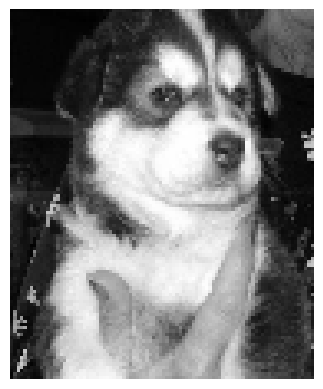

Failure Case
376
Predicted face but actual is non face


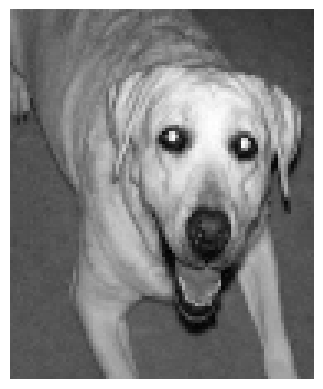

Failure Case
379
Predicted face but actual is non face


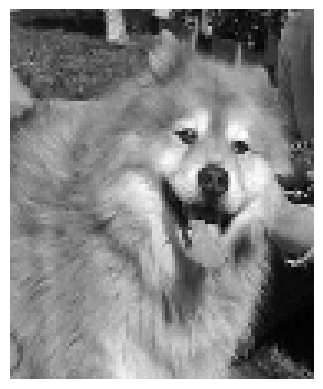

Failure Case
384
Predicted face but actual is non face


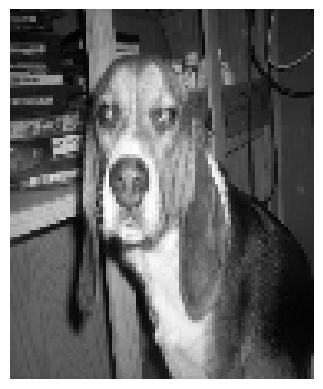

Failure Case
386
Predicted face but actual is non face


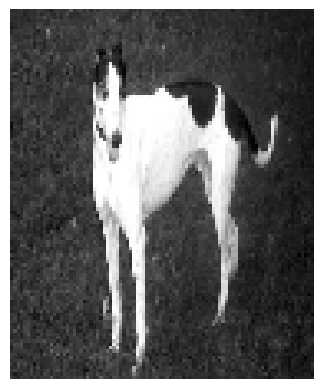

Failure Case
390
Predicted face but actual is non face


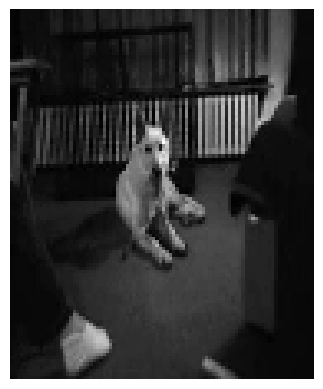

Failure Case
393
Predicted face but actual is non face


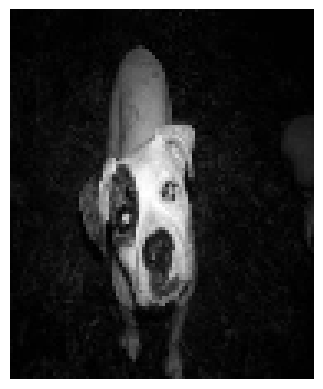

acc = 0.81
Accuracy using k = 3 = 0.81
CONFUSION MATRIX:
[[175  25]
 [ 51 149]]
Failure Case
2
Predicted non face but actual is face


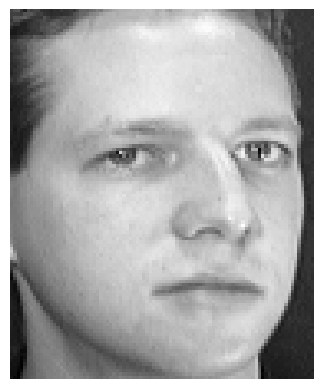

Failure Case
21
Predicted non face but actual is face


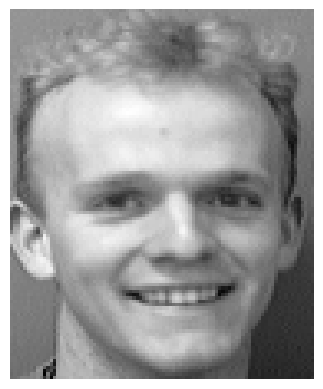

Failure Case
22
Predicted non face but actual is face


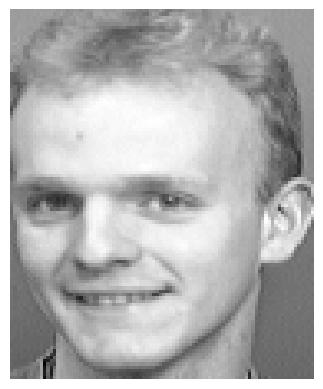

Failure Case
23
Predicted non face but actual is face


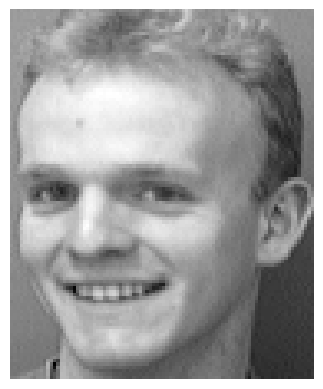

Failure Case
28
Predicted non face but actual is face


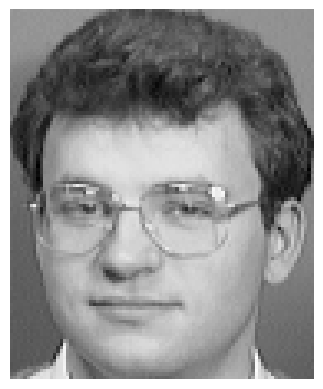

Failure Case
29
Predicted non face but actual is face


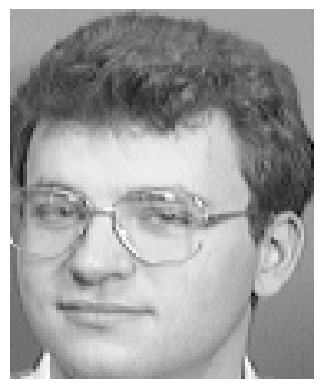

Failure Case
52
Predicted non face but actual is face


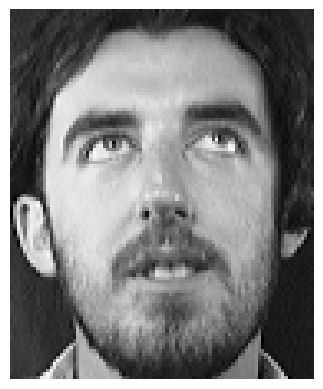

Failure Case
61
Predicted non face but actual is face


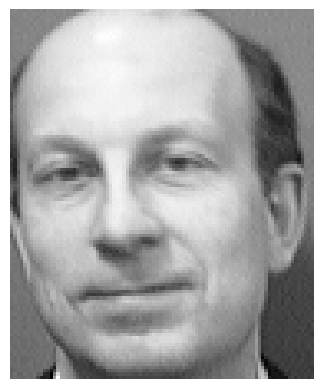

Failure Case
65
Predicted non face but actual is face


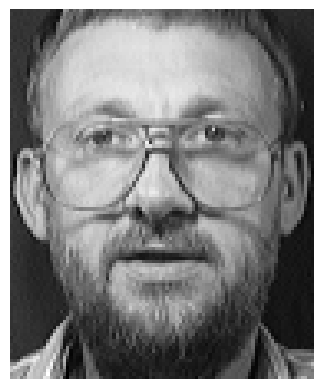

Failure Case
67
Predicted non face but actual is face


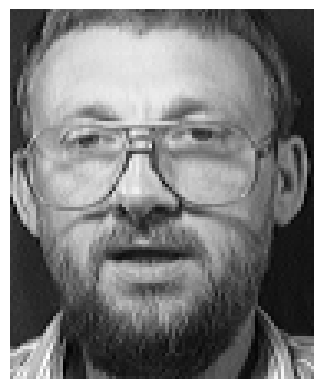

Failure Case
96
Predicted non face but actual is face


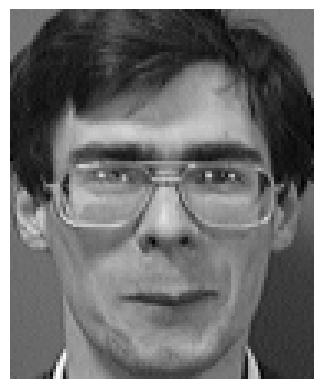

Failure Case
100
Predicted non face but actual is face


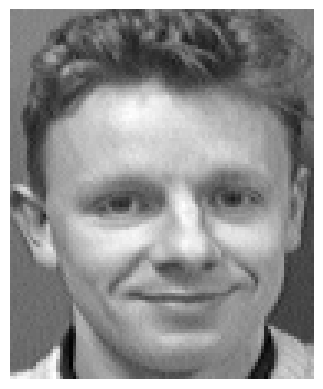

Failure Case
102
Predicted non face but actual is face


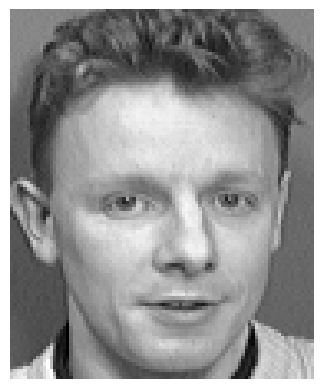

Failure Case
122
Predicted non face but actual is face


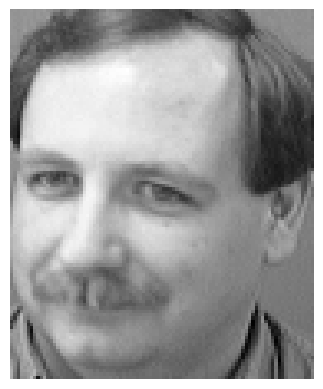

Failure Case
127
Predicted non face but actual is face


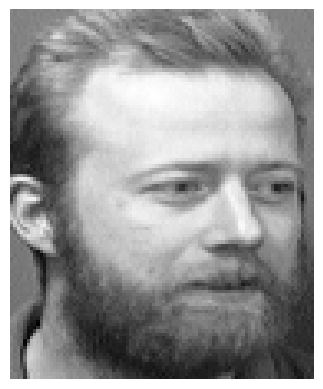

Failure Case
136
Predicted non face but actual is face


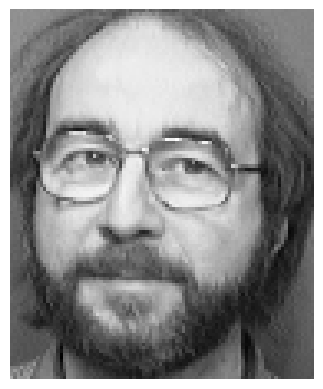

Failure Case
156
Predicted non face but actual is face


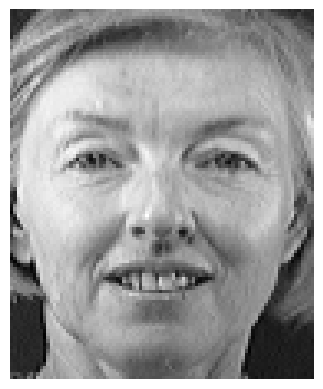

Failure Case
160
Predicted non face but actual is face


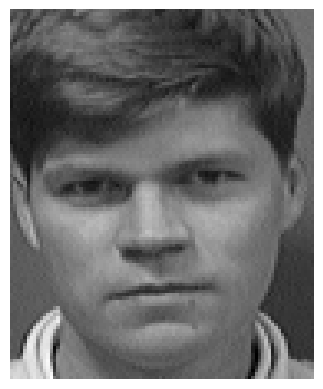

Failure Case
161
Predicted non face but actual is face


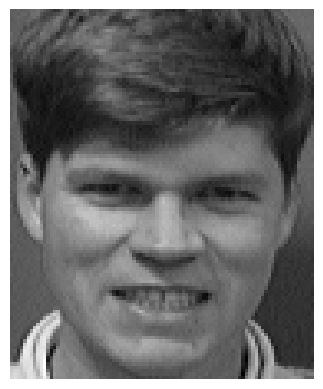

Failure Case
167
Predicted non face but actual is face


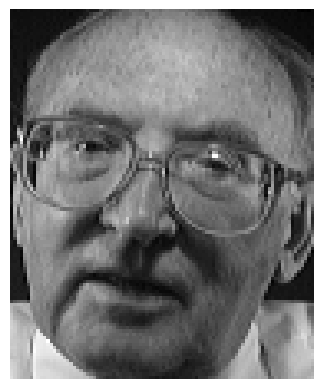

Failure Case
168
Predicted non face but actual is face


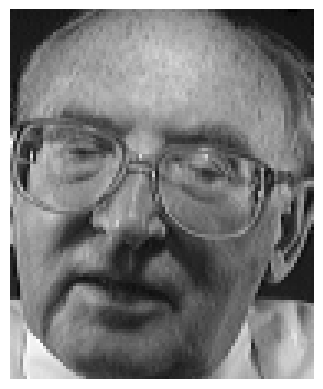

Failure Case
171
Predicted non face but actual is face


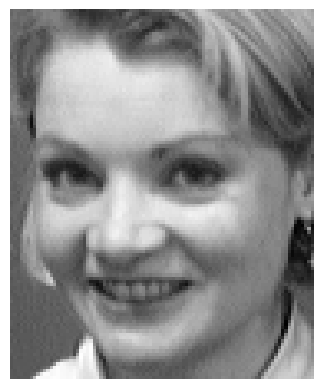

Failure Case
181
Predicted non face but actual is face


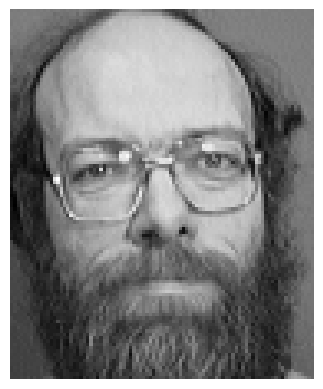

Failure Case
189
Predicted non face but actual is face


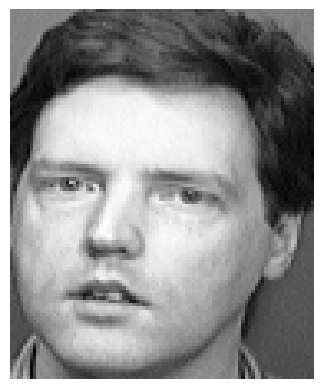

Failure Case
199
Predicted non face but actual is face


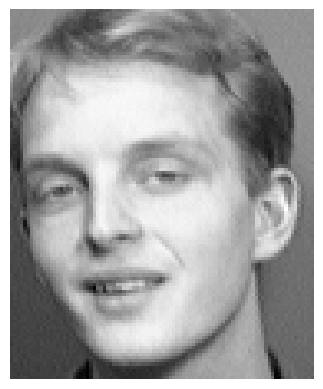

Failure Case
204
Predicted face but actual is non face


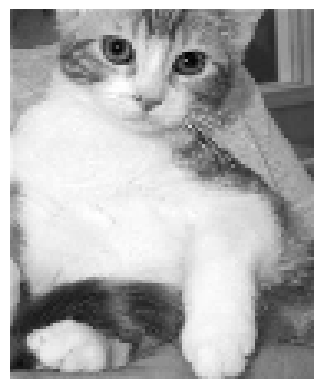

Failure Case
207
Predicted face but actual is non face


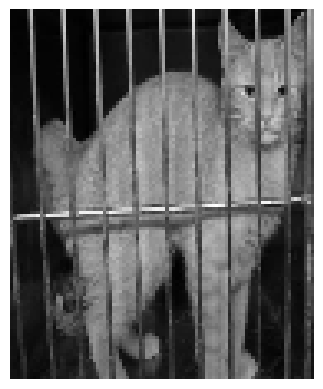

Failure Case
212
Predicted face but actual is non face


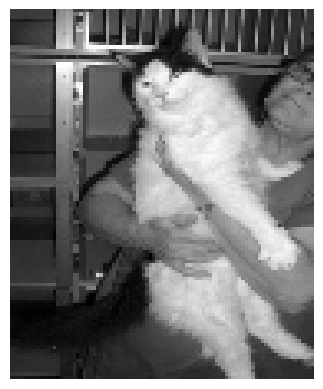

Failure Case
214
Predicted face but actual is non face


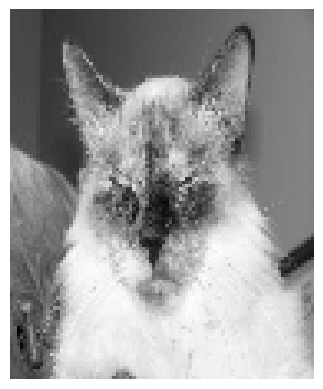

Failure Case
218
Predicted face but actual is non face


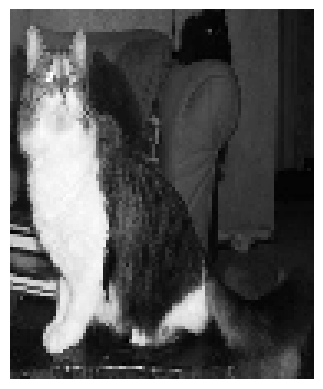

Failure Case
219
Predicted face but actual is non face


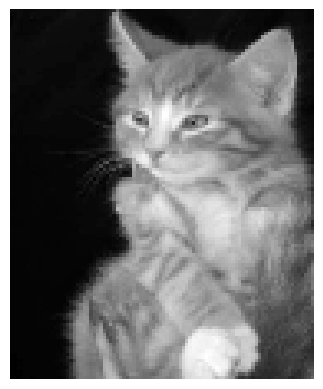

Failure Case
222
Predicted face but actual is non face


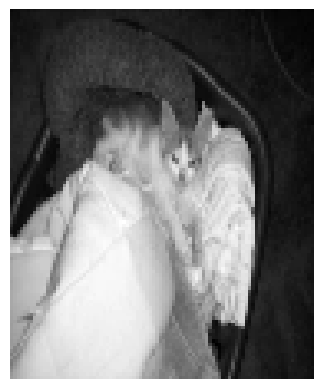

Failure Case
224
Predicted face but actual is non face


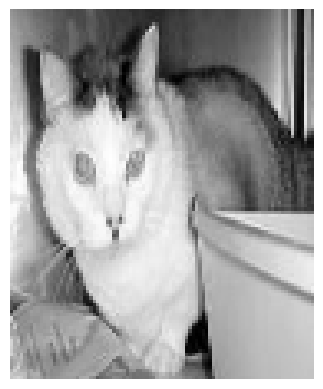

Failure Case
225
Predicted face but actual is non face


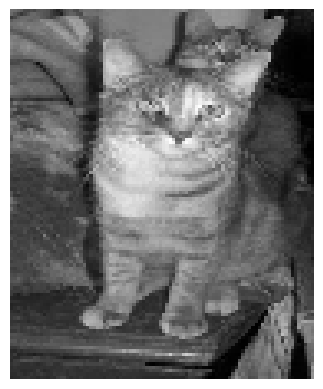

Failure Case
232
Predicted face but actual is non face


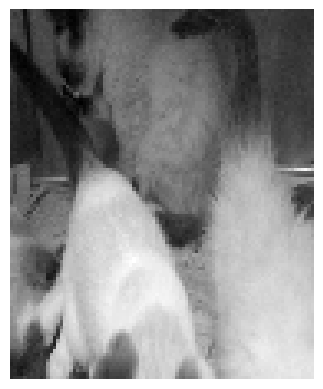

Failure Case
234
Predicted face but actual is non face


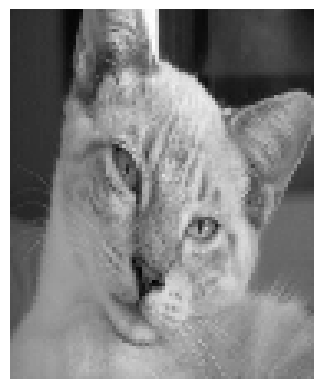

Failure Case
238
Predicted face but actual is non face


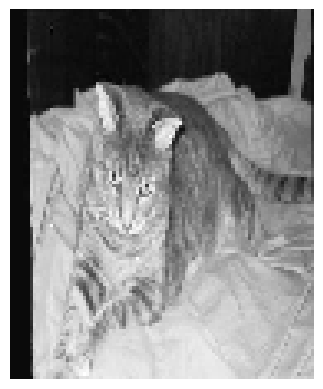

Failure Case
240
Predicted face but actual is non face


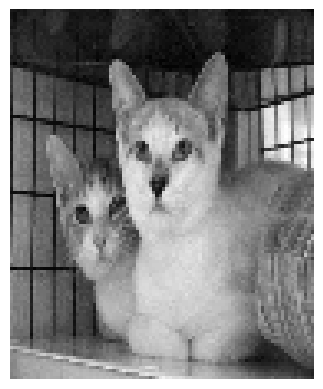

Failure Case
247
Predicted face but actual is non face


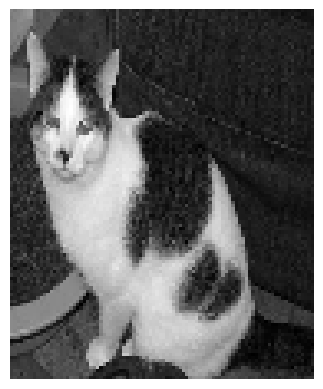

Failure Case
253
Predicted face but actual is non face


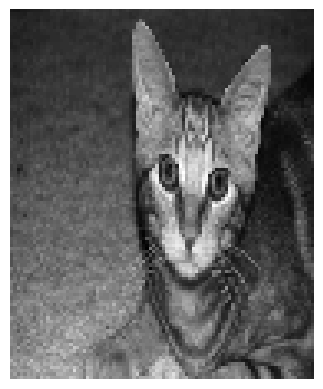

Failure Case
257
Predicted face but actual is non face


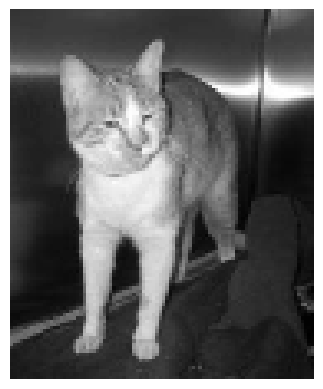

Failure Case
260
Predicted face but actual is non face


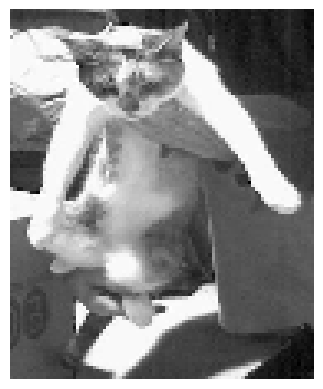

Failure Case
261
Predicted face but actual is non face


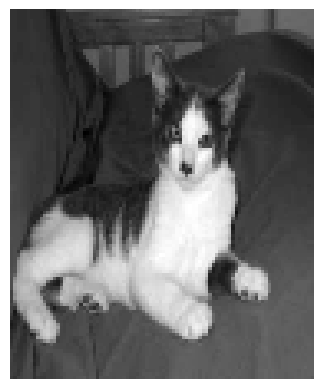

Failure Case
262
Predicted face but actual is non face


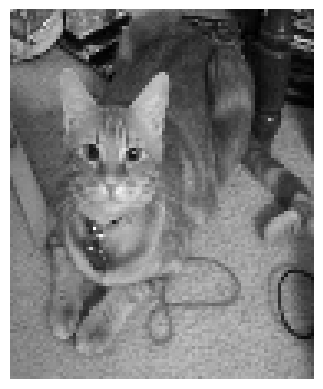

Failure Case
263
Predicted face but actual is non face


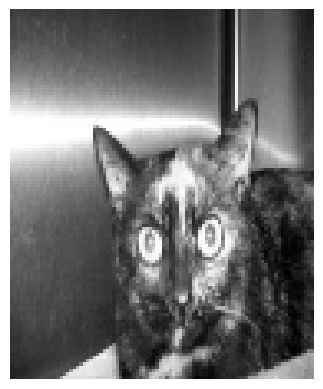

Failure Case
264
Predicted face but actual is non face


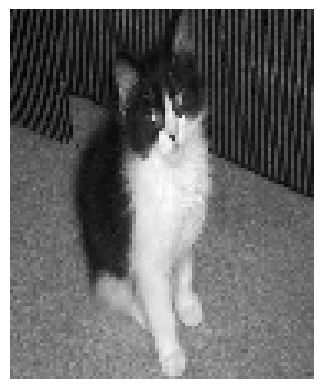

Failure Case
270
Predicted face but actual is non face


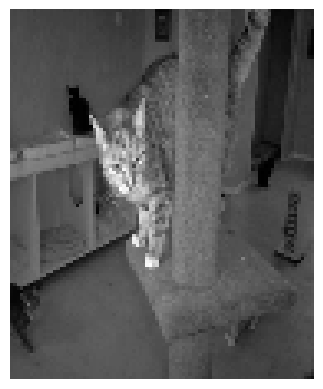

Failure Case
271
Predicted face but actual is non face


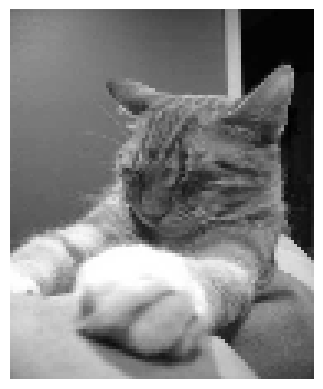

Failure Case
275
Predicted face but actual is non face


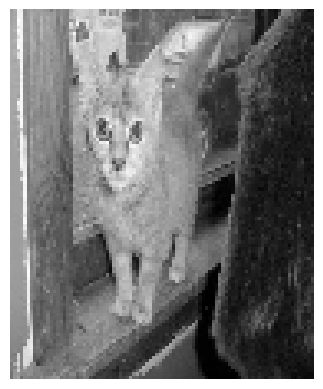

Failure Case
278
Predicted face but actual is non face


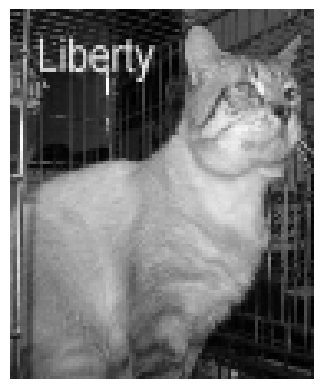

Failure Case
279
Predicted face but actual is non face


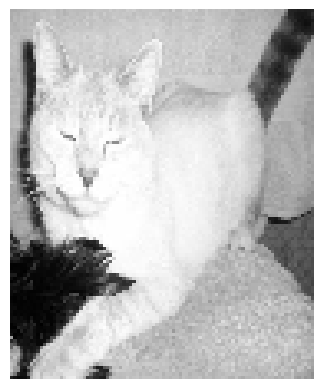

Failure Case
281
Predicted face but actual is non face


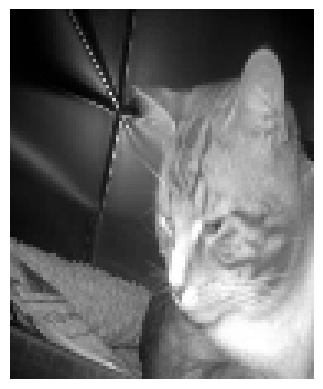

Failure Case
291
Predicted face but actual is non face


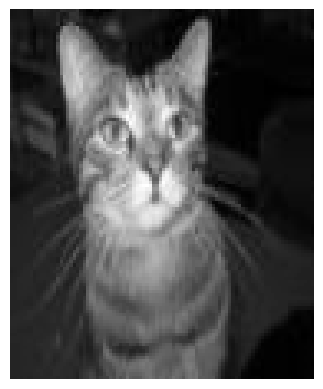

Failure Case
292
Predicted face but actual is non face


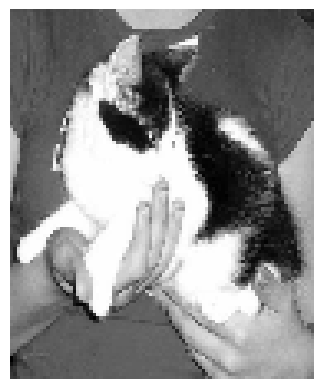

Failure Case
298
Predicted face but actual is non face


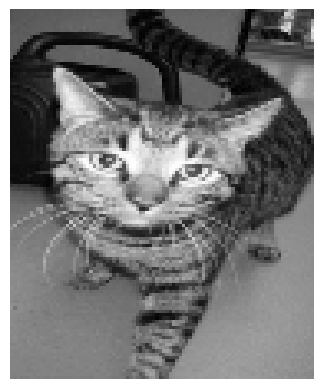

Failure Case
299
Predicted face but actual is non face


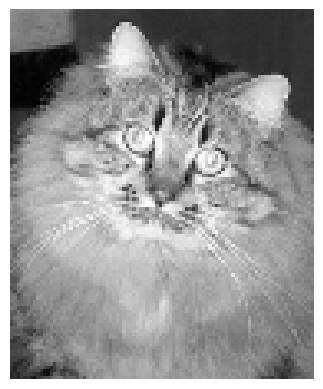

Failure Case
302
Predicted face but actual is non face


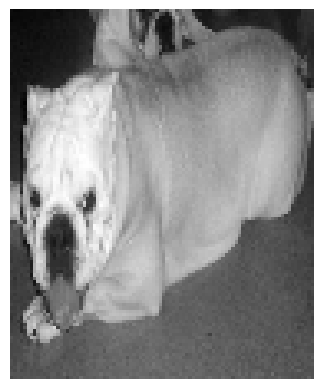

Failure Case
307
Predicted face but actual is non face


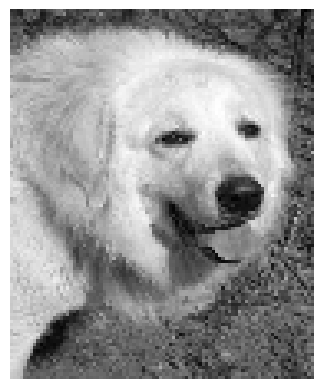

Failure Case
310
Predicted face but actual is non face


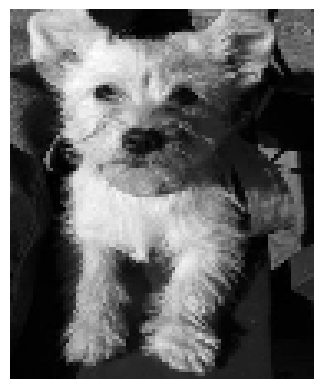

Failure Case
322
Predicted face but actual is non face


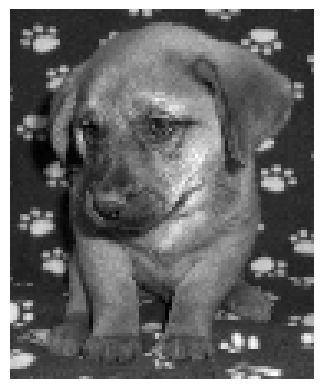

Failure Case
325
Predicted face but actual is non face


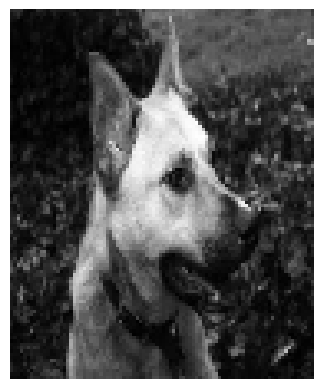

Failure Case
326
Predicted face but actual is non face


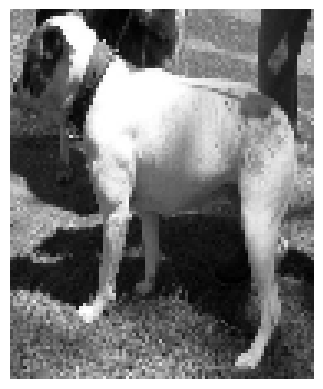

Failure Case
335
Predicted face but actual is non face


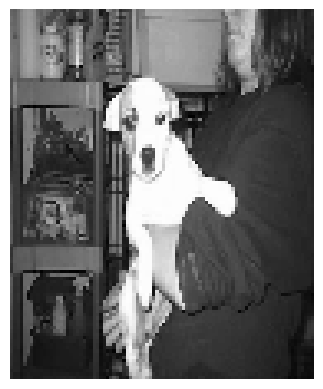

Failure Case
339
Predicted face but actual is non face


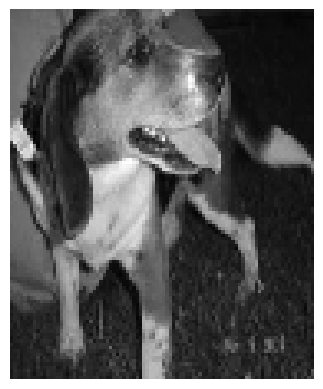

Failure Case
342
Predicted face but actual is non face


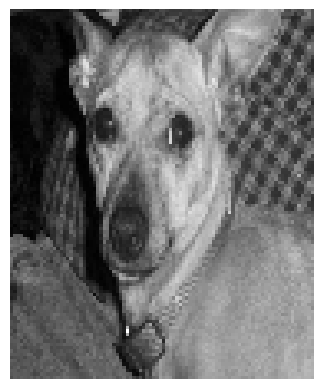

Failure Case
346
Predicted face but actual is non face


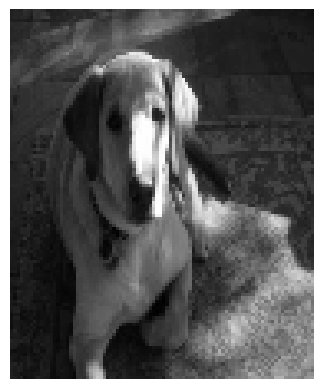

Failure Case
348
Predicted face but actual is non face


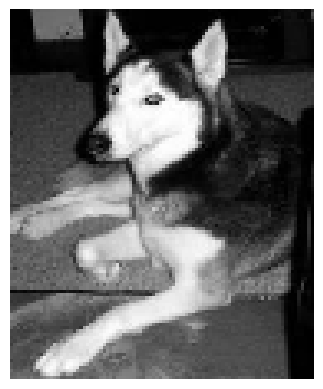

Failure Case
365
Predicted face but actual is non face


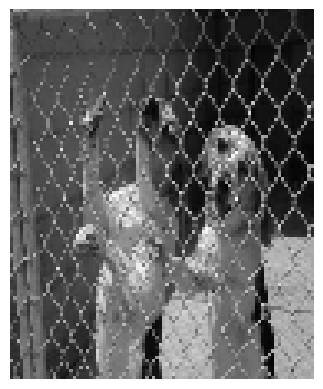

Failure Case
372
Predicted face but actual is non face


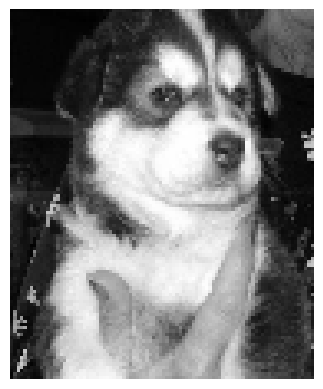

Failure Case
376
Predicted face but actual is non face


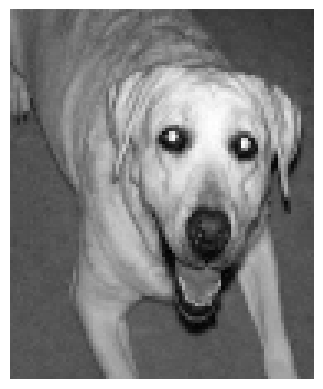

Failure Case
379
Predicted face but actual is non face


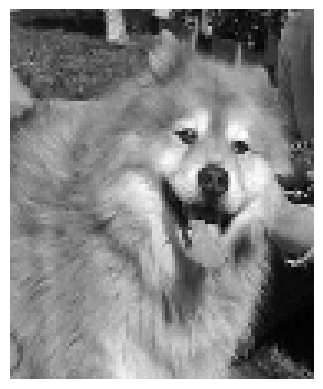

Failure Case
382
Predicted face but actual is non face


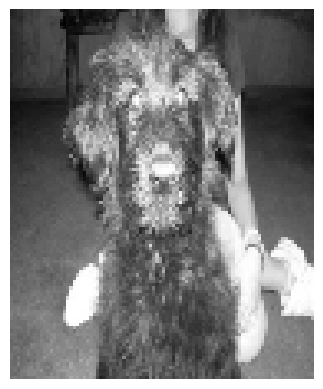

Failure Case
384
Predicted face but actual is non face


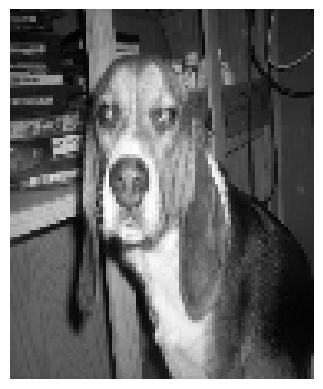

Failure Case
386
Predicted face but actual is non face


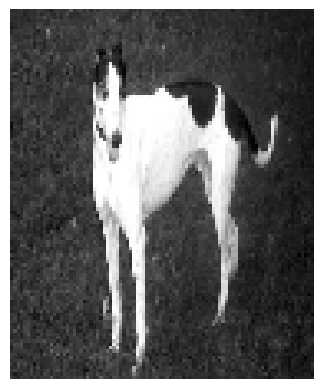

Failure Case
390
Predicted face but actual is non face


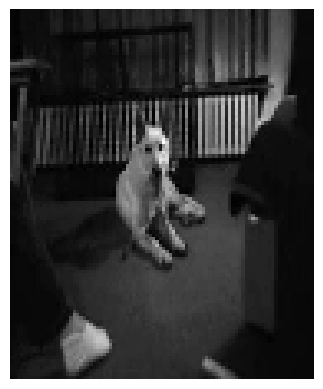

Failure Case
393
Predicted face but actual is non face


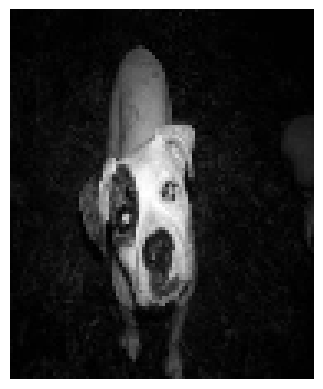

acc = 0.81
Accuracy using k = 5 = 0.83
CONFUSION MATRIX:
[[180  20]
 [ 48 152]]
Failure Case
2
Predicted non face but actual is face


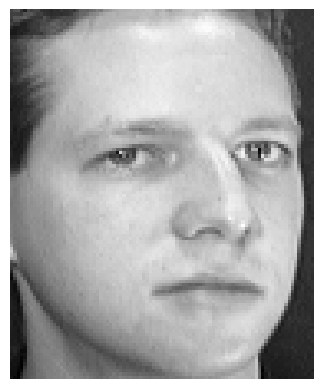

Failure Case
22
Predicted non face but actual is face


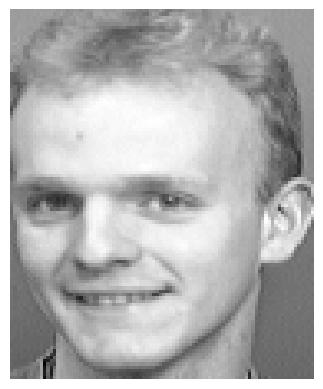

Failure Case
23
Predicted non face but actual is face


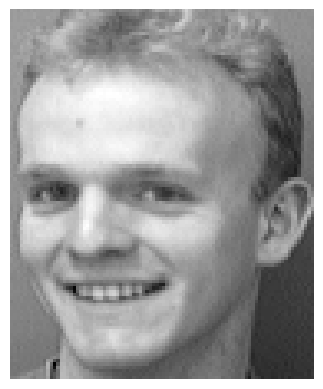

Failure Case
28
Predicted non face but actual is face


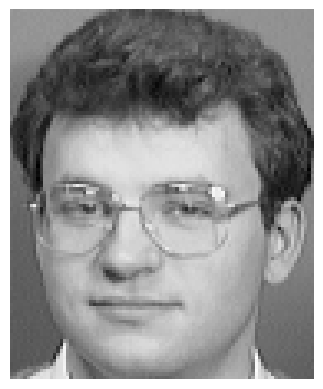

Failure Case
29
Predicted non face but actual is face


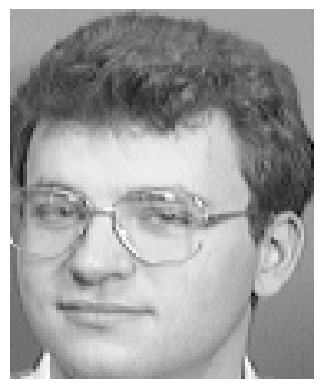

Failure Case
52
Predicted non face but actual is face


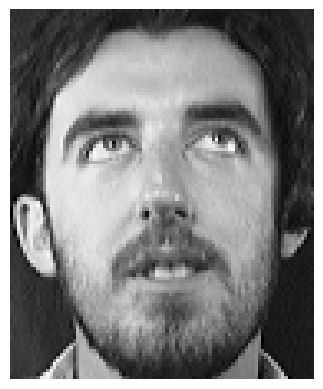

Failure Case
61
Predicted non face but actual is face


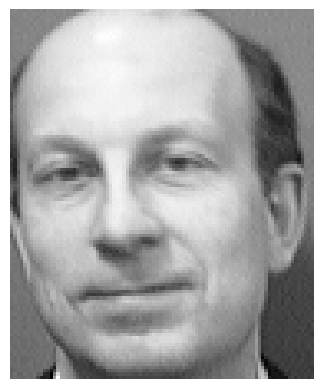

Failure Case
63
Predicted non face but actual is face


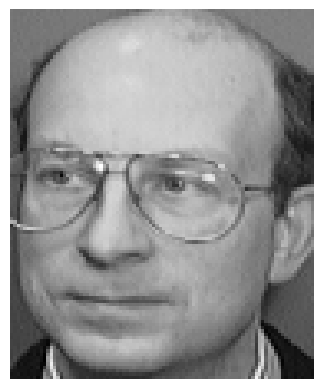

Failure Case
65
Predicted non face but actual is face


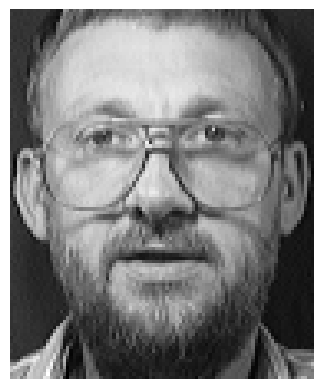

Failure Case
67
Predicted non face but actual is face


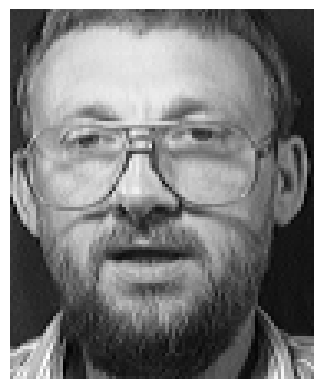

Failure Case
100
Predicted non face but actual is face


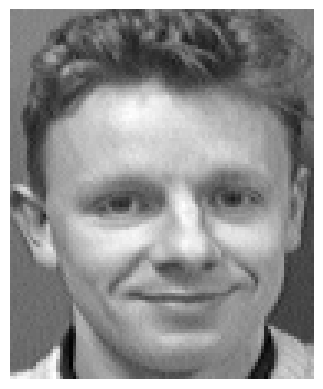

Failure Case
136
Predicted non face but actual is face


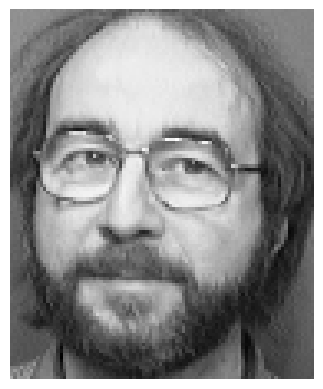

Failure Case
152
Predicted non face but actual is face


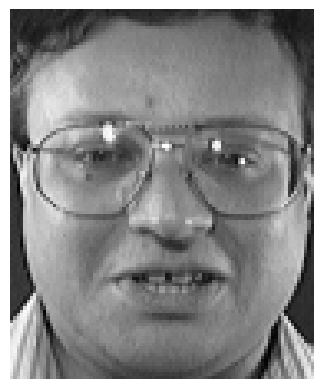

Failure Case
156
Predicted non face but actual is face


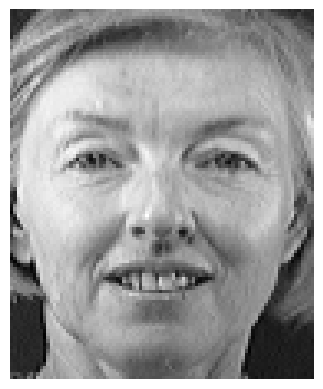

Failure Case
166
Predicted non face but actual is face


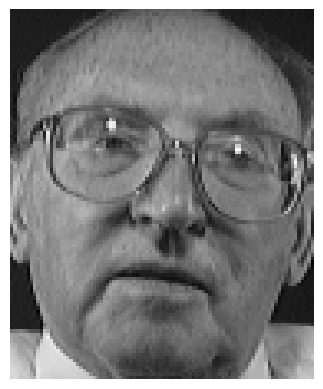

Failure Case
167
Predicted non face but actual is face


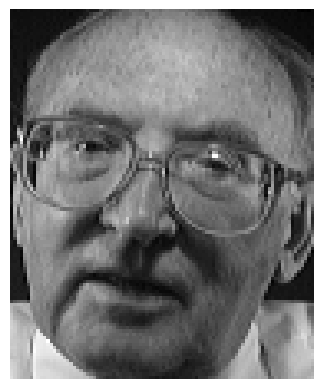

Failure Case
168
Predicted non face but actual is face


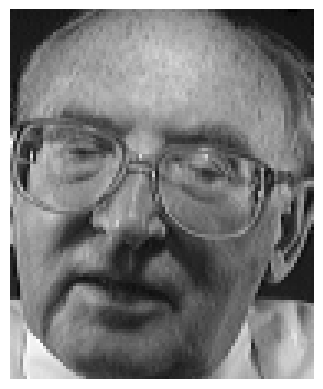

Failure Case
171
Predicted non face but actual is face


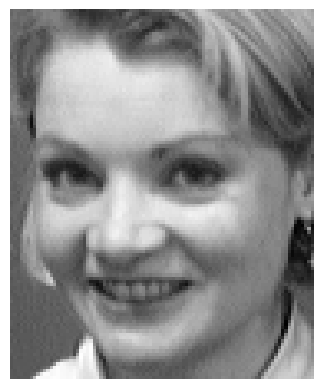

Failure Case
181
Predicted non face but actual is face


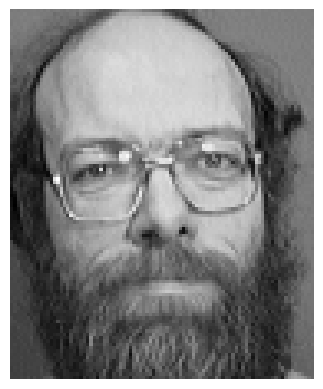

Failure Case
199
Predicted non face but actual is face


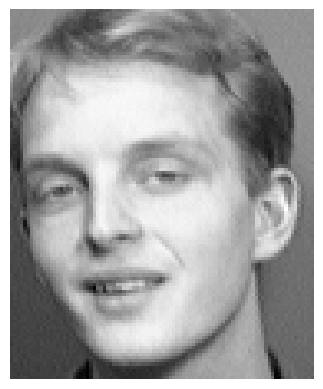

Failure Case
204
Predicted face but actual is non face


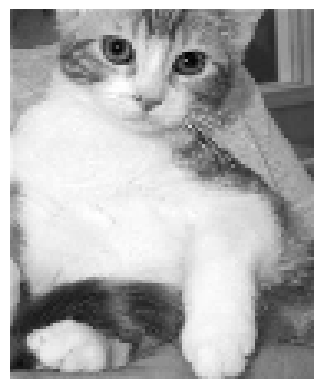

Failure Case
207
Predicted face but actual is non face


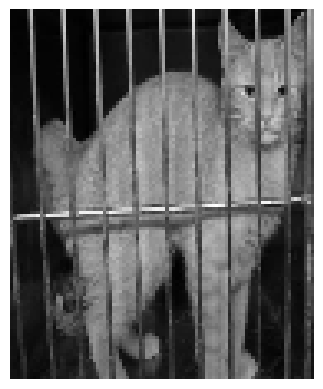

Failure Case
212
Predicted face but actual is non face


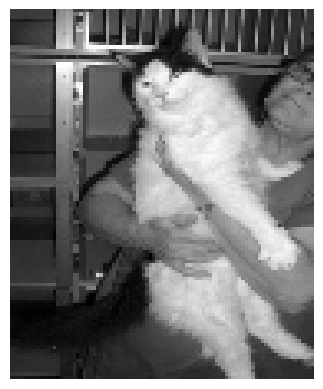

Failure Case
218
Predicted face but actual is non face


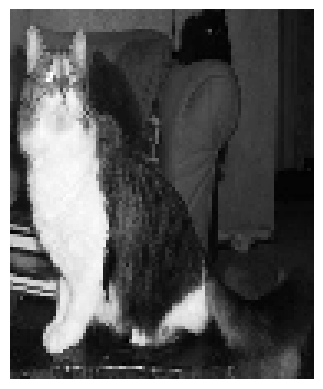

Failure Case
219
Predicted face but actual is non face


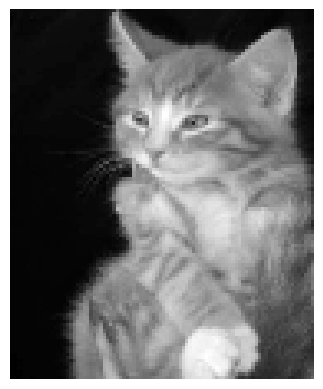

Failure Case
222
Predicted face but actual is non face


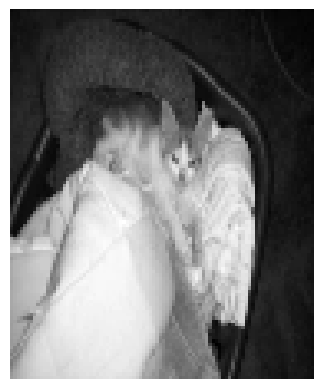

Failure Case
224
Predicted face but actual is non face


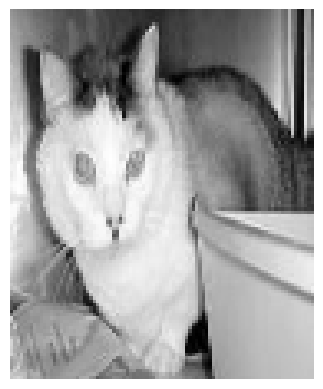

Failure Case
232
Predicted face but actual is non face


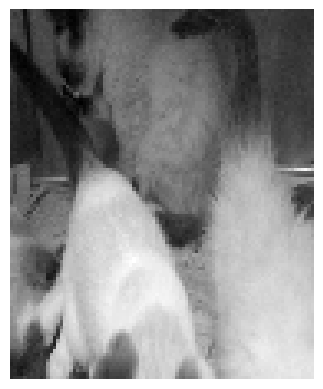

Failure Case
234
Predicted face but actual is non face


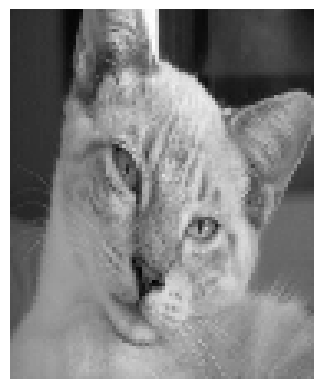

Failure Case
238
Predicted face but actual is non face


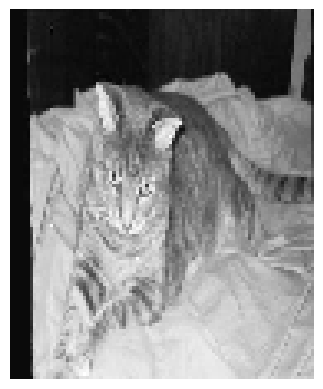

Failure Case
240
Predicted face but actual is non face


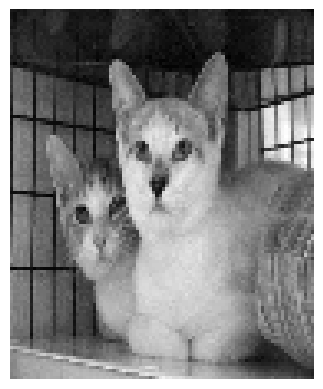

Failure Case
241
Predicted face but actual is non face


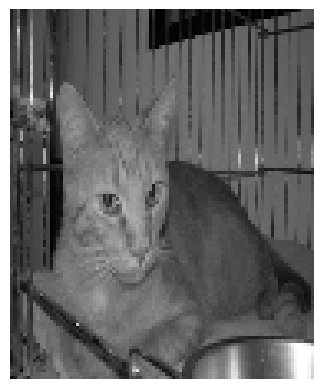

Failure Case
247
Predicted face but actual is non face


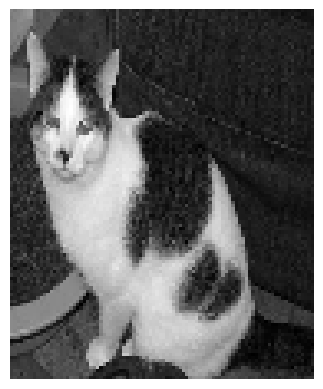

Failure Case
253
Predicted face but actual is non face


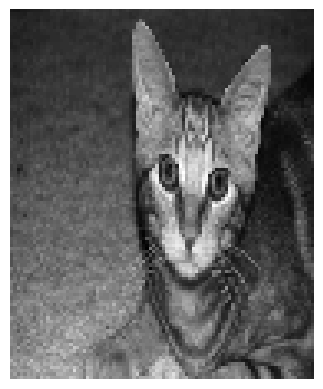

Failure Case
255
Predicted face but actual is non face


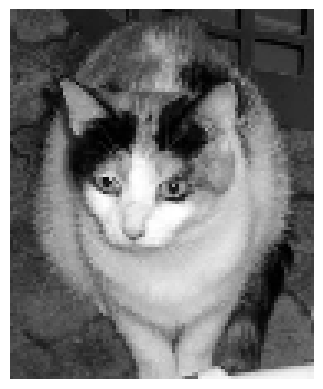

Failure Case
257
Predicted face but actual is non face


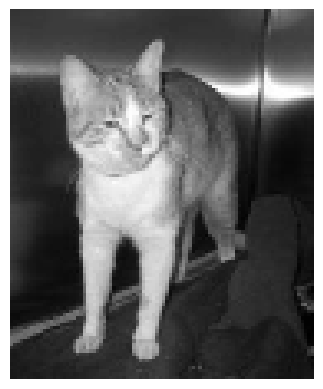

Failure Case
259
Predicted face but actual is non face


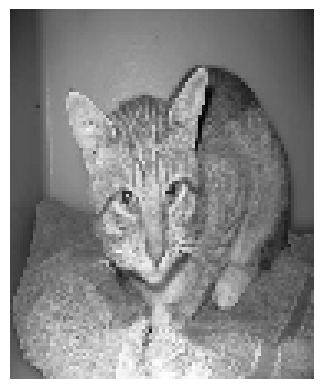

Failure Case
260
Predicted face but actual is non face


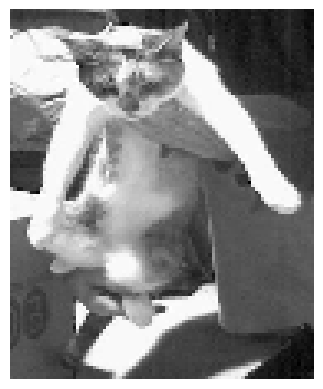

Failure Case
261
Predicted face but actual is non face


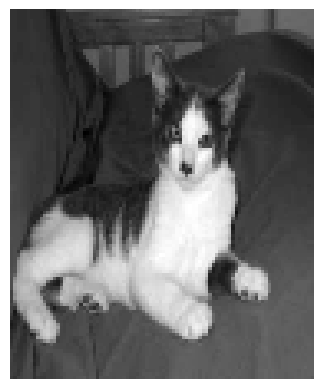

Failure Case
262
Predicted face but actual is non face


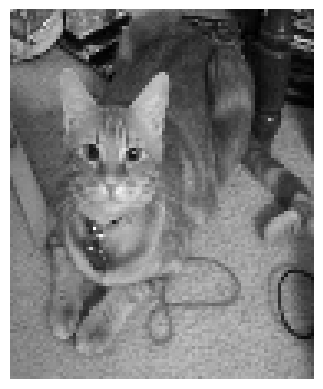

Failure Case
263
Predicted face but actual is non face


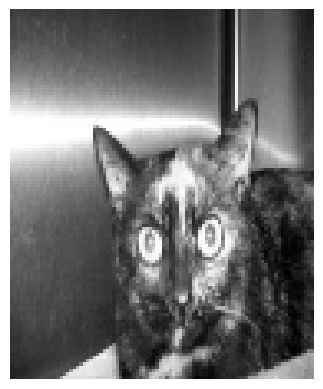

Failure Case
264
Predicted face but actual is non face


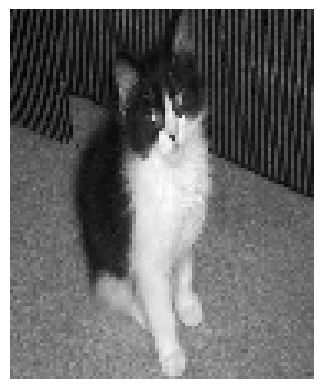

Failure Case
270
Predicted face but actual is non face


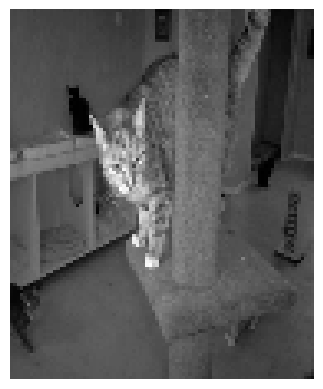

Failure Case
278
Predicted face but actual is non face


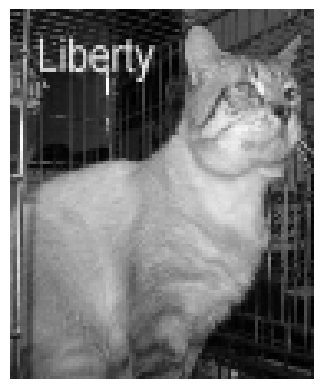

Failure Case
279
Predicted face but actual is non face


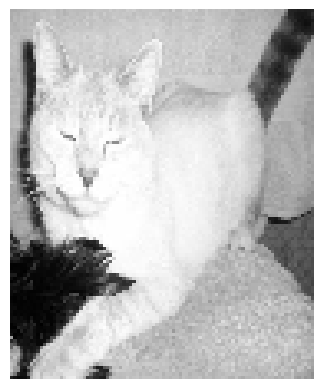

Failure Case
281
Predicted face but actual is non face


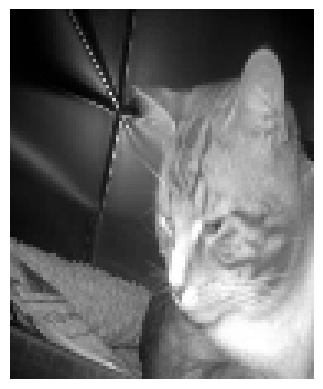

Failure Case
291
Predicted face but actual is non face


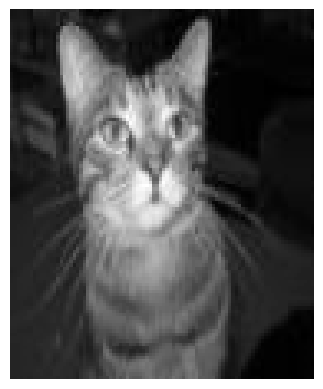

Failure Case
292
Predicted face but actual is non face


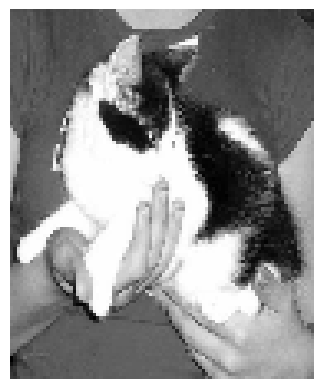

Failure Case
298
Predicted face but actual is non face


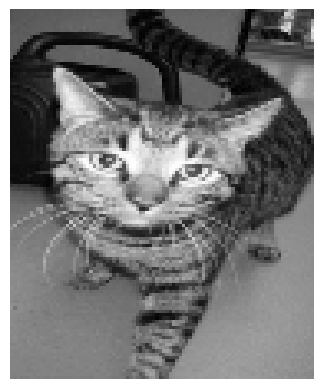

Failure Case
299
Predicted face but actual is non face


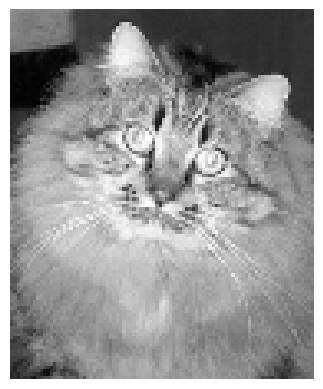

Failure Case
302
Predicted face but actual is non face


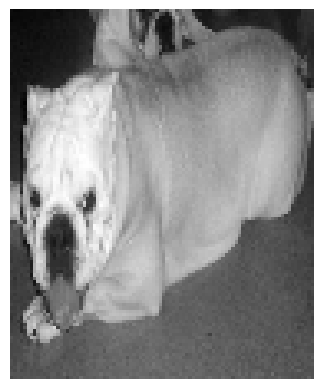

Failure Case
310
Predicted face but actual is non face


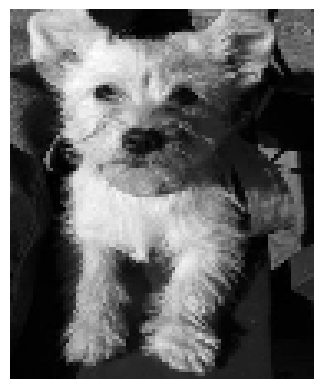

Failure Case
322
Predicted face but actual is non face


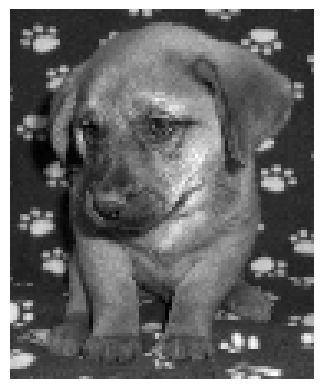

Failure Case
325
Predicted face but actual is non face


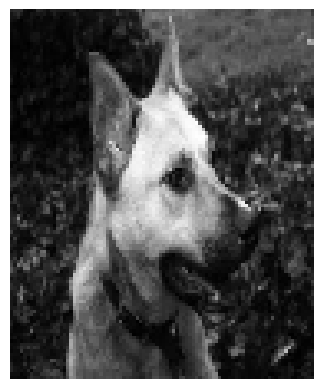

Failure Case
326
Predicted face but actual is non face


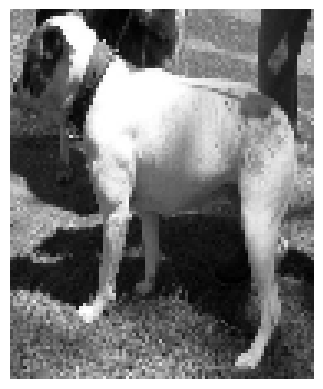

Failure Case
335
Predicted face but actual is non face


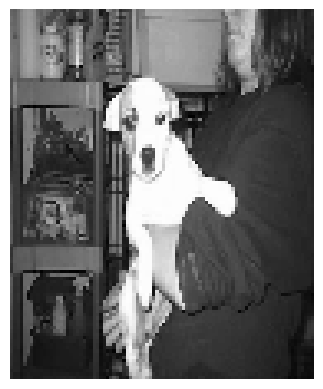

Failure Case
339
Predicted face but actual is non face


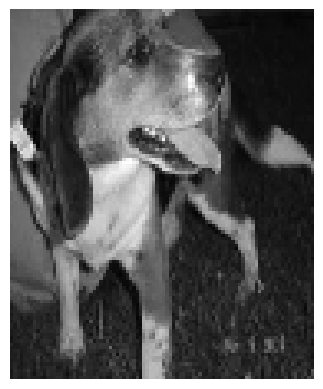

Failure Case
342
Predicted face but actual is non face


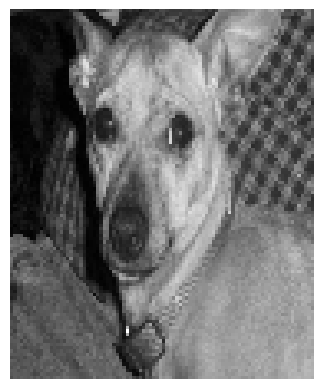

Failure Case
346
Predicted face but actual is non face


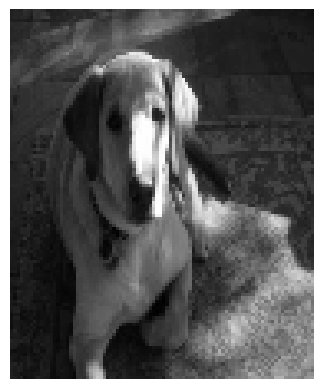

Failure Case
348
Predicted face but actual is non face


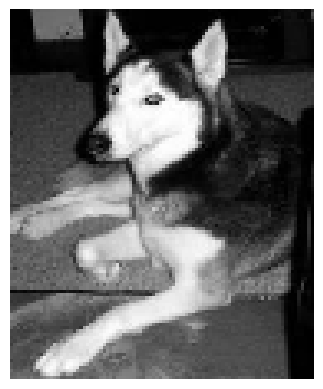

Failure Case
365
Predicted face but actual is non face


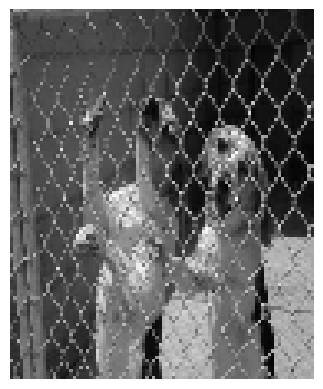

Failure Case
372
Predicted face but actual is non face


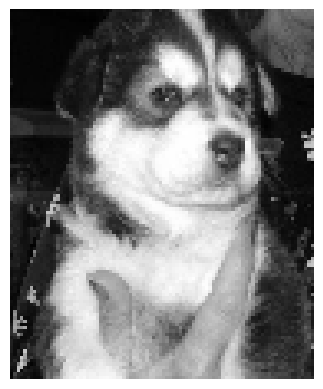

Failure Case
376
Predicted face but actual is non face


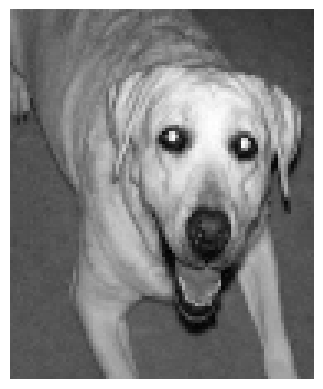

Failure Case
379
Predicted face but actual is non face


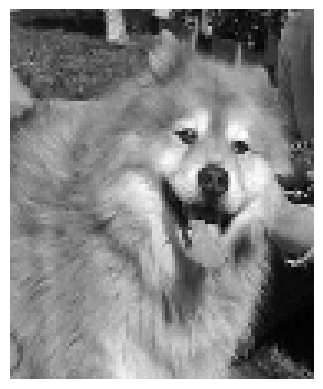

Failure Case
384
Predicted face but actual is non face


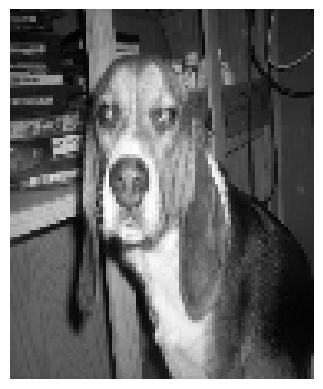

Failure Case
386
Predicted face but actual is non face


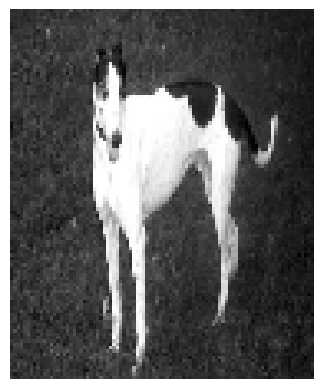

Failure Case
390
Predicted face but actual is non face


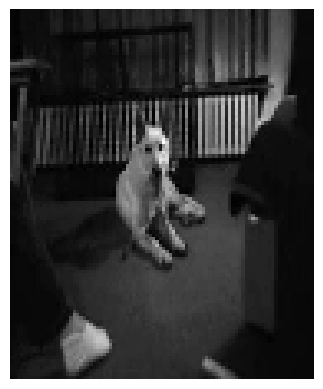

Failure Case
393
Predicted face but actual is non face


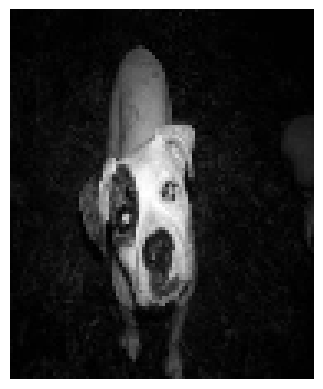

acc = 0.83
Accuracy using k = 7 = 0.8325
CONFUSION MATRIX:
[[186  14]
 [ 53 147]]
Failure Case
22
Predicted non face but actual is face


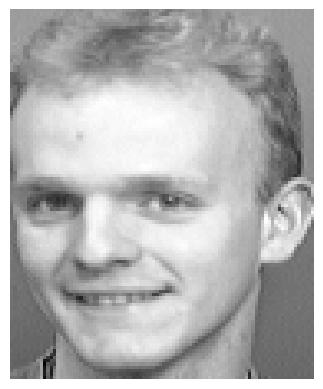

Failure Case
28
Predicted non face but actual is face


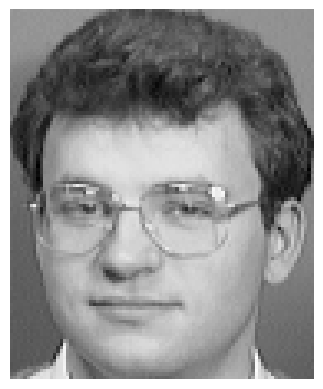

Failure Case
29
Predicted non face but actual is face


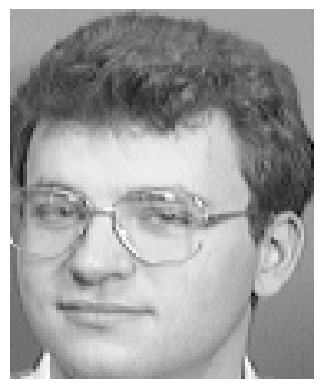

Failure Case
52
Predicted non face but actual is face


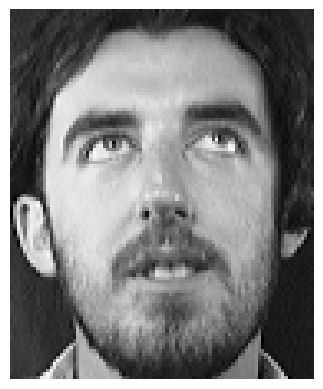

Failure Case
61
Predicted non face but actual is face


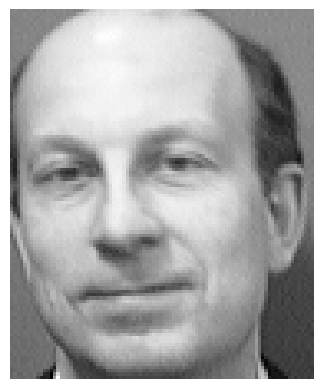

Failure Case
63
Predicted non face but actual is face


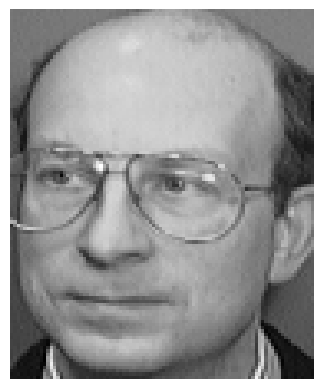

Failure Case
81
Predicted non face but actual is face


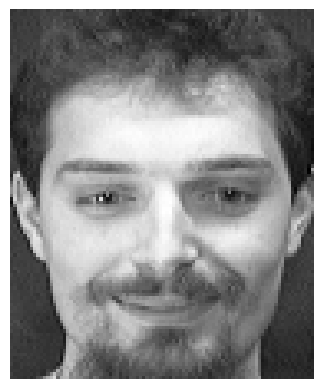

Failure Case
152
Predicted non face but actual is face


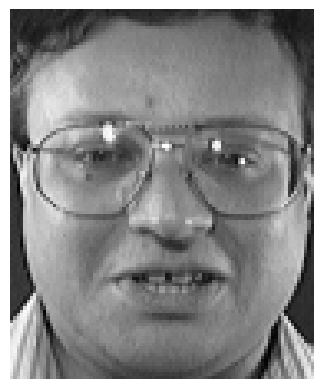

Failure Case
156
Predicted non face but actual is face


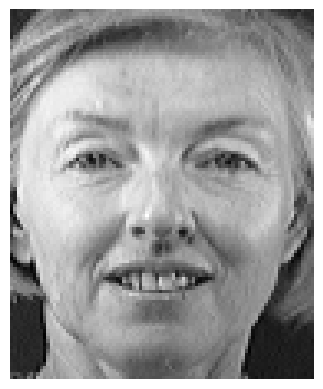

Failure Case
166
Predicted non face but actual is face


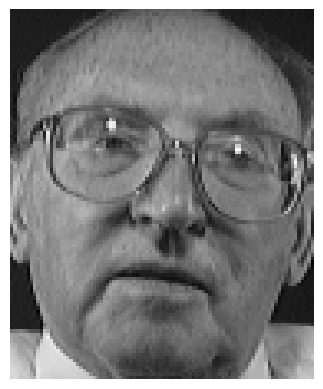

Failure Case
167
Predicted non face but actual is face


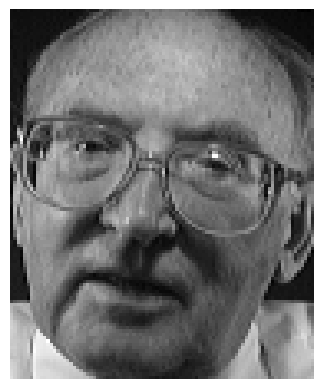

Failure Case
168
Predicted non face but actual is face


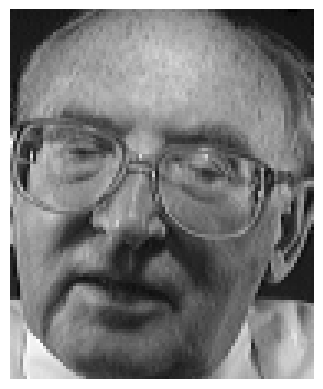

Failure Case
171
Predicted non face but actual is face


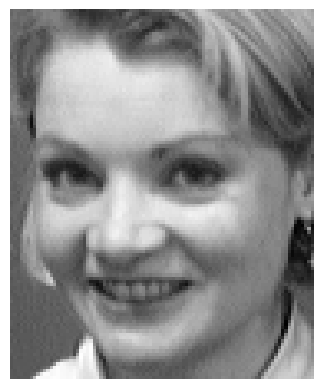

Failure Case
181
Predicted non face but actual is face


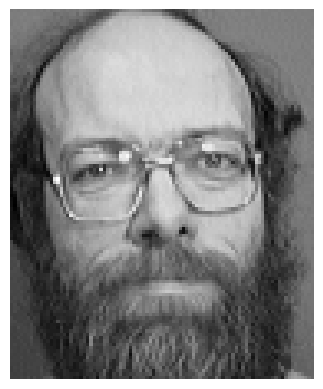

Failure Case
204
Predicted face but actual is non face


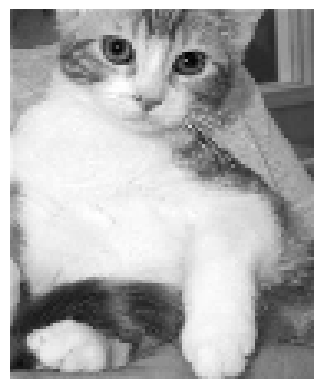

Failure Case
207
Predicted face but actual is non face


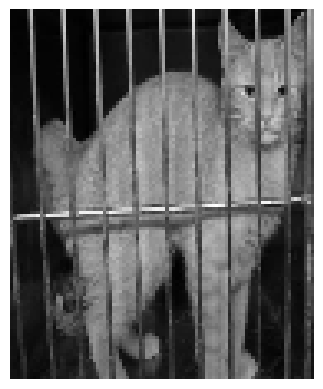

Failure Case
212
Predicted face but actual is non face


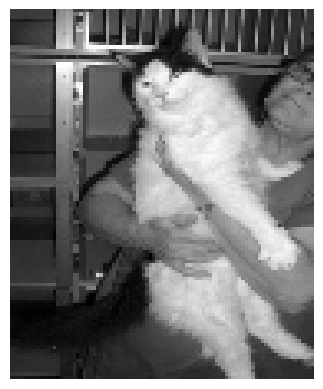

Failure Case
218
Predicted face but actual is non face


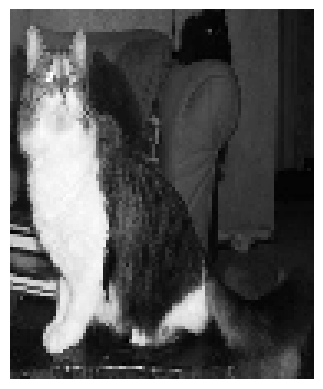

Failure Case
219
Predicted face but actual is non face


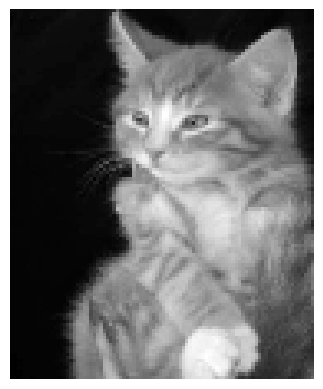

Failure Case
222
Predicted face but actual is non face


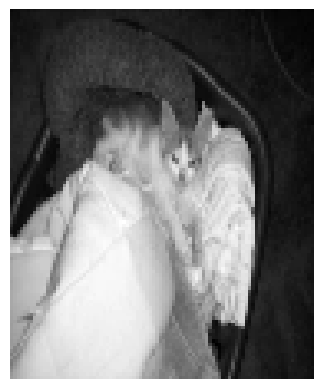

Failure Case
224
Predicted face but actual is non face


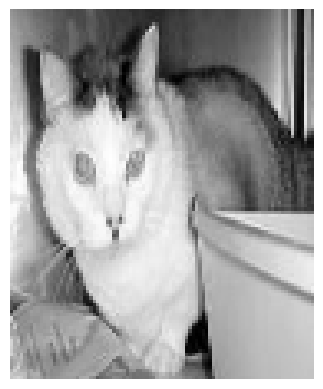

Failure Case
225
Predicted face but actual is non face


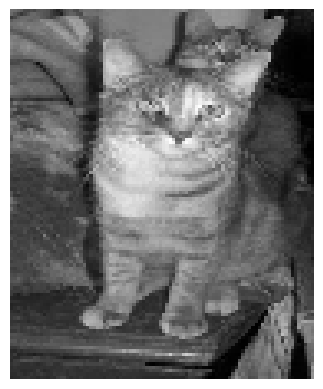

Failure Case
232
Predicted face but actual is non face


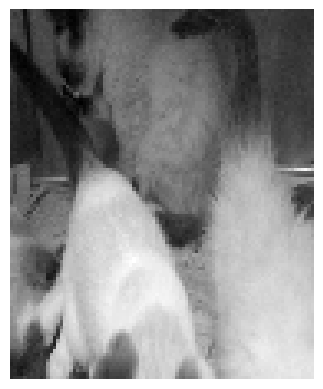

Failure Case
234
Predicted face but actual is non face


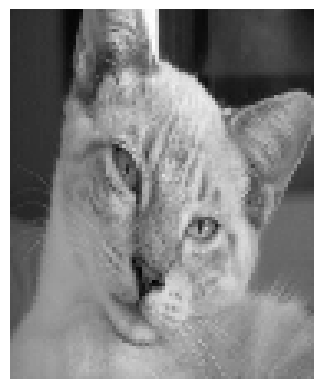

Failure Case
238
Predicted face but actual is non face


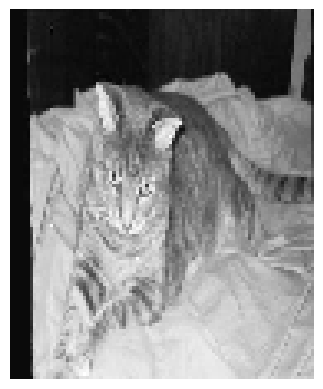

Failure Case
240
Predicted face but actual is non face


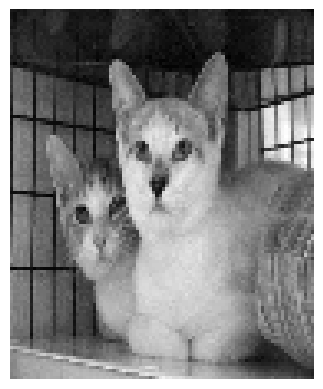

Failure Case
241
Predicted face but actual is non face


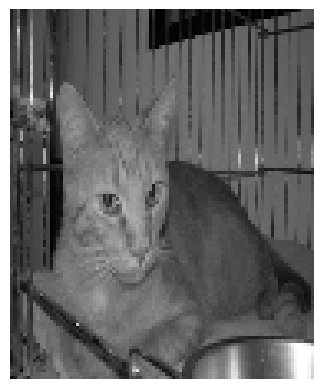

Failure Case
247
Predicted face but actual is non face


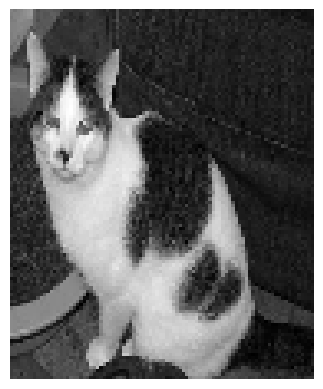

Failure Case
253
Predicted face but actual is non face


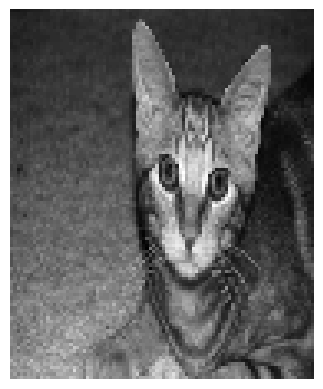

Failure Case
255
Predicted face but actual is non face


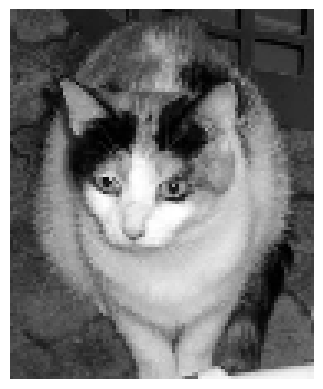

Failure Case
257
Predicted face but actual is non face


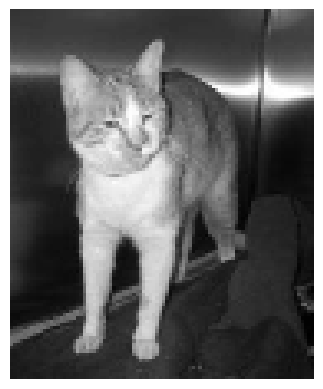

Failure Case
259
Predicted face but actual is non face


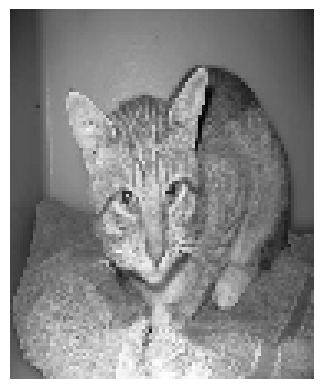

Failure Case
260
Predicted face but actual is non face


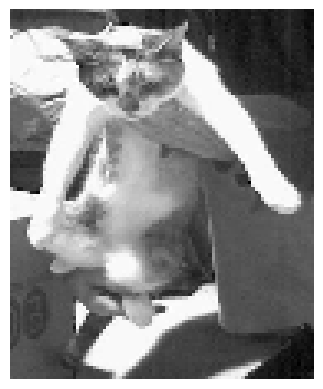

Failure Case
261
Predicted face but actual is non face


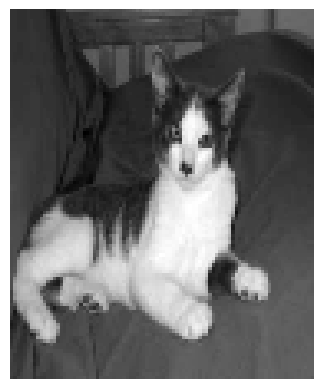

Failure Case
262
Predicted face but actual is non face


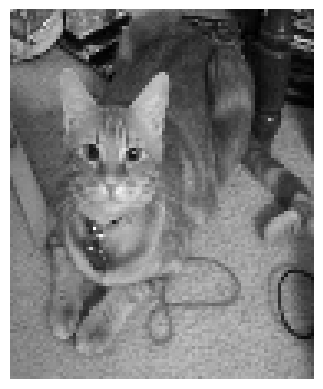

Failure Case
263
Predicted face but actual is non face


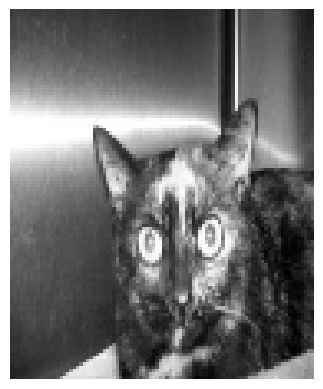

Failure Case
264
Predicted face but actual is non face


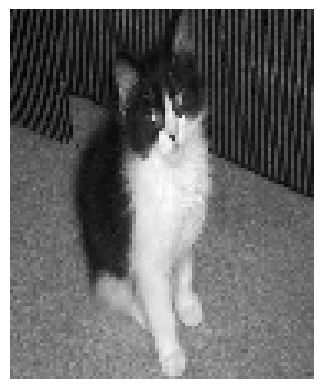

Failure Case
270
Predicted face but actual is non face


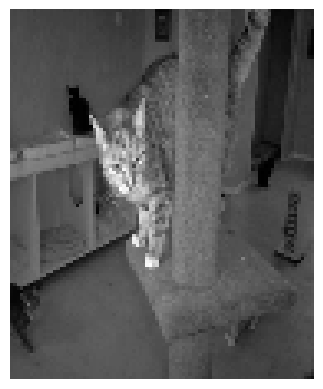

Failure Case
278
Predicted face but actual is non face


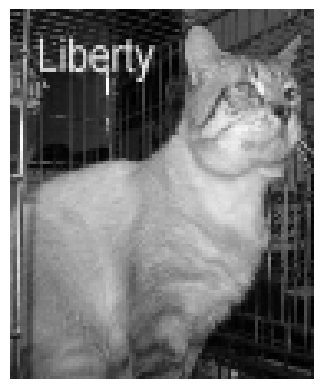

Failure Case
279
Predicted face but actual is non face


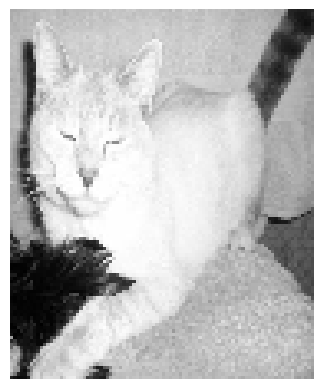

Failure Case
281
Predicted face but actual is non face


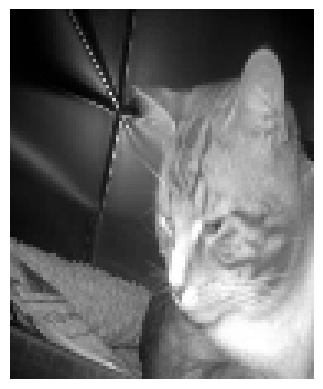

Failure Case
291
Predicted face but actual is non face


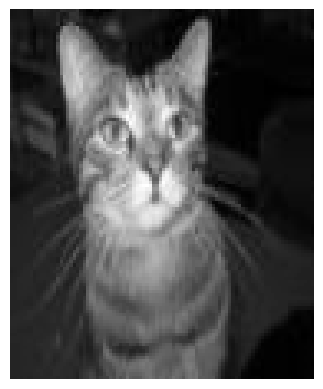

Failure Case
292
Predicted face but actual is non face


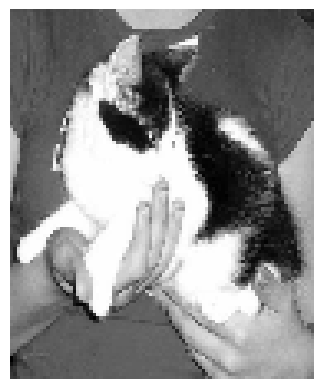

Failure Case
298
Predicted face but actual is non face


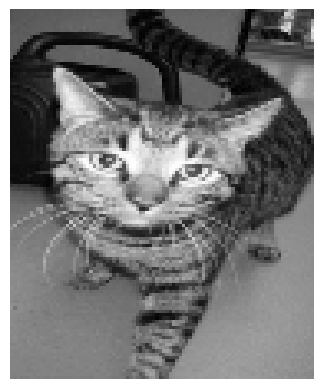

Failure Case
299
Predicted face but actual is non face


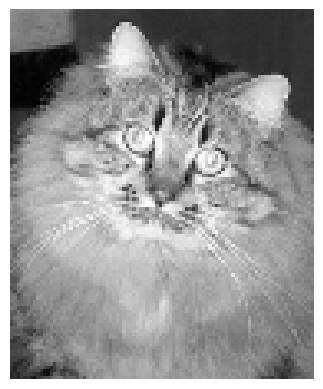

Failure Case
302
Predicted face but actual is non face


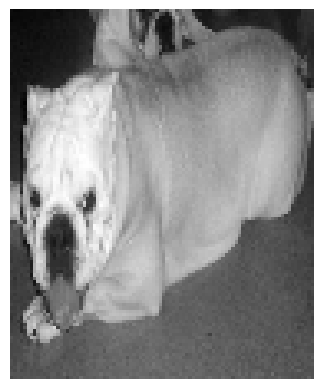

Failure Case
307
Predicted face but actual is non face


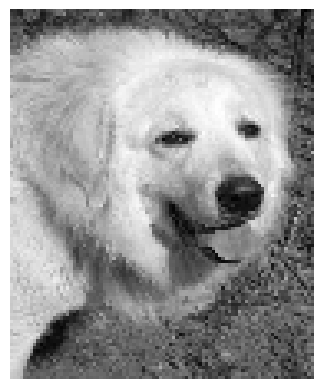

Failure Case
310
Predicted face but actual is non face


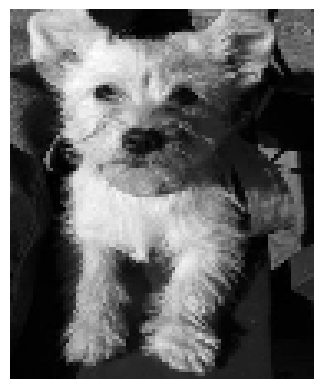

Failure Case
319
Predicted face but actual is non face


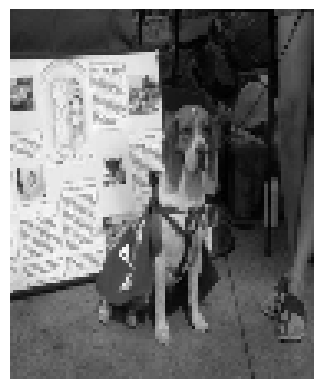

Failure Case
322
Predicted face but actual is non face


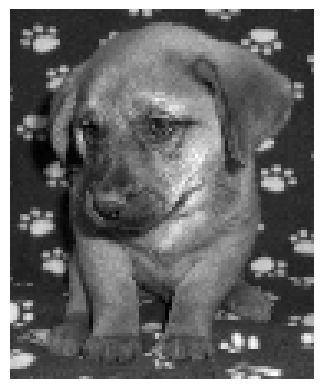

Failure Case
325
Predicted face but actual is non face


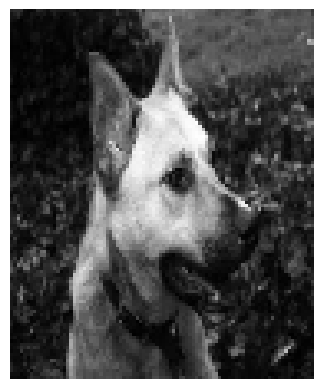

Failure Case
326
Predicted face but actual is non face


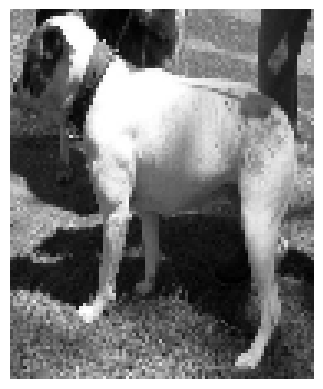

Failure Case
328
Predicted face but actual is non face


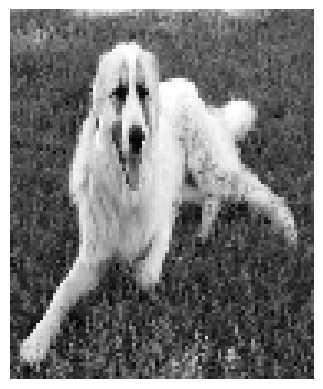

Failure Case
335
Predicted face but actual is non face


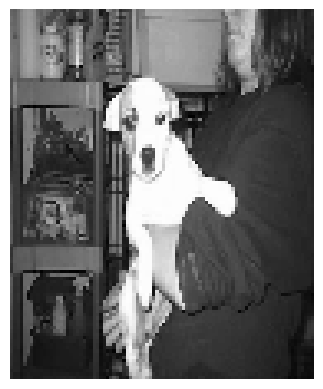

Failure Case
339
Predicted face but actual is non face


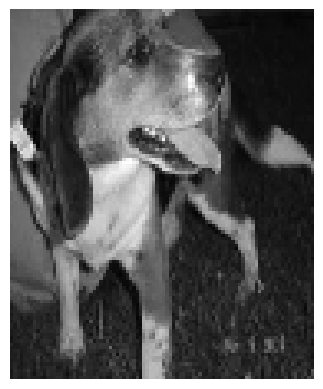

Failure Case
342
Predicted face but actual is non face


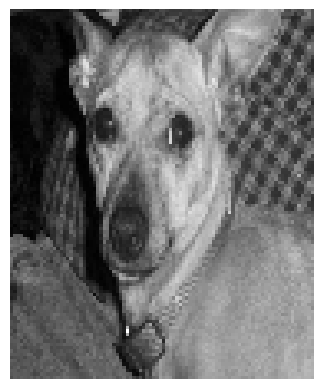

Failure Case
346
Predicted face but actual is non face


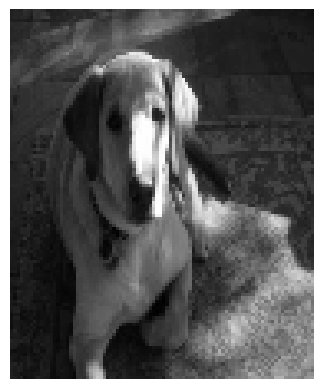

Failure Case
348
Predicted face but actual is non face


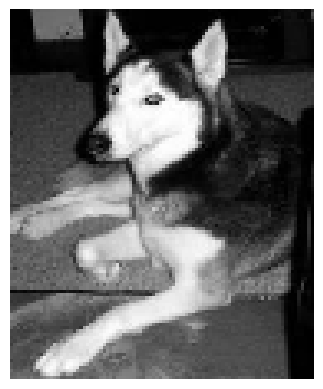

Failure Case
365
Predicted face but actual is non face


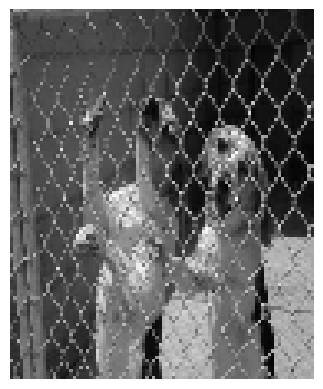

Failure Case
372
Predicted face but actual is non face


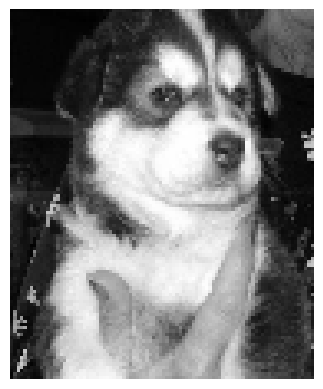

Failure Case
376
Predicted face but actual is non face


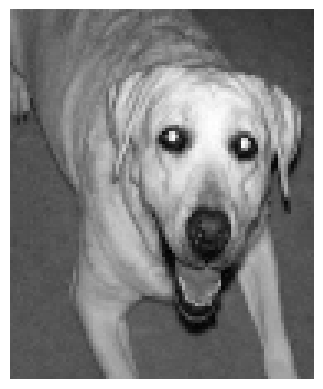

Failure Case
379
Predicted face but actual is non face


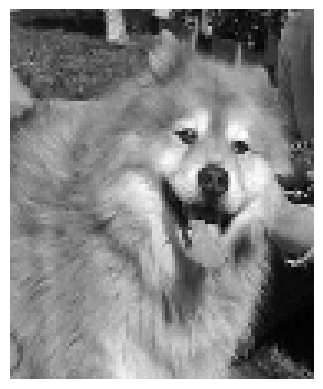

Failure Case
382
Predicted face but actual is non face


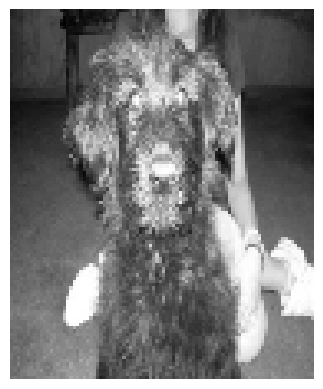

Failure Case
384
Predicted face but actual is non face


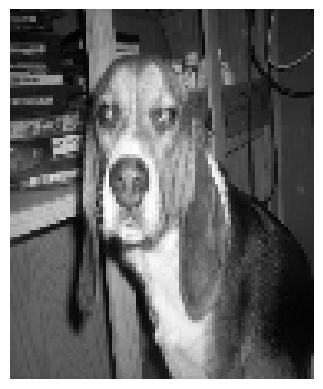

Failure Case
386
Predicted face but actual is non face


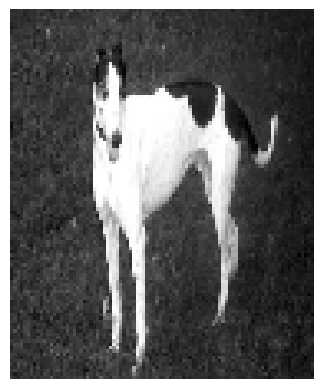

Failure Case
390
Predicted face but actual is non face


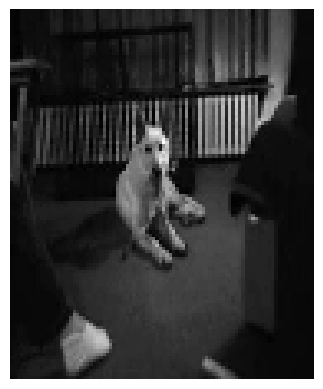

Failure Case
393
Predicted face but actual is non face


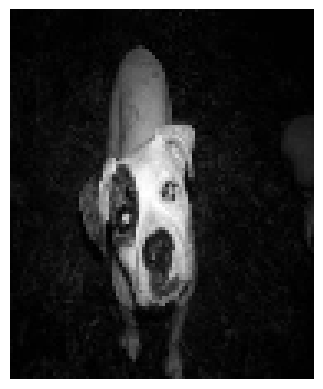

acc = 0.8325


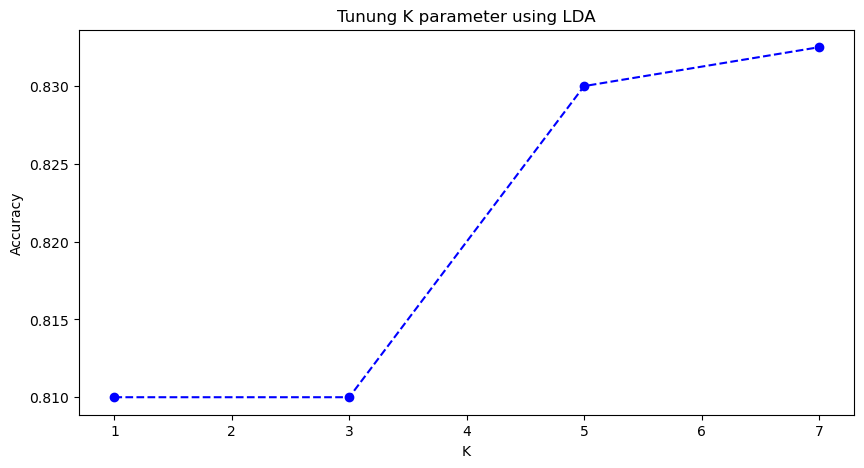

RUNNING PCA AND LDA WITH NONFACES = 600
-------------------------------------
-------------------------------------
================PCA================
Eigenvectors shape = (10304, 10304)
r =  43
U shape = (10304, 43)
projected_training shape = (500, 43)
projected_testing shape = (500, 43)
ACCURACY FOR ALPHA:0.8 AND K = 1 IS :- 0.94
CONFUSION MATRIX:
[[200   0]
 [ 30 270]]
Eigenvectors shape = (10304, 10304)
r =  70
U shape = (10304, 70)
projected_training shape = (500, 70)
projected_testing shape = (500, 70)
ACCURACY FOR ALPHA:0.85 AND K = 1 IS :- 0.936
CONFUSION MATRIX:
[[200   0]
 [ 32 268]]
Eigenvectors shape = (10304, 10304)
r =  117
U shape = (10304, 117)
projected_training shape = (500, 117)
projected_testing shape = (500, 117)
ACCURACY FOR ALPHA:0.9 AND K = 1 IS :- 0.932
CONFUSION MATRIX:
[[200   0]
 [ 34 266]]
Eigenvectors shape = (10304, 10304)
r =  207
U shape = (10304, 207)
projected_training shape = (500, 207)
projected_testing shape = (500, 207)
ACCURACY FOR ALPHA:0.95 AN

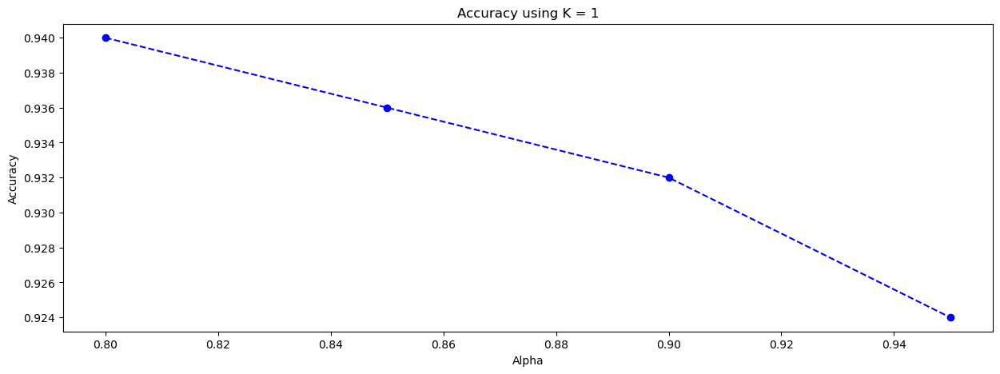

ACCURACY FOR ALPHA:0.8 AND K = 3 IS :- 0.906
CONFUSION MATRIX:
[[200   0]
 [ 47 253]]
ACCURACY FOR ALPHA:0.85 AND K = 3 IS :- 0.9
CONFUSION MATRIX:
[[200   0]
 [ 50 250]]
ACCURACY FOR ALPHA:0.9 AND K = 3 IS :- 0.898
CONFUSION MATRIX:
[[200   0]
 [ 51 249]]
ACCURACY FOR ALPHA:0.95 AND K = 3 IS :- 0.892
CONFUSION MATRIX:
[[199   1]
 [ 53 247]]
Done for k = 3



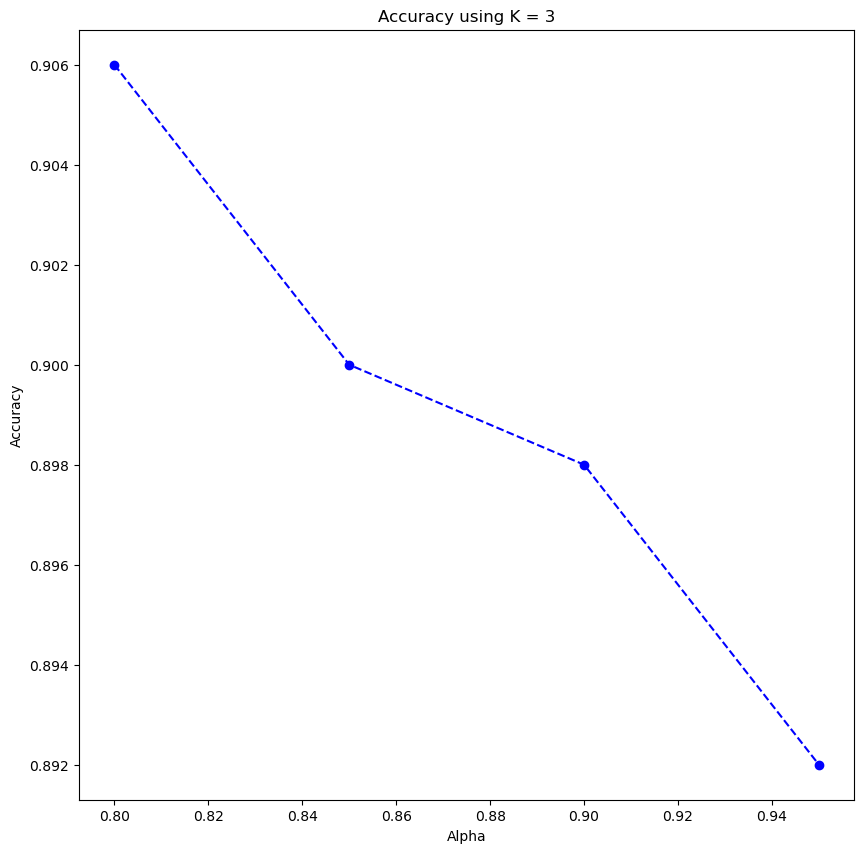

ACCURACY FOR ALPHA:0.8 AND K = 5 IS :- 0.898
CONFUSION MATRIX:
[[200   0]
 [ 51 249]]
ACCURACY FOR ALPHA:0.85 AND K = 5 IS :- 0.882
CONFUSION MATRIX:
[[200   0]
 [ 59 241]]
ACCURACY FOR ALPHA:0.9 AND K = 5 IS :- 0.874
CONFUSION MATRIX:
[[200   0]
 [ 63 237]]
ACCURACY FOR ALPHA:0.95 AND K = 5 IS :- 0.87
CONFUSION MATRIX:
[[200   0]
 [ 65 235]]
Done for k = 5



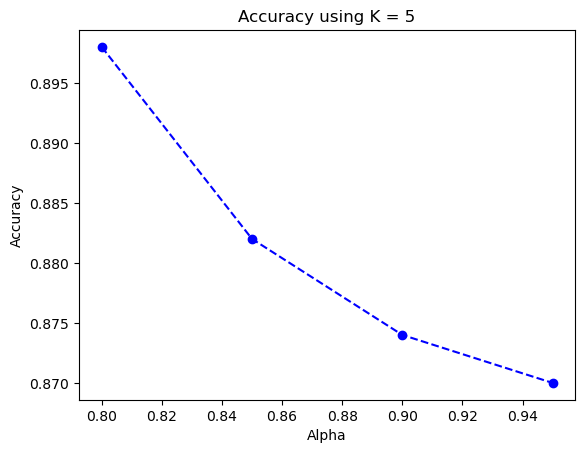

ACCURACY FOR ALPHA:0.8 AND K = 7 IS :- 0.89
CONFUSION MATRIX:
[[200   0]
 [ 55 245]]
ACCURACY FOR ALPHA:0.85 AND K = 7 IS :- 0.874
CONFUSION MATRIX:
[[200   0]
 [ 63 237]]
ACCURACY FOR ALPHA:0.9 AND K = 7 IS :- 0.862
CONFUSION MATRIX:
[[200   0]
 [ 69 231]]
ACCURACY FOR ALPHA:0.95 AND K = 7 IS :- 0.852
CONFUSION MATRIX:
[[200   0]
 [ 74 226]]
Done for k = 7



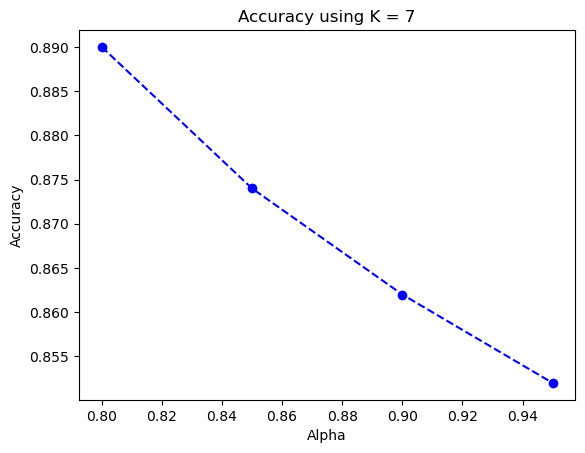

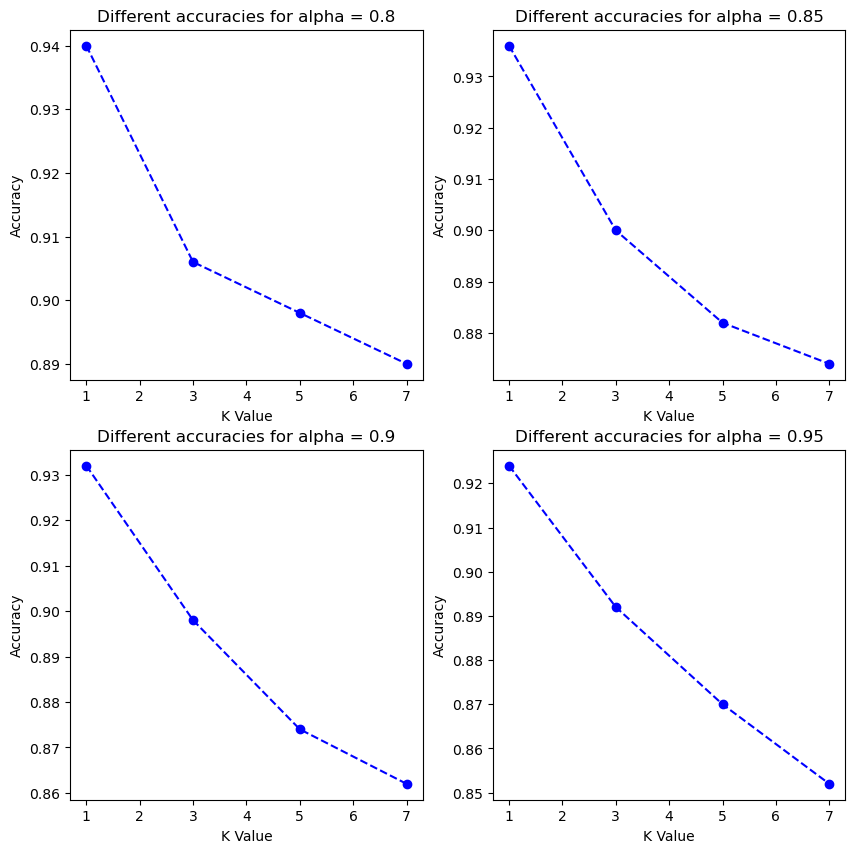

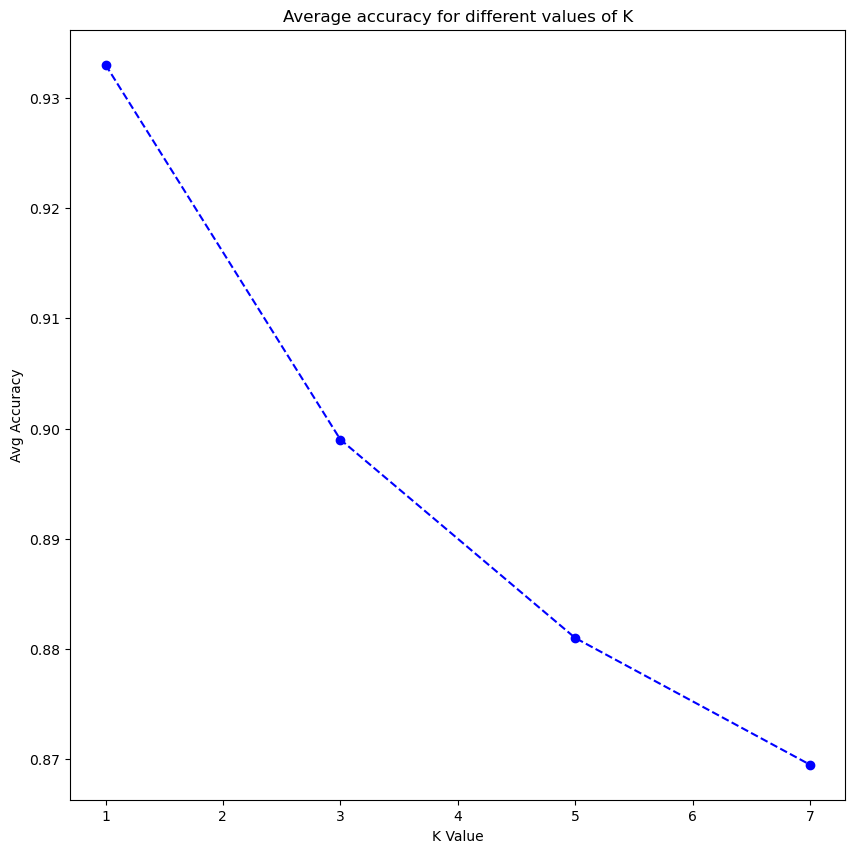

================LDA================
Number of samples in class 0 equal 200
Number of samples in class 1 equal 300
Accuracy using k = 1 = 0.782
CONFUSION MATRIX:
[[156  44]
 [ 65 235]]
Accuracy using k = 3 = 0.812
CONFUSION MATRIX:
[[169  31]
 [ 63 237]]
Accuracy using k = 5 = 0.79
CONFUSION MATRIX:
[[162  38]
 [ 67 233]]
Accuracy using k = 7 = 0.788
CONFUSION MATRIX:
[[164  36]
 [ 70 230]]


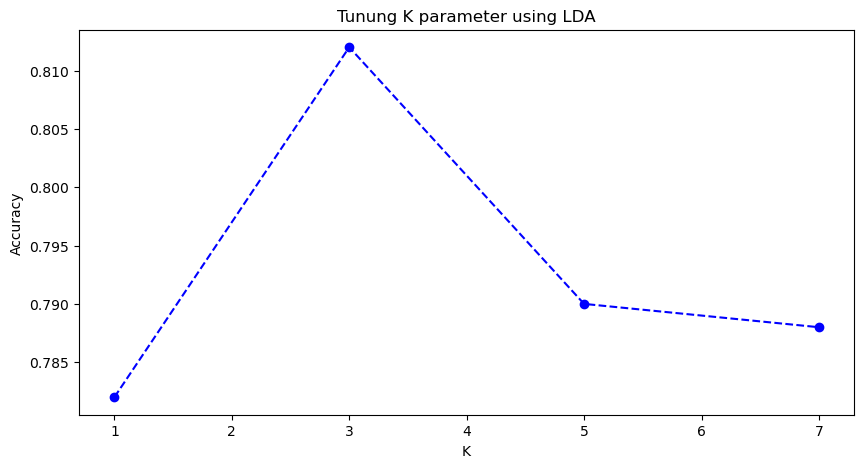

RUNNING PCA AND LDA WITH NONFACES = 800
-------------------------------------
-------------------------------------
================PCA================
Eigenvectors shape = (10304, 10304)
r =  46
U shape = (10304, 46)
projected_training shape = (600, 46)
projected_testing shape = (600, 46)
ACCURACY FOR ALPHA:0.8 AND K = 1 IS :- 0.9466666666666667
CONFUSION MATRIX:
[[200   0]
 [ 32 368]]
Eigenvectors shape = (10304, 10304)
r =  76
U shape = (10304, 76)
projected_training shape = (600, 76)
projected_testing shape = (600, 76)
ACCURACY FOR ALPHA:0.85 AND K = 1 IS :- 0.945
CONFUSION MATRIX:
[[200   0]
 [ 33 367]]
Eigenvectors shape = (10304, 10304)
r =  131
U shape = (10304, 131)
projected_training shape = (600, 131)
projected_testing shape = (600, 131)
ACCURACY FOR ALPHA:0.9 AND K = 1 IS :- 0.9433333333333334
CONFUSION MATRIX:
[[200   0]
 [ 34 366]]
Eigenvectors shape = (10304, 10304)
r =  239
U shape = (10304, 239)
projected_training shape = (600, 239)
projected_testing shape = (600, 239)

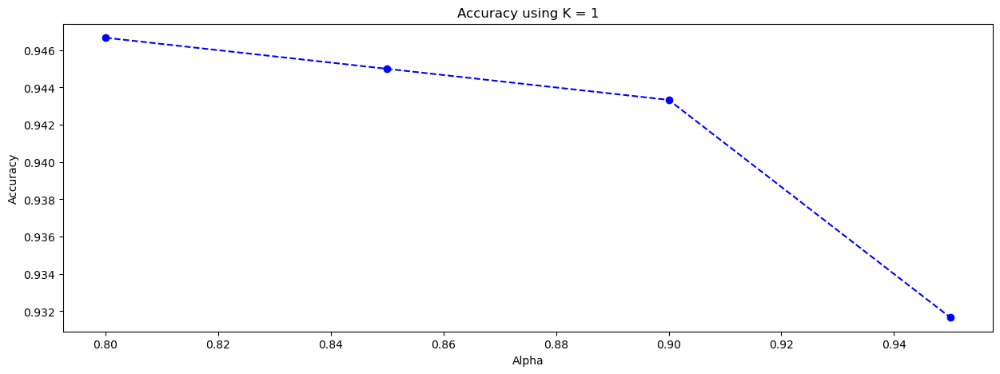

ACCURACY FOR ALPHA:0.8 AND K = 3 IS :- 0.9233333333333333
CONFUSION MATRIX:
[[200   0]
 [ 46 354]]
ACCURACY FOR ALPHA:0.85 AND K = 3 IS :- 0.9116666666666666
CONFUSION MATRIX:
[[200   0]
 [ 53 347]]
ACCURACY FOR ALPHA:0.9 AND K = 3 IS :- 0.91
CONFUSION MATRIX:
[[200   0]
 [ 54 346]]
ACCURACY FOR ALPHA:0.95 AND K = 3 IS :- 0.9
CONFUSION MATRIX:
[[199   1]
 [ 59 341]]
Done for k = 3



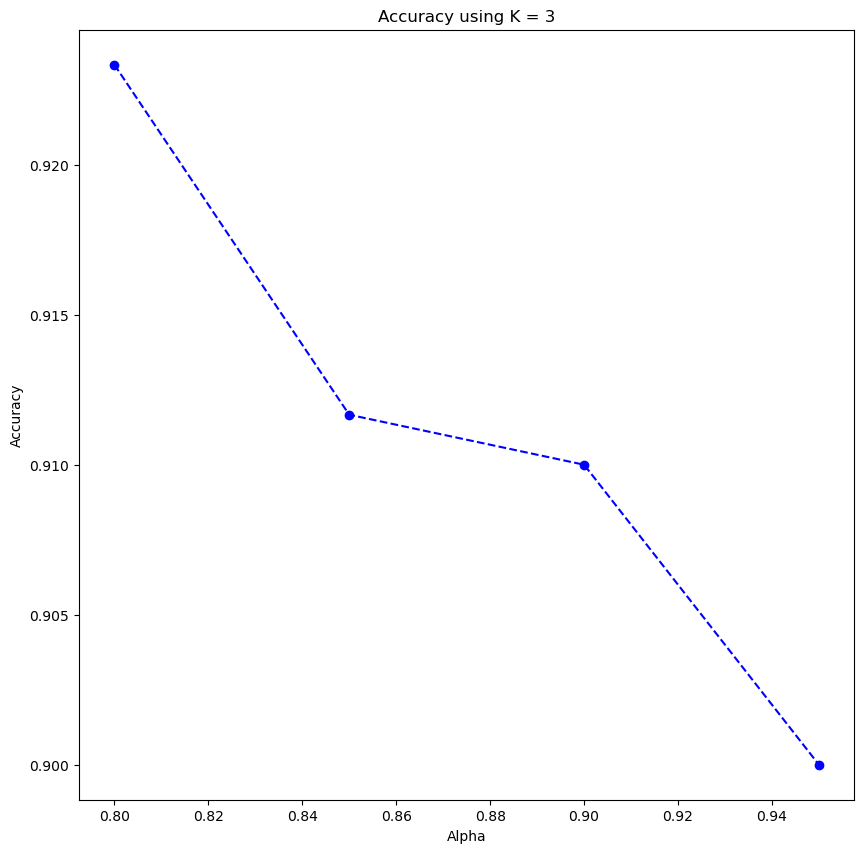

ACCURACY FOR ALPHA:0.8 AND K = 5 IS :- 0.9116666666666666
CONFUSION MATRIX:
[[200   0]
 [ 53 347]]
ACCURACY FOR ALPHA:0.85 AND K = 5 IS :- 0.8966666666666666
CONFUSION MATRIX:
[[200   0]
 [ 62 338]]
ACCURACY FOR ALPHA:0.9 AND K = 5 IS :- 0.8833333333333333
CONFUSION MATRIX:
[[200   0]
 [ 70 330]]
ACCURACY FOR ALPHA:0.95 AND K = 5 IS :- 0.875
CONFUSION MATRIX:
[[200   0]
 [ 75 325]]
Done for k = 5



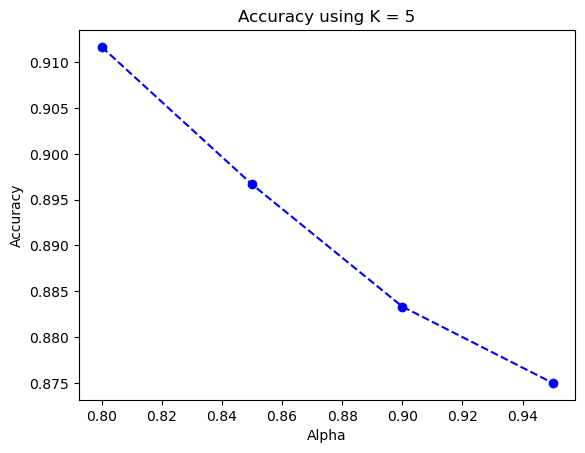

ACCURACY FOR ALPHA:0.8 AND K = 7 IS :- 0.8983333333333333
CONFUSION MATRIX:
[[200   0]
 [ 61 339]]
ACCURACY FOR ALPHA:0.85 AND K = 7 IS :- 0.8816666666666667
CONFUSION MATRIX:
[[200   0]
 [ 71 329]]
ACCURACY FOR ALPHA:0.9 AND K = 7 IS :- 0.865
CONFUSION MATRIX:
[[200   0]
 [ 81 319]]
ACCURACY FOR ALPHA:0.95 AND K = 7 IS :- 0.8666666666666667
CONFUSION MATRIX:
[[200   0]
 [ 80 320]]
Done for k = 7



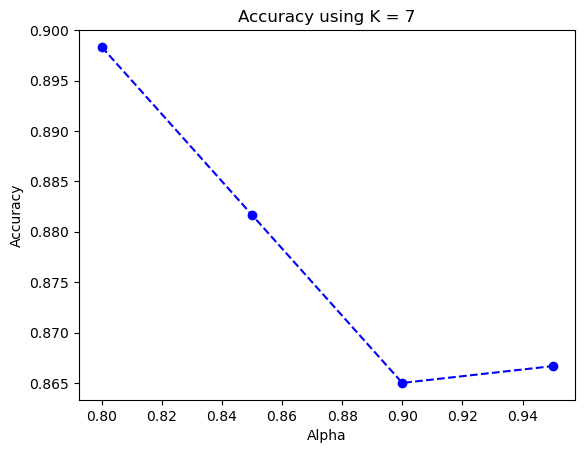

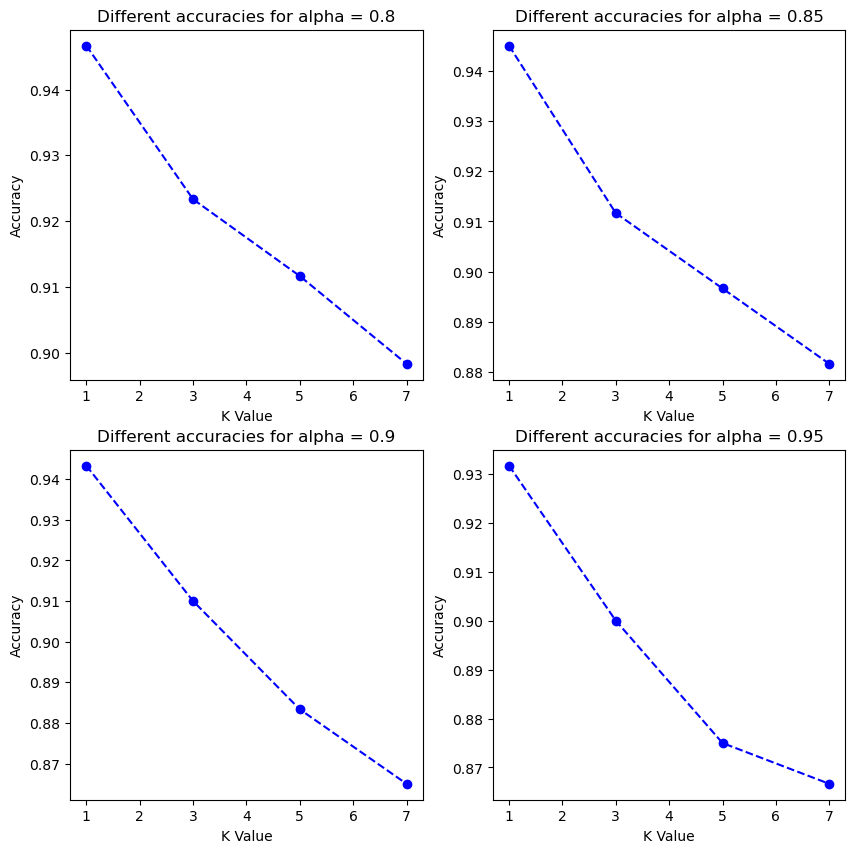

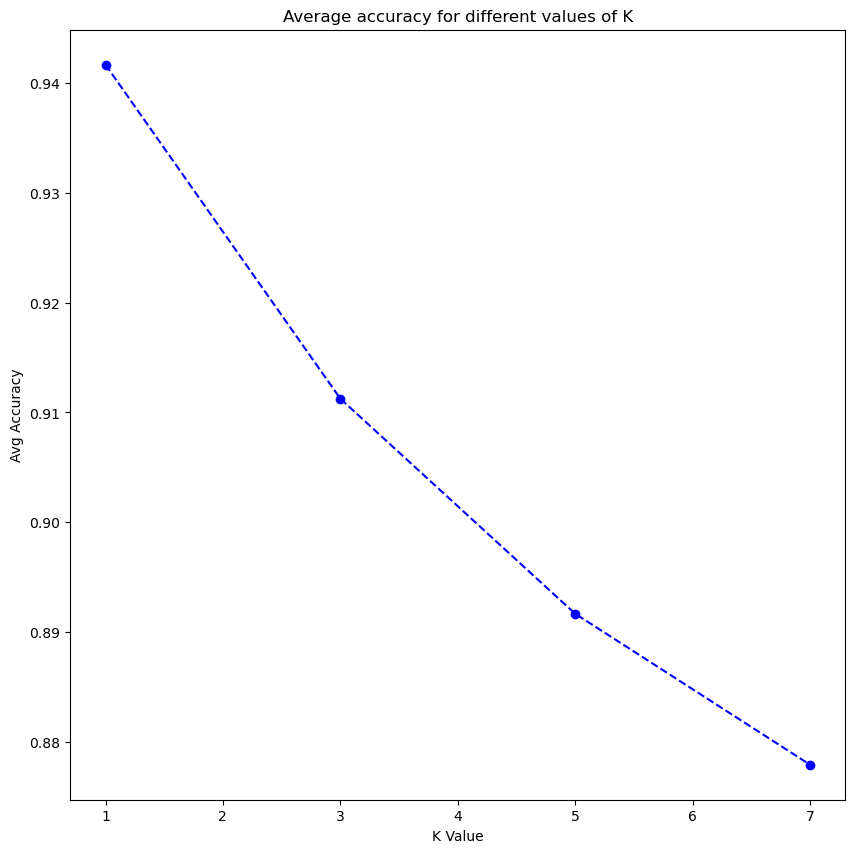

================LDA================
Number of samples in class 0 equal 200
Number of samples in class 1 equal 400
Accuracy using k = 1 = 0.7866666666666666
CONFUSION MATRIX:
[[135  65]
 [ 63 337]]
Accuracy using k = 3 = 0.7833333333333333
CONFUSION MATRIX:
[[139  61]
 [ 69 331]]
Accuracy using k = 5 = 0.7933333333333333
CONFUSION MATRIX:
[[156  44]
 [ 80 320]]
Accuracy using k = 7 = 0.815
CONFUSION MATRIX:
[[161  39]
 [ 72 328]]


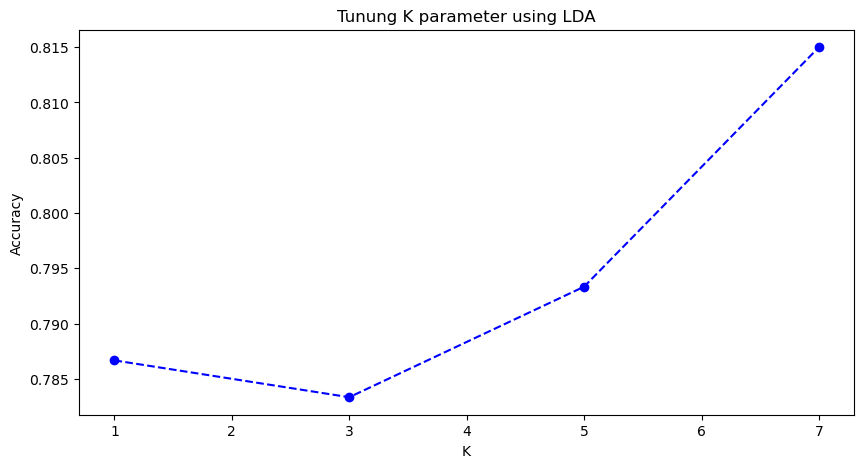

In [30]:
loops = [100,200,300,400,600,800]
for loop in loops:
  print('RUNNING PCA AND LDA WITH NONFACES = '+ str(loop))
  print('-------------------------------------')
  print('-------------------------------------')
  photos=[i for i in range(1, loop+1)]
  images1 = np.ones((1, 10304))
  labels1=np.array([])
  for photo in photos:
      img1 = cv2.imread('/kaggle/input/animals/animals/'+str(photo)+".jpg",0) # zero for gray scale
      img1 = cv2.resize(img1,(92,112))
      img1 = np.reshape(img1, (1, 10304))
      images1 = np.append(images1, img1, axis=0)
      labels1 = np.append(labels1, 2)
  labels1=np.array(labels1)
  images1=images1[1:,]

  total_images= np.concatenate((images, images1))
  total_labels= np.concatenate((labels2, labels1))

  X_train1=total_images[1::2] # Odd
  X_test1=total_images[0::2]  # Even
  y_train1=total_labels[1::2] # Odd
  y_test1=total_labels[0::2]  # Even
  if loop == 400:
    print("================PCA================")
    test_pca(cp.asarray(X_train1),cp.asarray(X_test1),cp.asarray(y_train1),cp.asarray(y_test1),1)
    print("================LDA================")
    test_lda(cp.asarray(X_train1),cp.asarray(X_test1),cp.asarray(y_train1),cp.asarray(y_test1),1,5,1,1)
  else:
    print("================PCA================")
    test_pca(cp.asarray(X_train1),cp.asarray(X_test1),cp.asarray(y_train1),cp.asarray(y_test1),0)
    print("================LDA================")
    test_lda(cp.asarray(X_train1),cp.asarray(X_test1),cp.asarray(y_train1),cp.asarray(y_test1),1,5,0,1)

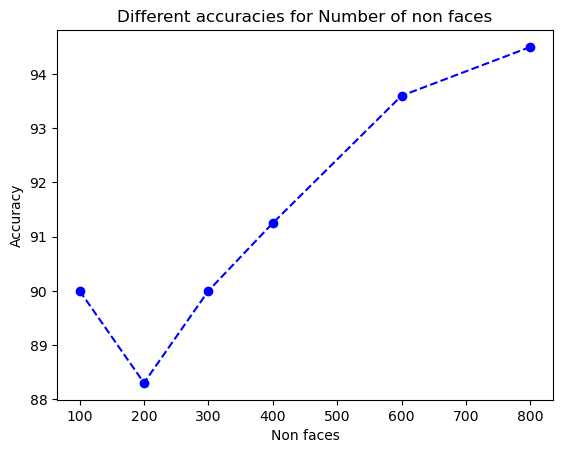

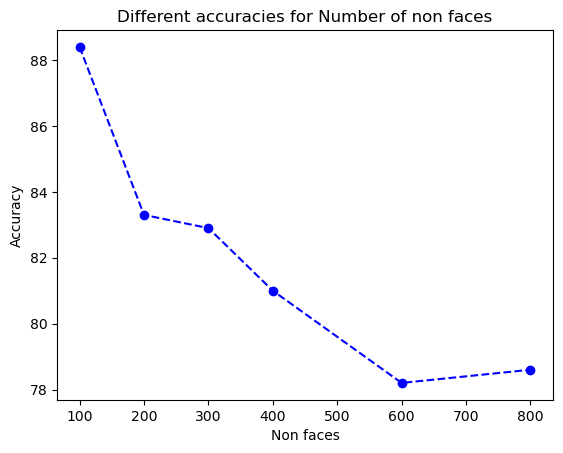

In [31]:
pca_accuracies=[90,88.3,90,91.25,93.6,94.5]
lda_accuracies=[88.4,83.3,82.9,81,78.2,78.6]
plt.plot(loops,pca_accuracies,'--bo', label='line with marker')
plt.xlabel("Non faces")
plt.ylabel("Accuracy")
plt.title("Different accuracies for Number of non faces")
plt.show()
plt.plot(loops,lda_accuracies,'--bo', label='line with marker')
plt.xlabel("Non faces")
plt.ylabel("Accuracy")
plt.title("Different accuracies for Number of non faces")
plt.show()

# Bonus 1

In [32]:
def split_data(images,labels):
  X_test = np.ones((1, 10304))
  X_train = np.ones((1, 10304))
  y_train = np.array([])
  y_test = np.array([])
  i=0
  while i < 400:
    train=images[i:i+7]
    train_label=labels[i:i+7]
    test=images[i+7:i+10]
    test_label=labels[i+7:i+10]
    X_train=np.append(X_train,train,axis=0)
    X_test=np.append(X_test,test,axis=0)
    y_train=np.append(y_train,train_label)
    y_test=np.append(y_test,test_label)
    i+=10
  X_train = X_train[1:,] 
  X_test = X_test[1:,] 
  return X_train,X_test,y_train,y_test

In [33]:
X_train_new,X_test_new,y_train_new,y_test_new=split_data(images,labels)

Eigenvectors shape = (10304, 10304)
r =  39
U shape = (10304, 39)
projected_training shape = (280, 39)
projected_testing shape = (120, 39)
ACCURACY FOR ALPHA:0.8 AND K = 1 IS :- 0.9583333333333334
CONFUSION MATRIX:
[[3 0 0 ... 0 0 0]
 [0 3 0 ... 0 0 0]
 [0 0 3 ... 0 0 0]
 ...
 [0 0 0 ... 3 0 0]
 [0 0 0 ... 0 3 0]
 [0 0 0 ... 0 0 3]]
Eigenvectors shape = (10304, 10304)
r =  57
U shape = (10304, 57)
projected_training shape = (280, 57)
projected_testing shape = (120, 57)
ACCURACY FOR ALPHA:0.85 AND K = 1 IS :- 0.9666666666666667
CONFUSION MATRIX:
[[3 0 0 ... 0 0 0]
 [0 3 0 ... 0 0 0]
 [0 0 3 ... 0 0 0]
 ...
 [0 0 0 ... 3 0 0]
 [0 0 0 ... 0 3 0]
 [0 0 0 ... 0 0 3]]
Eigenvectors shape = (10304, 10304)
r =  89
U shape = (10304, 89)
projected_training shape = (280, 89)
projected_testing shape = (120, 89)
ACCURACY FOR ALPHA:0.9 AND K = 1 IS :- 0.9666666666666667
CONFUSION MATRIX:
[[3 0 0 ... 0 0 0]
 [0 3 0 ... 0 0 0]
 [0 0 3 ... 0 0 0]
 ...
 [0 0 0 ... 3 0 0]
 [0 0 0 ... 0 3 0]
 [0 0 0 ... 0 

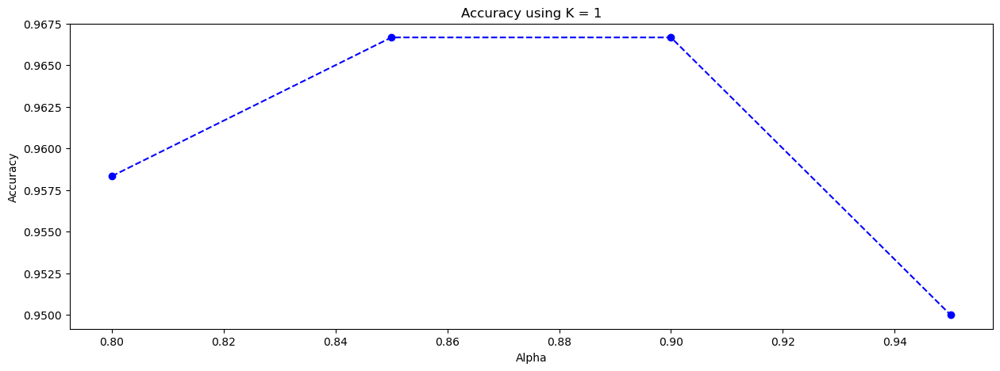

ACCURACY FOR ALPHA:0.8 AND K = 3 IS :- 0.925
CONFUSION MATRIX:
[[3 0 0 ... 0 0 0]
 [0 3 0 ... 0 0 0]
 [0 0 3 ... 0 0 0]
 ...
 [0 0 0 ... 3 0 0]
 [0 0 0 ... 0 3 0]
 [0 0 0 ... 0 0 2]]
ACCURACY FOR ALPHA:0.85 AND K = 3 IS :- 0.9333333333333333
CONFUSION MATRIX:
[[3 0 0 ... 0 0 0]
 [0 3 0 ... 0 0 0]
 [0 0 3 ... 0 0 0]
 ...
 [0 0 0 ... 3 0 0]
 [0 0 0 ... 0 3 0]
 [0 0 0 ... 0 0 2]]
ACCURACY FOR ALPHA:0.9 AND K = 3 IS :- 0.9166666666666666
CONFUSION MATRIX:
[[3 0 0 ... 0 0 0]
 [0 3 0 ... 0 0 0]
 [0 0 3 ... 0 0 0]
 ...
 [0 0 0 ... 3 0 0]
 [0 0 0 ... 0 2 0]
 [0 0 0 ... 0 0 2]]
ACCURACY FOR ALPHA:0.95 AND K = 3 IS :- 0.9416666666666667
CONFUSION MATRIX:
[[3 0 0 ... 0 0 0]
 [0 3 0 ... 0 0 0]
 [0 0 3 ... 0 0 0]
 ...
 [0 0 0 ... 3 0 0]
 [0 0 0 ... 0 3 0]
 [0 0 0 ... 0 0 2]]
Done for k = 3



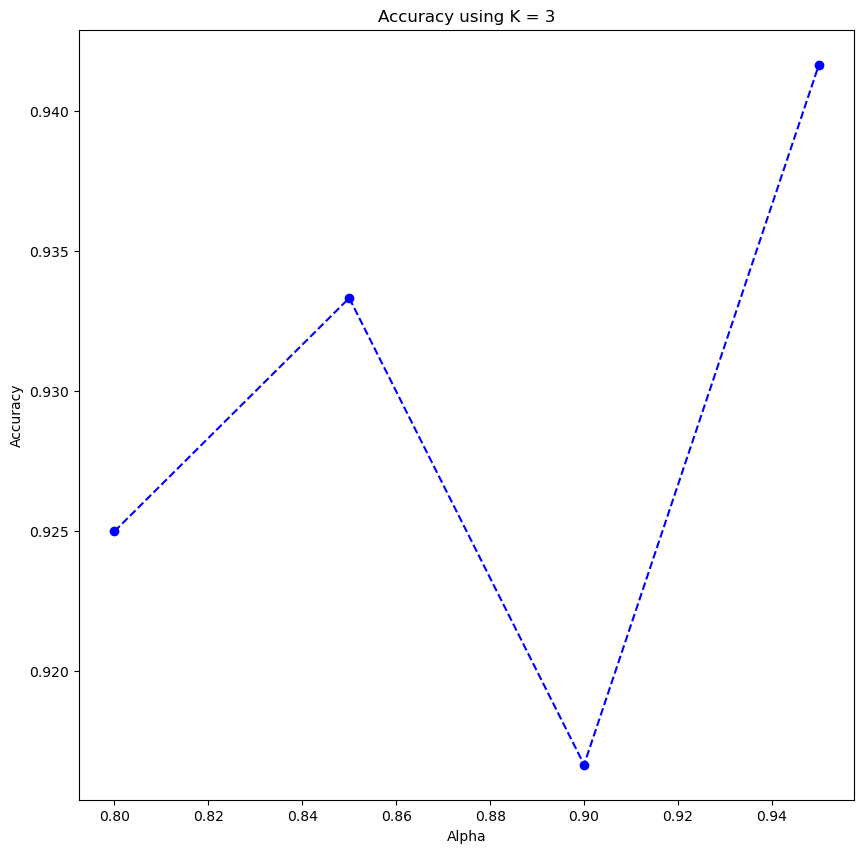

ACCURACY FOR ALPHA:0.8 AND K = 5 IS :- 0.9083333333333333
CONFUSION MATRIX:
[[2 0 0 ... 0 0 0]
 [0 3 0 ... 0 0 0]
 [0 0 3 ... 0 0 0]
 ...
 [0 0 0 ... 3 0 0]
 [0 0 0 ... 0 3 0]
 [0 0 0 ... 0 0 1]]
ACCURACY FOR ALPHA:0.85 AND K = 5 IS :- 0.9083333333333333
CONFUSION MATRIX:
[[2 0 0 ... 0 0 0]
 [0 3 0 ... 0 0 0]
 [0 0 3 ... 0 0 0]
 ...
 [0 0 0 ... 3 0 0]
 [0 0 0 ... 0 3 0]
 [0 0 0 ... 0 0 1]]
ACCURACY FOR ALPHA:0.9 AND K = 5 IS :- 0.8916666666666667
CONFUSION MATRIX:
[[2 0 0 ... 0 0 0]
 [0 3 0 ... 0 0 0]
 [0 0 3 ... 0 0 0]
 ...
 [0 0 0 ... 3 0 0]
 [0 0 0 ... 0 3 0]
 [0 0 0 ... 0 0 1]]
ACCURACY FOR ALPHA:0.95 AND K = 5 IS :- 0.9
CONFUSION MATRIX:
[[2 0 0 ... 0 0 0]
 [0 3 0 ... 0 0 0]
 [0 0 3 ... 0 0 0]
 ...
 [0 0 0 ... 3 0 0]
 [0 0 0 ... 0 3 0]
 [0 0 0 ... 0 0 1]]
Done for k = 5



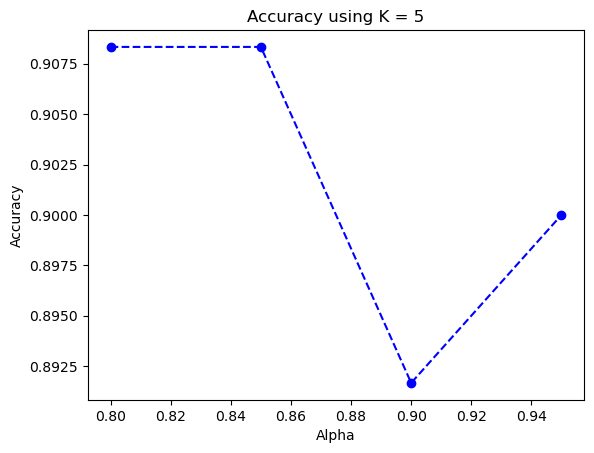

ACCURACY FOR ALPHA:0.8 AND K = 7 IS :- 0.8416666666666667
CONFUSION MATRIX:
[[2 0 0 ... 0 0 0]
 [0 3 0 ... 0 0 0]
 [0 0 3 ... 0 0 0]
 ...
 [0 0 0 ... 3 0 0]
 [0 0 0 ... 0 3 0]
 [0 0 0 ... 0 0 2]]
ACCURACY FOR ALPHA:0.85 AND K = 7 IS :- 0.8416666666666667
CONFUSION MATRIX:
[[2 0 0 ... 0 0 0]
 [0 3 0 ... 0 0 0]
 [0 0 3 ... 0 0 0]
 ...
 [0 0 0 ... 3 0 0]
 [0 0 0 ... 0 3 0]
 [0 0 0 ... 0 0 2]]
ACCURACY FOR ALPHA:0.9 AND K = 7 IS :- 0.85
CONFUSION MATRIX:
[[2 0 0 ... 0 0 0]
 [0 3 0 ... 0 0 0]
 [0 0 3 ... 0 0 0]
 ...
 [0 0 0 ... 3 0 0]
 [0 0 0 ... 0 3 0]
 [0 0 0 ... 0 0 2]]
ACCURACY FOR ALPHA:0.95 AND K = 7 IS :- 0.8
CONFUSION MATRIX:
[[2 0 0 ... 0 0 0]
 [0 3 0 ... 0 0 0]
 [0 0 3 ... 0 0 0]
 ...
 [0 0 0 ... 3 0 0]
 [0 0 0 ... 0 3 0]
 [0 0 0 ... 0 0 2]]
Done for k = 7



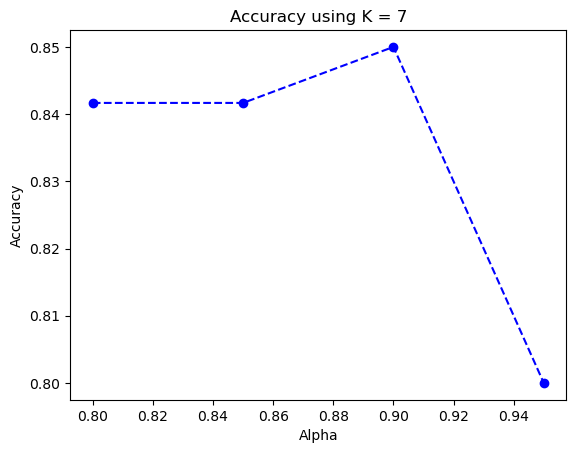

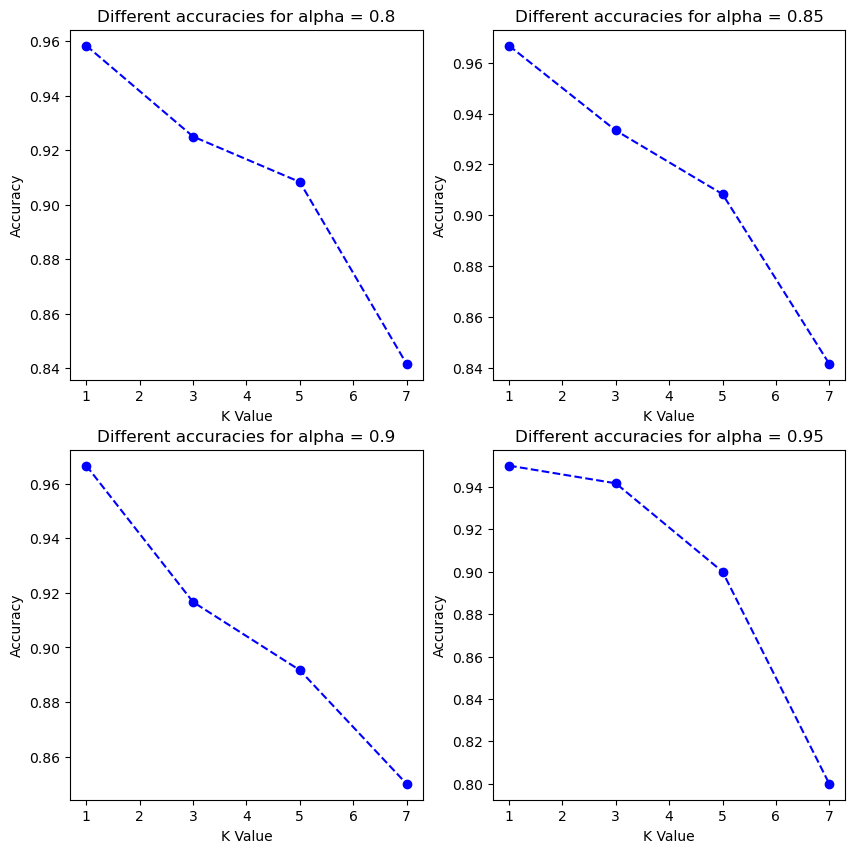

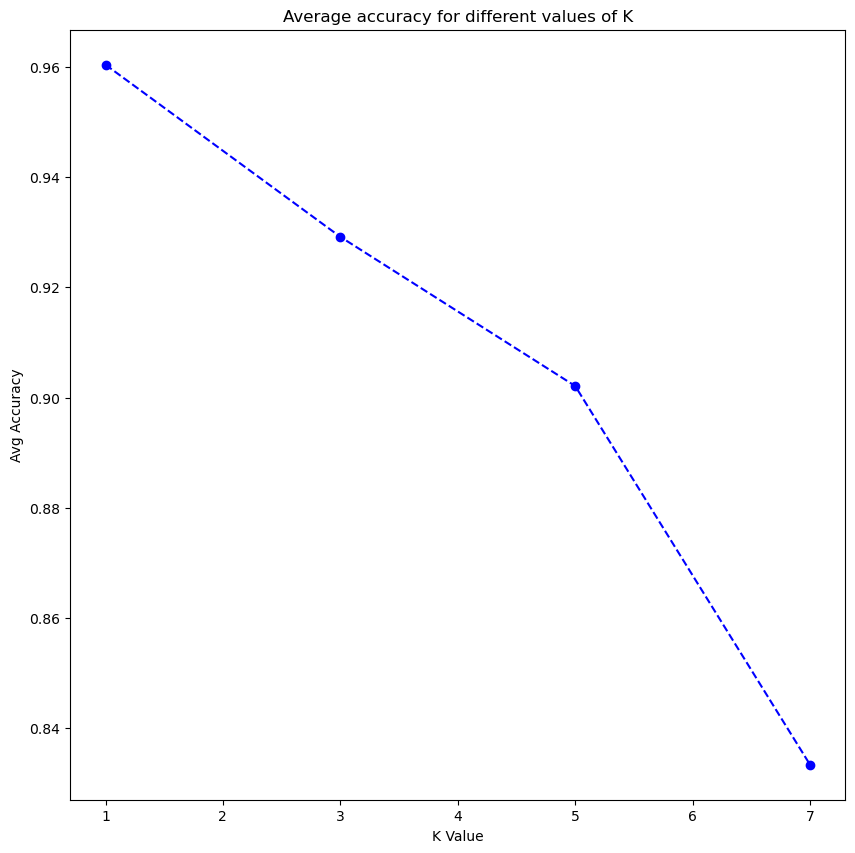

Accuracy using k = 1 = 0.9666666666666667
CONFUSION MATRIX:
[[3 0 0 ... 0 0 0]
 [0 3 0 ... 0 0 0]
 [0 0 3 ... 0 0 0]
 ...
 [0 0 0 ... 3 0 0]
 [0 0 0 ... 0 3 0]
 [0 0 0 ... 0 0 3]]
Accuracy using k = 3 = 0.9416666666666667
CONFUSION MATRIX:
[[3 0 0 ... 0 0 0]
 [0 3 0 ... 0 0 0]
 [0 0 3 ... 0 0 0]
 ...
 [0 0 0 ... 3 0 0]
 [0 0 0 ... 0 3 0]
 [0 0 0 ... 0 0 3]]
Accuracy using k = 5 = 0.9083333333333333
CONFUSION MATRIX:
[[3 0 0 ... 0 0 0]
 [0 3 0 ... 0 0 0]
 [0 0 3 ... 0 0 0]
 ...
 [0 0 0 ... 3 0 0]
 [0 0 0 ... 0 2 0]
 [0 0 0 ... 0 0 2]]
Accuracy using k = 7 = 0.8583333333333333
CONFUSION MATRIX:
[[3 0 0 ... 0 0 0]
 [0 3 0 ... 0 0 0]
 [0 0 3 ... 0 0 0]
 ...
 [0 0 0 ... 3 0 0]
 [0 0 0 ... 0 2 0]
 [0 0 0 ... 0 0 2]]


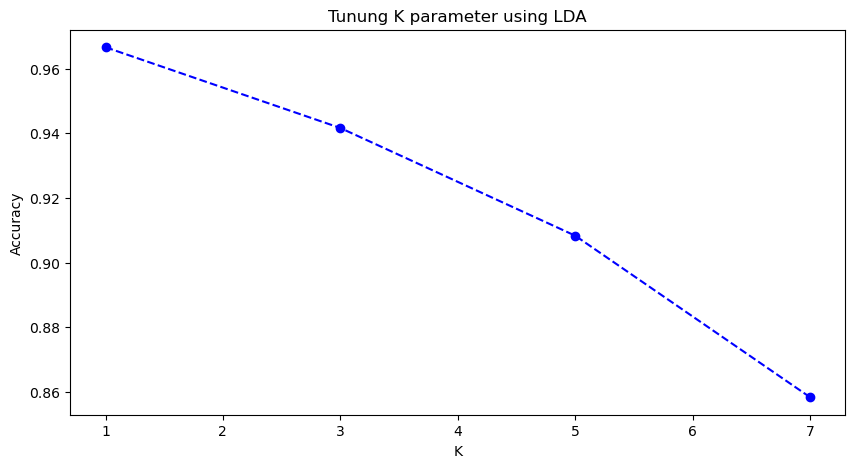

In [35]:
test_pca(cp.asarray(X_train_new),cp.asarray(X_test_new),cp.asarray(y_train_new),cp.asarray(y_test_new),0)
test_lda(cp.asarray(X_train_new),cp.asarray(X_test_new),cp.asarray(y_train_new),cp.asarray(y_test_new),39,7,0,0)

# Bonus 2

In [36]:
def classify_knn(X_train,X_test,y_train,y_test,k):
  model=KNeighborsClassifier(n_neighbors=k)
  model.fit(X_train, y_train)
  test_pred = model.predict(X_test)
  acc=accuracy_score(y_test, test_pred)
  print("Accuracy using k = "+str(k)+" = "+str(acc*100))

## Randomized PCA
## The classical PCA uses the low-rank matrix approximation to estimate the principal components. However, this method becomes costly and makes the whole process difficult to scale, for large datasets.
## By randomizing how the singular value decomposition of the dataset happens, we can approximate the first K principal components quickly than classical PCA.

In [37]:
from sklearn.decomposition import PCA
rpca = PCA(n_components=77,svd_solver='randomized')
X_train_rpca = rpca.fit_transform(X_train)
X_test_rpca = rpca.transform(X_test)

In [38]:
Ks=[1,3,5,7]
for k in Ks:
  classify_knn(X_train_rpca,X_test_rpca,y_train,y_test,k)

Accuracy using k = 1 = 94.5
Accuracy using k = 3 = 85.0
Accuracy using k = 5 = 81.5
Accuracy using k = 7 = 75.0


## Incremental PCA
## Incremental PCA can be used when the dataset is too large to fit in the memory.Here we split the dataset into mini-batches where each batch can fit into the memory and then feed it one mini-batch at a moment to the IPCA algorithm.

In [39]:
from sklearn.decomposition import IncrementalPCA
ipca = IncrementalPCA(n_components=77,batch_size=100)
X_train_ipca = ipca.fit_transform(X_train)
X_test_ipca = ipca.transform(X_test)

In [40]:
Ks=[1,3,5,7]
for k in Ks:
  classify_knn(X_train_ipca,X_test_ipca,y_train,y_test,k)

Accuracy using k = 1 = 94.5
Accuracy using k = 3 = 85.0
Accuracy using k = 5 = 82.0
Accuracy using k = 7 = 75.0


## Kernel PCA
## Kernel PCA is a technique which uses the so-called kernel trick and projects the linearly inseparable data into a higher dimension where it is linearly separable

In [41]:
from sklearn.decomposition import KernelPCA
kpca = KernelPCA(n_components=77, kernel='linear')
X_train_kpca = kpca.fit_transform(X_train)
X_test_kpca = kpca.transform(X_test)

In [42]:
Ks=[1,3,5,7]
for k in Ks:
  classify_knn(X_train_kpca,X_test_kpca,y_train,y_test,k)


Accuracy using k = 1 = 94.5
Accuracy using k = 3 = 85.0
Accuracy using k = 5 = 81.5
Accuracy using k = 7 = 75.5


In [43]:
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis
lda_regularized = LinearDiscriminantAnalysis(solver='eigen', shrinkage='auto')
lda_regularized.fit(X_train, y_train)
y_pred = lda_regularized.predict(X_test)
accuracy = accuracy_score(y_test, y_pred)
print(accuracy)

0.985
